# Análisis de Rendimiento de Campañas de Marketing
### 1. Preparación del Entorno de Trabajo

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as px
import plotly.express as px


In [ ]:
import os
from dateutil.parser import parser
import re
from math import e
import warnings
from random import sample
from matplotlib import ticker
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d.axes3d import Axes3D
import string
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import root_mean_squared_error
import plotly.graph_objects as go


### Instalación base de datos 

In [ ]:
df = pd.read_csv('F:\Entono_Virtual\mi_entorno\Proyecto1\mcp 1.csv')


In [ ]:
df.shape


(5000, 19)

In [ ]:
df.count()


Campaign_ID               4741
Channel                   4746
Product_Category          4733
Region                    4739
Budget                    4500
Spend                     4501
Impressions               4496
Clicks                    4514
CTR                       4502
Conversions               4506
CR                        4504
Revenue                   4491
ROI                       4505
Duration                  4521
Start_Date                4741
End_Date                  4743
Customer_Satisfaction     4508
Campaign_Effectiveness    4510
Market_Segment            4738
dtype: int64

In [9]:
df.head(10)


,Campaign_ID,Channel,Product_Category,Region,Budget,Spend,Impressions,Clicks,CTR,Conversions,CR,Revenue,ROI,Duration,Start_Date,End_Date,Customer_Satisfaction,Campaign_Effectiveness,Market_Segment
0,CAM0001,Billboard,Fashion,Kuala Lumpur,484341.0,197038.0,545901.0,NaN,0.0785,7993.00000,0.3414,849005.0,0.64,212.0,2/3/2023,23/12/2023,3.0,3.000000,Medium
1,CAM0002,NaN,Health,Sarawak,468792.0,33743.0,527513.0,4130.0,0.9479,9459.00000,NaN,921078.0,3.78,29.0,NaN,NaN,3.0,7.000000,Medium
2,CAM0003,Radio,Electronics,Penang,10487.0,6745.0,806911.0,12209.0,NaN,7168.00000,0.0517,51142.0,3.64,74.0,12/4/2023,20/10/2023,1.0,2.000000,Medium
3,CAM0004,Email,Electronics,Penang,345431.0,329112.0,108570.0,34391.0,0.6157,7190.00000,0.3579,191887.0,2.64,67.0,24/4/2023,26/1/2023,5.0,6.000000,High
4,CAM0005,Radio,Fashion,Kuala Lumpur,322345.0,34365.0,799855.0,13056.0,NaN,1794.00000,0.0544,167241.0,1.02,40.0,10/1/2023,1/1/2023,5.0,6.000000,Low
5,CAM0006,TV,Electronics,Penang,422726.0,NaN,25680.0,16342.0,0.7683,9786.00000,0.3395,480187.0,1.81,174.0,16/8/2023,15/6/2023,5.0,3.000000,Medium
6,NaN,Radio,Automotive,Sarawak,NaN,444126.0,81342.0,35053.0,0.0303,290.00000,0.5596,753564.0,2.69,105.0,21/6/2023,7/7/2023,4.0,7.000000,High
7,CAM0008,Billboard,Groceries,NaN,406954.0,64007.0,180250.0,17104.0,0.7427,8704.00000,0.9349,987174.0,0.39,59.0,13/6/2023,19/10/2023,4.0,44.457475,Low
8,CAM0009,NaN,Electronics,Johor,NaN,71027.0,543474.0,3181.0,0.5424,20614.52929,NaN,318098.0,1.50,358.0,21/6/2023,5/12/2023,3.0,10.000000,High
9,CAM0010,Radio,Automotive,NaN,399568.0,297974.0,319054.0,36693.0,0.1588,3160.00000,0.7760,823506.0,2.32,272.0,22/5/2023,5/11/2023,NaN,9.000000,Medium


In [ ]:
min_spend = df['Spend'].min()
max_spend = df['Spend'].max()

print(f"Valor mínimo de 'Spend': {min_spend}")
print(f"Valor máximo de 'Spend': {max_spend}")


Valor mínimo de 'Spend': 1.0
Valor máximo de 'Spend': 4317430.0


#### Localizando nulos en columnas y filas

In [ ]:
df.isnull().sum()


Campaign_ID               259
Channel                   254
Product_Category          267
Region                    261
Budget                    500
Spend                     499
Impressions               504
Clicks                    486
CTR                       498
Conversions               494
CR                        496
Revenue                   509
ROI                       495
Duration                  479
Start_Date                259
End_Date                  257
Customer_Satisfaction     492
Campaign_Effectiveness    490
Market_Segment            262
dtype: int64

##### Campaign_ID es un indice que sigue un orden correlativo que hace fácil su eliminación de nulos.
##### Las variables con categorías, como son Channel, Product_Category, Region, Market_Segment; además de ser aquellas con el número más bajos de nulos, también son aquellas que con los diferentes métodos que se apliquen variarán menos su media y varianza, por tanto no afectarán en demasía su corrección al sentido de los datos generales.
##### Otros datos categóricos pero ya numéricos son Customer_Satisfaction y Campaign_Effectiveness, pero su número de nulos nos hacen más reacios o a que serán aquellos a corregir en último lugar por ser más su número.
##### Otros datos con menor número de nulos son fecha inicio y fecha fín, que nos vendrá bien para un análisis temporal. Pero que no me planteo corregir.


In [ ]:
df[df.isnull().any(axis=1)].count()


Campaign_ID               3729
Channel                   3734
Product_Category          3721
Region                    3727
Budget                    3488
Spend                     3489
Impressions               3484
Clicks                    3502
CTR                       3490
Conversions               3494
CR                        3492
Revenue                   3479
ROI                       3493
Duration                  3509
Start_Date                3729
End_Date                  3731
Customer_Satisfaction     3496
Campaign_Effectiveness    3498
Market_Segment            3726
dtype: int64

In [ ]:
# Calcular el umbral de la mitad de columnas
umbral_nulos = df.shape[1] / 2

# Filtrar las filas que tienen menos de la mitad de sus valores como nulos
df_limpio = df.dropna(thresh=umbral_nulos)

# Guardar el archivo limpio (opcional)
df_limpio.to_csv('archivo_limpio.csv', index=False)

print("Filas eliminadas con éxito.")


Filas eliminadas con éxito.


In [14]:
df_limpio.shape


(5000, 19)

In [ ]:
df_limpio.count()


Campaign_ID               4741
Channel                   4746
Product_Category          4733
Region                    4739
Budget                    4500
Spend                     4501
Impressions               4496
Clicks                    4514
CTR                       4502
Conversions               4506
CR                        4504
Revenue                   4491
ROI                       4505
Duration                  4521
Start_Date                4741
End_Date                  4743
Customer_Satisfaction     4508
Campaign_Effectiveness    4510
Market_Segment            4738
dtype: int64

###### Corregir duración por fechas

In [ ]:
df['Start_Date'].dtype


dtype('O')

In [ ]:
import locale
locale.setlocale(locale.LC_ALL,'es_ES.UTF-8')
df['Start_Date'].dtype


dtype('O')

In [ ]:
df['Start_Date']=pd.to_datetime(df['Start_Date'], format="%d/%m/%Y")
df['Start_Date'].dtype


dtype('<M8[ns]')

In [ ]:
df['End_Date']=pd.to_datetime(df['End_Date'], format="%d/%m/%Y")
df['End_Date'].dtype


dtype('<M8[ns]')

In [ ]:
df.head(10)


,Campaign_ID,Channel,Product_Category,Region,Budget,Spend,Impressions,Clicks,CTR,Conversions,CR,Revenue,ROI,Duration,Start_Date,End_Date,Customer_Satisfaction,Campaign_Effectiveness,Market_Segment
0,CAM0001,Billboard,Fashion,Kuala Lumpur,484341.0,197038.0,545901.0,NaN,0.0785,7993.00000,0.3414,849005.0,0.64,212.0,2023-03-02,2023-12-23,3.0,3.000000,Medium
1,CAM0002,NaN,Health,Sarawak,468792.0,33743.0,527513.0,4130.0,0.9479,9459.00000,NaN,921078.0,3.78,29.0,NaT,NaT,3.0,7.000000,Medium
2,CAM0003,Radio,Electronics,Penang,10487.0,6745.0,806911.0,12209.0,NaN,7168.00000,0.0517,51142.0,3.64,74.0,2023-04-12,2023-10-20,1.0,2.000000,Medium
3,CAM0004,Email,Electronics,Penang,345431.0,329112.0,108570.0,34391.0,0.6157,7190.00000,0.3579,191887.0,2.64,67.0,2023-04-24,2023-01-26,5.0,6.000000,High
4,CAM0005,Radio,Fashion,Kuala Lumpur,322345.0,34365.0,799855.0,13056.0,NaN,1794.00000,0.0544,167241.0,1.02,40.0,2023-01-10,2023-01-01,5.0,6.000000,Low
5,CAM0006,TV,Electronics,Penang,422726.0,NaN,25680.0,16342.0,0.7683,9786.00000,0.3395,480187.0,1.81,174.0,2023-08-16,2023-06-15,5.0,3.000000,Medium
6,NaN,Radio,Automotive,Sarawak,NaN,444126.0,81342.0,35053.0,0.0303,290.00000,0.5596,753564.0,2.69,105.0,2023-06-21,2023-07-07,4.0,7.000000,High
7,CAM0008,Billboard,Groceries,NaN,406954.0,64007.0,180250.0,17104.0,0.7427,8704.00000,0.9349,987174.0,0.39,59.0,2023-06-13,2023-10-19,4.0,44.457475,Low
8,CAM0009,NaN,Electronics,Johor,NaN,71027.0,543474.0,3181.0,0.5424,20614.52929,NaN,318098.0,1.50,358.0,2023-06-21,2023-12-05,3.0,10.000000,High
9,CAM0010,Radio,Automotive,NaN,399568.0,297974.0,319054.0,36693.0,0.1588,3160.00000,0.7760,823506.0,2.32,272.0,2023-05-22,2023-11-05,NaN,9.000000,Medium


Tras comprobar visualmente las incogruencias totales entre fecha inicio de campaña, fecha fin de campaña y duración se desestiman dichas columnas para un análisis de coste vs beneficio

In [ ]:
df.describe()


,Budget,Spend,Impressions,Clicks,CTR,Conversions,CR,Revenue,ROI,Duration,Start_Date,End_Date,Customer_Satisfaction,Campaign_Effectiveness
count,4.500000e+03,4.501000e+03,4.496000e+03,4514.000000,4502.000000,4506.000000,4504.000000,4.491000e+03,4505.000000,4521.000000,4741,4743,4508.000000,4510.000000
mean,3.196766e+05,2.754637e+05,6.050865e+05,27467.000985,0.585820,5591.891502,0.556345,5.962208e+05,2.816823,200.590123,2023-07-02 00:57:24.336637952,2023-07-03 19:23:24.933586176,3.491172,6.418550
min,1.001400e+04,1.000000e+00,1.593000e+03,104.000000,0.000500,13.000000,0.000300,0.000000e+00,0.000000,1.000000,2023-01-01 00:00:00,2023-01-01 00:00:00,1.000000,1.000000
25%,1.379872e+05,1.113680e+05,2.624278e+05,12713.750000,0.250425,2604.250000,0.261425,2.574585e+05,1.270000,94.000000,2023-04-03 00:00:00,2023-04-04 00:00:00,2.000000,3.000000
50%,2.659450e+05,2.292810e+05,5.089675e+05,26232.000000,0.500150,5076.500000,0.507450,5.093340e+05,2.610000,188.000000,2023-07-02 00:00:00,2023-07-02 00:00:00,3.000000,6.000000
75%,3.855895e+05,3.445920e+05,7.663295e+05,38618.250000,0.760400,7578.000000,0.755375,7.717310e+05,3.830000,278.000000,2023-10-03 00:00:00,2023-10-02 00:00:00,4.000000,8.000000
max,4.175610e+07,4.317430e+06,9.991660e+07,250409.021300,9.570650,67712.567350,7.369659,9.717200e+06,29.526004,1911.832921,2024-01-01 00:00:00,2024-01-01 00:00:00,46.055439,88.914949
std,7.511176e+05,3.985757e+05,1.643209e+06,23203.538244,0.800421,5629.011928,0.580404,7.834836e+05,2.769284,173.398322,NaN,NaN,4.180570,7.773072


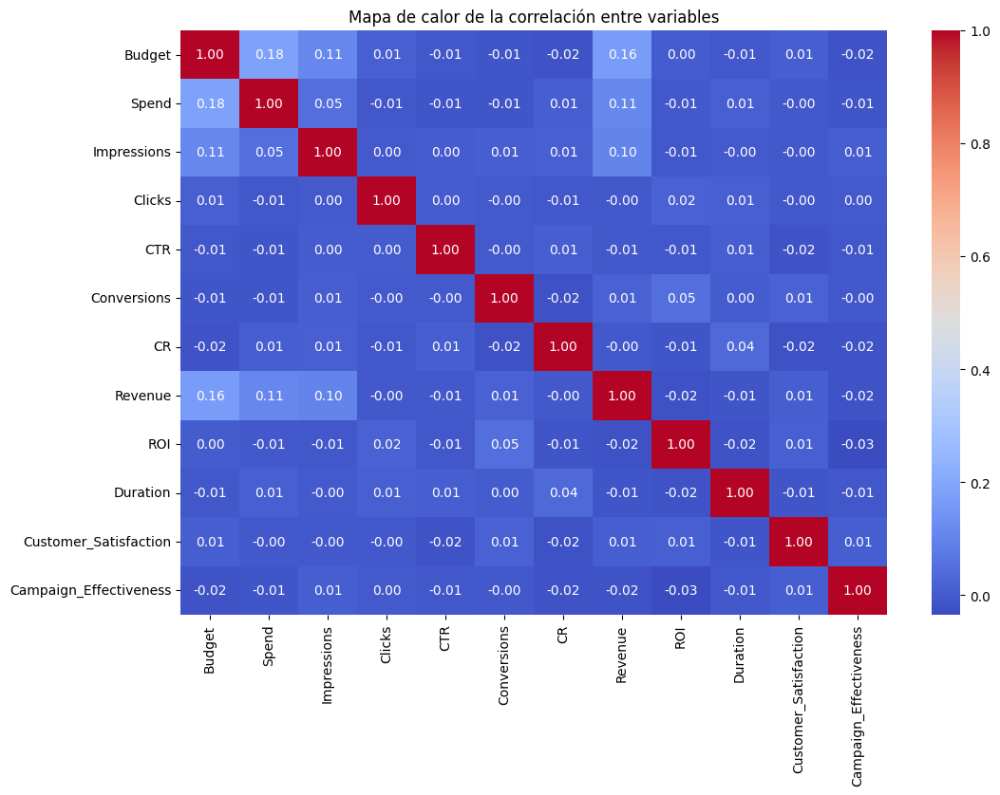

In [ ]:
plt.figure(figsize=(12, 8))
sns.heatmap(df.corr(method='pearson', numeric_only=True), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Mapa de calor de la correlación entre variables')
plt.show()


In [23]:
var_categoricas = df.select_dtypes(include='object').columns
print(var_categoricas)
for var in var_categoricas:
    print(f'{var}: {df[var].unique()}')
    

Index(['Campaign_ID', 'Channel', 'Product_Category', 'Region',
       'Market_Segment'],
      dtype='object')
Campaign_ID: ['CAM0001' 'CAM0002' 'CAM0003' ... 'CAM4998' 'CAM4999' 'CAM5000']
Channel: ['Billboard' nan 'Radio' 'Email' 'TV' 'Social Media' 'News']
Product_Category: ['Fashion' 'Health' 'Electronics' 'Automotive' 'Groceries' nan]
Region: ['Kuala Lumpur' 'Sarawak' 'Penang' nan 'Johor' 'Sabah' 'Malacca']
Market_Segment: ['Medium' 'High' 'Low' nan]


In [ ]:
# Seleccionar columnas con valores numéricos
columnas_numericas = df.select_dtypes(include=[np.number]).columns

# Mostrar las columnas seleccionadas
print("Columnas numéricas seleccionadas para el análisis de correlación:")
print(columnas_numericas)

# Calcular la matriz de correlación
matriz_correlacion = df[columnas_numericas].corr()

# Mostrar la matriz de correlación
print("Matriz de correlación:")
print(matriz_correlacion)


Columnas numéricas seleccionadas para el análisis de correlación:
Index(['Budget', 'Spend', 'Impressions', 'Clicks', 'CTR', 'Conversions', 'CR',
       'Revenue', 'ROI', 'Duration', 'Customer_Satisfaction',
       'Campaign_Effectiveness'],
      dtype='object')
Matriz de correlación:
                          Budget     Spend  Impressions    Clicks       CTR  \
Budget                  1.000000  0.180194     0.108969  0.010135 -0.006639   
Spend                   0.180194  1.000000     0.046307 -0.006495 -0.014031   
Impressions             0.108969  0.046307     1.000000  0.000750  0.003076   
Clicks                  0.010135 -0.006495     0.000750  1.000000  0.004315   
CTR                    -0.006639 -0.014031     0.003076  0.004315  1.000000   
Conversions            -0.012726 -0.011212     0.007499 -0.000726 -0.001186   
CR                     -0.016274  0.006089     0.010775 -0.009052  0.009076   
Revenue                 0.164119  0.110142     0.100387 -0.003712 -0.005828   
ROI

In [ ]:
# Asegurarse de que las columnas de fecha están en formato datetime
df['Start_Date'] = pd.to_datetime(df['Start_Date'], format="%d/%m/%Y", errors='coerce')
df['End_Date'] = pd.to_datetime(df['End_Date'], format="%d/%m/%Y", errors='coerce')

# Crear la nueva columna 'Days_Duration'
df['Days_Duration'] = (df['End_Date'] - df['Start_Date']).dt.days

# Mostrar las primeras filas para verificar
df[['Start_Date', 'End_Date', 'Days_Duration']].head()


,Start_Date,End_Date,Days_Duration
0,2023-03-02,2023-12-23,296.0
1,NaT,NaT,NaN
2,2023-04-12,2023-10-20,191.0
3,2023-04-24,2023-01-26,-88.0
4,2023-01-10,2023-01-01,-9.0


In [26]:
# Crear nuevas columnas corregidas
df['Start_Date_Corrected'] = df['Start_Date']
df['End_Date_Corrected'] = df['End_Date']

# Intercambiar las fechas donde Days_Duration es negativo
mask = df['Days_Duration'] < 0
df.loc[mask, ['Start_Date_Corrected', 'End_Date_Corrected']] = df.loc[mask, ['End_Date', 'Start_Date']].values

# Recalcular Days_Duration con las fechas corregidas
df['Days_Duration_Corrected'] = (df['End_Date_Corrected'] - df['Start_Date_Corrected']).dt.days

# Mostrar las primeras filas para verificar
df[['Start_Date', 'End_Date', 'Start_Date_Corrected', 'End_Date_Corrected', 'Days_Duration_Corrected']].head()


,Start_Date,End_Date,Start_Date_Corrected,End_Date_Corrected,Days_Duration_Corrected
0,2023-03-02,2023-12-23,2023-03-02,2023-12-23,296.0
1,NaT,NaT,NaT,NaT,NaN
2,2023-04-12,2023-10-20,2023-04-12,2023-10-20,191.0
3,2023-04-24,2023-01-26,2023-01-26,2023-04-24,88.0
4,2023-01-10,2023-01-01,2023-01-01,2023-01-10,9.0


In [ ]:
# Calcular las diferencias entre Duration y Days_Duration_Corrected
diferencias = df['Duration'] - df['Days_Duration_Corrected']

# Calcular la desviación estándar de las diferencias
desviacion_estandar = diferencias.std()

print("Desviación estándar de las diferencias:", desviacion_estandar)


Desviación estándar de las diferencias: 193.7202697225751


In [ ]:
df[['Duration', 'Days_Duration_Corrected']].head()


,Duration,Days_Duration_Corrected
0,212.0,296.0
1,29.0,NaN
2,74.0,191.0
3,67.0,88.0
4,40.0,9.0


In [ ]:
# Rellenar los valores nulos en Campaign_ID con el índice de los datos
df['Campaign_ID'] = df['Campaign_ID'].fillna(df.index.to_series().apply(lambda x: f'CAM{x:04d}'))

# Verificar que no haya valores nulos en Campaign_ID
print(df['Campaign_ID'].isnull().sum())


0


Se corrigen datos nulos de la columna Channel en base a la relación de esta columna con las columnas Product_Category, Region, Spend, Campaign_Effectivenessy Market_Segment. Buscando el resultado más probable siguiendo

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder

# Seleccionar las columnas relevantes
columnas_relevantes = ['Product_Category', 'Region', 'Spend', 'Campaign_Effectiveness', 'Market_Segment']

# Crear una copia del dataframe para trabajar
df_copy = df.copy()

# Convertir las columnas categóricas a valores numéricos
label_encoders = {}
for col in columnas_relevantes:
    if df_copy[col].dtype == 'object':
        le = LabelEncoder()
        df_copy[col] = le.fit_transform(df_copy[col].astype(str))
        label_encoders[col] = le

# Imputar los valores faltantes en las columnas relevantes
imputer = SimpleImputer(strategy='most_frequent')
df_copy[columnas_relevantes] = imputer.fit_transform(df_copy[columnas_relevantes])

# Separar los datos en entrenamiento y prueba
df_train = df_copy[df_copy['Channel'].notna()]
df_test = df_copy[df_copy['Channel'].isna()]

# Convertir la columna 'Channel' a valores numéricos
le_channel = LabelEncoder()
df_train['Channel'] = le_channel.fit_transform(df_train['Channel'].astype(str))

# Definir las características (X) y la variable objetivo (y)
X_train = df_train[columnas_relevantes]
y_train = df_train['Channel']
X_test = df_test[columnas_relevantes]

# Crear y entrenar el modelo KNN si hay datos para predecir
if not df_test.empty:
    knn = KNeighborsClassifier(n_neighbors=5)
    knn.fit(X_train, y_train)

    # Predecir los valores faltantes en 'Channel'
    y_pred = knn.predict(X_test)

    # Convertir las predicciones a los valores originales
    df.loc[df['Channel'].isna(), 'Channel'] = le_channel.inverse_transform(y_pred)

    print("Valores faltantes en 'Channel' rellenados con éxito.")
else:
    print("No hay valores faltantes en 'Channel' para rellenar.")


Valores faltantes en 'Channel' rellenados con éxito.


C:\Users\Usuario\AppData\Local\Temp\ipykernel_6440\930155507.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train['Channel'] = le_channel.fit_transform(df_train['Channel'].astype(str))


In [ ]:
df.head(10)


,Campaign_ID,Channel,Product_Category,Region,Budget,Spend,Impressions,Clicks,CTR,Conversions,...,Duration,Start_Date,End_Date,Customer_Satisfaction,Campaign_Effectiveness,Market_Segment,Days_Duration,Start_Date_Corrected,End_Date_Corrected,Days_Duration_Corrected
0,CAM0001,Billboard,Fashion,Kuala Lumpur,484341.0,197038.0,545901.0,NaN,0.0785,7993.00000,...,212.0,2023-03-02,2023-12-23,3.0,3.000000,Medium,296.0,2023-03-02,2023-12-23,296.0
1,CAM0002,Email,Health,Sarawak,468792.0,33743.0,527513.0,4130.0,0.9479,9459.00000,...,29.0,NaT,NaT,3.0,7.000000,Medium,NaN,NaT,NaT,NaN
2,CAM0003,Radio,Electronics,Penang,10487.0,6745.0,806911.0,12209.0,NaN,7168.00000,...,74.0,2023-04-12,2023-10-20,1.0,2.000000,Medium,191.0,2023-04-12,2023-10-20,191.0
3,CAM0004,Email,Electronics,Penang,345431.0,329112.0,108570.0,34391.0,0.6157,7190.00000,...,67.0,2023-04-24,2023-01-26,5.0,6.000000,High,-88.0,2023-01-26,2023-04-24,88.0
4,CAM0005,Radio,Fashion,Kuala Lumpur,322345.0,34365.0,799855.0,13056.0,NaN,1794.00000,...,40.0,2023-01-10,2023-01-01,5.0,6.000000,Low,-9.0,2023-01-01,2023-01-10,9.0
5,CAM0006,TV,Electronics,Penang,422726.0,NaN,25680.0,16342.0,0.7683,9786.00000,...,174.0,2023-08-16,2023-06-15,5.0,3.000000,Medium,-62.0,2023-06-15,2023-08-16,62.0
6,CAM0006,Radio,Automotive,Sarawak,NaN,444126.0,81342.0,35053.0,0.0303,290.00000,...,105.0,2023-06-21,2023-07-07,4.0,7.000000,High,16.0,2023-06-21,2023-07-07,16.0
7,CAM0008,Billboard,Groceries,NaN,406954.0,64007.0,180250.0,17104.0,0.7427,8704.00000,...,59.0,2023-06-13,2023-10-19,4.0,44.457475,Low,128.0,2023-06-13,2023-10-19,128.0
8,CAM0009,Billboard,Electronics,Johor,NaN,71027.0,543474.0,3181.0,0.5424,20614.52929,...,358.0,2023-06-21,2023-12-05,3.0,10.000000,High,167.0,2023-06-21,2023-12-05,167.0
9,CAM0010,Radio,Automotive,NaN,399568.0,297974.0,319054.0,36693.0,0.1588,3160.00000,...,272.0,2023-05-22,2023-11-05,NaN,9.000000,Medium,167.0,2023-05-22,2023-11-05,167.0


In [ ]:
df.isnull().sum()


Campaign_ID                  0
Channel                      0
Product_Category           267
Region                     261
Budget                     500
Spend                      499
Impressions                504
Clicks                     486
CTR                        498
Conversions                494
CR                         496
Revenue                    509
ROI                        495
Duration                   479
Start_Date                 259
End_Date                   257
Customer_Satisfaction      492
Campaign_Effectiveness     490
Market_Segment             262
Days_Duration              502
Start_Date_Corrected       259
End_Date_Corrected         257
Days_Duration_Corrected    502
dtype: int64

Creo una columna Duración con los datos de Days_Duration_Corrected rellenados los huecos con los datos de Duration.

In [ ]:
df['Duración'] = df['Days_Duration_Corrected'].fillna(df['Duration'])
df['Duración'].isnull().sum()


np.int64(38)

In [ ]:
# Calcular la media y la mediana de la columna 'Duración'
media_duracion = df['Duración'].mean()
mediana_duracion = df['Duración'].median()

# Calcular la media y la mediana de la columna 'Duration'
media_duration = df['Duration'].mean()
mediana_duration = df['Duration'].median()

print(f"Media de 'Duración': {media_duracion}")
print(f"Mediana de 'Duración': {mediana_duracion}")
print(f"Media de 'Duration': {media_duration}")
print(f"Mediana de 'Duration': {mediana_duration}")


Media de 'Duración': 129.3649297344377
Mediana de 'Duración': 113.0
Media de 'Duration': 200.59012296161026
Mediana de 'Duration': 188.0


Valores máximo y mínimo de las columnas Duración y Duration

In [ ]:
# Obtener los valores máximo y mínimo de la columna 'Duración'
max_duracion = df['Duración'].max()
min_duracion = df['Duración'].min()

# Obtener los valores máximo y mínimo de la columna 'Duration'
max_duration = df['Duration'].max()
min_duration = df['Duration'].min()

print(f"Máximo de 'Duración': {max_duracion}")
print(f"Mínimo de 'Duración': {min_duracion}")
print(f"Máximo de 'Duration': {max_duration}")
print(f"Mínimo de 'Duration': {min_duration}")


Máximo de 'Duración': 1764.76885
Mínimo de 'Duración': 0.0
Máximo de 'Duration': 1911.832921
Mínimo de 'Duration': 1.0


Para la correción de los datos outliers de Duración hago una comparación con los datos por los cuartiles extremos y resuelvo con la comparación a la media con los datos de Days_Duration_Corrected, para sustiuirlos.

In [ ]:
# Definir los outliers usando el método del rango intercuartílico (IQR)
Q1 = df['Duración'].quantile(0.25)
Q3 = df['Duración'].quantile(0.75)
IQR = Q3 - Q1

# Definir los límites para los outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identificar los outliers
outliers = (df['Duración'] < lower_bound) | (df['Duración'] > upper_bound)

# Corregir los outliers con el valor más próximo a la media de Days_Duration_Corrected
media_days_duration_corrected = df['Days_Duration_Corrected'].mean()
df['Duración_corregida'] = df['Duración'].copy()
df.loc[outliers, 'Duración_corregida'] = df['Days_Duration_Corrected'].apply(lambda x: media_days_duration_corrected if pd.isna(x) else x)

# Calcular la media y la mediana de la nueva columna Duración_corregida
media_duracion_corregida = df['Duración_corregida'].mean()
mediana_duracion_corregida = df['Duración_corregida'].median()

print(f"Media de 'Duración_corregida': {media_duracion_corregida}")
print(f"Mediana de 'Duración_corregida': {mediana_duracion_corregida}")


Media de 'Duración_corregida': 128.07652584862146
Mediana de 'Duración_corregida': 113.0


Gráfico de caja comparando Duración y Duración_corregida

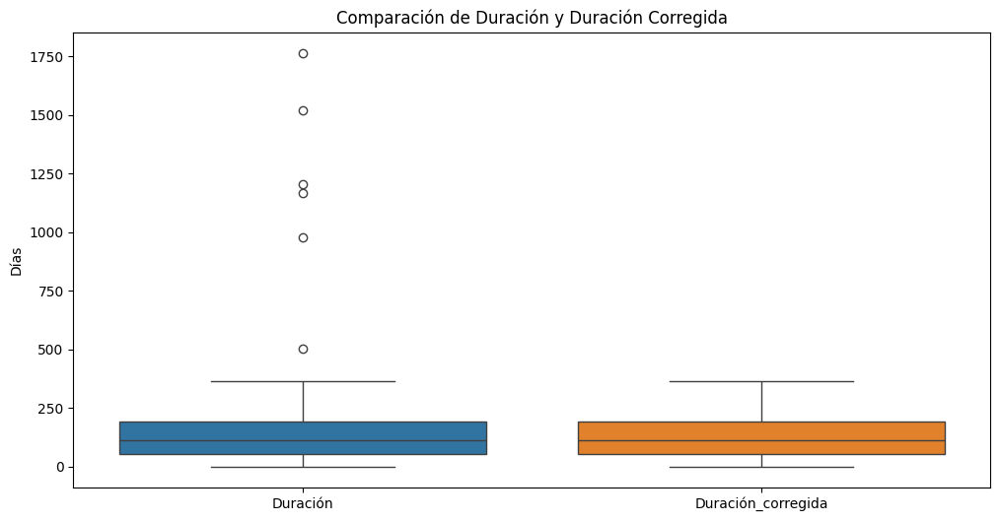

In [ ]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=df[['Duración', 'Duración_corregida']])
plt.title('Comparación de Duración y Duración Corregida')
plt.ylabel('Días')
plt.show()


In [ ]:
max_duracion = df['Duración_corregida'].max()
min_duracion = df['Duración_corregida'].min()

print(f"Máximo de 'Duración': {max_duracion}")
print(f"Mínimo de 'Duración': {min_duracion}")

df['Duración_corregida'].isnull().sum()


Máximo de 'Duración': 364.0
Mínimo de 'Duración': 0.0


np.int64(38)

Al revisar al duración se comprueba que el cruce de nulos entre la fecha inicio y la fecha fin es una suma de 502, se hace evidente que en muchas de las filas tenemos uno de los 2 datos. Si presuponemos estos datos ciertos, en aquellos que tenemos también duración serán corregibles con cierta fiabilidad.

In [ ]:
# Filtrar las filas donde una de las columnas 'Start_Date_Corrected' o 'End_Date_Corrected' es nula y la otra no
filtro = df[(df['Start_Date_Corrected'].isnull() & df['End_Date_Corrected'].notnull()) | 
            (df['Start_Date_Corrected'].notnull() & df['End_Date_Corrected'].isnull())]

# Seleccionar las columnas deseadas
tabla_resultado = filtro[['Duración_corregida', 'Start_Date_Corrected', 'End_Date_Corrected']]

# Mostrar la tabla
print(tabla_resultado)


      Duración_corregida Start_Date_Corrected End_Date_Corrected
11                  21.0           2023-06-20                NaT
18                 112.0           2023-12-18                NaT
29                 185.0                  NaT         2023-02-26
30                 270.0           2023-03-22                NaT
40                 175.0           2023-01-19                NaT
...                  ...                  ...                ...
4970               111.0           2023-09-21                NaT
4981                73.0                  NaT         2023-04-11
4988               104.0           2023-09-21                NaT
4990               112.0                  NaT         2023-02-11
4993               195.0                  NaT         2023-12-29

[488 rows x 3 columns]


In [ ]:
# Corregir los nulos de Start_Date_Corrected
df['Start_Date_Corrected'] = df['Start_Date_Corrected'].fillna(df['End_Date_Corrected'] - pd.to_timedelta(df['Duración_corregida'], unit='D'))

# Corregir los nulos de End_Date_Corrected
df['End_Date_Corrected'] = df['End_Date_Corrected'].fillna(df['Start_Date_Corrected'] + pd.to_timedelta(df['Duración_corregida'], unit='D'))

# Verificar que no haya valores nulos en Start_Date_Corrected y End_Date_Corrected
print(df[['Start_Date_Corrected', 'End_Date_Corrected']].isnull().sum())


Start_Date_Corrected    36
End_Date_Corrected      28
dtype: int64


f:\Entono_Virtual\mi_entorno\Lib\site-packages\numpy\_core\fromnumeric.py:57: RuntimeWarning: overflow encountered in multiply
  return bound(*args, **kwds)


Teniendo en cuenta las relaciones entre las columnas Product_Category, Region, Spend, Campaign_Effectiveness, Market_Segment, Roi, Impressions Duración y Channel relleno los valores nulos de MarKet_Segment con los valores más probables.

In [ ]:
# Seleccionar las columnas relevantes
columnas_relevantes_market_segment = ['Product_Category', 'Region', 'Spend', 'Campaign_Effectiveness', 'ROI', 'Impressions', 'Duración', 'Channel']

# Crear una copia del dataframe para trabajar
df_copy_market_segment = df.copy()

# Convertir las columnas categóricas a valores numéricos
label_encoders_market_segment = {}
for col in columnas_relevantes_market_segment:
    if df_copy_market_segment[col].dtype == 'object':
        le = LabelEncoder()
        df_copy_market_segment[col] = le.fit_transform(df_copy_market_segment[col].astype(str))
        label_encoders_market_segment[col] = le

# Imputar los valores faltantes en las columnas relevantes
imputer_market_segment = SimpleImputer(strategy='most_frequent')
df_copy_market_segment[columnas_relevantes_market_segment] = imputer_market_segment.fit_transform(df_copy_market_segment[columnas_relevantes_market_segment])

# Separar los datos en entrenamiento y prueba
df_train_market_segment = df_copy_market_segment[df_copy_market_segment['Market_Segment'].notna()]
df_test_market_segment = df_copy_market_segment[df_copy_market_segment['Market_Segment'].isna()]

# Convertir la columna 'Market_Segment' a valores numéricos
le_market_segment = LabelEncoder()
df_train_market_segment['Market_Segment'] = le_market_segment.fit_transform(df_train_market_segment['Market_Segment'].astype(str))

# Definir las características (X) y la variable objetivo (y)
X_train_market_segment = df_train_market_segment[columnas_relevantes_market_segment]
y_train_market_segment = df_train_market_segment['Market_Segment']
X_test_market_segment = df_test_market_segment[columnas_relevantes_market_segment]

# Crear y entrenar el modelo KNN
knn_market_segment = KNeighborsClassifier(n_neighbors=5)
knn_market_segment.fit(X_train_market_segment, y_train_market_segment)

# Predecir los valores faltantes en 'Market_Segment'
y_pred_market_segment = knn_market_segment.predict(X_test_market_segment)

# Convertir las predicciones a los valores originales
df.loc[df['Market_Segment'].isna(), 'Market_Segment'] = le_market_segment.inverse_transform(y_pred_market_segment)

print("Valores faltantes en 'Market_Segment' rellenados con éxito.")
df['Market_Segment'].isnull().sum()


Valores faltantes en 'Market_Segment' rellenados con éxito.


C:\Users\Usuario\AppData\Local\Temp\ipykernel_6440\3155281901.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_market_segment['Market_Segment'] = le_market_segment.fit_transform(df_train_market_segment['Market_Segment'].astype(str))


np.int64(0)

Teniendo en cuenta las relaciones entre las columnas Product_Category, Region, Spend, Campaign_Effectiveness, Market_Segment, Roi, Impressions Duración y Channel relleno los valores nulos de Region con los valores más probables.

In [ ]:
# Seleccionar las columnas relevantes
columnas_relevantes_region = ['Product_Category', 'Spend', 'Campaign_Effectiveness', 'Market_Segment', 'ROI', 'Impressions', 'Duración', 'Channel']

# Crear una copia del dataframe para trabajar
df_copy_region = df.copy()

# Convertir las columnas categóricas a valores numéricos
label_encoders_region = {}
for col in columnas_relevantes_region:
    if df_copy_region[col].dtype == 'object':
        le = LabelEncoder()
        df_copy_region[col] = le.fit_transform(df_copy_region[col].astype(str))
        label_encoders_region[col] = le

# Imputar los valores faltantes en las columnas relevantes
imputer_region = SimpleImputer(strategy='most_frequent')
df_copy_region[columnas_relevantes_region] = imputer_region.fit_transform(df_copy_region[columnas_relevantes_region])

# Separar los datos en entrenamiento y prueba
df_train_region = df_copy_region[df_copy_region['Region'].notna()]
df_test_region = df_copy_region[df_copy_region['Region'].isna()]

# Convertir la columna 'Region' a valores numéricos
le_region = LabelEncoder()
df_train_region['Region'] = le_region.fit_transform(df_train_region['Region'].astype(str))

# Definir las características (X) y la variable objetivo (y)
X_train_region = df_train_region[columnas_relevantes_region]
y_train_region = df_train_region['Region']
X_test_region = df_test_region[columnas_relevantes_region]

# Crear y entrenar el modelo KNN
knn_region = KNeighborsClassifier(n_neighbors=5)
knn_region.fit(X_train_region, y_train_region)

# Predecir los valores faltantes en 'Region'
y_pred_region = knn_region.predict(X_test_region)

# Convertir las predicciones a los valores originales
df.loc[df['Region'].isna(), 'Region'] = le_region.inverse_transform(y_pred_region)

print("Valores faltantes en 'Region' rellenados con éxito.")
df['Region'].isnull().sum()


Valores faltantes en 'Region' rellenados con éxito.


C:\Users\Usuario\AppData\Local\Temp\ipykernel_6440\2027542778.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_region['Region'] = le_region.fit_transform(df_train_region['Region'].astype(str))


np.int64(0)

Teniendo en cuenta las relaciones entre las columnas Product_Category, Region, Spend, Campaign_Effectiveness, Market_Segment, Roi, Impressions Duración y Channel relleno los valores nulos de Product_Categpory con los valores más probables.

In [ ]:
# Seleccionar las columnas relevantes
columnas_relevantes_product_category = ['Region', 'Spend', 'Campaign_Effectiveness', 'Market_Segment', 'ROI', 'Impressions', 'Duración', 'Channel']

# Crear una copia del dataframe para trabajar
df_copy_product_category = df.copy()

# Convertir las columnas categóricas a valores numéricos
label_encoders_product_category = {}
for col in columnas_relevantes_product_category:
    if df_copy_product_category[col].dtype == 'object':
        le = LabelEncoder()
        df_copy_product_category[col] = le.fit_transform(df_copy_product_category[col].astype(str))
        label_encoders_product_category[col] = le

# Imputar los valores faltantes en las columnas relevantes
imputer_product_category = SimpleImputer(strategy='most_frequent')
df_copy_product_category[columnas_relevantes_product_category] = imputer_product_category.fit_transform(df_copy_product_category[columnas_relevantes_product_category])

# Separar los datos en entrenamiento y prueba
df_train_product_category = df_copy_product_category[df_copy_product_category['Product_Category'].notna()]
df_test_product_category = df_copy_product_category[df_copy_product_category['Product_Category'].isna()]

# Convertir la columna 'Product_Category' a valores numéricos
le_product_category = LabelEncoder()
df_train_product_category['Product_Category'] = le_product_category.fit_transform(df_train_product_category['Product_Category'].astype(str))

# Definir las características (X) y la variable objetivo (y)
X_train_product_category = df_train_product_category[columnas_relevantes_product_category]
y_train_product_category = df_train_product_category['Product_Category']
X_test_product_category = df_test_product_category[columnas_relevantes_product_category]

# Crear y entrenar el modelo KNN
knn_product_category = KNeighborsClassifier(n_neighbors=5)
knn_product_category.fit(X_train_product_category, y_train_product_category)

# Predecir los valores faltantes en 'Product_Category'
y_pred_product_category = knn_product_category.predict(X_test_product_category)

# Convertir las predicciones a los valores originales
df.loc[df['Product_Category'].isna(), 'Product_Category'] = le_product_category.inverse_transform(y_pred_product_category)

print("Valores faltantes en 'Product_Category' rellenados con éxito.")
df['Product_Category'].isnull().sum()


C:\Users\Usuario\AppData\Local\Temp\ipykernel_6440\2090988196.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_product_category['Product_Category'] = le_product_category.fit_transform(df_train_product_category['Product_Category'].astype(str))


Valores faltantes en 'Product_Category' rellenados con éxito.


np.int64(0)

Voy a calcular en que porcentaje el valor de ROI confirma con los datos de Revenue y Spend que cumple que ROI=Revenue/Spend

In [ ]:
# Calcular el ROI teórico
df['ROI_Teorico'] = df['Revenue'] / df['Spend']

# Comparar el ROI teórico con el ROI real
df['ROI_Coincide'] = np.isclose(df['ROI'], df['ROI_Teorico'], atol=1e-2)

# Calcular el porcentaje de coincidencias
porcentaje_coincidencia = df['ROI_Coincide'].mean() * 100

print(f"El porcentaje de coincidencia entre el ROI real y el ROI teórico es: {porcentaje_coincidencia:.2f}%")


El porcentaje de coincidencia entre el ROI real y el ROI teórico es: 0.20%


In [ ]:
df.isnull().sum()


Campaign_ID                  0
Channel                      0
Product_Category             0
Region                       0
Budget                     500
Spend                      499
Impressions                504
Clicks                     486
CTR                        498
Conversions                494
CR                         496
Revenue                    509
ROI                        495
Duration                   479
Start_Date                 259
End_Date                   257
Customer_Satisfaction      492
Campaign_Effectiveness     490
Market_Segment               0
Days_Duration              502
Start_Date_Corrected        36
End_Date_Corrected          28
Days_Duration_Corrected    502
Duración                    38
Duración_corregida          38
ROI_Teorico                954
ROI_Coincide                 0
dtype: int64

Calculo media y varianza de Customer_Satisfaction

In [ ]:
# Calcular la media de Customer_Satisfaction
media_customer_satisfaction = df['Customer_Satisfaction'].mean()

# Calcular la varianza de Customer_Satisfaction
varianza_customer_satisfaction = df['Customer_Satisfaction'].var()

print(f"Media de Customer_Satisfaction: {media_customer_satisfaction}")
print(f"Varianza de Customer_Satisfaction: {varianza_customer_satisfaction}")


Media de Customer_Satisfaction: 3.4911723106508425
Varianza de Customer_Satisfaction: 17.47716290855637


Teniendo en cuenta la relación entre Channel, Product_Category, Region, Budget, Spend, Impressions, Clicks, CTR, Conversions, CR, Revenue, ROI, Customer_Satisfaction, Campaign_Effectiveness y Market_Segment relleno los valores nulos de Customer_Satisfaction.

In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.neighbors import KNeighborsClassifier

# Seleccionar las columnas relevantes
columnas_relevantes_customer_satisfaction = [
    'Channel', 'Product_Category', 'Region', 'Budget', 'Spend', 'Impressions', 
    'Clicks', 'CTR', 'Conversions', 'CR', 'Revenue', 'ROI', 
    'Campaign_Effectiveness', 'Market_Segment'
]

# Crear una copia del dataframe para trabajar
df_copy_customer_satisfaction = df.copy()

# Convertir las columnas categóricas a valores numéricos
label_encoders_customer_satisfaction = {}
for col in columnas_relevantes_customer_satisfaction:
    if df_copy_customer_satisfaction[col].dtype == 'object':
        le = LabelEncoder()
        df_copy_customer_satisfaction[col] = le.fit_transform(df_copy_customer_satisfaction[col].astype(str))
        label_encoders_customer_satisfaction[col] = le

# Imputar los valores faltantes en las columnas relevantes
imputer_customer_satisfaction = SimpleImputer(strategy='most_frequent')
df_copy_customer_satisfaction[columnas_relevantes_customer_satisfaction] = imputer_customer_satisfaction.fit_transform(df_copy_customer_satisfaction[columnas_relevantes_customer_satisfaction])

# Separar los datos en entrenamiento y prueba
df_train_customer_satisfaction = df_copy_customer_satisfaction[df_copy_customer_satisfaction['Customer_Satisfaction'].notna()]
df_test_customer_satisfaction = df_copy_customer_satisfaction[df_copy_customer_satisfaction['Customer_Satisfaction'].isna()]

# Definir las características (X) y la variable objetivo (y)
X_train_customer_satisfaction = df_train_customer_satisfaction[columnas_relevantes_customer_satisfaction]
y_train_customer_satisfaction = df_train_customer_satisfaction['Customer_Satisfaction']
X_test_customer_satisfaction = df_test_customer_satisfaction[columnas_relevantes_customer_satisfaction]

# Convertir la variable objetivo en categorías discretas
le_customer_satisfaction = LabelEncoder()
y_train_customer_satisfaction = le_customer_satisfaction.fit_transform(y_train_customer_satisfaction)

# Crear y entrenar el modelo KNN
knn_customer_satisfaction = KNeighborsClassifier(n_neighbors=5)
knn_customer_satisfaction.fit(X_train_customer_satisfaction, y_train_customer_satisfaction)

# Predecir los valores faltantes en 'Customer_Satisfaction'
y_pred_customer_satisfaction = knn_customer_satisfaction.predict(X_test_customer_satisfaction)

# Invertir la transformación de las predicciones a los valores originales
y_pred_customer_satisfaction = le_customer_satisfaction.inverse_transform(y_pred_customer_satisfaction)

# Rellenar los valores nulos en 'Customer_Satisfaction' con las predicciones
df.loc[df['Customer_Satisfaction'].isna(), 'Customer_Satisfaction'] = y_pred_customer_satisfaction

print("Valores faltantes en 'Customer_Satisfaction' rellenados con éxito.")
print(df['Customer_Satisfaction'].isnull().sum())


Valores faltantes en 'Customer_Satisfaction' rellenados con éxito.
0


In [ ]:
# Calcular la media de Customer_Satisfaction
media_customer_satisfaction = df['Customer_Satisfaction'].mean()

# Calcular la varianza de Customer_Satisfaction
varianza_customer_satisfaction = df['Customer_Satisfaction'].var()

print(f"Media de Customer_Satisfaction: {media_customer_satisfaction}")
print(f"Varianza de Customer_Satisfaction: {varianza_customer_satisfaction}")


Media de Customer_Satisfaction: 3.4132409552828
Varianza de Customer_Satisfaction: 16.00545886567989


Estimo tras la comparación de media y varianza de Customer_Satisfaction corregida con la original que el uso de los nuevos datos incluidos no van a variar las conclusiones.

Calculo la media y la varianza de Campaign_Effectiveness

In [ ]:
# Calcular la media de Campaign_Effectiveness
media_Campaign_Effectiveness = df['Campaign_Effectiveness'].mean()

# Calcular la varianza de Campaign_Effectiveness
varianza_Campaign_Effectiveness = df['Campaign_Effectiveness'].var()

print(f"Media de Campaign_Effectiveness: {media_Campaign_Effectiveness}")
print(f"Varianza de Campaign_Effectiveness: {varianza_Campaign_Effectiveness}")


Media de Campaign_Effectiveness: 6.418550425277606
Varianza de Campaign_Effectiveness: 60.42064531432756


Teniendo en cuenta la relación entre Channel, Product_Category, Region, Budget, Spend, Impressions, Clicks, CTR, Conversions, CR, Revenue, ROI, Customer_Satisfaction, Campaign_Effectiveness y Market_Segment relleno los valores nulos de Campaign_Effectiveness.

In [ ]:
# Seleccionar las columnas relevantes
columnas_relevantes_campaign_effectiveness = [
    'Channel', 'Product_Category', 'Region', 'Budget', 'Spend', 'Impressions', 
    'Clicks', 'CTR', 'Conversions', 'CR', 'Revenue', 'ROI', 
    'Customer_Satisfaction', 'Market_Segment'
]

# Crear una copia del dataframe para trabajar
df_copy_campaign_effectiveness = df.copy()

# Convertir las columnas categóricas a valores numéricos
label_encoders_campaign_effectiveness = {}
for col in columnas_relevantes_campaign_effectiveness:
    if df_copy_campaign_effectiveness[col].dtype == 'object':
        le = LabelEncoder()
        df_copy_campaign_effectiveness[col] = le.fit_transform(df_copy_campaign_effectiveness[col].astype(str))
        label_encoders_campaign_effectiveness[col] = le

# Imputar los valores faltantes en las columnas relevantes
imputer_campaign_effectiveness = SimpleImputer(strategy='most_frequent')
df_copy_campaign_effectiveness[columnas_relevantes_campaign_effectiveness] = imputer_campaign_effectiveness.fit_transform(df_copy_campaign_effectiveness[columnas_relevantes_campaign_effectiveness])

# Separar los datos en entrenamiento y prueba
df_train_campaign_effectiveness = df_copy_campaign_effectiveness[df_copy_campaign_effectiveness['Campaign_Effectiveness'].notna()]
df_test_campaign_effectiveness = df_copy_campaign_effectiveness[df_copy_campaign_effectiveness['Campaign_Effectiveness'].isna()]

# Definir las características (X) y la variable objetivo (y)
X_train_campaign_effectiveness = df_train_campaign_effectiveness[columnas_relevantes_campaign_effectiveness]
y_train_campaign_effectiveness = df_train_campaign_effectiveness['Campaign_Effectiveness']
X_test_campaign_effectiveness = df_test_campaign_effectiveness[columnas_relevantes_campaign_effectiveness]

# Convertir la variable objetivo en categorías discretas
le_campaign_effectiveness = LabelEncoder()
y_train_campaign_effectiveness = le_campaign_effectiveness.fit_transform(y_train_campaign_effectiveness)

# Crear y entrenar el modelo KNN
knn_campaign_effectiveness = KNeighborsClassifier(n_neighbors=5)
knn_campaign_effectiveness.fit(X_train_campaign_effectiveness, y_train_campaign_effectiveness)

# Predecir los valores faltantes en 'Campaign_Effectiveness'
y_pred_campaign_effectiveness = knn_campaign_effectiveness.predict(X_test_campaign_effectiveness)

# Invertir la transformación de las predicciones a los valores originales
y_pred_campaign_effectiveness = le_campaign_effectiveness.inverse_transform(y_pred_campaign_effectiveness)


# Rellenar los valores nulos en 'Campaign_Effectiveness' con las predicciones
df.loc[df['Campaign_Effectiveness'].isna(), 'Campaign_Effectiveness'] = y_pred_campaign_effectiveness

print("Valores faltantes en 'Campaign_Effectiveness' rellenados con éxito.")
print(df['Campaign_Effectiveness'].isnull().sum())


Valores faltantes en 'Campaign_Effectiveness' rellenados con éxito.
0


In [ ]:
# Calcular la media de Campaign_Effectiveness
media_Campaign_Effectiveness = df['Campaign_Effectiveness'].mean()

# Calcular la varianza de Campaign_Effectiveness
varianza_Campaign_Effectiveness = df['Campaign_Effectiveness'].var()

print(f"Media de Campaign_Effectiveness: {media_Campaign_Effectiveness}")
print(f"Varianza de Campaign_Effectiveness: {varianza_Campaign_Effectiveness}")


Media de Campaign_Effectiveness: 6.1791324836004
Varianza de Campaign_Effectiveness: 55.747615402427265


Estimo tras la comparación de media y varianza de Campaign_Effectiveness corregida con la original que el uso de los nuevos datos incluidos no van a variar las conclusiones.

Mapa de calor de correlación teniendo en cuenta las variables numéricas y las categóricas calculadas.

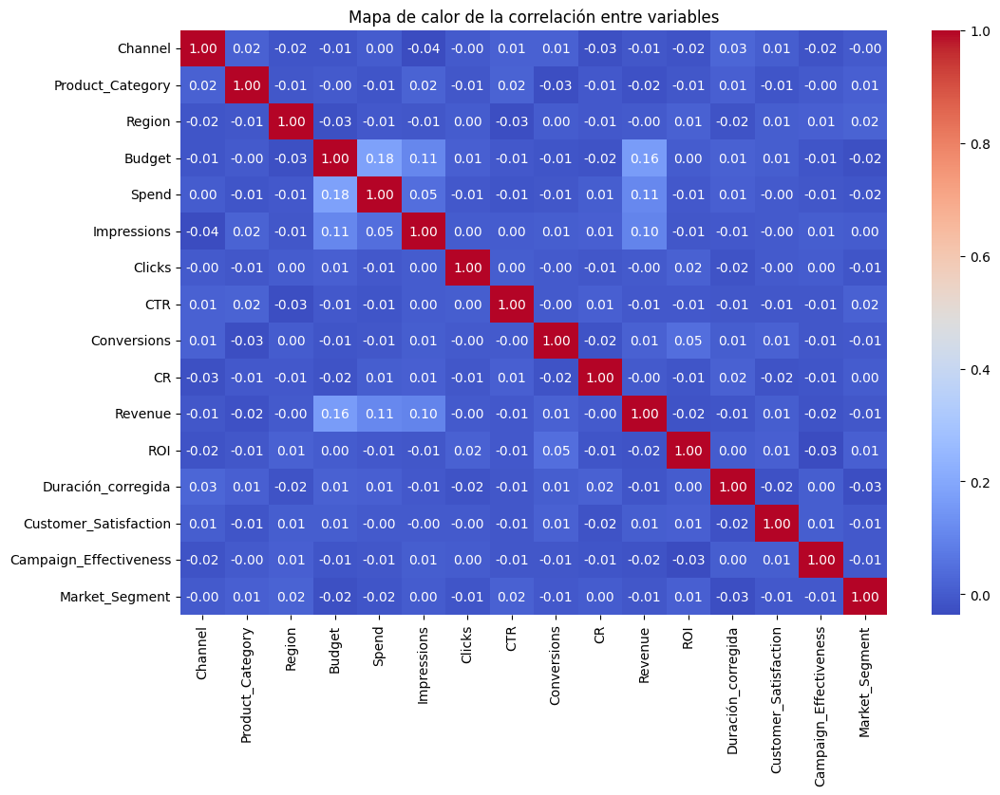

In [ ]:
# Crear una copia del dataframe para trabajar
df_copy_correlacion = df.copy()

# Columnas a convertir
columnas_a_convertir = ['Channel', 'Product_Category', 'Region', 'Market_Segment']

# Convertir las columnas categóricas a valores numéricos
for col in columnas_a_convertir:
    if df_copy_correlacion[col].dtype == 'object':
        le = LabelEncoder()
        df_copy_correlacion[col] = le.fit_transform(df_copy_correlacion[col].astype(str))

# Seleccionar las columnas relevantes para el análisis de correlación
columnas_relevantes_correlacion = [
    'Channel', 'Product_Category', 'Region', 'Budget', 'Spend', 'Impressions', 
    'Clicks', 'CTR', 'Conversions', 'CR', 'Revenue', 'ROI', 'Duración_corregida',
    'Customer_Satisfaction', 'Campaign_Effectiveness', 'Market_Segment'
]

# Calcular la matriz de correlación
matriz_correlacion = df_copy_correlacion[columnas_relevantes_correlacion].corr()

# Generar el mapa de calor
plt.figure(figsize=(12, 8))
sns.heatmap(matriz_correlacion, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Mapa de calor de la correlación entre variables')
plt.show()


Reparto por canal, producto y segmento.

In [ ]:
df_grouped = df.groupby(['Channel', 'Product_Category', 'Market_Segment']).size().reset_index(name='Count')

# Crear el gráfico de sunburst
fig = px.sunburst(
    df_grouped,
    path=['Channel', 'Product_Category', 'Market_Segment'],
    values='Count',
    title='Distribución de Canal, Producto y Segmento de Mercado',
    width=900,   
    height=900   
)

# Mostrar el gráfico
fig.show()


Buscar la relación de Budget y Spend

In [ ]:
fig = px.scatter(df, x='Budget', y='Spend', color='Channel', symbol='Product_Category', 
                 title='Relación entre Budget y Spend por Channel y Product_Category',
                 labels={'Budget': 'Presupuesto', 'Spend': 'Gasto'})
fig.show()


# KUALA LUMPUR

In [ ]:

df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

df_grouped = df_kuala_lumpur.groupby(['Channel', 'Product_Category', 'Market_Segment']).size().reset_index(name='Count')

fig = px.sunburst(
    df_grouped,
    path=['Channel', 'Product_Category', 'Market_Segment'],
    values='Count',
    title='Distribución de Canal, Producto y Segmento de Mercado en Kuala Lumpur',
    width=900,   
    height=900   
)

fig.show()


Tras comprobar los datos, fracciono en base a datos concretos de Channel, Product_Category, Region, Market_Segment para buscar relación con Spend en Kuala Lumpur

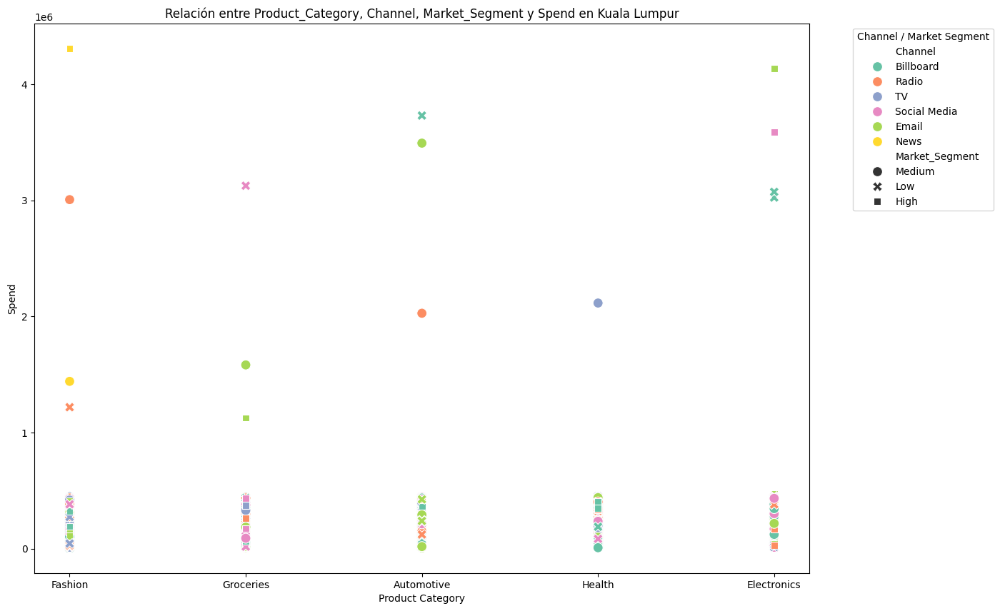

In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_kuala_lumpur, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Kuala Lumpur')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


Para analizar la relación entre las variables `Product_Category`, `Channel`, `Market_Segment` y `Spend` en Kuala Lumpur, observamos el gráfico de dispersión generado anteriormente. Aquí hay algunas observaciones y conclusiones:

1. **Datos Dispersos:**
    - Los datos dispersos indican que no hay una relación clara y consistente entre las variables `Product_Category`, `Channel`, `Market_Segment` y `Spend`. Esto puede deberse a la variabilidad inherente en los datos de marketing, donde diferentes campañas pueden tener diferentes niveles de gasto sin seguir un patrón específico.
    - La dispersión también puede sugerir que otros factores no considerados en este análisis podrían estar influyendo en el gasto (`Spend`).

2. **Relaciones Inferidas:**
    - **Product_Category y Spend:** Algunas categorías de productos pueden tener un gasto más alto en promedio. Por ejemplo, si observamos que ciertas categorías de productos (`Product_Category`) tienen puntos de datos más altos en el eje `Spend`, podemos inferir que estas categorías tienden a gastar más en campañas de marketing.
    - **Channel y Spend:** Si ciertos canales (`Channel`) tienen puntos de datos más altos en el eje `Spend`, podemos inferir que estos canales son más costosos o que se invierte más en ellos. Por ejemplo, canales como `TV` o `Billboard` pueden tener un gasto más alto en comparación con canales digitales como `Email` o `Social Media`.
    - **Market_Segment y Spend:** Si ciertos segmentos de mercado (`Market_Segment`) tienen puntos de datos más altos en el eje `Spend`, podemos inferir que estos segmentos son más valiosos o requieren más inversión para alcanzar a los consumidores.


In [ ]:
# Filtrar los datos donde la región es Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Seleccionar las columnas deseadas
tabla_kuala_lumpur = df_kuala_lumpur[['Product_Category', 'Channel', 'Market_Segment', 'Spend']]

# Mostrar la tabla
print(tabla_kuala_lumpur)


     Product_Category       Channel Market_Segment     Spend
0             Fashion     Billboard         Medium  197038.0
4             Fashion         Radio            Low   34365.0
7           Groceries     Billboard            Low   64007.0
13         Automotive            TV            Low  238467.0
26          Groceries            TV         Medium  322417.0
...               ...           ...            ...       ...
4994       Automotive            TV            Low  233849.0
4995       Automotive         Email            Low  239182.0
4996      Electronics         Radio            Low  381641.0
4997       Automotive         Radio            Low  122475.0
4998      Electronics  Social Media         Medium  433558.0

[1049 rows x 4 columns]


In [ ]:
tabla_kuala_lumpur.isnull().sum()


Product_Category      0
Channel               0
Market_Segment        0
Spend               107
dtype: int64

In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestRegressor  # Import the missing module

# Encode categorical variables
label_encoders = {}
df_kuala_lumpur_copy = df_kuala_lumpur.copy()  # Define df_kuala_lumpur_copy
for col in columnas_relevantes:
    le = LabelEncoder()
    df_kuala_lumpur_copy[col] = le.fit_transform(df_kuala_lumpur_copy[col].astype(str))
    label_encoders[col] = le

# Dividir los datos en entrenamiento y prueba
df_train = df_kuala_lumpur_copy[df_kuala_lumpur_copy['Spend'].notna()]
df_test = df_kuala_lumpur_copy[df_kuala_lumpur_copy['Spend'].isna()]

# Definir las características (X) y la variable objetivo (y)
X_train = df_train[columnas_relevantes]
y_train = df_train['Spend']
X_test = df_test[columnas_relevantes]

# Crear y entrenar el modelo de regresión
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Verificar si df_test está vacío antes de predecir
if not df_test.empty:
    # Predecir los valores faltantes en 'Spend'
    y_pred = model.predict(X_test)

    # Rellenar los valores nulos en 'Spend' con las predicciones
    df_kuala_lumpur_copy.loc[df_kuala_lumpur_copy['Spend'].isna(), 'Spend'] = y_pred

# Verificar que no haya valores nulos en 'Spend'
print(df_kuala_lumpur_copy['Spend'].isnull().sum())


0


In [ ]:
# Actualizar los valores de 'Spend' en el dataframe original 'df' con los valores corregidos de 'df_kuala_lumpur_copy'
df.loc[df_kuala_lumpur_copy.index, 'Spend'] = df_kuala_lumpur_copy['Spend']

# Actualizar la tabla 'tabla_kuala_lumpur' con los valores corregidos de 'Spend'
tabla_kuala_lumpur['Spend'] = df.loc[tabla_kuala_lumpur.index, 'Spend']

# Mostrar la tabla actualizada
print(tabla_kuala_lumpur)


     Product_Category       Channel Market_Segment  Spend
0             Fashion     Billboard         Medium  245.0
4             Fashion         Radio            Low  586.0
7           Groceries     Billboard            Low  869.0
13         Automotive            TV            Low  342.0
26          Groceries            TV         Medium  538.0
...               ...           ...            ...    ...
4994       Automotive            TV            Low  328.0
4995       Automotive         Email            Low  345.0
4996      Electronics         Radio            Low  674.0
4997       Automotive         Radio            Low   56.0
4998      Electronics  Social Media         Medium  784.0

[1049 rows x 4 columns]


C:\Users\Usuario\AppData\Local\Temp\ipykernel_6440\2647698668.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tabla_kuala_lumpur['Spend'] = df.loc[tabla_kuala_lumpur.index, 'Spend']


In [58]:
tabla_kuala_lumpur.isnull().sum()


Product_Category    0
Channel             0
Market_Segment      0
Spend               0
dtype: int64

Volvemos a ver como se relacionan los datos en el gráfico.

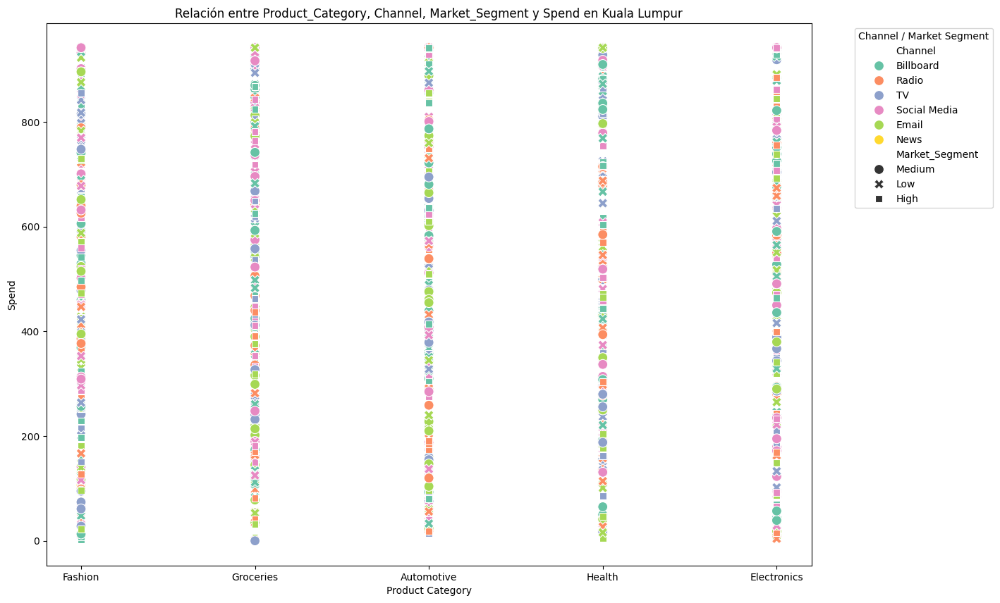

In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_kuala_lumpur, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Kuala Lumpur')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [ ]:
# Definir los outliers usando el método del rango intercuartílico (IQR)
# Seleccionar solo las columnas numéricas
tabla_kuala_lumpur_numerica = tabla_kuala_lumpur.select_dtypes(include=[np.number])

Q1 = tabla_kuala_lumpur_numerica.quantile(0.25)
Q3 = tabla_kuala_lumpur_numerica.quantile(0.75)
IQR = Q3 - Q1

# Definir los límites para los outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identificar los outliers
outliers = (tabla_kuala_lumpur_numerica < lower_bound) | (tabla_kuala_lumpur_numerica > upper_bound)

# Calcular el porcentaje de outliers en cada columna
porcentaje_outliers = outliers.sum() / len(tabla_kuala_lumpur_numerica) * 100

# Calcular la media y la mediana de las columnas con y sin outliers
media_con_outliers = tabla_kuala_lumpur_numerica.mean()
mediana_con_outliers = tabla_kuala_lumpur_numerica.median()
media_sin_outliers = tabla_kuala_lumpur_numerica[~outliers].mean()
mediana_sin_outliers = tabla_kuala_lumpur_numerica[~outliers].median()

# Calcular la desviación estándar de las columnas con y sin outliers
desviacion_con_outliers = tabla_kuala_lumpur_numerica.std()
desviacion_sin_outliers = tabla_kuala_lumpur_numerica[~outliers].std()

# Calcular el impacto de los outliers en la suma total de cada columna
impacto_outliers = (tabla_kuala_lumpur_numerica[outliers].sum() / tabla_kuala_lumpur_numerica.sum()) * 100

# Mostrar los resultados
print("Porcentaje de outliers en cada columna:")
print(porcentaje_outliers)
print("\nMedia con outliers:")
print(media_con_outliers)
print("\nMediana con outliers:")
print(mediana_con_outliers)
print("\nMedia sin outliers:")
print(media_sin_outliers)
print("\nMediana sin outliers:")
print(mediana_sin_outliers)
print("\nDesviación estándar con outliers:")
print(desviacion_con_outliers)
print("\nDesviación estándar sin outliers:")
print(desviacion_sin_outliers)
print("\nImpacto de los outliers en la suma total de cada columna:")
print(impacto_outliers)


Porcentaje de outliers en cada columna:
Spend    0.0
dtype: float64

Media con outliers:
Spend    518.593899
dtype: float64

Mediana con outliers:
Spend    524.0
dtype: float64

Media sin outliers:
Spend    518.593899
dtype: float64

Mediana sin outliers:
Spend    524.0
dtype: float64

Desviación estándar con outliers:
Spend    294.703637
dtype: float64

Desviación estándar sin outliers:
Spend    294.703637
dtype: float64

Impacto de los outliers en la suma total de cada columna:
Spend    0.0
dtype: float64


In [ ]:
from sklearn.ensemble import IsolationForest

# Seleccionar la columna 'Spend' de la tabla_kuala_lumpur
X = tabla_kuala_lumpur[['Spend']]

# Crear el modelo Isolation Forest
iso_forest = IsolationForest(contamination=0.015, random_state=42)
iso_forest.fit(X)

# Predecir anomalías (-1 es outlier, 1 es normal)
tabla_kuala_lumpur['anomaly'] = iso_forest.predict(X)

# Filtrar los outliers
outliers = tabla_kuala_lumpur[tabla_kuala_lumpur['anomaly'] == -1]
tabla_kuala_lumpur_clean = tabla_kuala_lumpur[tabla_kuala_lumpur['anomaly'] == 1]

# Mostrar los resultados
print("Outliers detectados:")
print(outliers)
print("\nTabla sin outliers:")
print(tabla_kuala_lumpur_clean)
tabla_kuala_lumpur.shape


Outliers detectados:
     Product_Category       Channel Market_Segment  Spend  anomaly
457         Groceries         Email           High    7.0       -1
924        Automotive            TV           High   14.0       -1
1077          Fashion     Billboard           High   12.0       -1
1446          Fashion  Social Media            Low   10.0       -1
1488          Fashion         Radio         Medium   11.0       -1
1564        Groceries         Radio            Low    1.0       -1
1677          Fashion     Billboard           High    6.0       -1
2267        Groceries            TV         Medium    0.0       -1
2763          Fashion     Billboard           High    2.0       -1
2765      Electronics         Email         Medium    9.0       -1
2881           Health  Social Media           High    3.0       -1
3140      Electronics         Radio            Low    4.0       -1
3668          Fashion     Billboard           High    8.0       -1
3772      Electronics         Radio      

(1049, 5)

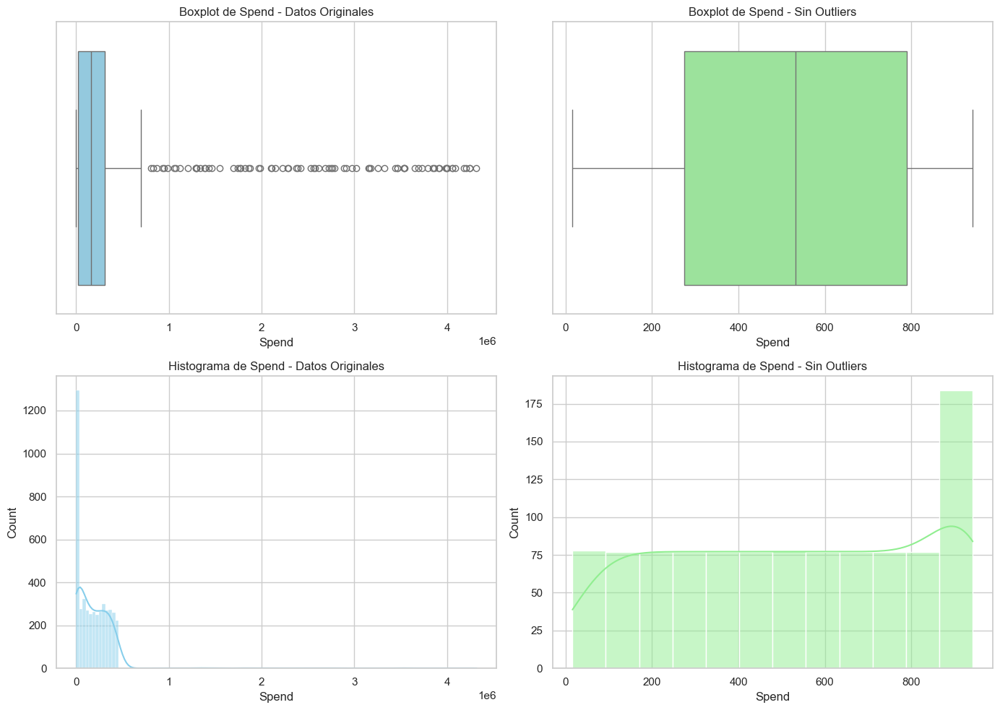

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar el estilo de Seaborn
sns.set(style='whitegrid')

# Crear una figura con 2 filas y 2 columnas de subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Gráfico de caja para 'Spend' en el dataframe original
sns.boxplot(data=df, x='Spend', ax=axes[0, 0], color='skyblue')
axes[0, 0].set_title('Boxplot de Spend - Datos Originales')

# Histograma para 'Spend' en el dataframe original
sns.histplot(data=df, x='Spend', kde=True, ax=axes[1, 0], color='skyblue')
axes[1, 0].set_title('Histograma de Spend - Datos Originales')

# Gráfico de caja para 'Spend' en el dataframe sin outliers
sns.boxplot(data=tabla_kuala_lumpur_clean, x='Spend', ax=axes[0, 1], color='lightgreen')
axes[0, 1].set_title('Boxplot de Spend - Sin Outliers')

# Histograma para 'Spend' en el dataframe sin outliers
sns.histplot(data=tabla_kuala_lumpur_clean, x='Spend', kde=True, ax=axes[1, 1], color='lightgreen')
axes[1, 1].set_title('Histograma de Spend - Sin Outliers')

# Ajustar el espacio entre subplots
plt.tight_layout()

# Mostrar las gráficas
plt.show()


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Agrupar por Channel, Market_Segment y Product_Category y calcular las estadísticas
estadisticas_spend = df_kuala_lumpur.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var'])

# Mostrar las estadísticas
print(estadisticas_spend)


                                                 mean  median            var
Channel   Market_Segment Product_Category                                   
Billboard High           Automotive        647.500000   760.5   84564.382353
                         Electronics       654.625000   698.0   91490.267857
                         Fashion           498.833333   491.5  110192.927536
                         Groceries         679.000000   751.0   63011.666667
                         Health            602.571429   652.5   52494.725275
...                                               ...     ...            ...
TV        Medium         Automotive        419.636364   418.0   51007.454545
                         Electronics       586.000000   569.0   61972.444444
                         Fashion           441.666667   516.5  104268.424242
                         Groceries         520.187500   548.0   93435.629167
                         Health            543.571429   512.0  123314.417582

In [ ]:
# Asegurarse de que la columna 'Start_Date_Corrected' esté en tabla_kuala_lumpur
tabla_kuala_lumpur['Start_Date_Corrected'] = df_kuala_lumpur['Start_Date_Corrected']

# Localizar los datos de la columna 'Start_Date_Corrected' en la tabla_kuala_lumpur
start_date_corrected_kuala_lumpur = tabla_kuala_lumpur['Start_Date_Corrected']

# Contar los valores nulos en la columna 'Start_Date_Corrected'
nulos_start_date_corrected = start_date_corrected_kuala_lumpur.isnull().sum()

print(f"Cantidad de valores nulos en 'Start_Date_Corrected' para Kuala Lumpur: {nulos_start_date_corrected}")


Cantidad de valores nulos en 'Start_Date_Corrected' para Kuala Lumpur: 6


In [ ]:
tabla_kuala_lumpur.isnull().sum()


Product_Category        0
Channel                 0
Market_Segment          0
Spend                   0
anomaly                 0
Start_Date_Corrected    6
dtype: int64

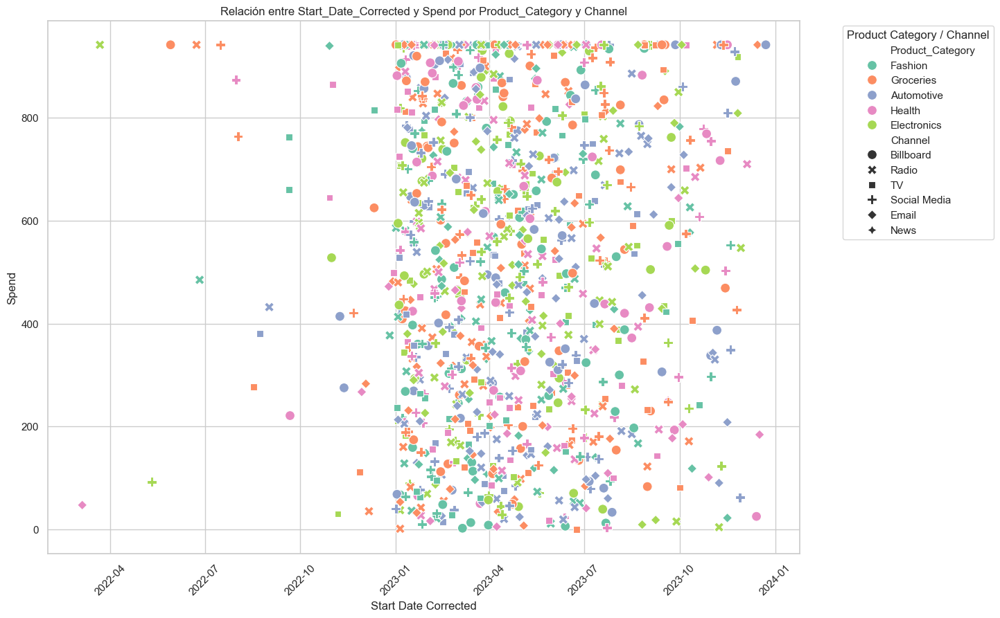

In [ ]:
# Introducir los datos de Start_Date_Corrected en la tabla_kuala_lumpur
tabla_kuala_lumpur['Start_Date_Corrected'] = df_kuala_lumpur['Start_Date_Corrected']

# Crear una gráfica de relación entre las variables con el momento de inicio de campaña
plt.figure(figsize=(14, 10))
sns.scatterplot(data=tabla_kuala_lumpur, x='Start_Date_Corrected', y='Spend', hue='Product_Category', style='Channel', palette='Set2', s=100)
plt.title('Relación entre Start_Date_Corrected y Spend por Product_Category y Channel')
plt.xlabel('Start Date Corrected')
plt.ylabel('Spend')
plt.legend(title='Product Category / Channel', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()


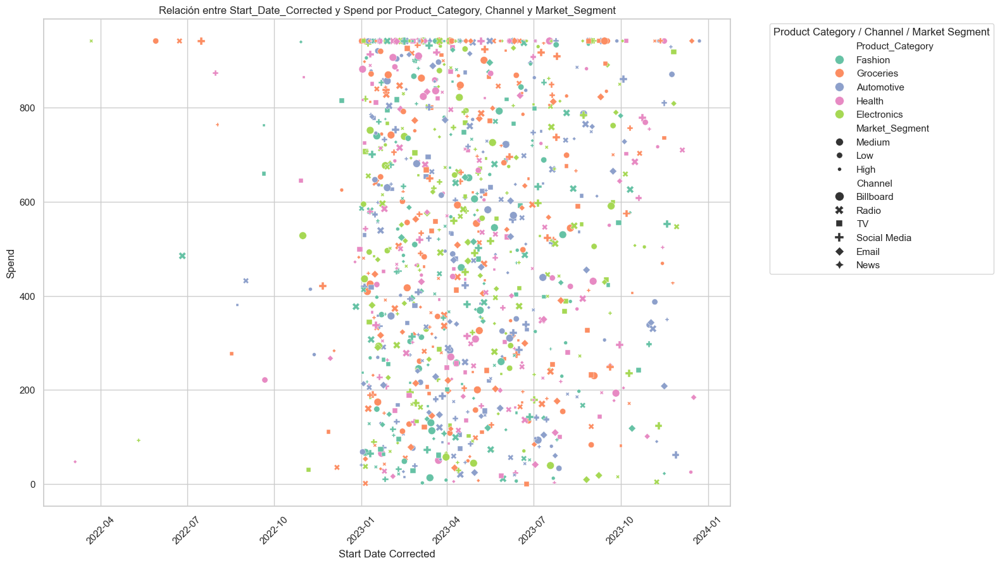

Leyenda de Market_Segment:
Medium: Medium
Low: Low
High: High


In [ ]:
# Introducir los datos de Market_Segment en la tabla_kuala_lumpur
tabla_kuala_lumpur['Market_Segment'] = df_kuala_lumpur['Market_Segment']

# Crear una gráfica de relación entre las variables con el momento de inicio de campaña
plt.figure(figsize=(14, 10))
sns.scatterplot(data=tabla_kuala_lumpur, x='Start_Date_Corrected', y='Spend', hue='Product_Category', style='Channel', size='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Start_Date_Corrected y Spend por Product_Category, Channel y Market_Segment')
plt.xlabel('Start Date Corrected')
plt.ylabel('Spend')
plt.legend(title='Product Category / Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()

# Mostrar la leyenda lateral con los datos reales de los símbolos
print("Leyenda de Market_Segment:")
for segment in df_kuala_lumpur['Market_Segment'].unique():
    print(f"{segment}: {df_kuala_lumpur[df_kuala_lumpur['Market_Segment'] == segment]['Market_Segment'].iloc[0]}")


In [68]:
# Identificar las columnas con datos nulos
columnas_con_nulos = tabla_kuala_lumpur.isnull().sum()

# Filtrar solo las columnas que tienen datos nulos
columnas_con_nulos = columnas_con_nulos[columnas_con_nulos > 0]

print("Columnas con datos nulos y su cantidad:")
print(columnas_con_nulos)


Columnas con datos nulos y su cantidad:
Start_Date_Corrected    6
dtype: int64


Introducimos el modelo Arima para predecir la posible serie temporal de los datos Spend con respecto a la fecha de inicio introducida.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur'].copy()

# 2. Preparar la serie temporal
df_kuala_lumpur['Start_Date_Corrected'] = pd.to_datetime(df_kuala_lumpur['Start_Date_Corrected'])
df_kuala_lumpur.set_index('Start_Date_Corrected', inplace=True)
df_kuala_lumpur.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_kuala_lumpur['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Kuala Lumpur')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


ModuleNotFoundError: No module named 'statsmodels'

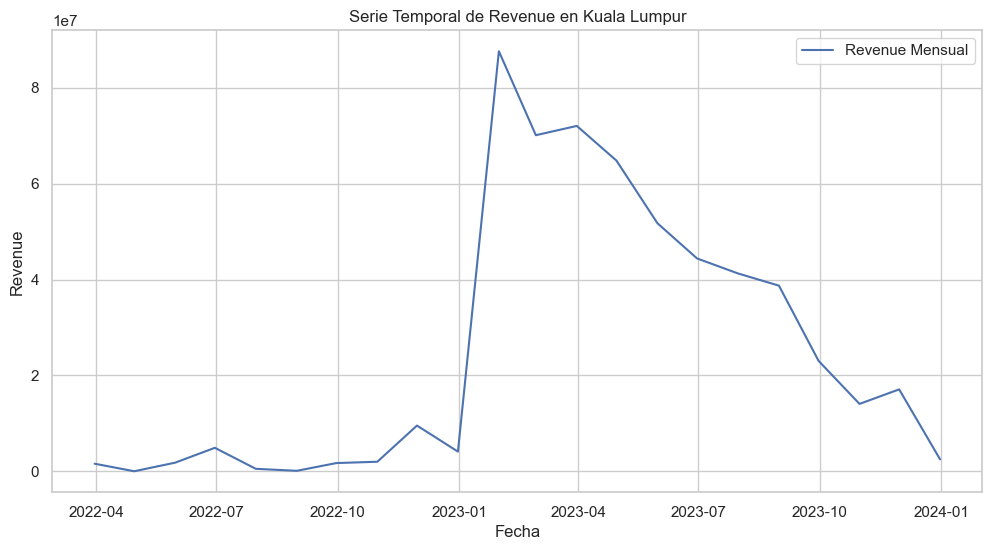

Estadístico ADF: -5.239570719802367
p-value: 7.2957431734807896e-06
Estadístico ADF después de diferenciar: -5.239570719802367
p-value: 7.2957431734807896e-06


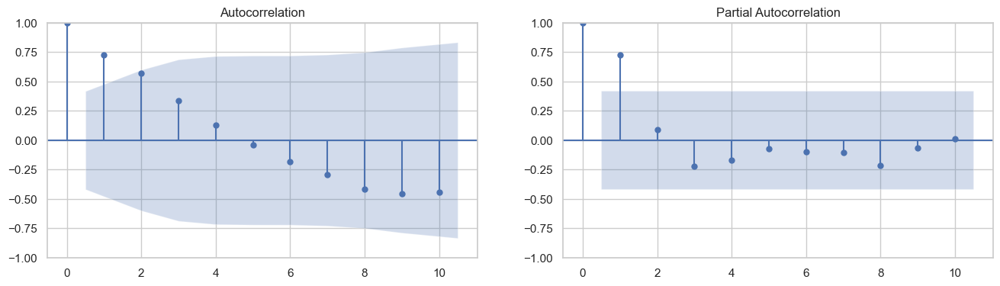

                               SARIMAX Results                                
Dep. Variable:                Revenue   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -310.598
Date:               do., 03 nov. 2024   AIC                            629.195
Time:                        21:31:11   BIC                            632.528
Sample:                    03-31-2022   HQIC                           629.527
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.695e+07   1.14e-08   2.36e+15      0.000     2.7e+07     2.7e+07
ar.L1          0.7695      0.740      1.040      0.298      -0.681       2.220
ma.L1         -0.0964      1.914     -0.050      0.9

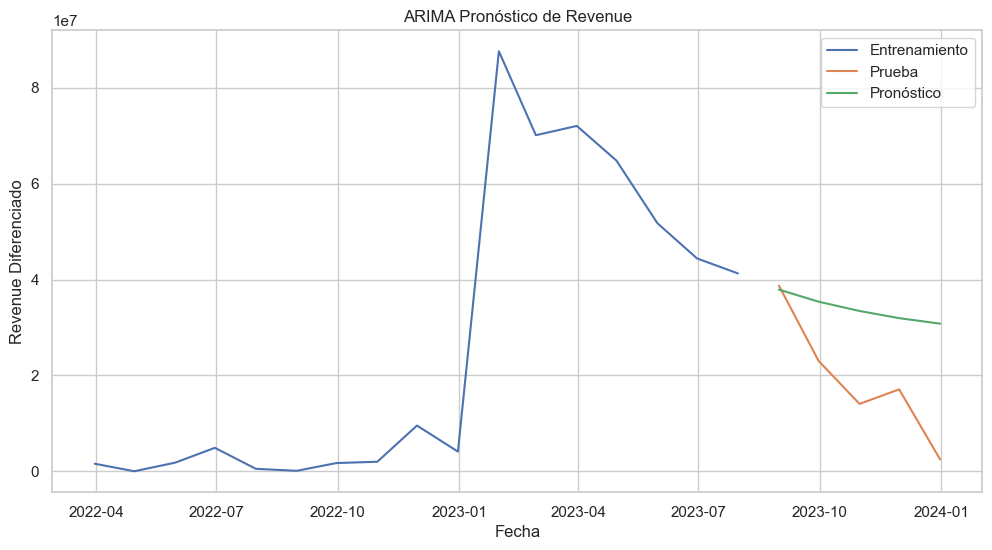

RMSE: 4197.1737731539615


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur'].copy()

# 2. Preparar la serie temporal
df_kuala_lumpur['Start_Date_Corrected'] = pd.to_datetime(df_kuala_lumpur['Start_Date_Corrected'])
df_kuala_lumpur.set_index('Start_Date_Corrected', inplace=True)
df_kuala_lumpur.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_kuala_lumpur['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Kuala Lumpur')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Tras la limpieza de datos nulos en las variables categórica de nuestra tabla y localizar nuestro estudio en Kuala Lumpur como primer punto geográfico, tomar nuestra primera variable numérica para estudiar y transformar, Spend. Tras utilizar los datos vecinos relacionados con las variables categóricas y eliminar sus nulos, también corregimos sus valores fuera de rango o atípico. No notandose una importante afectación a su media, mediana ni varianza.
Posteriormente hice un estudio con el modelo Arima buscando la estacionalidad para los conjuntos de datos en Kuala Lumpur, antes y después de los cambios en Spend. No siendo demasiado relevante para hacer una predicción, pues sólo registra 8 observaciones en todos los casos; en las 4 observaciones se ve que inicialmente no es una serie estacionaria aunque tras la prueba ADF los valores tienen mayor significado en los modelos con los datos corregidos, siempre hablando de los datos Spend y categóricos, ninguna modificación en Revenue. También el ajuste del modelo mejora con los nuevos datos pero la autorregresión(AR) y la media móvil(MA) siguen siendo no significativos por tanto la relación de todos ellos no facilita un modelo predicitivo. Por tanto, no existe relación entre las variables para que unas predigan el devenir de las otras en gran medida por ahora teniendo solo estos datos, ni con los datos de Spend corregidos, numéricos. Aunque la gráfica de la serie temporal y Arima tanto de Spend como de Revenue tienen una forma similar, que indica que a lo largo de este año 2023 han tenido cierto paralelismo. Lo que me hace concluir que el gasto y el ingreso en campañas a nivel global sin ningún tipo de pormenorización de el resto de cuestiones ha ido de más a menos durante todo el año, como demuestra la gráfica de serie temporal. La gráfica del modelo Arima también nos muestra que el gasto es mayor al inicio de año haciendo una caida brusca hasta mayo y el ingreso hace una caida similar hasta junio, el gasto hace un pequeño crecimiento hasta julio y el ingreso le sigue y alcanza su cumbre un mes después. En el resto de la gráfica de este modelo que acaba en octubre, el gasto reinicia un incremento en septiembre pero no alcanzando aún valores positivos mientras que el ingreso sigue cayendo. Esto es lo que el modelo Arima nos muestra con los datos obtenidos, pero no dejan de ser 8 observaciones temporales.

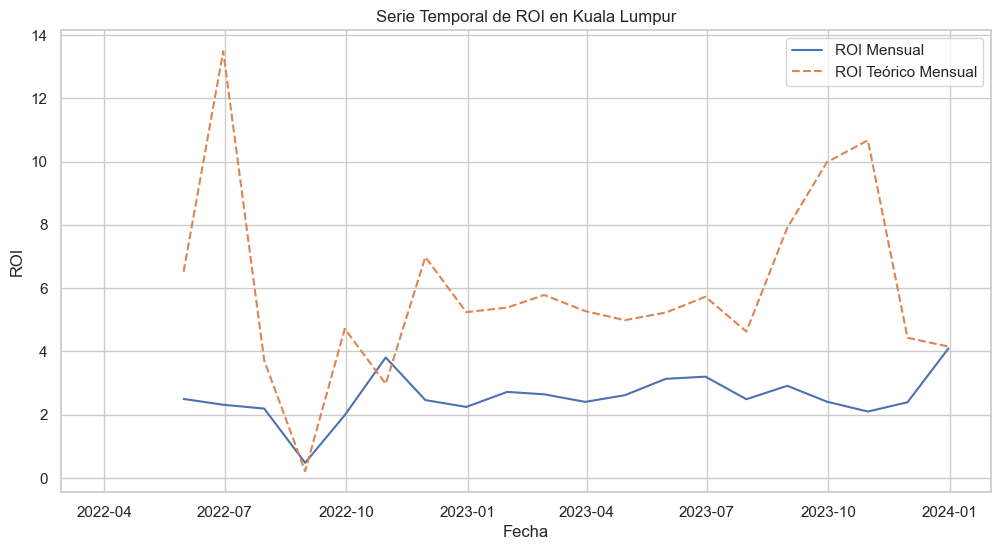

Estadístico ADF (ROI): -3.358331383398098
p-value (ROI): 0.01246406977733569
Estadístico ADF (ROI Teórico): -2.8992760348270026
p-value (ROI Teórico): 0.04543224956462964
Estadístico ADF después de diferenciar (ROI): -3.358331383398098
p-value después de diferenciar (ROI): 0.01246406977733569
Estadístico ADF después de diferenciar (ROI Teórico): -2.8992760348270026
p-value después de diferenciar (ROI Teórico): 0.04543224956462964


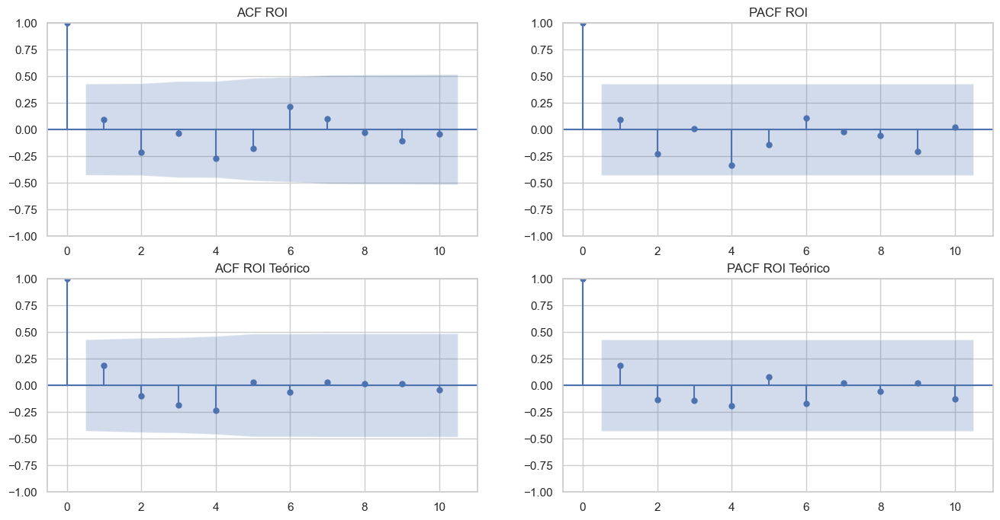

                               SARIMAX Results                                
Dep. Variable:                    ROI   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                 -18.111
Date:               do., 03 nov. 2024   AIC                             44.221
Time:                        21:31:13   BIC                             47.554
Sample:                    03-31-2022   HQIC                            44.552
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.7681      0.312      8.882      0.000       2.157       3.379
ar.L1          0.0593      0.400      0.148      0.882      -0.725       0.843
ma.L1          0.9999   1346.201      0.001      0.9

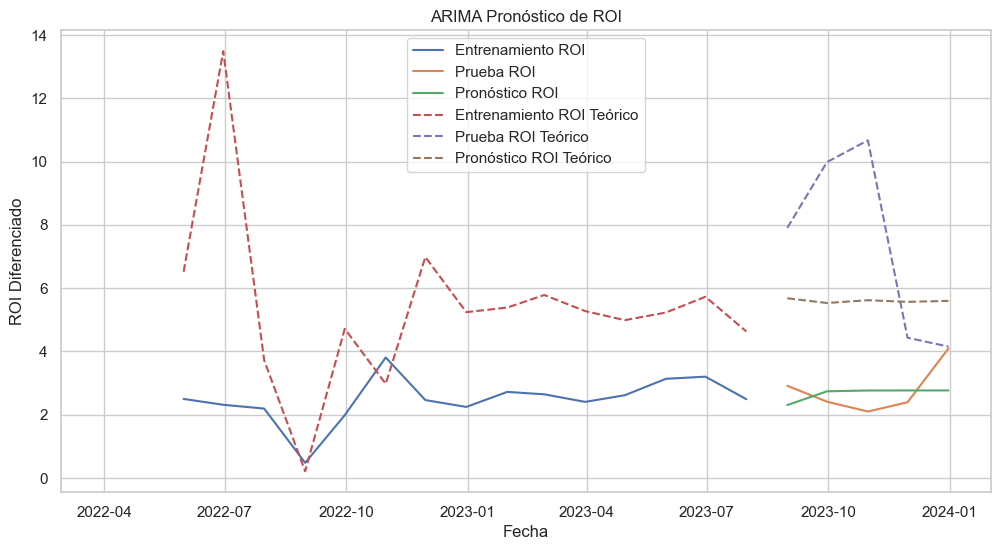

RMSE (ROI): 0.8672788070416558
RMSE (ROI Teórico): 1.810147226759304


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

import matplotlib.pyplot as plt
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA

# 1. Filtrar datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur'].copy()

# 2. Preparar la serie temporal
df_kuala_lumpur['Start_Date_Corrected'] = pd.to_datetime(df_kuala_lumpur['Start_Date_Corrected'])
df_kuala_lumpur.set_index('Start_Date_Corrected', inplace=True)
df_kuala_lumpur.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly_roi = df_kuala_lumpur['ROI'].resample('M').mean()
df_monthly_roi_corrected = df_kuala_lumpur['ROI_Teorico'].resample('M').mean()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_roi, label='ROI Mensual')
plt.plot(df_monthly_roi_corrected, label='ROI Teórico Mensual', linestyle='--')
plt.title('Serie Temporal de ROI en Kuala Lumpur')
plt.xlabel('Fecha')
plt.ylabel('ROI')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result_roi = adfuller(df_monthly_roi.dropna())
result_roi_corrected = adfuller(df_monthly_roi_corrected.dropna())
print('Estadístico ADF (ROI):', result_roi[0])
print('p-value (ROI):', result_roi[1])
print('Estadístico ADF (ROI Teórico):', result_roi_corrected[0])
print('p-value (ROI Teórico):', result_roi_corrected[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result_roi[1] > 0.05:
    df_monthly_roi_diff = df_monthly_roi.diff().dropna()
else:
    df_monthly_roi_diff = df_monthly_roi

if result_roi_corrected[1] > 0.05:
    df_monthly_roi_corrected_diff = df_monthly_roi_corrected.diff().dropna()
else:
    df_monthly_roi_corrected_diff = df_monthly_roi_corrected

# Repetir la prueba ADF después de diferenciar
result_roi_diff = adfuller(df_monthly_roi_diff.dropna())
result_roi_corrected_diff = adfuller(df_monthly_roi_corrected_diff.dropna())
print('Estadístico ADF después de diferenciar (ROI):', result_roi_diff[0])
print('p-value después de diferenciar (ROI):', result_roi_diff[1])
print('Estadístico ADF después de diferenciar (ROI Teórico):', result_roi_corrected_diff[0])
print('p-value después de diferenciar (ROI Teórico):', result_roi_corrected_diff[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(2, 2, figsize=(16, 8))
max_lags = min(10, len(df_monthly_roi_diff.dropna()) // 2)
plot_acf(df_monthly_roi_diff.dropna(), lags=max_lags, ax=ax[0, 0])
plot_pacf(df_monthly_roi_diff.dropna(), lags=max_lags, ax=ax[0, 1])
plot_acf(df_monthly_roi_corrected_diff.dropna(), lags=max_lags, ax=ax[1, 0])
plot_pacf(df_monthly_roi_corrected_diff.dropna(), lags=max_lags, ax=ax[1, 1])
ax[0, 0].set_title('ACF ROI')
ax[0, 1].set_title('PACF ROI')
ax[1, 0].set_title('ACF ROI Teórico')
ax[1, 1].set_title('PACF ROI Teórico')
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_roi_diff) * 0.8)
train_roi, test_roi = df_monthly_roi_diff[:train_size], df_monthly_roi_diff[train_size:]
train_roi_corrected, test_roi_corrected = df_monthly_roi_corrected_diff[:train_size], df_monthly_roi_corrected_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model_roi = ARIMA(train_roi, order=(1, 0, 1))
model_fit_roi = model_roi.fit()

model_roi_corrected = ARIMA(train_roi_corrected, order=(1, 0, 1))
model_fit_roi_corrected = model_roi_corrected.fit()

# 9. Evaluar el modelo
print(model_fit_roi.summary())
print(model_fit_roi_corrected.summary())

# 10. Pronosticar
forecast_roi = model_fit_roi.forecast(steps=len(test_roi))
forecast_roi_series = pd.Series(forecast_roi, index=test_roi.index)

forecast_roi_corrected = model_fit_roi_corrected.forecast(steps=len(test_roi_corrected))
forecast_roi_corrected_series = pd.Series(forecast_roi_corrected, index=test_roi_corrected.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train_roi, label='Entrenamiento ROI')
plt.plot(test_roi, label='Prueba ROI')
plt.plot(forecast_roi_series, label='Pronóstico ROI')
plt.plot(train_roi_corrected, label='Entrenamiento ROI Teórico', linestyle='--')
plt.plot(test_roi_corrected, label='Prueba ROI Teórico', linestyle='--')
plt.plot(forecast_roi_corrected_series, label='Pronóstico ROI Teórico', linestyle='--')
plt.title('ARIMA Pronóstico de ROI')
plt.xlabel('Fecha')
plt.ylabel('ROI Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse_roi = np.sqrt(root_mean_squared_error(test_roi, forecast_roi))
rmse_roi_corrected = np.sqrt(root_mean_squared_error(test_roi_corrected, forecast_roi_corrected))
print('RMSE (ROI):', rmse_roi)
print('RMSE (ROI Teórico):', rmse_roi_corrected)


Este resultado comparativo de ROI y el ROI calculado por mi inicialmente como ROI_teórico, tras hacer Renevenue/Spend me hace desestimar este valor definitivamente, pues el dato inicial no hace referencia en ningún caso a su definición.

### Modelo SARIMA
Utilizamos el método Sarima en comparación con el Arima pues al tener tan pocos periodos de estudio (8) parece más aconsejable para ver si existe o no alguna relación modelable en los datos.

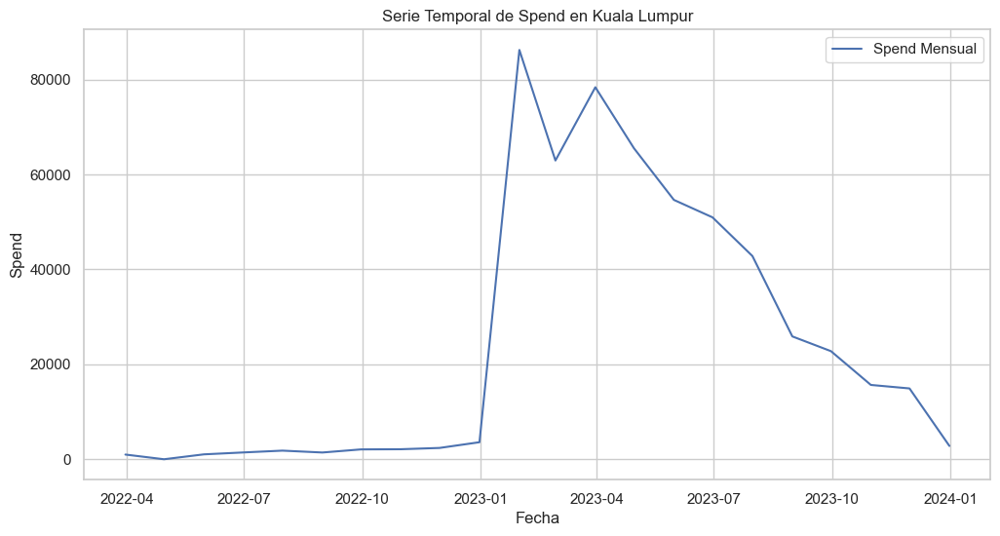

Estadístico ADF: -4.838986890641295
p-value: 4.577714691109884e-05
Estadístico ADF después de diferenciar: -4.838986890641295
p-value: 4.577714691109884e-05


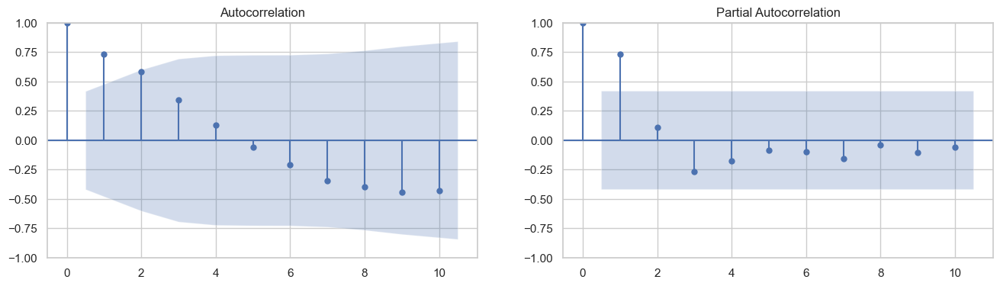

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                   0.000
Date:                           do., 03 nov. 2024   AIC                             10.000
Time:                                    21:31:15   BIC                              6.931
Sample:                                03-31-2022   HQIC                             3.266
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000         -0       -inf      0.000       1.000       1.000
ma.L1         -0.9987    1.2e-07  -

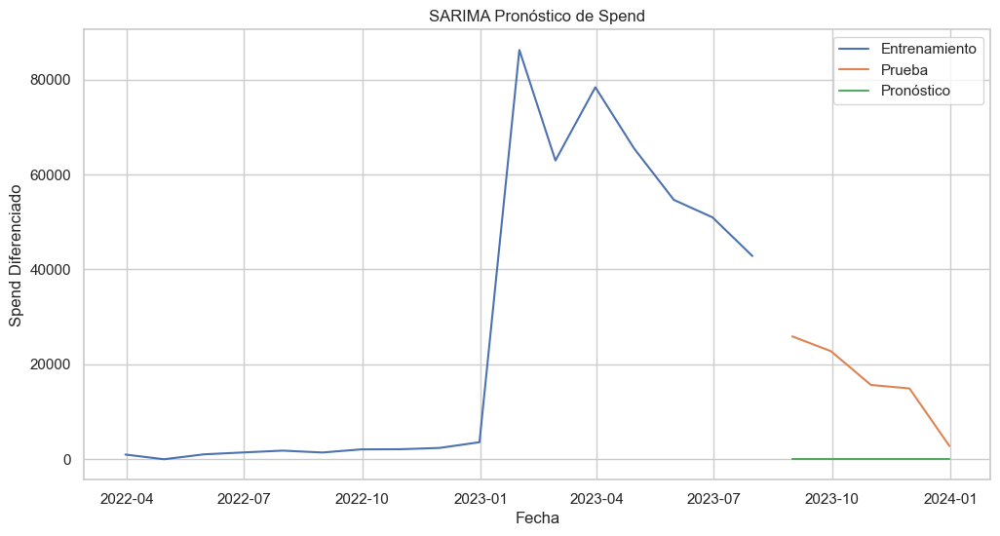

RMSE: 135.057175474277


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur'].copy()

# 2. Preparar la serie temporal
df_kuala_lumpur['Start_Date_Corrected'] = pd.to_datetime(df_kuala_lumpur['Start_Date_Corrected'])
df_kuala_lumpur.set_index('Start_Date_Corrected', inplace=True)
df_kuala_lumpur.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_kuala_lumpur['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Kuala Lumpur')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


In [ ]:
# Asegurarse de que la columna 'Start_Date_Corrected' esté en df_kuala_lumpur
if 'Start_Date_Corrected' in df.columns:
    df_kuala_lumpur['Start_Date_Corrected'] = df['Start_Date_Corrected']
else:
    print("La columna 'Start_Date_Corrected' no existe en el dataframe 'df'.")


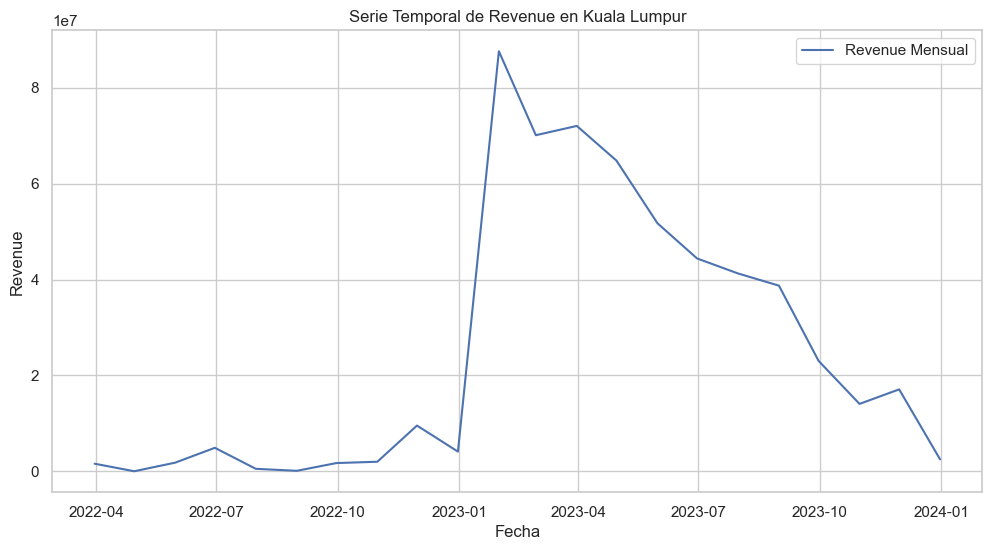

Estadístico ADF: -5.239570719802367
p-value: 7.2957431734807896e-06
Estadístico ADF después de diferenciar: -5.239570719802367
p-value: 7.2957431734807896e-06


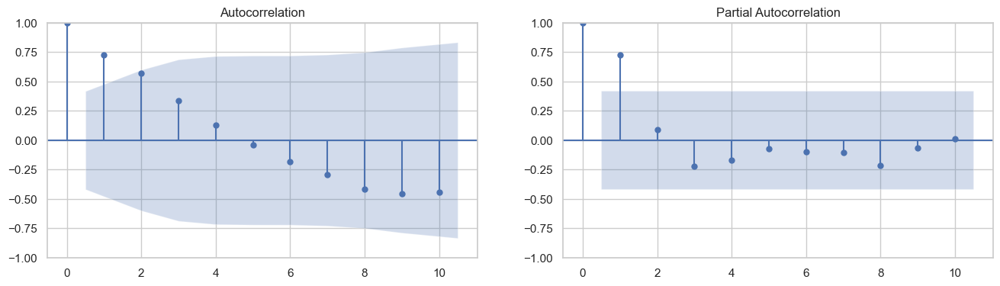

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                   0.000
Date:                           do., 03 nov. 2024   AIC                             10.000
Time:                                    21:31:16   BIC                              6.931
Sample:                                03-31-2022   HQIC                             3.266
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5927         -0       -inf      0.000       0.593       0.593
ma.L1          0.4704         -0   

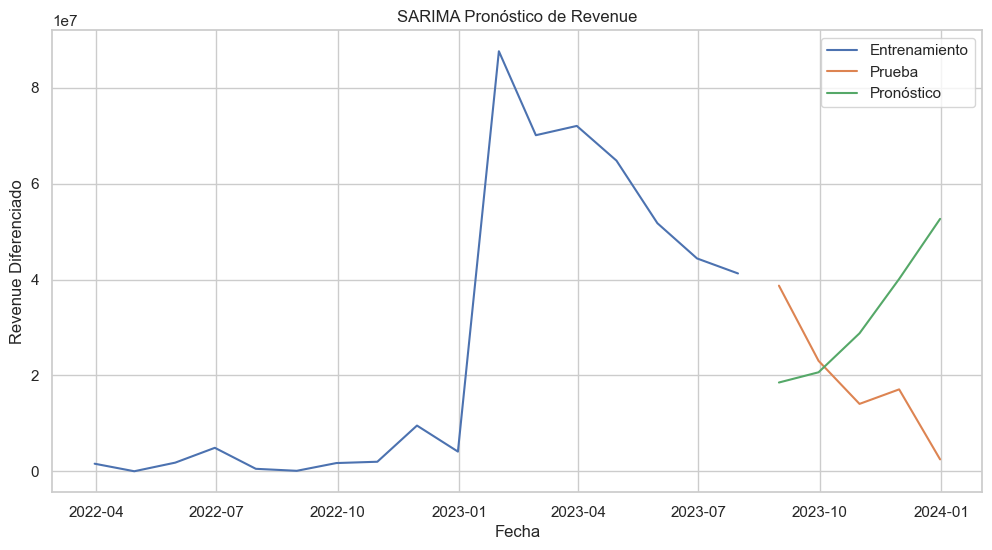

RMSE: 5208.690107193897


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'Start_Date_Corrected' column exists
if 'Start_Date_Corrected' in df_kuala_lumpur.columns:
    df_kuala_lumpur['Start_Date_Corrected'] = pd.to_datetime(df_kuala_lumpur['Start_Date_Corrected'])
else:
    print("Column 'Start_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_kuala_lumpur['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Kuala Lumpur')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Tras comprobar con modelo Sarima la correlación y estacionalidad de los datos, siguen dando el mismo resultado y conclusiones que el modelo Arima.

# Johor

In [ ]:
df_johor = df[df['Region'] == 'Johor']

df_grouped = df_johor.groupby(['Channel', 'Product_Category', 'Market_Segment']).size().reset_index(name='Count')

fig = px.sunburst(
    df_grouped,
    path=['Channel', 'Product_Category', 'Market_Segment'],
    values='Count',
    title='Distribución de Canal, Producto y Segmento de Mercado en Johor',
    width=900,   
    height=900   
)

fig.show()


Tras comprobar el régimen demografico de las regiones estudiadas la siguiente es Johor. Por tanto comienzo a comprobar los datos de Spend en esta región.

In [ ]:
# Filtrar los datos para Johor
df_kuala_lumpur = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_kuala_lumpur, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Johor')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


NameError: name 'df' is not defined

In [ ]:
# Filtrar los datos donde la región es Johor
df_johor = df[df['Region'] == 'Johor']

# Seleccionar las columnas deseadas
tabla_johor = df_johor[['Product_Category', 'Channel', 'Market_Segment', 'Spend']]

# Mostrar la tabla
print(tabla_johor)


     Product_Category       Channel Market_Segment         Spend
8         Electronics     Billboard           High  7.102700e+04
9          Automotive         Radio         Medium  2.979740e+05
11          Groceries            TV         Medium  3.450130e+05
18          Groceries            TV         Medium  3.561550e+05
19             Health     Billboard           High  1.707820e+05
22         Automotive         Radio           High  9.369900e+04
27            Fashion  Social Media         Medium  4.451770e+05
28        Electronics         Email           High  2.002630e+05
32            Fashion  Social Media           High           NaN
37        Electronics         Radio         Medium  1.054350e+05
38        Electronics     Billboard         Medium  3.941720e+05
56        Electronics     Billboard         Medium  3.066670e+05
61        Electronics            TV           High  1.621620e+05
67        Electronics          News         Medium  3.728380e+06
69        Electronics  So

In [ ]:
tabla_johor.isnull().sum()


Product_Category      0
Channel               0
Market_Segment        0
Spend               104
dtype: int64

In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestRegressor  # Import the missing module

# Encode categorical variables
label_encoders = {}
df_johor_copy = df_johor.copy()  # Define df_johor_copy
for col in columnas_relevantes:
    le = LabelEncoder()
    df_johor_copy[col] = le.fit_transform(df_johor_copy[col].astype(str))
    label_encoders[col] = le

# Dividir los datos en entrenamiento y prueba
df_train = df_johor_copy[df_johor_copy['Spend'].notna()]
df_test = df_johor_copy[df_johor_copy['Spend'].isna()]

# Definir las características (X) y la variable objetivo (y)
X_train = df_train[columnas_relevantes]
y_train = df_train['Spend']
X_test = df_test[columnas_relevantes]

# Crear y entrenar el modelo de regresión
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Verificar si df_test está vacío antes de predecir
if not df_test.empty:
    # Predecir los valores faltantes en 'Spend'
    y_pred = model.predict(X_test)

    # Rellenar los valores nulos en 'Spend' con las predicciones
    df_johor_copy.loc[df_johor_copy['Spend'].isna(), 'Spend'] = y_pred

# Verificar que no haya valores nulos en 'Spend'
print(df_johor_copy['Spend'].isnull().sum())


0


In [ ]:
# Actualizar los valores de 'Spend' en el dataframe original 'df' con los valores corregidos de 'df_johor_copy'
df.loc[df_johor_copy.index, 'Spend'] = df_johor_copy['Spend']

# Actualizar la tabla 'tabla_johor' con los valores corregidos de 'Spend'
tabla_johor['Spend'] = df.loc[tabla_johor.index, 'Spend']

# Mostrar la tabla actualizada
print(tabla_johor)


     Product_Category       Channel Market_Segment  Spend
8         Electronics     Billboard           High  819.0
9          Automotive         Radio         Medium  448.0
11          Groceries            TV         Medium  546.0
18          Groceries            TV         Medium  573.0
19             Health     Billboard           High  161.0
22         Automotive         Radio           High  873.0
27            Fashion  Social Media         Medium  760.0
28        Electronics         Email           High  238.0
32            Fashion  Social Media           High  886.0
37        Electronics         Radio         Medium   21.0
38        Electronics     Billboard         Medium  662.0
56        Electronics     Billboard         Medium  470.0
61        Electronics            TV           High  143.0
67        Electronics          News         Medium  622.0
69        Electronics  Social Media           High    8.0
74          Groceries  Social Media            Low  785.0
80         Aut

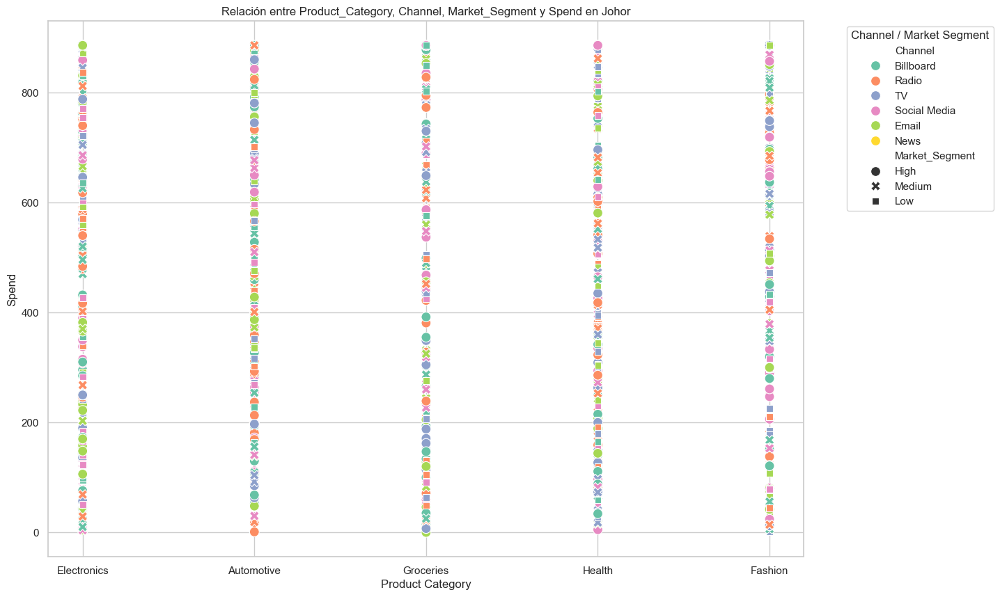

In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_johor, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Johor')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


Como en el modelo tratado de Kuala Lumpur no hubo cambios al intentar corregir outliers, ese paso lo veo innecesario aqui.

In [ ]:
from sklearn.ensemble import IsolationForest

# Seleccionar la columna 'Spend' de la tabla_johor
X = tabla_johor[['Spend']]

# Crear el modelo Isolation Forest
iso_forest = IsolationForest(contamination=0.015, random_state=42)
iso_forest.fit(X)

# Predecir anomalías (-1 es outlier, 1 es normal)
tabla_johor['anomaly'] = iso_forest.predict(X)

# Filtrar los outliers
outliers = tabla_johor[tabla_johor['anomaly'] == -1]
tabla_johor_clean = tabla_johor[tabla_johor['anomaly'] == 1]

# Mostrar los resultados
print("Outliers detectados:")
print(outliers)
print("\nTabla sin outliers:")
print(tabla_johor_clean)
tabla_johor.shape


Outliers detectados:
     Product_Category       Channel Market_Segment  Spend  anomaly
69        Electronics  Social Media           High    8.0       -1
266           Fashion            TV            Low    2.0       -1
564         Groceries         Email           High    0.0       -1
820            Health  Social Media           High    5.0       -1
1142          Fashion         Radio            Low   13.0       -1
1698        Groceries         Radio           High   11.0       -1
1736       Automotive         Radio           High    1.0       -1
2521          Fashion     Billboard         Medium    6.0       -1
3116      Electronics         Email            Low    3.0       -1
3411        Groceries         Email           High    9.0       -1
3559        Groceries            TV           High    7.0       -1
4083      Electronics  Social Media         Medium    4.0       -1
4321          Fashion            TV           High   12.0       -1
4775          Fashion         Radio      

(990, 5)

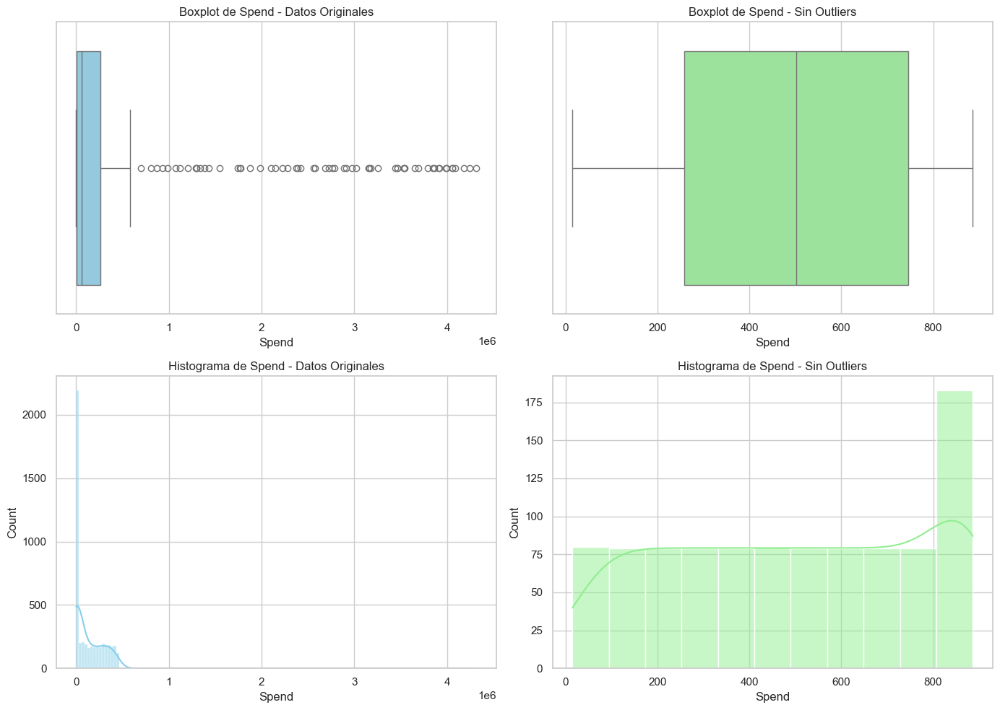

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar el estilo de Seaborn
sns.set(style='whitegrid')

# Crear una figura con 2 filas y 2 columnas de subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Gráfico de caja para 'Spend' en el dataframe original
sns.boxplot(data=df, x='Spend', ax=axes[0, 0], color='skyblue')
axes[0, 0].set_title('Boxplot de Spend - Datos Originales')

# Histograma para 'Spend' en el dataframe original
sns.histplot(data=df, x='Spend', kde=True, ax=axes[1, 0], color='skyblue')
axes[1, 0].set_title('Histograma de Spend - Datos Originales')

# Gráfico de caja para 'Spend' en el dataframe sin outliers
sns.boxplot(data=tabla_johor_clean, x='Spend', ax=axes[0, 1], color='lightgreen')
axes[0, 1].set_title('Boxplot de Spend - Sin Outliers')

# Histograma para 'Spend' en el dataframe sin outliers
sns.histplot(data=tabla_johor_clean, x='Spend', kde=True, ax=axes[1, 1], color='lightgreen')
axes[1, 1].set_title('Histograma de Spend - Sin Outliers')

# Ajustar el espacio entre subplots
plt.tight_layout()

# Mostrar las gráficas
plt.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Agrupar por Channel, Market_Segment y Product_Category y calcular las estadísticas
estadisticas_spend = df_johor.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var'])

# Mostrar las estadísticas
print(estadisticas_spend)


                                                    mean  median  \
Channel      Market_Segment Product_Category                       
Billboard    High           Automotive        476.500000   425.5   
                            Electronics       514.571429   502.0   
                            Fashion           385.750000   374.5   
                            Groceries         379.333333   303.0   
                            Health            411.357143   442.0   
             Low            Automotive        554.923077   512.0   
                            Electronics       523.315789   492.0   
                            Fashion           401.000000   464.0   
                            Groceries         541.166667   642.5   
                            Health            496.750000   546.5   
             Medium         Automotive        422.000000   337.0   
                            Electronics       523.333333   573.0   
                            Fashion           43

Cantidad de valores nulos en 'Start_Date_Corrected' para Johor: 5


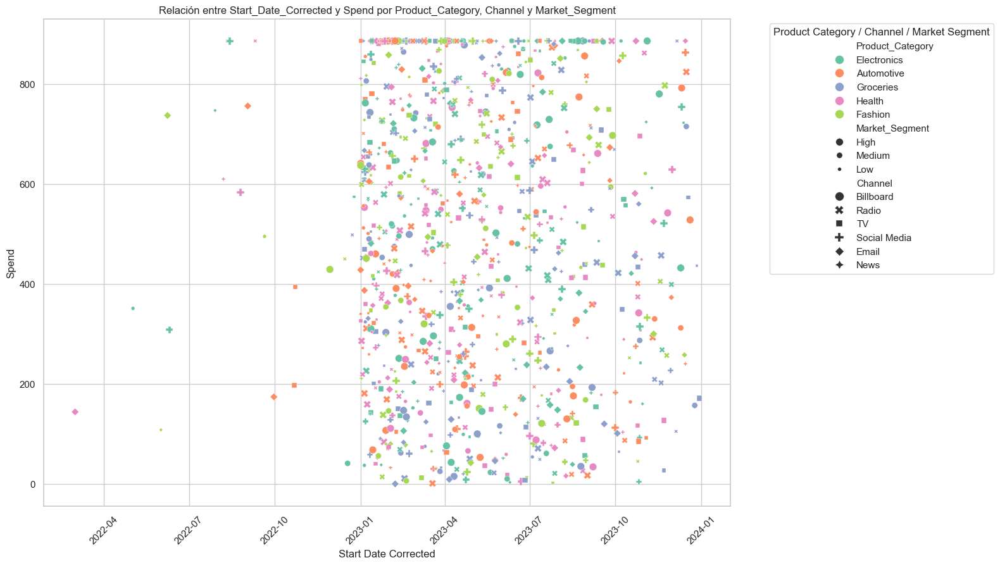

In [ ]:
# Asegurarse de que la columna 'Start_Date_Corrected' esté en tabla_johor
tabla_johor['Start_Date_Corrected'] = df_johor['Start_Date_Corrected']

# Localizar los datos de la columna 'Start_Date_Corrected' en la tabla_johor
start_date_corrected_johor = tabla_johor['Start_Date_Corrected']

# Contar los valores nulos en la columna 'Start_Date_Corrected'
nulos_start_date_corrected = start_date_corrected_johor.isnull().sum()

print(f"Cantidad de valores nulos en 'Start_Date_Corrected' para Johor: {nulos_start_date_corrected}")

# Crear una gráfica de relación entre las variables con el momento de inicio de campaña
plt.figure(figsize=(14, 10))
sns.scatterplot(data=tabla_johor, x='Start_Date_Corrected', y='Spend', hue='Product_Category', style='Channel', size='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Start_Date_Corrected y Spend por Product_Category, Channel y Market_Segment')
plt.xlabel('Start Date Corrected')
plt.ylabel('Spend')
plt.legend(title='Product Category / Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()



In [ ]:
# Identificar las columnas con datos nulos
columnas_con_nulos = tabla_johor.isnull().sum()

# Filtrar solo las columnas que tienen datos nulos
columnas_con_nulos = columnas_con_nulos[columnas_con_nulos > 0]

print("Columnas con datos nulos y su cantidad:")
print(columnas_con_nulos)


Columnas con datos nulos y su cantidad:
Start_Date_Corrected    5
dtype: int64


## ARIMA

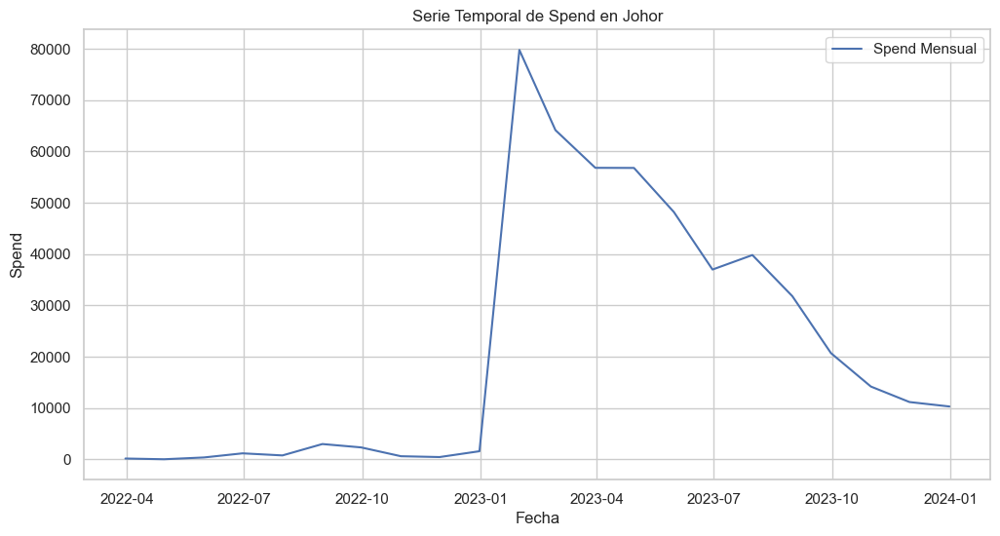

Estadístico ADF: -10.785088653238228
p-value: 2.2046450644180137e-19
Estadístico ADF después de diferenciar: -10.785088653238228
p-value: 2.2046450644180137e-19


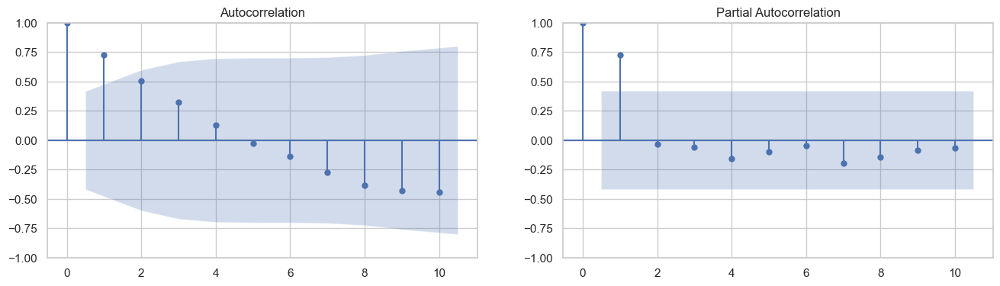

                               SARIMAX Results                                
Dep. Variable:                  Spend   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -191.900
Date:               do., 03 nov. 2024   AIC                            391.800
Time:                        21:31:20   BIC                            395.132
Sample:                    03-31-2022   HQIC                           392.131
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        2.31e+04   2.65e+04      0.872      0.383   -2.88e+04     7.5e+04
ar.L1          0.7211      0.935      0.771      0.441      -1.112       2.555
ma.L1         -0.0166      3.248     -0.005      0.9

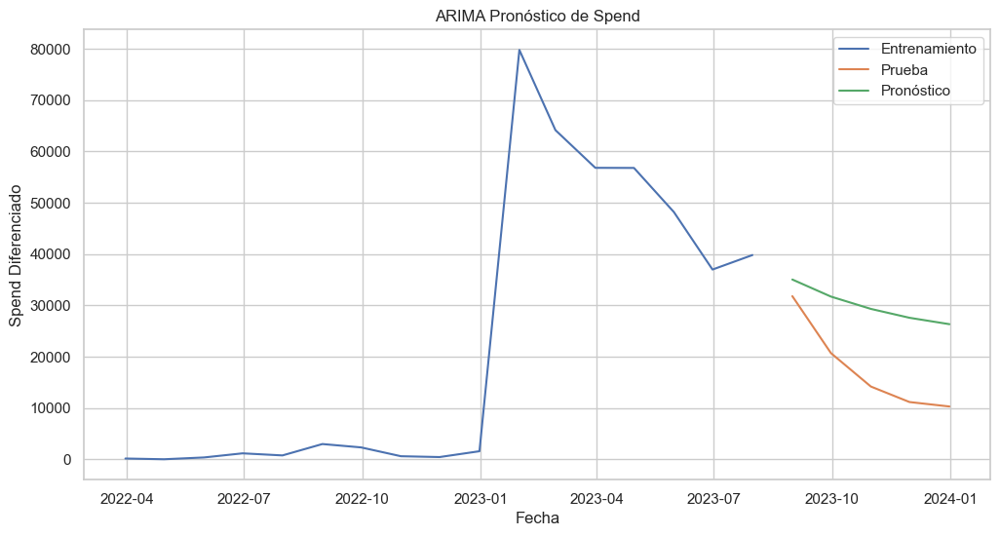

RMSE: 115.4250166976962


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Johor
df_johor = df[df['Region'] == 'Johor'].copy()

# 2. Preparar la serie temporal
df_johor['Start_Date_Corrected'] = pd.to_datetime(df_johor['Start_Date_Corrected'])
df_johor.set_index('Start_Date_Corrected', inplace=True)
df_johor.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_johor['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Johor')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


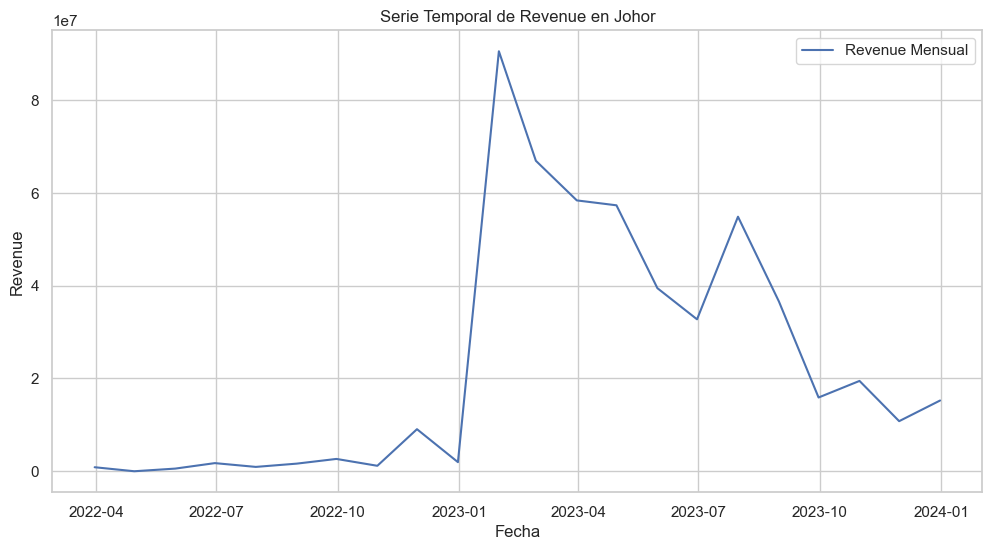

Estadístico ADF: -15.91671371534765
p-value: 8.009031650963049e-29
Estadístico ADF después de diferenciar: -15.91671371534765
p-value: 8.009031650963049e-29


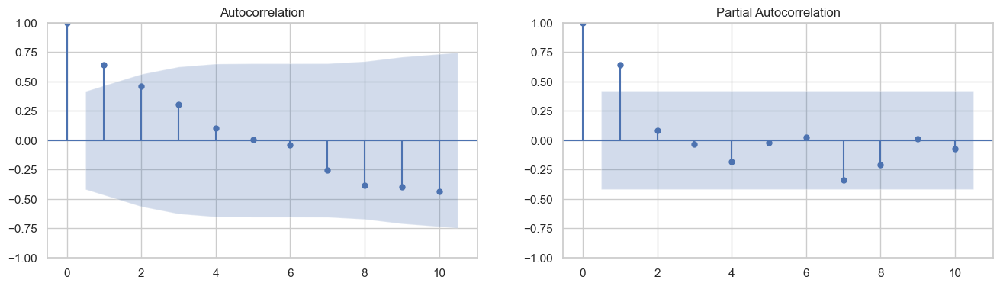

                               SARIMAX Results                                
Dep. Variable:                Revenue   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -311.888
Date:               do., 03 nov. 2024   AIC                            631.776
Time:                        21:31:21   BIC                            635.109
Sample:                    03-31-2022   HQIC                           632.107
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.476e+07   2.64e-09   9.37e+15      0.000    2.48e+07    2.48e+07
ar.L1          0.7457      0.572      1.303      0.193      -0.376       1.868
ma.L1         -0.1739      1.200     -0.145      0.8

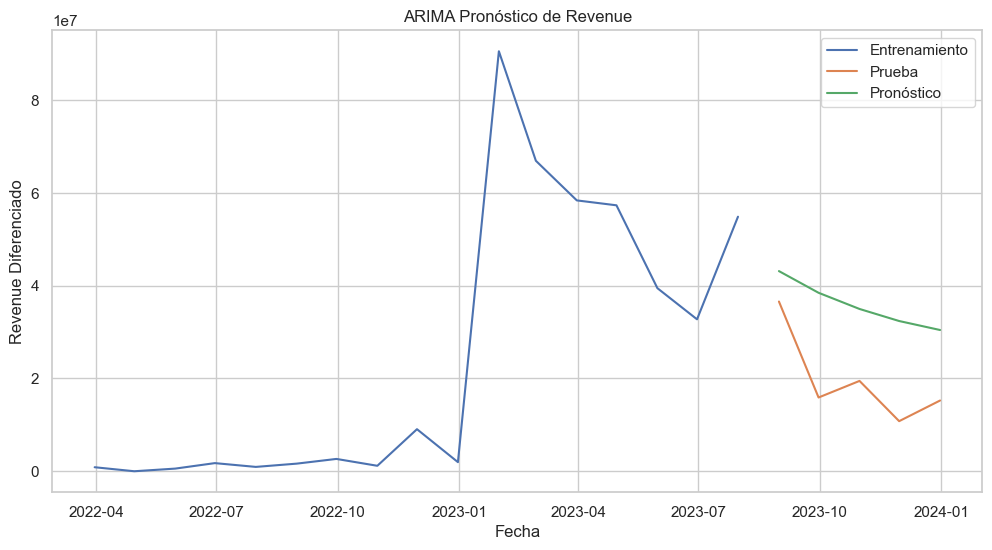

RMSE: 4155.062920092375


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Johor
df_johor = df[df['Region'] == 'Johor'].copy()

# 2. Preparar la serie temporal
df_johor['Start_Date_Corrected'] = pd.to_datetime(df_johor['Start_Date_Corrected'])
df_johor.set_index('Start_Date_Corrected', inplace=True)
df_johor.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_johor['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Johor')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


## SARIMA

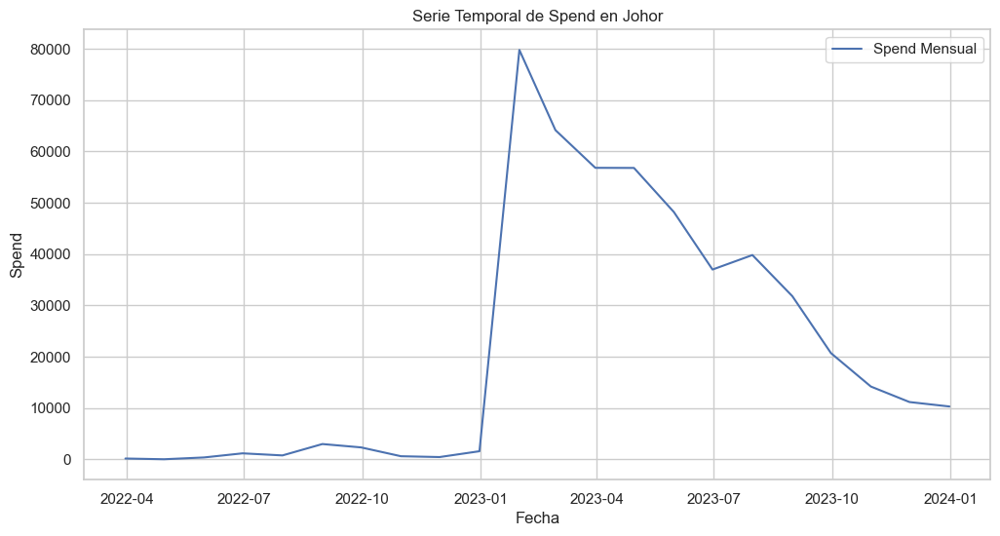

Estadístico ADF: -10.785088653238228
p-value: 2.2046450644180137e-19
Estadístico ADF después de diferenciar: -10.785088653238228
p-value: 2.2046450644180137e-19


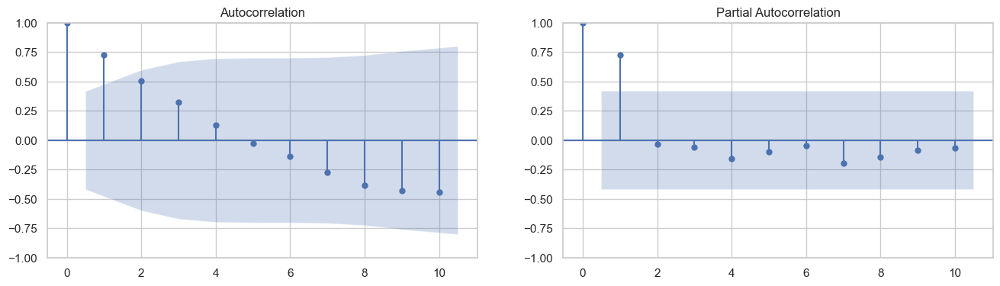

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -40.580
Date:                           do., 03 nov. 2024   AIC                             91.160
Time:                                    21:31:22   BIC                             88.092
Sample:                                03-31-2022   HQIC                            84.427
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0315      1.733     -0.018      0.985      -3.427       3.364
ma.L1          0.8447      6.328   

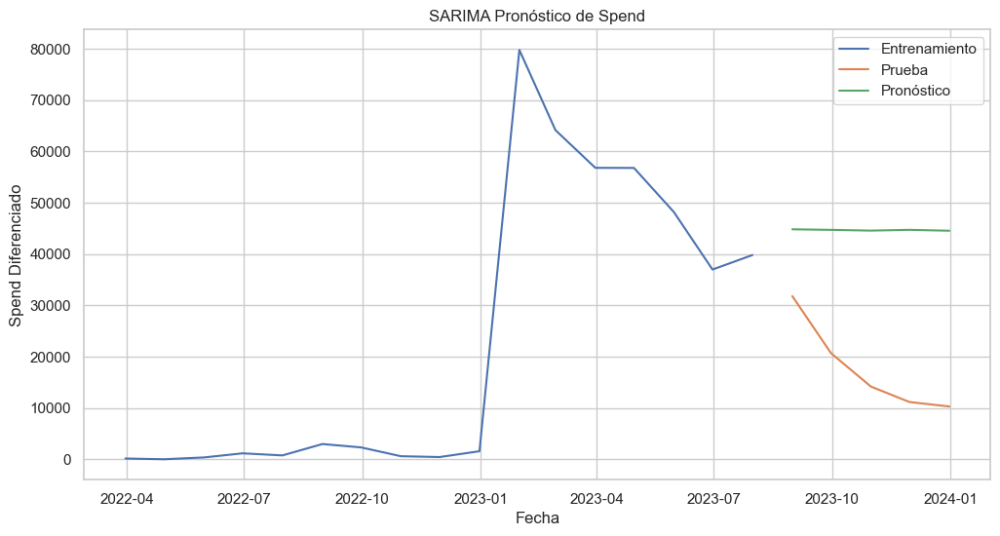

RMSE: 167.85148535143495


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Johor
df_johor = df[df['Region'] == 'Johor'].copy()

# 2. Preparar la serie temporal
df_johor['Start_Date_Corrected'] = pd.to_datetime(df_johor['Start_Date_Corrected'])
df_johor.set_index('Start_Date_Corrected', inplace=True)
df_johor.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_johor['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Johor')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'Start_Date_Corrected' does not exist in the dataframe.


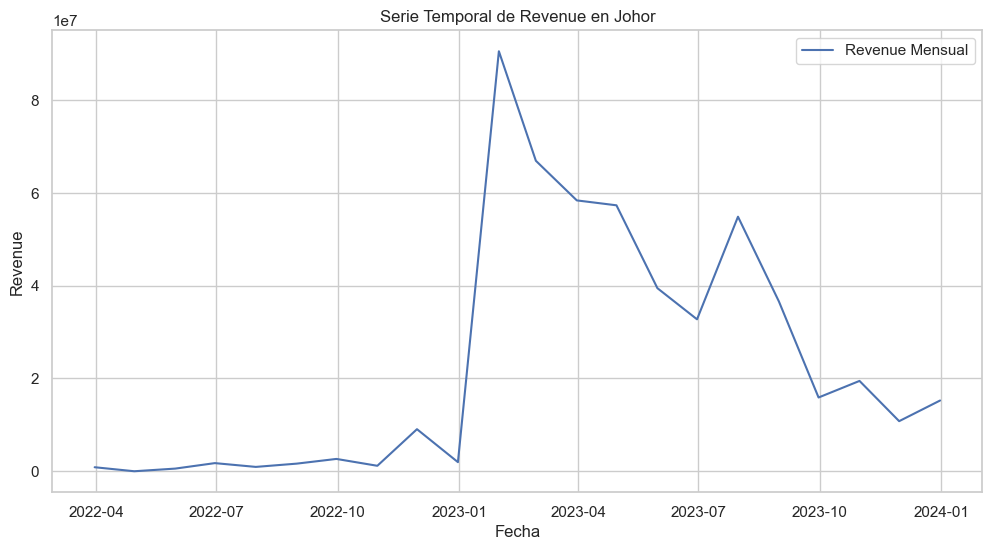

Estadístico ADF: -15.91671371534765
p-value: 8.009031650963049e-29
Estadístico ADF después de diferenciar: -15.91671371534765
p-value: 8.009031650963049e-29


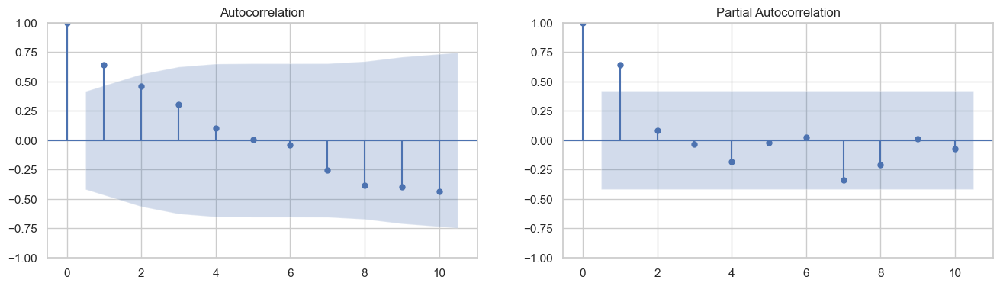

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -71.046
Date:                           do., 03 nov. 2024   AIC                            152.091
Time:                                    21:31:23   BIC                            149.023
Sample:                                03-31-2022   HQIC                           145.357
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1424      1.734      0.082      0.935      -3.257       3.542
ma.L1         -0.8483      4.796   

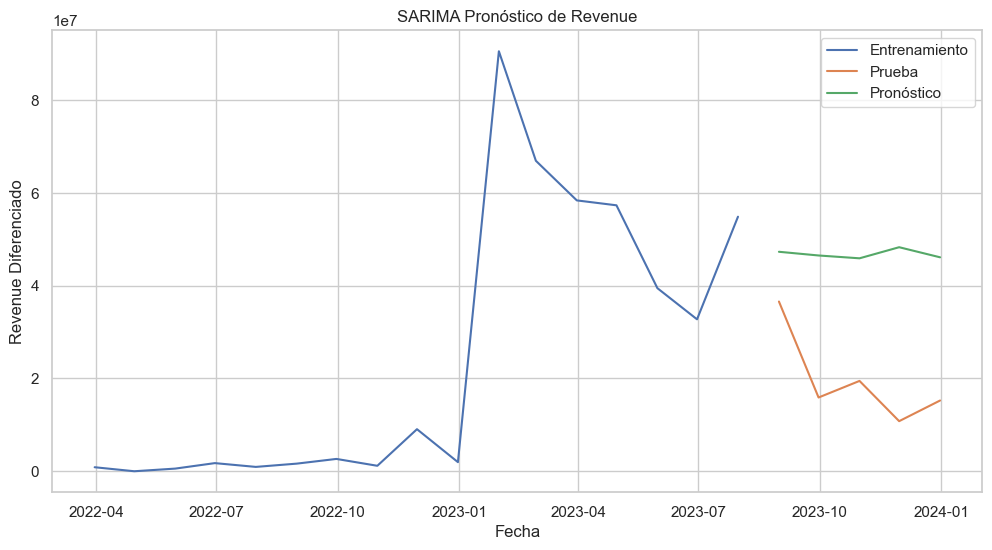

RMSE: 5354.635160329623


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'Start_Date_Corrected' column exists
if 'Start_Date_Corrected' in df_johor.columns:
    df_johor['Start_Date_Corrected'] = pd.to_datetime(df_johor['Start_Date_Corrected'])
else:
    print("Column 'Start_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_johor['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Johor')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


# SABAH

In [ ]:
df_sabah = df[df['Region'] == 'Sabah']

df_grouped = df_sabah.groupby(['Channel', 'Product_Category', 'Market_Segment']).size().reset_index(name='Count')

fig = px.sunburst(
    df_grouped,
    path=['Channel', 'Product_Category', 'Market_Segment'],
    values='Count',
    title='Distribución de Canal, Producto y Segmento de Mercado en Sabah',
    width=900,   
    height=900   
)

fig.show()


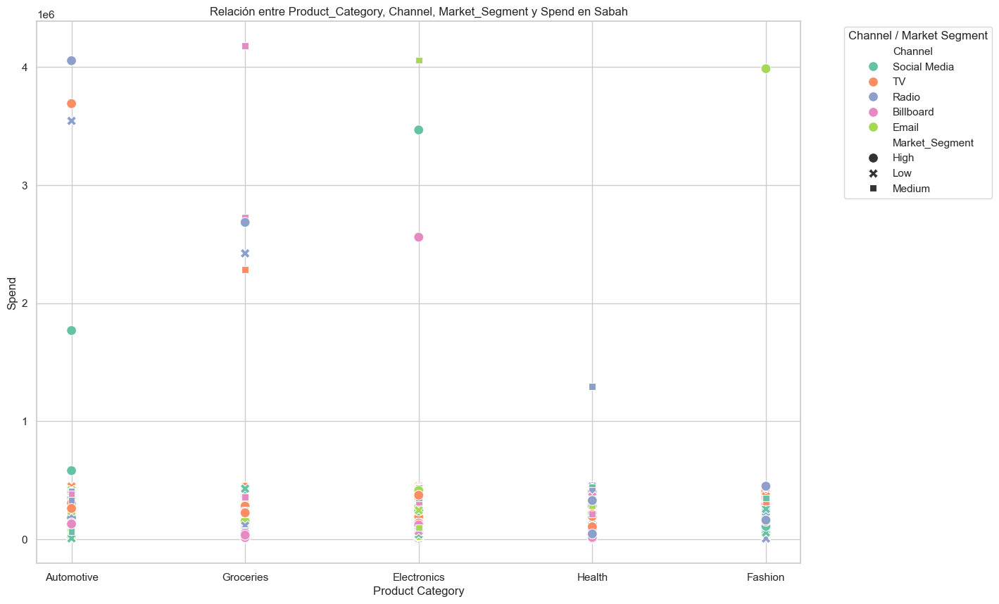

In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_sabah, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Sabah')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [ ]:
# Filtrar los datos donde la región es Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Seleccionar las columnas deseadas
tabla_sabah = df_sabah[['Product_Category', 'Channel', 'Market_Segment', 'Spend']]

# Mostrar la tabla
print(tabla_sabah)


     Product_Category       Channel Market_Segment         Spend
12         Automotive  Social Media           High  1.768613e+06
16          Groceries  Social Media            Low  1.647890e+05
17        Electronics            TV            Low  1.434690e+05
20             Health         Radio         Medium  1.459270e+05
21        Electronics     Billboard           High  1.180090e+05
46            Fashion            TV            Low           NaN
52        Electronics         Radio         Medium  2.156860e+05
54            Fashion         Email         Medium  7.824200e+04
66         Automotive            TV         Medium  2.818460e+05
73            Fashion  Social Media         Medium  7.081200e+04
78          Groceries            TV            Low  3.732510e+05
82          Groceries            TV           High  1.253400e+04
92             Health            TV            Low  3.877730e+05
95          Groceries         Radio            Low  4.128950e+05
99         Automotive  So

In [ ]:
tabla_sabah.isnull().sum()


Product_Category      0
Channel               0
Market_Segment        0
Spend               100
dtype: int64

In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestRegressor  # Import the missing module

# Encode categorical variables
label_encoders = {}
df_sabah_copy = df_sabah.copy()  # Define df_sabah_copy
for col in columnas_relevantes:
    le = LabelEncoder()
    df_sabah_copy[col] = le.fit_transform(df_sabah_copy[col].astype(str))
    label_encoders[col] = le

# Dividir los datos en entrenamiento y prueba
df_train = df_sabah_copy[df_sabah_copy['Spend'].notna()]
df_test = df_sabah_copy[df_sabah_copy['Spend'].isna()]

# Definir las características (X) y la variable objetivo (y)
X_train = df_train[columnas_relevantes]
y_train = df_train['Spend']
X_test = df_test[columnas_relevantes]

# Crear y entrenar el modelo de regresión
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Verificar si df_test está vacío antes de predecir
if not df_test.empty:
    # Predecir los valores faltantes en 'Spend'
    y_pred = model.predict(X_test)

    # Rellenar los valores nulos en 'Spend' con las predicciones
    df_sabah_copy.loc[df_sabah_copy['Spend'].isna(), 'Spend'] = y_pred

# Verificar que no haya valores nulos en 'Spend'
print(df_sabah_copy['Spend'].isnull().sum())


0


In [ ]:
# Actualizar los valores de 'Spend' en el dataframe original 'df' con los valores corregidos de 'df_sabah_copy'
df.loc[df_sabah_copy.index, 'Spend'] = df_sabah_copy['Spend']

# Actualizar la tabla 'tabla_sabah' con los valores corregidos de 'Spend'
tabla_sabah['Spend'] = df.loc[tabla_sabah.index, 'Spend']

# Mostrar la tabla actualizada
print(tabla_sabah)


     Product_Category       Channel Market_Segment  Spend
12         Automotive  Social Media           High  156.0
16          Groceries  Social Media            Low  129.0
17        Electronics            TV            Low   79.0
20             Health         Radio         Medium   84.0
21        Electronics     Billboard           High   33.0
46            Fashion            TV            Low  867.0
52        Electronics         Radio         Medium  219.0
54            Fashion         Email         Medium  810.0
66         Automotive            TV         Medium  363.0
73            Fashion  Social Media         Medium  796.0
78          Groceries            TV            Low  559.0
82          Groceries            TV           High   46.0
92             Health            TV            Low  598.0
95          Groceries         Radio            Low  654.0
99         Automotive  Social Media         Medium  302.0
101        Automotive         Radio            Low  366.0
102       Elec

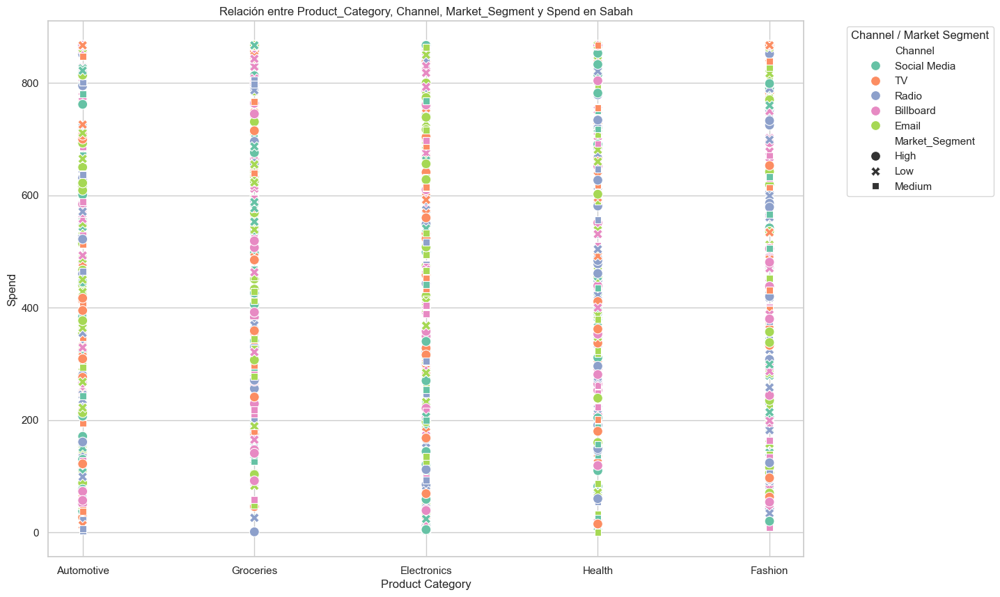

In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_sabah, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Sabah')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [ ]:
from sklearn.ensemble import IsolationForest

# Seleccionar la columna 'Spend' de la tabla_sabah
X = tabla_sabah[['Spend']]

# Crear el modelo Isolation Forest
iso_forest = IsolationForest(contamination=0.015, random_state=42)
iso_forest.fit(X)

# Predecir anomalías (-1 es outlier, 1 es normal)
tabla_sabah['anomaly'] = iso_forest.predict(X)

# Filtrar los outliers
outliers = tabla_sabah[tabla_sabah['anomaly'] == -1]
tabla_sabah_clean = tabla_sabah[tabla_sabah['anomaly'] == 1]

# Mostrar los resultados
print("Outliers detectados:")
print(outliers)
print("\nTabla sin outliers:")
print(tabla_sabah_clean)
tabla_sabah.shape


Outliers detectados:
     Product_Category       Channel Market_Segment  Spend  anomaly
447         Groceries         Radio         Medium    3.0       -1
479       Electronics     Billboard            Low    7.0       -1
492        Automotive         Radio         Medium    2.0       -1
892       Electronics         Radio           High   12.0       -1
916       Electronics  Social Media            Low    4.0       -1
1014      Electronics  Social Media            Low   11.0       -1
1221      Electronics     Billboard            Low   14.0       -1
1532           Health  Social Media            Low   10.0       -1
1714           Health  Social Media         Medium    8.0       -1
1760      Electronics  Social Media           High    5.0       -1
2975           Health         Email         Medium    0.0       -1
3613       Automotive            TV            Low   13.0       -1
3939       Automotive         Radio         Medium    6.0       -1
4563          Fashion     Billboard      

(968, 5)

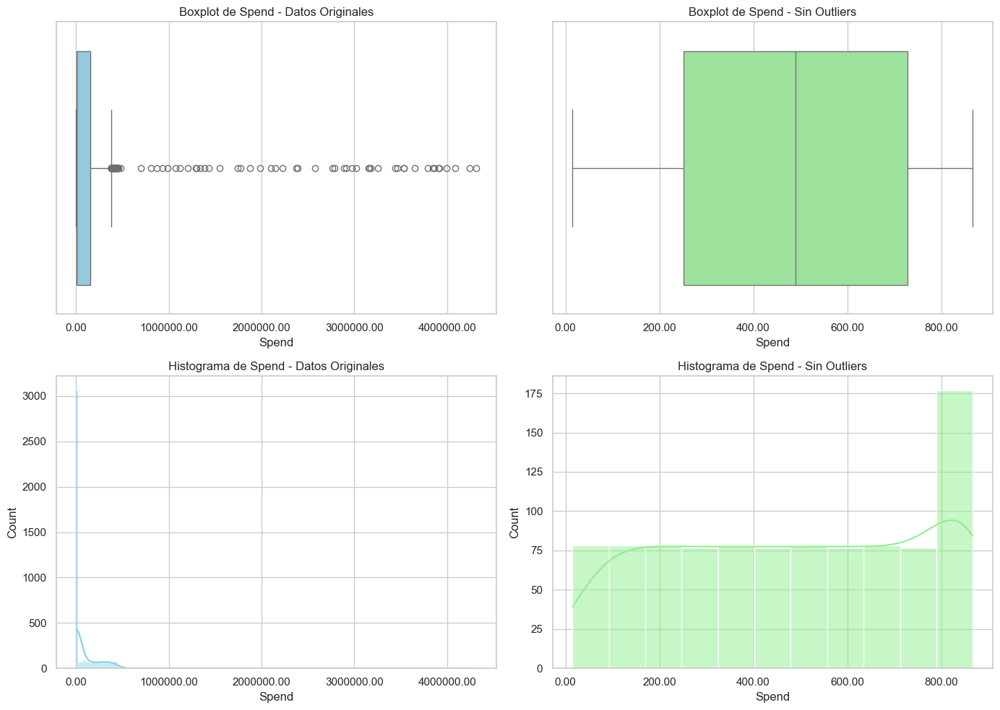

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar el estilo de Seaborn
sns.set(style='whitegrid')

# Crear una figura con 2 filas y 2 columnas de subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Gráfico de caja para 'Spend' en el dataframe original
sns.boxplot(data=df, x='Spend', ax=axes[0, 0], color='skyblue')
axes[0, 0].set_title('Boxplot de Spend - Datos Originales')

# Redondear los valores en los ejes a 2 decimales
axes[0, 0].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[1, 0].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[0, 1].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[1, 1].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))

# Histograma para 'Spend' en el dataframe original
sns.histplot(data=df, x='Spend', kde=True, ax=axes[1, 0], color='skyblue')
axes[1, 0].set_title('Histograma de Spend - Datos Originales')

# Gráfico de caja para 'Spend' en el dataframe sin outliers
sns.boxplot(data=tabla_sabah_clean, x='Spend', ax=axes[0, 1], color='lightgreen')
axes[0, 1].set_title('Boxplot de Spend - Sin Outliers')

# Histograma para 'Spend' en el dataframe sin outliers
sns.histplot(data=tabla_sabah_clean, x='Spend', kde=True, ax=axes[1, 1], color='lightgreen')
axes[1, 1].set_title('Histograma de Spend - Sin Outliers')

# Ajustar el espacio entre subplots
plt.tight_layout()

# Mostrar las gráficas
plt.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Agrupar por Channel, Market_Segment y Product_Category y calcular las estadísticas
estadisticas_spend = df_sabah.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var'])

# Mostrar todas las filas
pd.set_option('display.max_rows', None)

# Mostrar las estadísticas
print(estadisticas_spend)


                                                    mean  median  \
Channel      Market_Segment Product_Category                       
Billboard    High           Automotive        401.466667   273.0   
                            Electronics       401.142857   353.5   
                            Fashion           467.071429   459.5   
                            Groceries         400.266667   383.0   
                            Health            435.066667   414.0   
             Low            Automotive        674.400000   745.0   
                            Electronics       554.200000   675.0   
                            Fashion           478.750000   457.5   
                            Groceries         598.071429   676.0   
                            Health            626.818182   705.0   
             Medium         Automotive        426.500000   510.0   
                            Electronics       560.562500   567.5   
                            Fashion           39

Cantidad de valores nulos en 'Start_Date_Corrected' para Sabah: 8


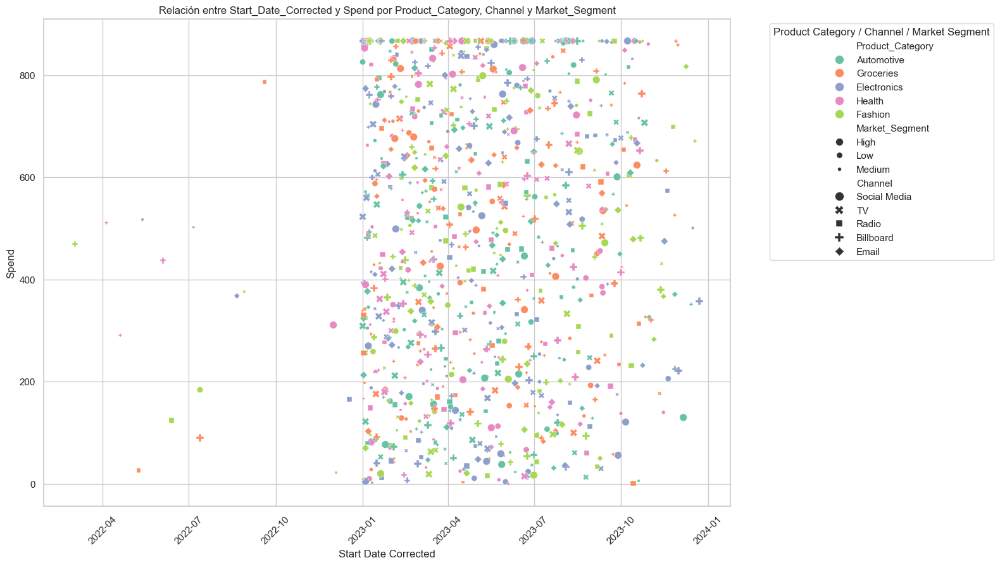

In [ ]:
# Asegurarse de que la columna 'Start_Date_Corrected' esté en tabla_sabah
tabla_sabah['Start_Date_Corrected'] = df_sabah['Start_Date_Corrected']

# Localizar los datos de la columna 'Start_Date_Corrected' en la tabla_sabah
start_date_corrected_sabah = tabla_sabah['Start_Date_Corrected']

# Contar los valores nulos en la columna 'Start_Date_Corrected'
nulos_start_date_corrected = start_date_corrected_sabah.isnull().sum()

print(f"Cantidad de valores nulos en 'Start_Date_Corrected' para Sabah: {nulos_start_date_corrected}")

# Crear una gráfica de relación entre las variables con el momento de inicio de campaña
plt.figure(figsize=(14, 10))
sns.scatterplot(data=tabla_sabah, x='Start_Date_Corrected', y='Spend', hue='Product_Category', style='Channel', size='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Start_Date_Corrected y Spend por Product_Category, Channel y Market_Segment')
plt.xlabel('Start Date Corrected')
plt.ylabel('Spend')
plt.legend(title='Product Category / Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()


In [ ]:
# Identificar las columnas con datos nulos
columnas_con_nulos = tabla_sabah.isnull().sum()

# Filtrar solo las columnas que tienen datos nulos
columnas_con_nulos = columnas_con_nulos[columnas_con_nulos > 0]

print("Columnas con datos nulos y su cantidad:")
print(columnas_con_nulos)


Columnas con datos nulos y su cantidad:
Start_Date_Corrected    8
dtype: int64


## ARIMA

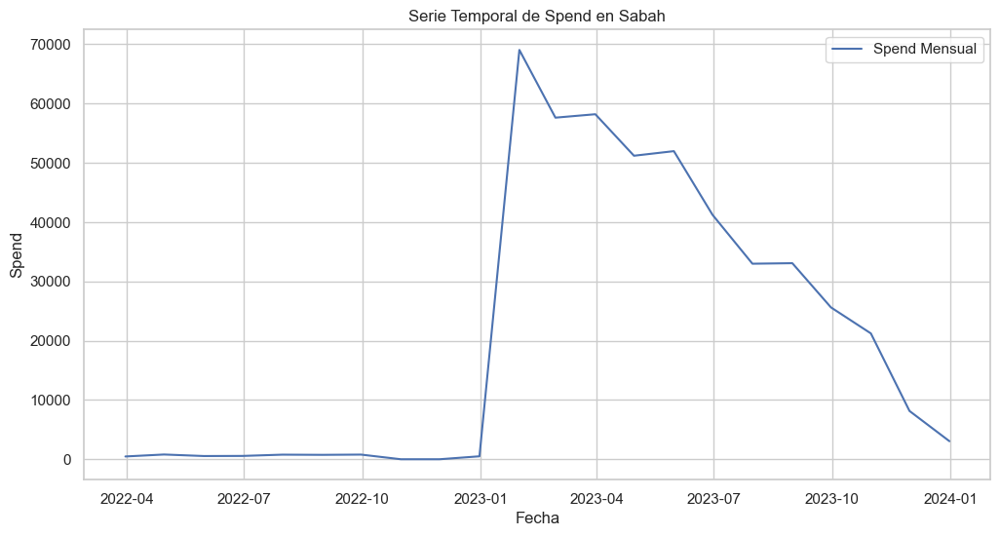

Estadístico ADF: -6.229194844828408
p-value: 5.0015203816821965e-08
Estadístico ADF después de diferenciar: -6.229194844828408
p-value: 5.0015203816821965e-08


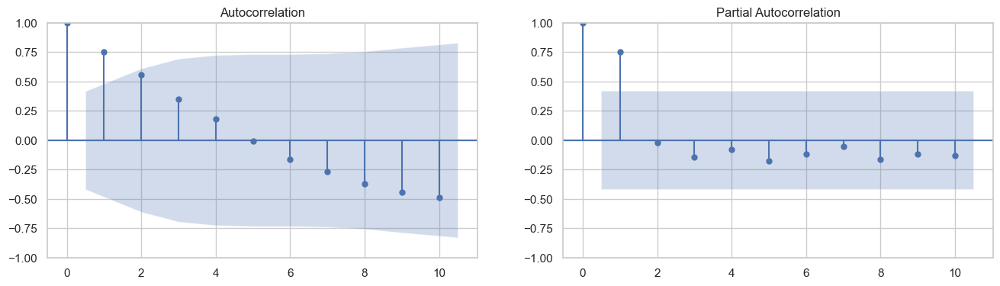

                               SARIMAX Results                                
Dep. Variable:                  Spend   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -189.803
Date:               do., 03 nov. 2024   AIC                            387.605
Time:                        21:31:28   BIC                            390.938
Sample:                    03-31-2022   HQIC                           387.936
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.162e+04   2.36e+04      0.914      0.361   -2.47e+04     6.8e+04
ar.L1          0.7540      0.732      1.030      0.303      -0.680       2.188
ma.L1         -0.0183      2.854     -0.006      0.9

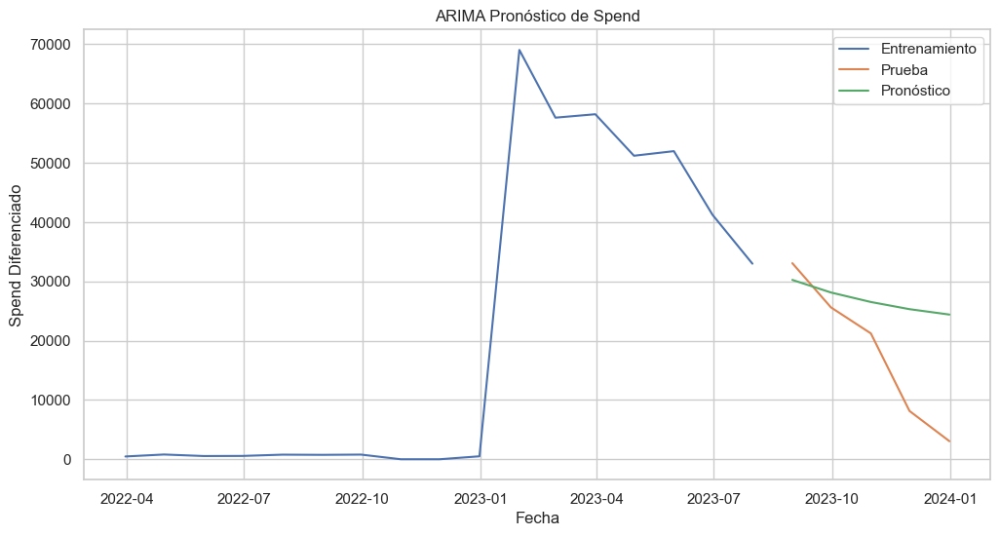

RMSE: 112.24005303774518


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Sabah
df_sabah = df[df['Region'] == 'Sabah'].copy()

# 2. Preparar la serie temporal
df_sabah['Start_Date_Corrected'] = pd.to_datetime(df_sabah['Start_Date_Corrected'])
df_sabah.set_index('Start_Date_Corrected', inplace=True)
df_sabah.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_sabah['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Sabah')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


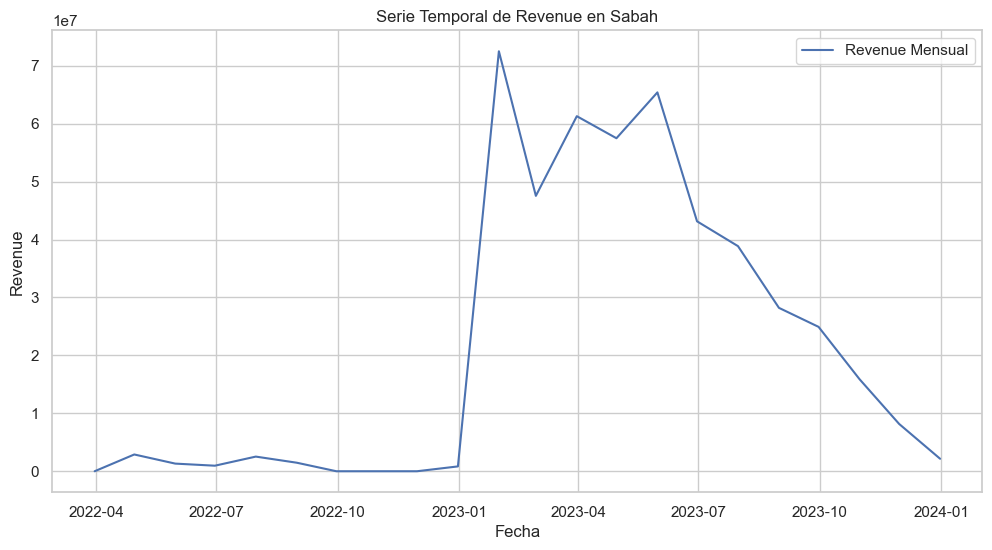

Estadístico ADF: -5.6235448000994
p-value: 1.130788878268312e-06
Estadístico ADF después de diferenciar: -5.6235448000994
p-value: 1.130788878268312e-06


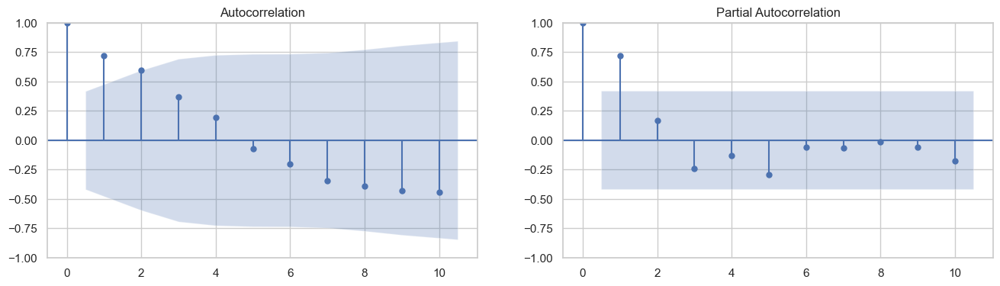

                               SARIMAX Results                                
Dep. Variable:                Revenue   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -308.966
Date:               do., 03 nov. 2024   AIC                            625.933
Time:                        21:31:29   BIC                            629.265
Sample:                    03-31-2022   HQIC                           626.264
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.331e+07   1.03e-07   2.26e+14      0.000    2.33e+07    2.33e+07
ar.L1          0.8052      0.547      1.473      0.141      -0.266       1.877
ma.L1         -0.1911      2.051     -0.093      0.9

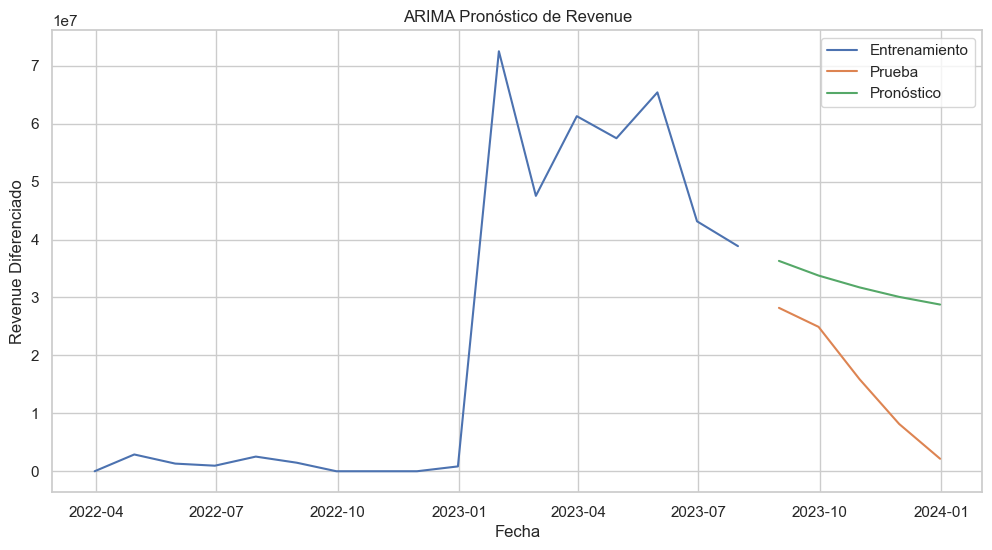

RMSE: 4219.3949464323405


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Sabah
df_sabah = df[df['Region'] == 'Sabah'].copy()

# 2. Preparar la serie temporal
df_sabah['Start_Date_Corrected'] = pd.to_datetime(df_sabah['Start_Date_Corrected'])
df_sabah.set_index('Start_Date_Corrected', inplace=True)
df_sabah.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_sabah['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Sabah')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


## SARIMA

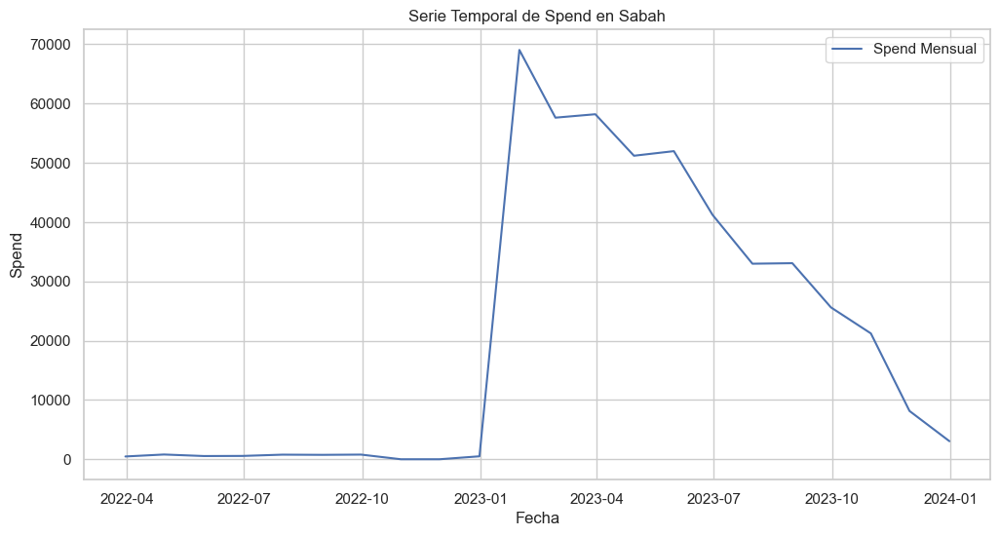

Estadístico ADF: -6.229194844828408
p-value: 5.0015203816821965e-08
Estadístico ADF después de diferenciar: -6.229194844828408
p-value: 5.0015203816821965e-08


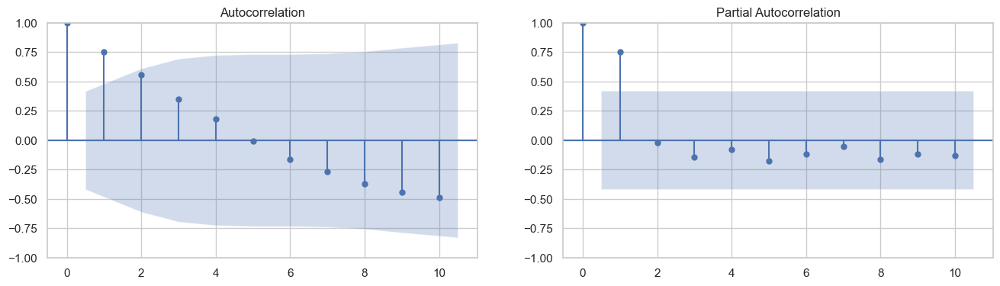

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -40.800
Date:                           do., 03 nov. 2024   AIC                             91.600
Time:                                    21:31:31   BIC                             88.532
Sample:                                03-31-2022   HQIC                            84.866
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000      3.901      0.256      0.798      -6.645       8.645
ma.L1         -0.5324      3.167   

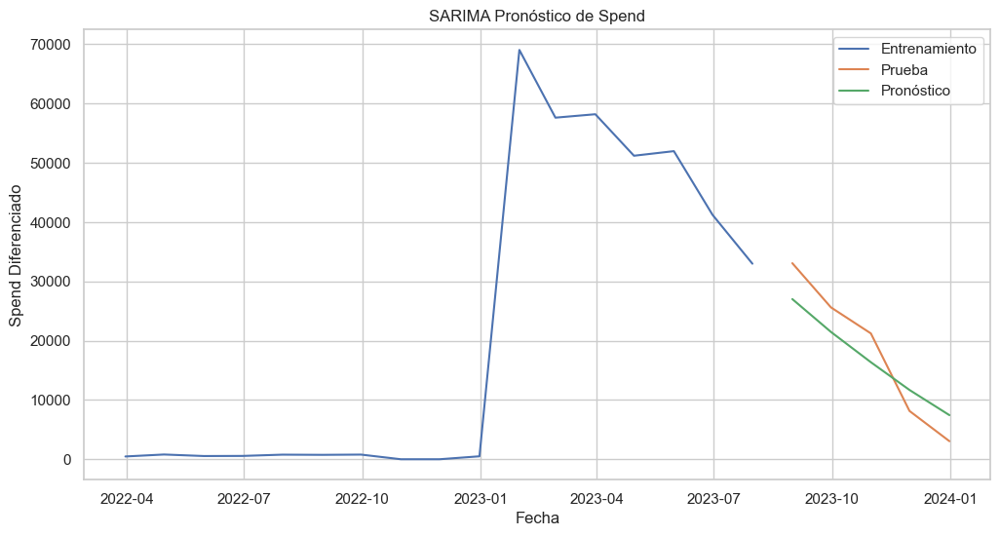

RMSE: 68.37616728683115


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Sabah
df_sabah = df[df['Region'] == 'Sabah'].copy()

# 2. Preparar la serie temporal
df_sabah['Start_Date_Corrected'] = pd.to_datetime(df_sabah['Start_Date_Corrected'])
df_sabah.set_index('Start_Date_Corrected', inplace=True)
df_sabah.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_sabah['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Sabah')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'Start_Date_Corrected' does not exist in the dataframe.


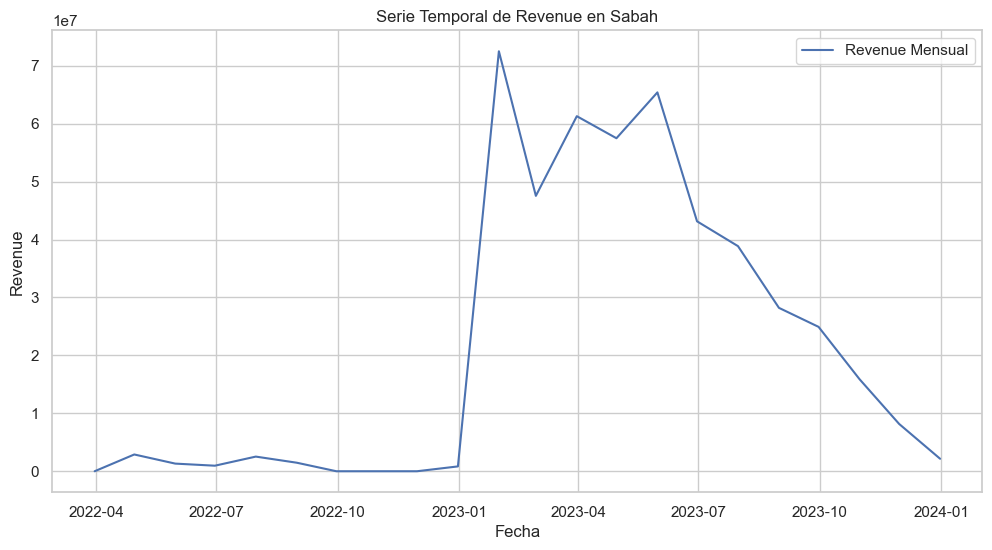

Estadístico ADF: -5.6235448000994
p-value: 1.130788878268312e-06
Estadístico ADF después de diferenciar: -5.6235448000994
p-value: 1.130788878268312e-06


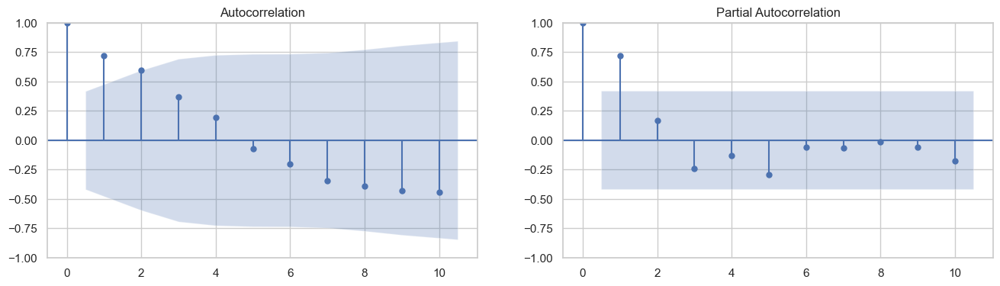

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -70.398
Date:                           do., 03 nov. 2024   AIC                            150.797
Time:                                    21:31:33   BIC                            147.728
Sample:                                03-31-2022   HQIC                           144.063
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6880    100.196      0.007      0.995    -195.693     197.069
ma.L1         -0.9737    435.394   

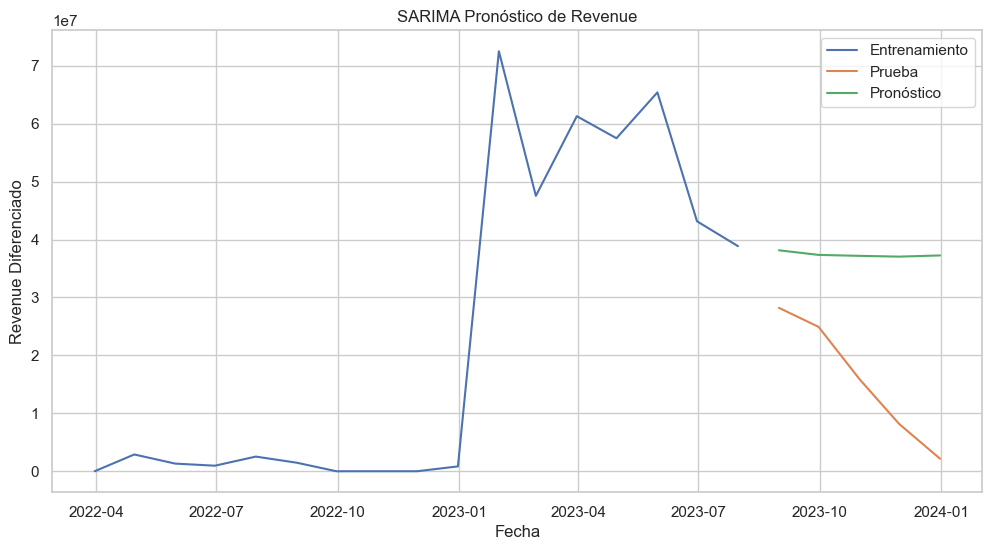

RMSE: 4852.524472006943


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'Start_Date_Corrected' column exists
if 'Start_Date_Corrected' in df_sabah.columns:
    df_sabah['Start_Date_Corrected'] = pd.to_datetime(df_sabah['Start_Date_Corrected'])
else:
    print("Column 'Start_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_sabah['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Sabah')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


# SARAWAK

In [ ]:
df_sarawak = df[df['Region'] == 'Sarawak']

df_grouped = df_sarawak.groupby(['Channel', 'Product_Category', 'Market_Segment']).size().reset_index(name='Count')

fig = px.sunburst(
    df_grouped,
    path=['Channel', 'Product_Category', 'Market_Segment'],
    values='Count',
    title='Distribución de Canal, Producto y Segmento de Mercado en Sarawak',
    width=900,   
    height=900   
)

fig.show()


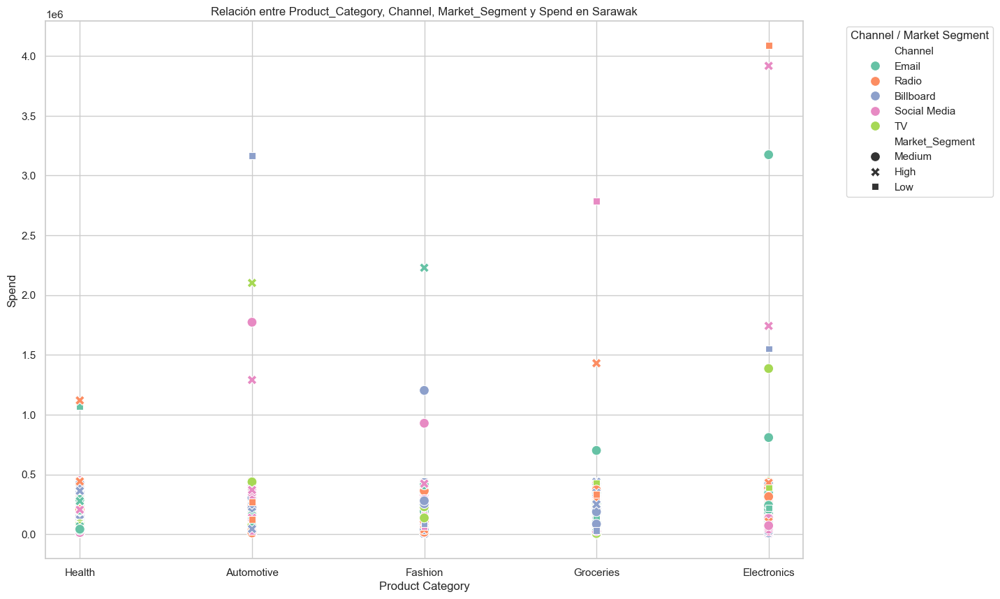

In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_sarawak, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Sarawak')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [ ]:
# Filtrar los datos donde la región es Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Seleccionar las columnas deseadas
tabla_sarawak = df_sarawak[['Product_Category', 'Channel', 'Market_Segment', 'Spend']]

# Mostrar la tabla
print(tabla_sarawak)


     Product_Category       Channel Market_Segment         Spend
1              Health         Email         Medium  3.374300e+04
6          Automotive         Radio           High  4.441260e+05
14         Automotive         Radio            Low  8.531300e+04
15            Fashion     Billboard           High  3.560560e+05
24         Automotive     Billboard         Medium  2.539330e+05
30          Groceries     Billboard           High  2.328600e+05
35        Electronics     Billboard         Medium           NaN
36          Groceries         Email         Medium  2.458700e+04
40         Automotive     Billboard            Low  5.656800e+04
42             Health  Social Media            Low  4.368400e+04
45        Electronics     Billboard           High  3.524410e+05
47             Health            TV            Low  1.913020e+05
48          Groceries            TV         Medium  3.396790e+05
53          Groceries            TV           High  1.236400e+05
55          Groceries    

In [ ]:
tabla_sarawak.isnull().sum()


Product_Category     0
Channel              0
Market_Segment       0
Spend               84
dtype: int64

In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestRegressor  # Import the missing module

# Encode categorical variables
label_encoders = {}
df_sarawak_copy = df_sarawak.copy()  # Define df_sarawak_copy
for col in columnas_relevantes:
    le = LabelEncoder()
    df_sarawak_copy[col] = le.fit_transform(df_sarawak_copy[col].astype(str))
    label_encoders[col] = le

# Dividir los datos en entrenamiento y prueba
df_train = df_sarawak_copy[df_sarawak_copy['Spend'].notna()]
df_test = df_sarawak_copy[df_sarawak_copy['Spend'].isna()]

# Definir las características (X) y la variable objetivo (y)
X_train = df_train[columnas_relevantes]
y_train = df_train['Spend']
X_test = df_test[columnas_relevantes]

# Crear y entrenar el modelo de regresión
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Verificar si df_test está vacío antes de predecir
if not df_test.empty:
    # Predecir los valores faltantes en 'Spend'
    y_pred = model.predict(X_test)

    # Rellenar los valores nulos en 'Spend' con las predicciones
    df_sarawak_copy.loc[df_sarawak_copy['Spend'].isna(), 'Spend'] = y_pred

# Verificar que no haya valores nulos en 'Spend'
print(df_sarawak_copy['Spend'].isnull().sum())


0


In [ ]:
# Actualizar los valores de 'Spend' en el dataframe original 'df' con los valores corregidos de 'df_sarawak_copy'
df.loc[df_sarawak_copy.index, 'Spend'] = df_sarawak_copy['Spend']

# Actualizar la tabla 'tabla_sarawak' con los valores corregidos de 'Spend'
tabla_sarawak['Spend'] = df.loc[tabla_sarawak.index, 'Spend']

# Mostrar la tabla actualizada
print(tabla_sarawak)


     Product_Category       Channel Market_Segment  Spend
1              Health         Email         Medium  532.0
6          Automotive         Radio           High  787.0
14         Automotive         Radio            Low  889.0
15            Fashion     Billboard           High  595.0
24         Automotive     Billboard         Medium  343.0
30          Groceries     Billboard           High  308.0
35        Electronics     Billboard         Medium  926.0
36          Groceries         Email         Medium  325.0
40         Automotive     Billboard            Low  820.0
42             Health  Social Media            Low  764.0
45        Electronics     Billboard           High  585.0
47             Health            TV            Low  219.0
48          Groceries            TV         Medium  540.0
53          Groceries            TV           High   67.0
55          Groceries         Email           High  926.0
63        Electronics         Email         Medium  487.0
70          Gr

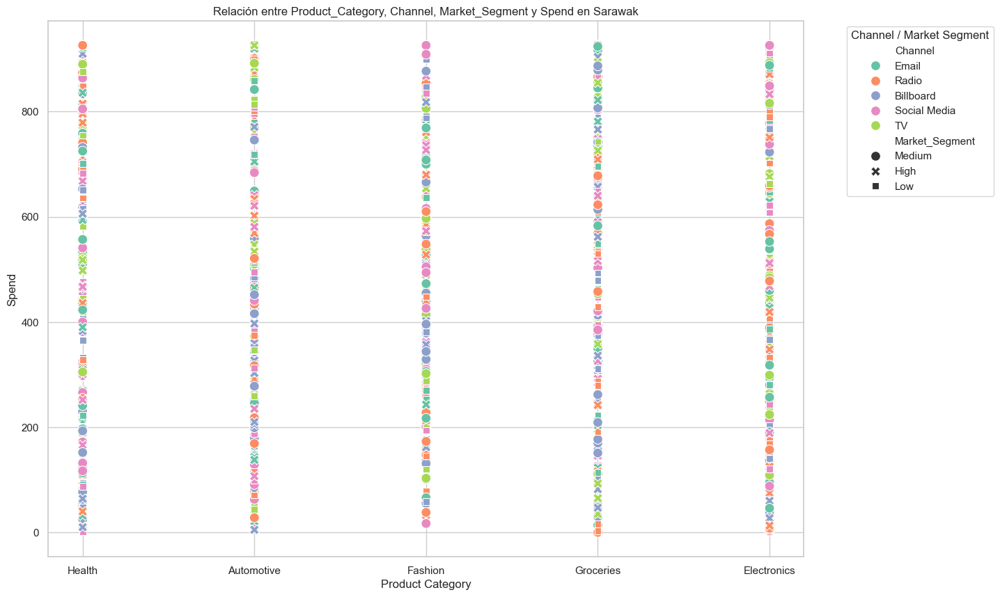

In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_sarawak, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Sarawak')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [ ]:
from sklearn.ensemble import IsolationForest

# Seleccionar la columna 'Spend' de la tabla_sarawak
X = tabla_sarawak[['Spend']]

# Crear el modelo Isolation Forest
iso_forest = IsolationForest(contamination=0.015, random_state=42)
iso_forest.fit(X)

# Predecir anomalías (-1 es outlier, 1 es normal)
tabla_sarawak['anomaly'] = iso_forest.predict(X)

# Filtrar los outliers
outliers = tabla_sarawak[tabla_sarawak['anomaly'] == -1]
tabla_sarawak_clean = tabla_sarawak[tabla_sarawak['anomaly'] == 1]

# Mostrar los resultados
print("Outliers detectados:")
print(outliers)
print("\nTabla sin outliers:")
print(tabla_sarawak_clean)
tabla_sabah.shape


Outliers detectados:
     Product_Category       Channel Market_Segment  Spend  anomaly
214            Health            TV         Medium    7.0       -1
514         Groceries         Email         Medium   14.0       -1
611         Groceries         Radio         Medium    0.0       -1
666       Electronics         Radio         Medium    2.0       -1
903       Electronics  Social Media         Medium    4.0       -1
1437      Electronics     Billboard            Low    9.0       -1
1759      Electronics            TV            Low    6.0       -1
1799           Health  Social Media            Low    1.0       -1
2220      Electronics         Radio         Medium    8.0       -1
2511       Automotive  Social Media           High   12.0       -1
3417           Health         Radio           High   11.0       -1
3684       Automotive     Billboard           High    5.0       -1
3954      Electronics     Billboard            Low   15.0       -1
4217           Health     Billboard      

(968, 6)

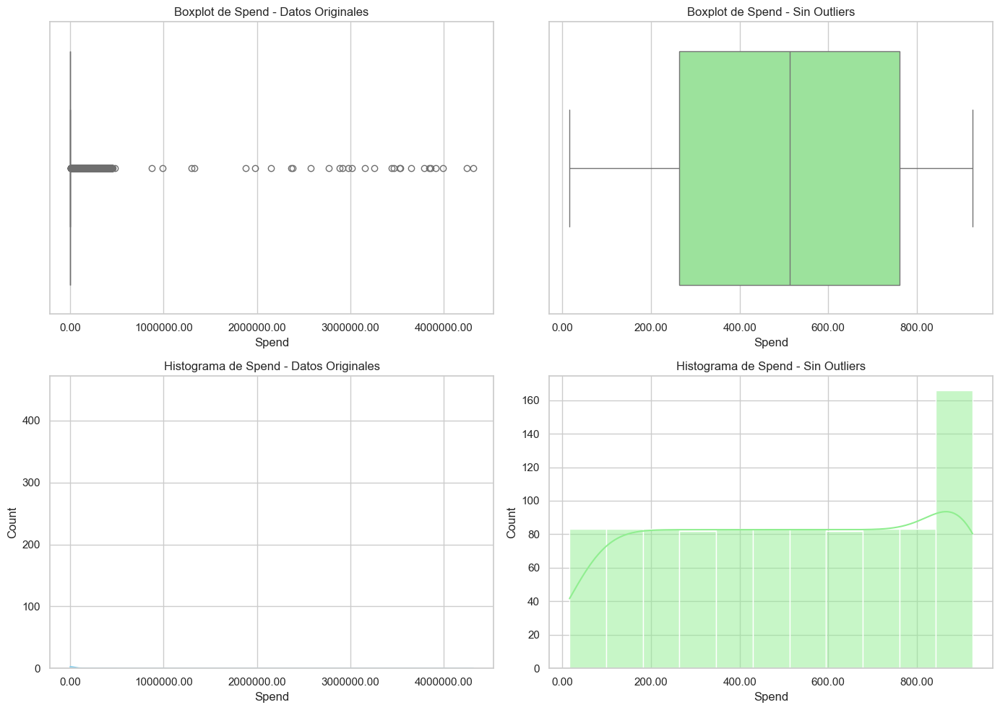

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar el estilo de Seaborn
sns.set(style='whitegrid')

# Crear una figura con 2 filas y 2 columnas de subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Gráfico de caja para 'Spend' en el dataframe original
sns.boxplot(data=df, x='Spend', ax=axes[0, 0], color='skyblue')
axes[0, 0].set_title('Boxplot de Spend - Datos Originales')

# Redondear los valores en los ejes a 2 decimales
axes[0, 0].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[1, 0].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[0, 1].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[1, 1].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))

# Histograma para 'Spend' en el dataframe original
sns.histplot(data=df, x='Spend', kde=True, ax=axes[1, 0], color='skyblue')
axes[1, 0].set_title('Histograma de Spend - Datos Originales')

# Gráfico de caja para 'Spend' en el dataframe sin outliers
sns.boxplot(data=tabla_sarawak_clean, x='Spend', ax=axes[0, 1], color='lightgreen')
axes[0, 1].set_title('Boxplot de Spend - Sin Outliers')

# Histograma para 'Spend' en el dataframe sin outliers
sns.histplot(data=tabla_sarawak_clean, x='Spend', kde=True, ax=axes[1, 1], color='lightgreen')
axes[1, 1].set_title('Histograma de Spend - Sin Outliers')

# Ajustar el espacio entre subplots
plt.tight_layout()

# Mostrar las gráficas
plt.show()


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Agrupar por Channel, Market_Segment y Product_Category y calcular las estadísticas
estadisticas_spend = df_sarawak.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var'])

# Mostrar todas las filas
pd.set_option('display.max_rows', None)

# Mostrar las estadísticas
print(estadisticas_spend)


                                                    mean  median  \
Channel      Market_Segment Product_Category                       
Billboard    High           Automotive        362.250000   324.5   
                            Electronics       416.230769   338.0   
                            Fashion           528.333333   510.5   
                            Groceries         469.000000   485.0   
                            Health            461.000000   462.0   
             Low            Automotive        468.000000   449.0   
                            Electronics       393.000000   285.0   
                            Fashion           619.687500   725.0   
                            Groceries         465.000000   479.0   
                            Health            437.846154   406.0   
             Medium         Automotive        435.411765   416.0   
                            Electronics       471.461538   415.0   
                            Fashion           46

Cantidad de valores nulos en 'Start_Date_Corrected' para Sarawak: 9


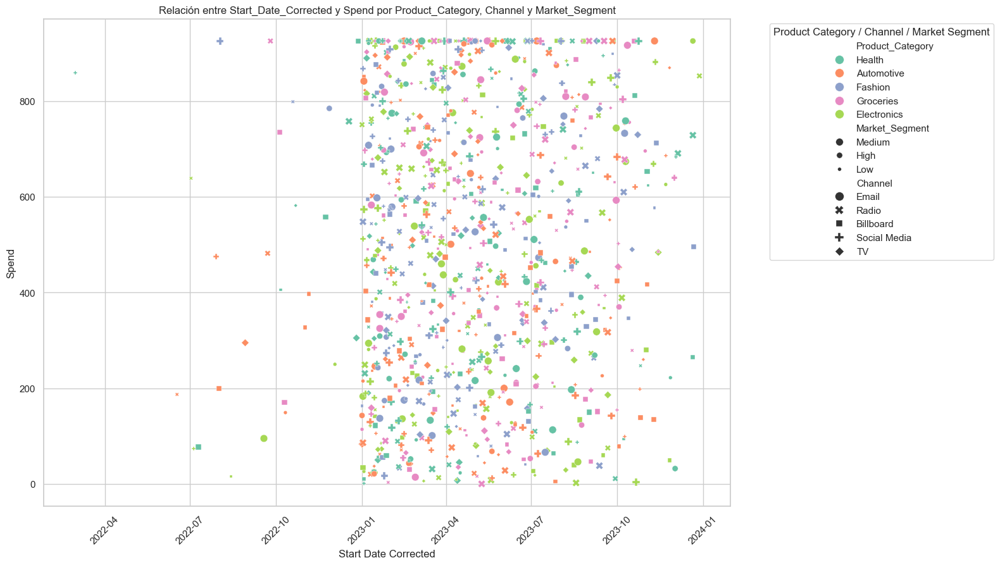

In [ ]:
# Asegurarse de que la columna 'Start_Date_Corrected' esté en tabla_sarawak
tabla_sarawak['Start_Date_Corrected'] = df_sarawak['Start_Date_Corrected']

# Localizar los datos de la columna 'Start_Date_Corrected' en la tabla_sarawak
start_date_corrected_sarawak = tabla_sarawak['Start_Date_Corrected']

# Contar los valores nulos en la columna 'Start_Date_Corrected'
nulos_start_date_corrected = start_date_corrected_sarawak.isnull().sum()

print(f"Cantidad de valores nulos en 'Start_Date_Corrected' para Sarawak: {nulos_start_date_corrected}")

# Crear una gráfica de relación entre las variables con el momento de inicio de campaña
plt.figure(figsize=(14, 10))
sns.scatterplot(data=tabla_sarawak, x='Start_Date_Corrected', y='Spend', hue='Product_Category', style='Channel', size='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Start_Date_Corrected y Spend por Product_Category, Channel y Market_Segment')
plt.xlabel('Start Date Corrected')
plt.ylabel('Spend')
plt.legend(title='Product Category / Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()


In [ ]:
# Identificar las columnas con datos nulos
columnas_con_nulos = tabla_sarawak.isnull().sum()

# Filtrar solo las columnas que tienen datos nulos
columnas_con_nulos = columnas_con_nulos[columnas_con_nulos > 0]

print("Columnas con datos nulos y su cantidad:")
print(columnas_con_nulos)


Columnas con datos nulos y su cantidad:
Start_Date_Corrected    9
dtype: int64


## ARIMA

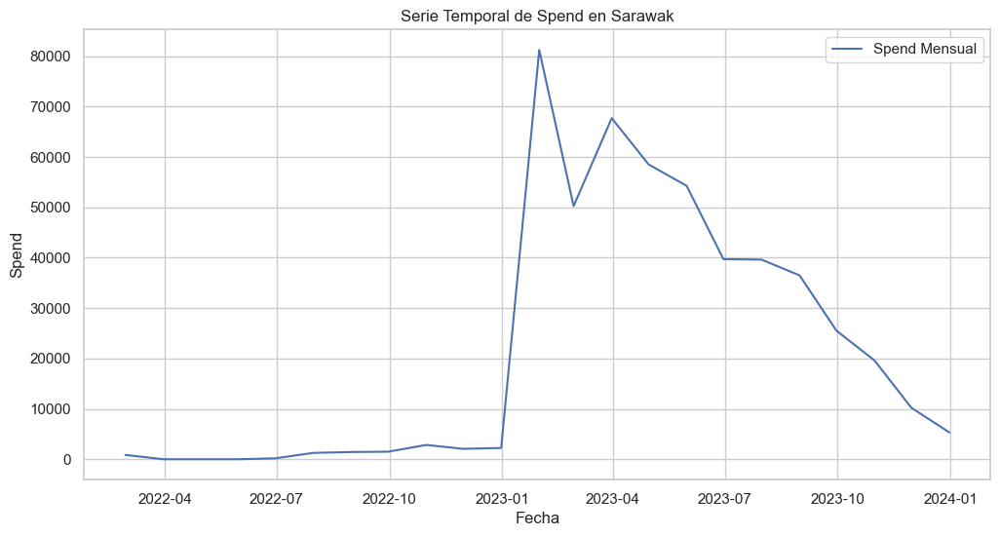

Estadístico ADF: -1.8429628167808818
p-value: 0.3593499479047143
Estadístico ADF después de diferenciar: -6.280045075091573
p-value: 3.8161671764510126e-08


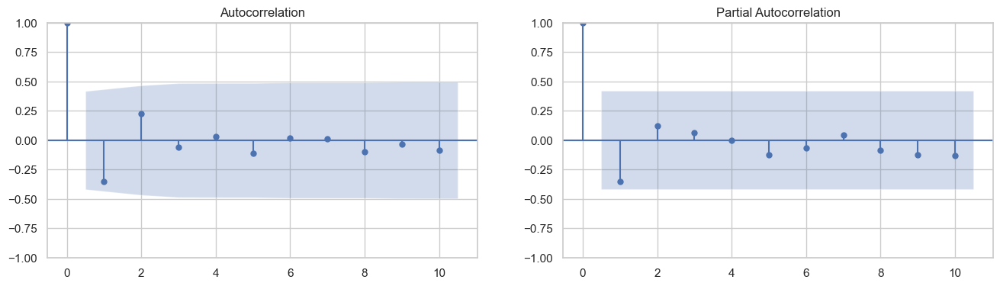

                               SARIMAX Results                                
Dep. Variable:                  Spend   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -192.394
Date:               do., 03 nov. 2024   AIC                            392.788
Time:                        21:32:47   BIC                            396.121
Sample:                    03-31-2022   HQIC                           393.119
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2280.2353   5748.374      0.397      0.692   -8986.370    1.35e+04
ar.L1         -0.4571      3.017     -0.151      0.880      -6.370       5.456
ma.L1          0.0955      3.140      0.030      0.9

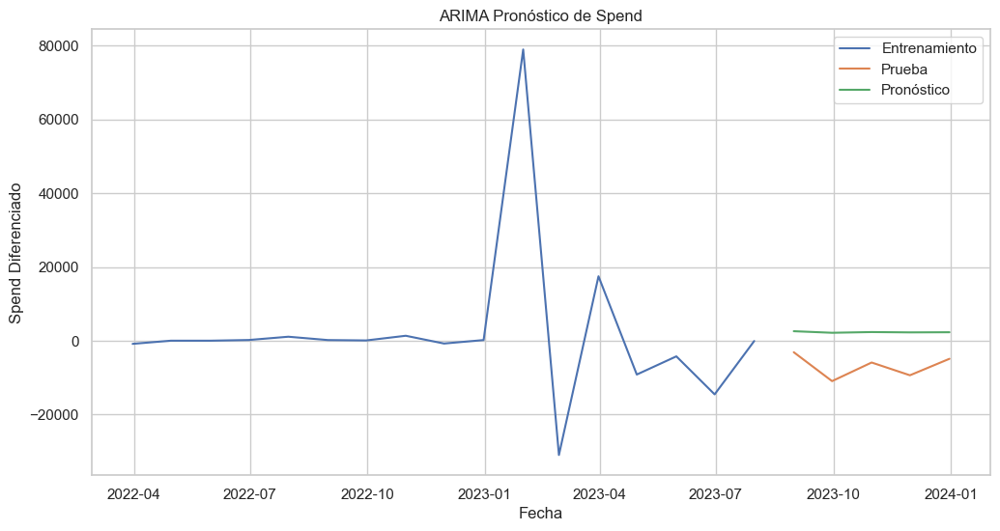

RMSE: 97.935644519238


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

# 1. Filtrar datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak'].copy()

# 2. Preparar la serie temporal
df_sarawak['Start_Date_Corrected'] = pd.to_datetime(df_sarawak['Start_Date_Corrected'])
df_sarawak.set_index('Start_Date_Corrected', inplace=True)
df_sarawak.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_sarawak['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Sarawak')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


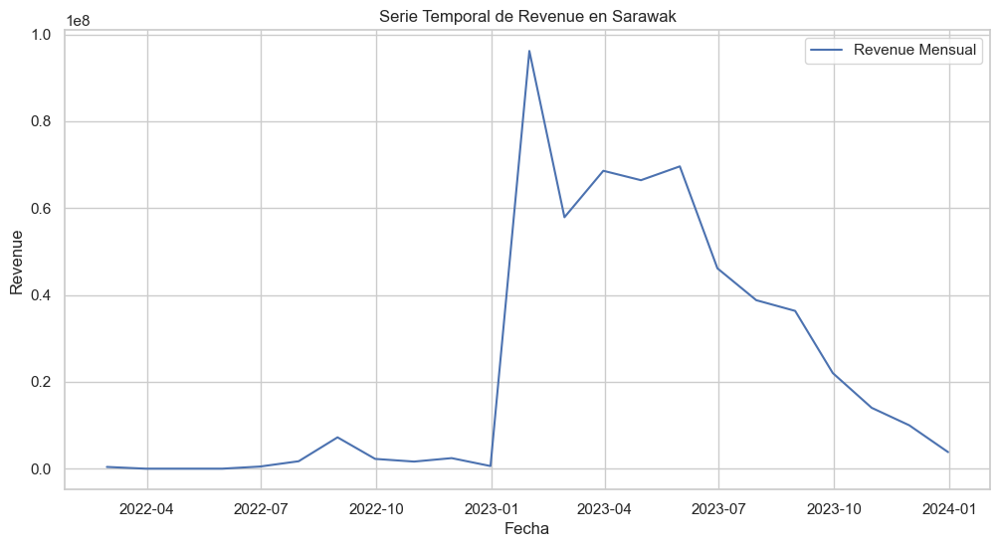

Estadístico ADF: -1.941049814421653
p-value: 0.3130030835057894
Estadístico ADF después de diferenciar: -6.197731832649325
p-value: 5.9090558875730305e-08


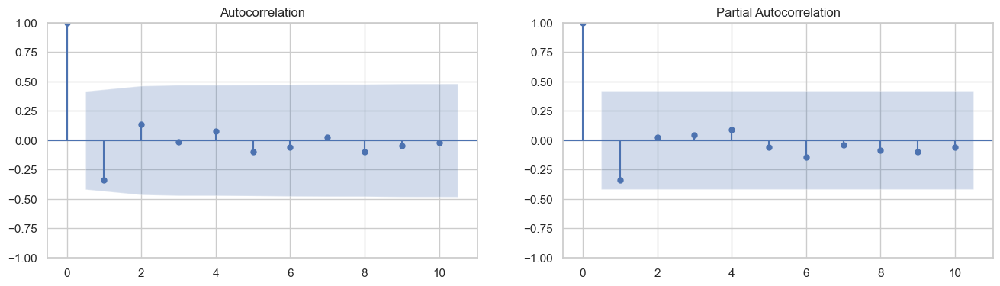

                               SARIMAX Results                                
Dep. Variable:                Revenue   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -313.186
Date:               do., 03 nov. 2024   AIC                            634.372
Time:                        21:32:48   BIC                            637.705
Sample:                    03-31-2022   HQIC                           634.703
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.258e+06   8.31e+06      0.272      0.786    -1.4e+07    1.86e+07
ar.L1         -0.0809      4.466     -0.018      0.986      -8.833       8.671
ma.L1         -0.3184      4.482     -0.071      0.9

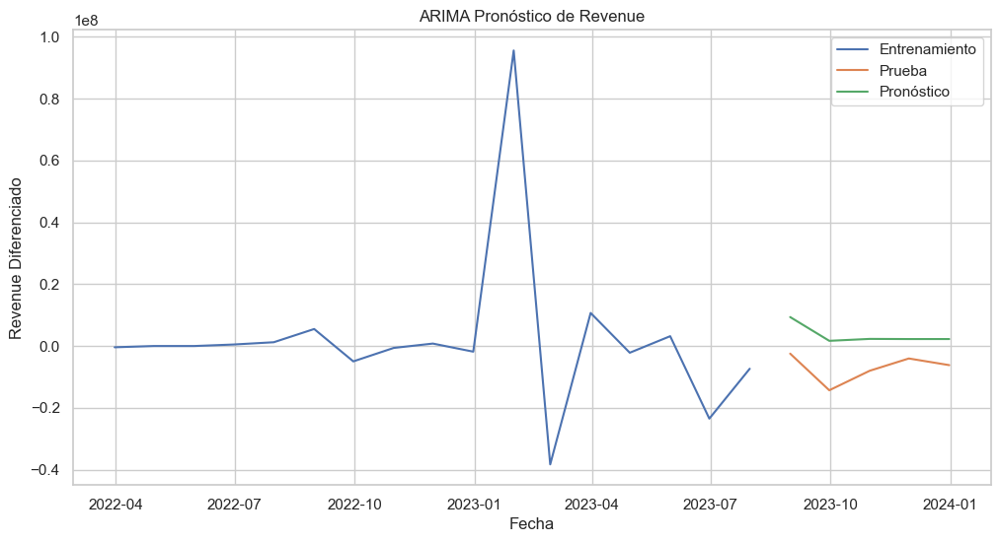

RMSE: 3326.6025750491176


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak'].copy()

# 2. Preparar la serie temporal
df_sarawak['Start_Date_Corrected'] = pd.to_datetime(df_sarawak['Start_Date_Corrected'])
df_sarawak.set_index('Start_Date_Corrected', inplace=True)
df_sarawak.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_sarawak['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Sarawak')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


## SARIMA

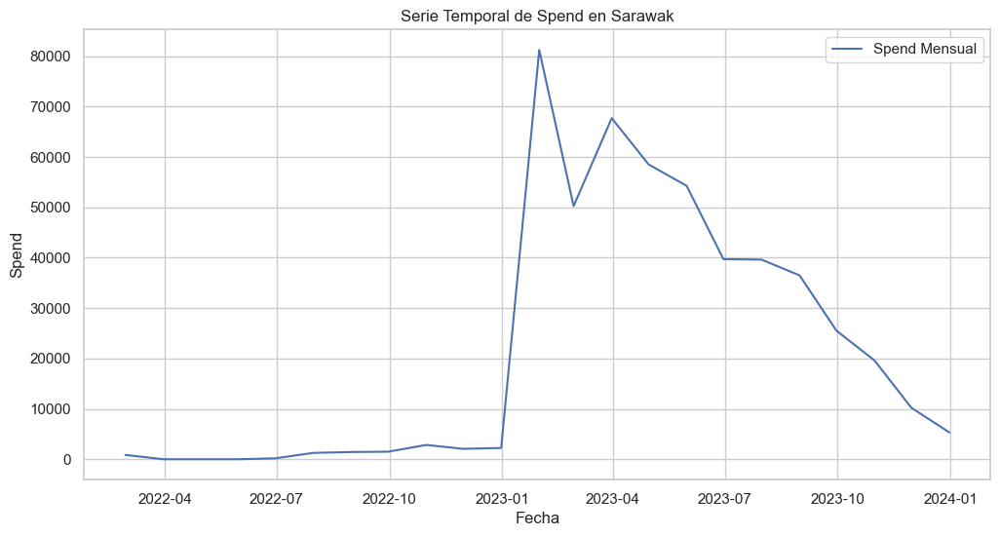

Estadístico ADF: -1.8429628167808818
p-value: 0.3593499479047143
Estadístico ADF después de diferenciar: -6.280045075091573
p-value: 3.8161671764510126e-08


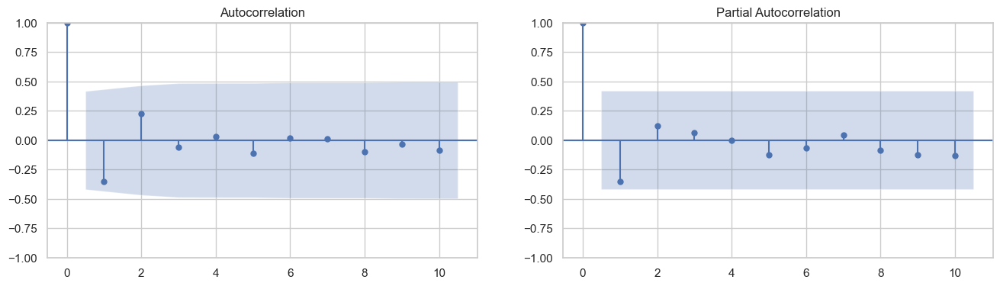

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -42.732
Date:                           do., 03 nov. 2024   AIC                             95.464
Time:                                    21:32:49   BIC                             92.396
Sample:                                03-31-2022   HQIC                            88.731
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.6660      3.514     -0.190      0.850      -7.554       6.222
ma.L1          0.4772      7.113   

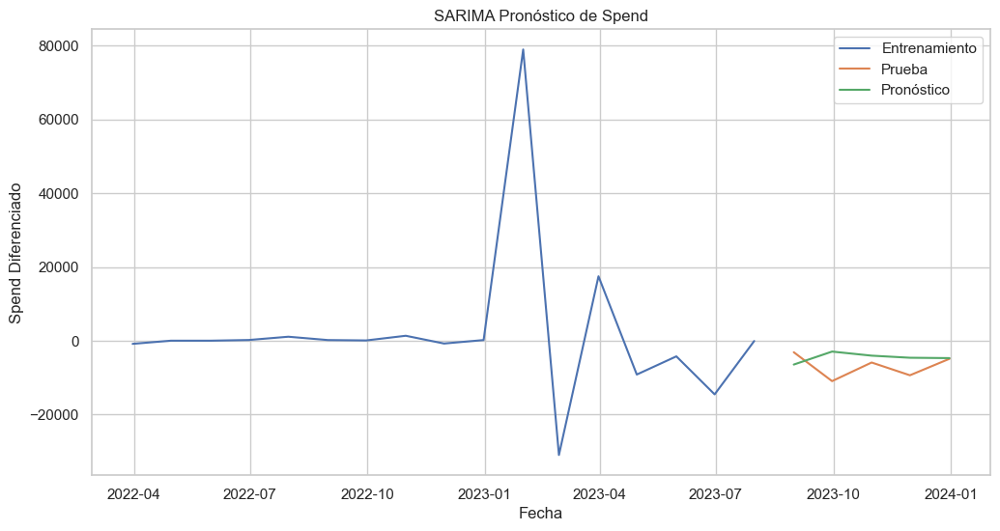

RMSE: 67.13227703365342


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak'].copy()

# 2. Preparar la serie temporal
df_sarawak['Start_Date_Corrected'] = pd.to_datetime(df_sarawak['Start_Date_Corrected'])
df_sarawak.set_index('Start_Date_Corrected', inplace=True)
df_sarawak.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_sarawak['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Sarawak')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'Start_Date_Corrected' does not exist in the dataframe.


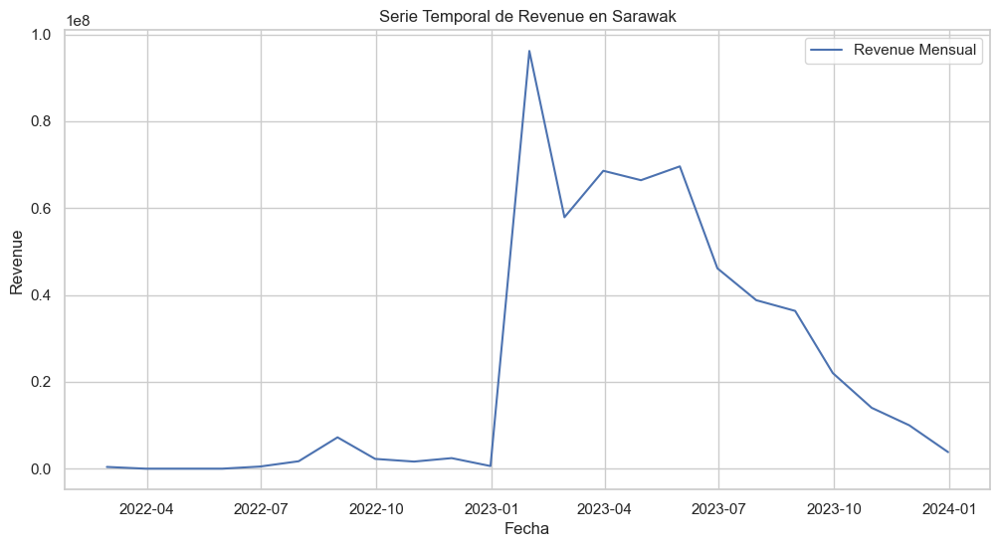

Estadístico ADF: -1.941049814421653
p-value: 0.3130030835057894
Estadístico ADF después de diferenciar: -6.197731832649325
p-value: 5.9090558875730305e-08


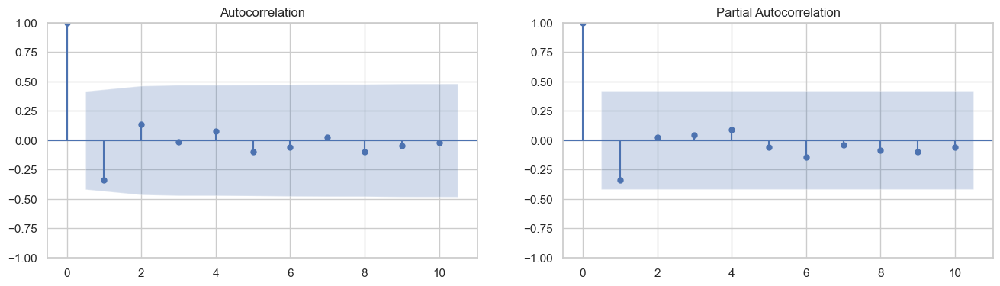

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -71.198
Date:                           do., 03 nov. 2024   AIC                            152.395
Time:                                    21:32:50   BIC                            149.327
Sample:                                03-31-2022   HQIC                           145.662
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0106      4.653     -0.002      0.998      -9.130       9.109
ma.L1         -0.7598      9.919   

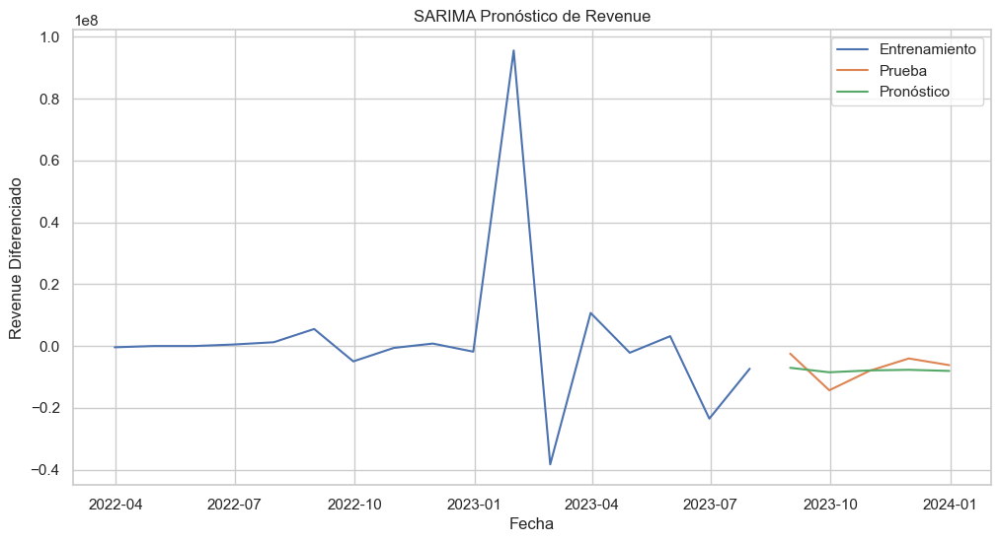

RMSE: 1946.3347159055477


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'Start_Date_Corrected' column exists
if 'Start_Date_Corrected' in df_sarawak.columns:
    df_sarawak['Start_Date_Corrected'] = pd.to_datetime(df_sarawak['Start_Date_Corrected'])
else:
    print("Column 'Start_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_sarawak['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Sarawak')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


# PENANG

In [ ]:
df_penang = df[df['Region'] == 'Penang']

df_grouped = df_penang.groupby(['Channel', 'Product_Category', 'Market_Segment']).size().reset_index(name='Count')

fig = px.sunburst(
    df_grouped,
    path=['Channel', 'Product_Category', 'Market_Segment'],
    values='Count',
    title='Distribución de Canal, Producto y Segmento de Mercado en Penang',
    width=900,   
    height=900   
)

fig.show()


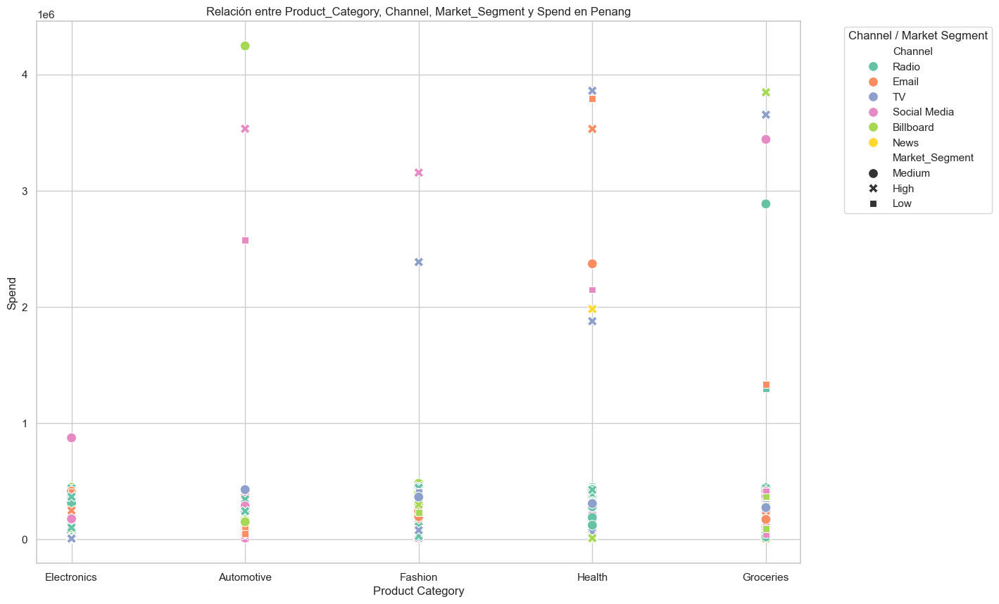

In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_penang, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Penang')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [ ]:
# Filtrar los datos donde la región es Penang
df_penang = df[df['Region'] == 'Penang']

# Seleccionar las columnas deseadas
tabla_penang = df_penang[['Product_Category', 'Channel', 'Market_Segment', 'Spend']]

# Mostrar la tabla
print(tabla_penang)


     Product_Category       Channel Market_Segment         Spend
2         Electronics         Radio         Medium  6.745000e+03
3         Electronics         Email           High  3.291120e+05
5         Electronics            TV         Medium           NaN
10         Automotive         Email            Low  2.732020e+05
23            Fashion  Social Media         Medium  7.497700e+04
25            Fashion            TV           High  2.605570e+05
29        Electronics         Radio           High  2.621900e+04
34        Electronics     Billboard         Medium  1.825270e+05
41            Fashion         Radio            Low  1.000400e+05
43        Electronics     Billboard         Medium           NaN
44             Health         Email           High  3.530658e+06
49             Health  Social Media           High           NaN
57             Health         Email            Low  3.793472e+06
58             Health         Radio            Low  5.642100e+04
59            Fashion    

In [ ]:
tabla_penang.isnull().sum()


Product_Category      0
Channel               0
Market_Segment        0
Spend               104
dtype: int64

In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestRegressor  # Import the missing module

# Encode categorical variables
label_encoders = {}
df_penang_copy = df_penang.copy()  # Define df_penang_copy
for col in columnas_relevantes:
    le = LabelEncoder()
    df_penang_copy[col] = le.fit_transform(df_penang_copy[col].astype(str))
    label_encoders[col] = le

# Dividir los datos en entrenamiento y prueba
df_train = df_penang_copy[df_penang_copy['Spend'].notna()]
df_test = df_penang_copy[df_penang_copy['Spend'].isna()]

# Definir las características (X) y la variable objetivo (y)
X_train = df_train[columnas_relevantes]
y_train = df_train['Spend']
X_test = df_test[columnas_relevantes]

# Crear y entrenar el modelo de regresión
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Verificar si df_test está vacío antes de predecir
if not df_test.empty:
    # Predecir los valores faltantes en 'Spend'
    y_pred = model.predict(X_test)

    # Rellenar los valores nulos en 'Spend' con las predicciones
    df_penang_copy.loc[df_penang_copy['Spend'].isna(), 'Spend'] = y_pred

# Verificar que no haya valores nulos en 'Spend'
print(df_penang_copy['Spend'].isnull().sum())


0


In [ ]:
# Actualizar los valores de 'Spend' en el dataframe original 'df' con los valores corregidos de 'df_penang_copy'
df.loc[df_penang_copy.index, 'Spend'] = df_penang_copy['Spend']

# Actualizar la tabla 'tabla_penang' con los valores corregidos de 'Spend'
tabla_penang['Spend'] = df.loc[tabla_penang.index, 'Spend']

# Mostrar la tabla actualizada
print(tabla_penang)


     Product_Category       Channel Market_Segment  Spend
2         Electronics         Radio         Medium  783.0
3         Electronics         Email           High  474.0
5         Electronics            TV         Medium  864.0
10         Automotive         Email            Low  350.0
23            Fashion  Social Media         Medium  800.0
25            Fashion            TV           High  328.0
29        Electronics         Radio           High  331.0
34        Electronics     Billboard         Medium  164.0
41            Fashion         Radio            Low    0.0
43        Electronics     Billboard         Medium  864.0
44             Health         Email           High  521.0
49             Health  Social Media           High  864.0
57             Health         Email            Low  577.0
58             Health         Radio            Low  747.0
59            Fashion            TV           High  591.0
64          Groceries            TV           High  377.0
68            

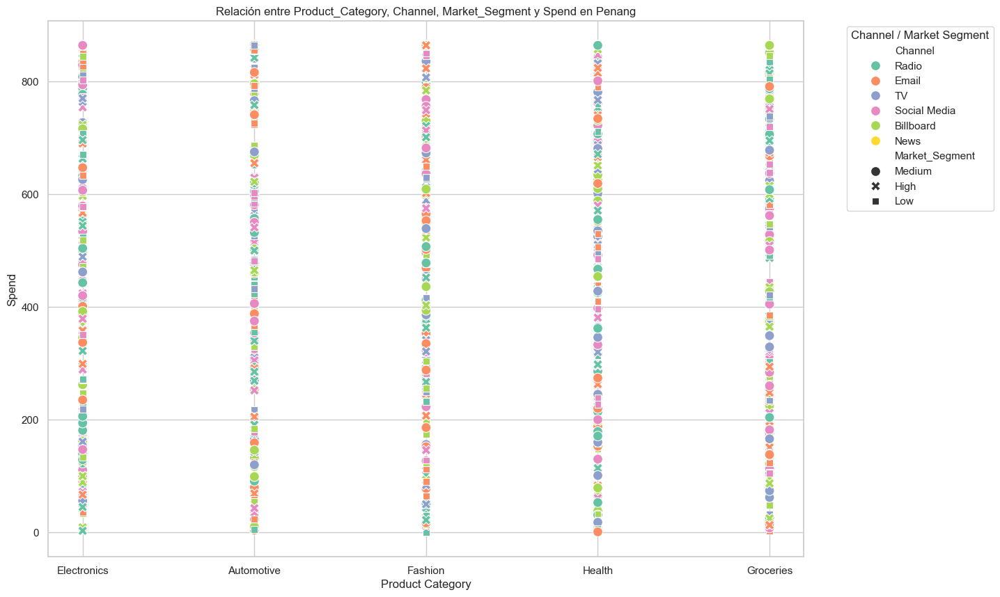

In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_penang, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Penang')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [ ]:
from sklearn.ensemble import IsolationForest

# Seleccionar la columna 'Spend' de la tabla_penang
X = tabla_penang[['Spend']]

# Crear el modelo Isolation Forest
iso_forest = IsolationForest(contamination=0.015, random_state=42)
iso_forest.fit(X)

# Predecir anomalías (-1 es outlier, 1 es normal)
tabla_penang['anomaly'] = iso_forest.predict(X)

# Filtrar los outliers
outliers = tabla_penang[tabla_penang['anomaly'] == -1]
tabla_penang_clean = tabla_penang[tabla_penang['anomaly'] == 1]

# Mostrar los resultados
print("Outliers detectados:")
print(outliers)
print("\nTabla sin outliers:")
print(tabla_penang_clean)
tabla_penang.shape


Outliers detectados:
     Product_Category       Channel Market_Segment  Spend  anomaly
41            Fashion         Radio            Low    0.0       -1
211           Fashion  Social Media           High   12.0       -1
423         Groceries         Email            Low    2.0       -1
591         Groceries  Social Media         Medium    8.0       -1
653            Health  Social Media         Medium    7.0       -1
1751           Health  Social Media           High   11.0       -1
2600       Automotive         Email         Medium    4.0       -1
3111      Electronics     Billboard           High    9.0       -1
3210           Health         Radio            Low    6.0       -1
3418      Electronics         Radio           High    3.0       -1
3688       Automotive         Email         Medium  858.0       -1
3805       Automotive     Billboard         Medium   10.0       -1
3887           Health         Email         Medium    1.0       -1
3914       Automotive         Radio      

(970, 5)

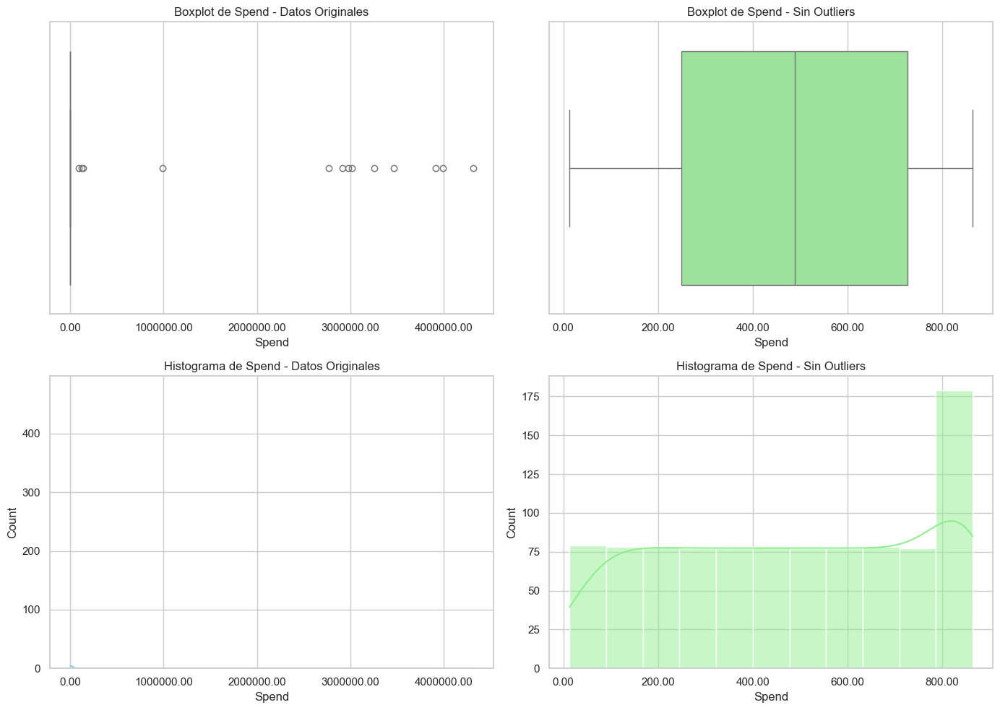

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar el estilo de Seaborn
sns.set(style='whitegrid')

# Crear una figura con 2 filas y 2 columnas de subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Gráfico de caja para 'Spend' en el dataframe original
sns.boxplot(data=df, x='Spend', ax=axes[0, 0], color='skyblue')
axes[0, 0].set_title('Boxplot de Spend - Datos Originales')

# Redondear los valores en los ejes a 2 decimales
axes[0, 0].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[1, 0].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[0, 1].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[1, 1].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))

# Histograma para 'Spend' en el dataframe original
sns.histplot(data=df, x='Spend', kde=True, ax=axes[1, 0], color='skyblue')
axes[1, 0].set_title('Histograma de Spend - Datos Originales')

# Gráfico de caja para 'Spend' en el dataframe sin outliers
sns.boxplot(data=tabla_penang_clean, x='Spend', ax=axes[0, 1], color='lightgreen')
axes[0, 1].set_title('Boxplot de Spend - Sin Outliers')

# Histograma para 'Spend' en el dataframe sin outliers
sns.histplot(data=tabla_penang_clean, x='Spend', kde=True, ax=axes[1, 1], color='lightgreen')
axes[1, 1].set_title('Histograma de Spend - Sin Outliers')

# Ajustar el espacio entre subplots
plt.tight_layout()

# Mostrar las gráficas
plt.show()


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Agrupar por Channel, Market_Segment y Product_Category y calcular las estadísticas
estadisticas_spend = df_penang.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var'])

# Mostrar todas las filas
pd.set_option('display.max_rows', None)

# Mostrar las estadísticas
print(estadisticas_spend)


                                                    mean  median  \
Channel      Market_Segment Product_Category                       
Billboard    High           Automotive        493.428571   481.0   
                            Electronics       405.200000   384.0   
                            Fashion           416.846154   403.0   
                            Groceries         428.888889   400.0   
                            Health            518.909091   456.0   
             Low            Automotive        406.100000   430.0   
                            Electronics       575.833333   590.5   
                            Fashion           416.350000   367.5   
                            Groceries         486.250000   480.0   
                            Health            256.750000   227.5   
             Medium         Automotive        286.000000   146.0   
                            Electronics       488.000000   480.0   
                            Fashion           57

Cantidad de valores nulos en 'Start_Date_Corrected' para Penang: 8


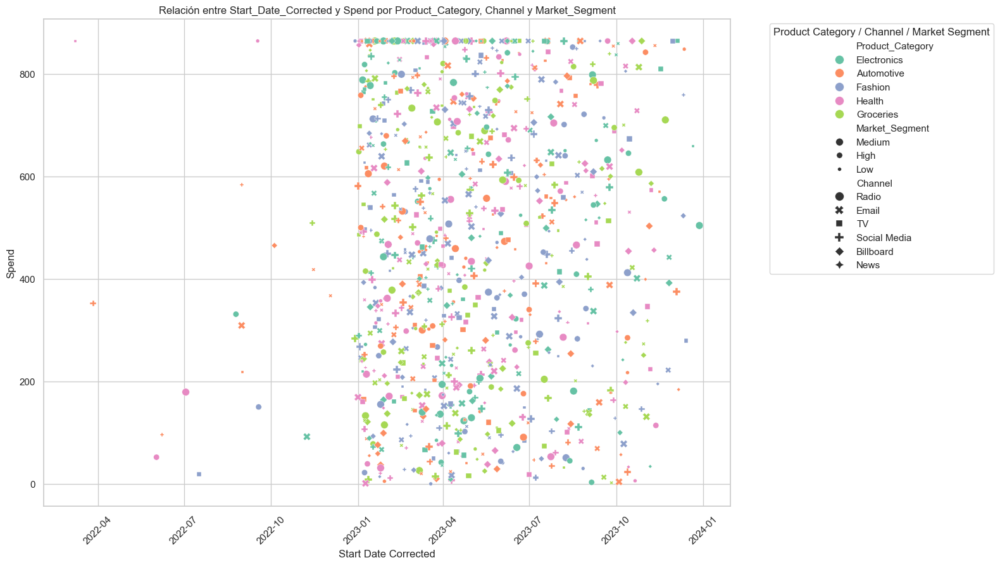

In [ ]:
# Asegurarse de que la columna 'Start_Date_Corrected' esté en tabla_penang
tabla_penang['Start_Date_Corrected'] = df_penang['Start_Date_Corrected']

# Localizar los datos de la columna 'Start_Date_Corrected' en la tabla_penang
start_date_corrected_penang = tabla_penang['Start_Date_Corrected']

# Contar los valores nulos en la columna 'Start_Date_Corrected'
nulos_start_date_corrected = start_date_corrected_penang.isnull().sum()

print(f"Cantidad de valores nulos en 'Start_Date_Corrected' para Penang: {nulos_start_date_corrected}")

# Crear una gráfica de relación entre las variables con el momento de inicio de campaña
plt.figure(figsize=(14, 10))
sns.scatterplot(data=tabla_penang, x='Start_Date_Corrected', y='Spend', hue='Product_Category', style='Channel', size='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Start_Date_Corrected y Spend por Product_Category, Channel y Market_Segment')
plt.xlabel('Start Date Corrected')
plt.ylabel('Spend')
plt.legend(title='Product Category / Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()


In [ ]:
# Identificar las columnas con datos nulos
columnas_con_nulos = tabla_penang.isnull().sum()

# Filtrar solo las columnas que tienen datos nulos
columnas_con_nulos = columnas_con_nulos[columnas_con_nulos > 0]

print("Columnas con datos nulos y su cantidad:")
print(columnas_con_nulos)


Columnas con datos nulos y su cantidad:
Start_Date_Corrected    8
dtype: int64


# ARIMA

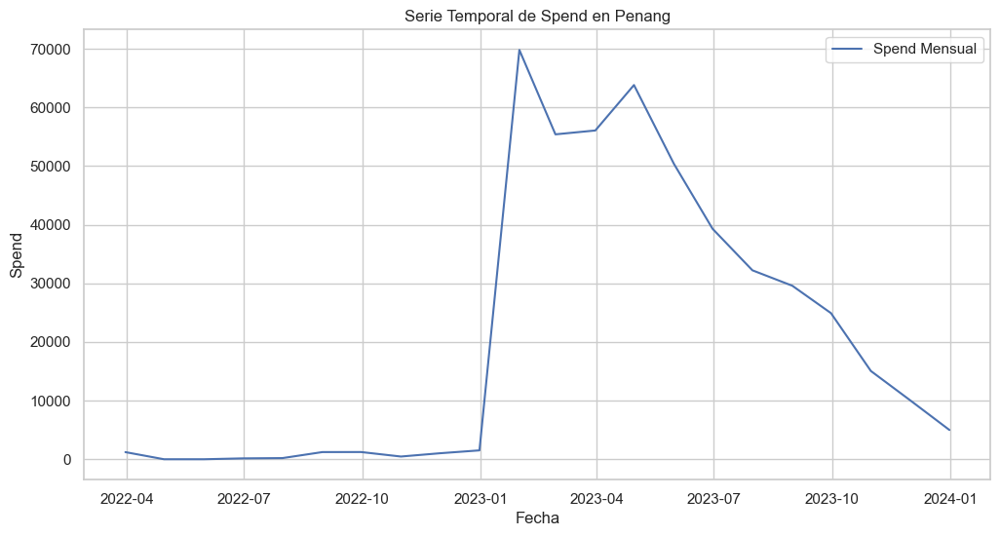

Estadístico ADF: -6.731706225337821
p-value: 3.2834318820379875e-09
Estadístico ADF después de diferenciar: -6.731706225337821
p-value: 3.2834318820379875e-09


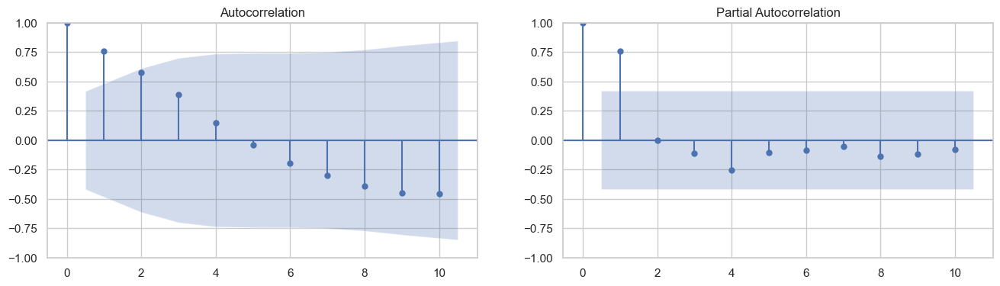

                               SARIMAX Results                                
Dep. Variable:                  Spend   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -190.126
Date:               do., 03 nov. 2024   AIC                            388.253
Time:                        21:34:06   BIC                            391.586
Sample:                    03-31-2022   HQIC                           388.584
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         2.2e+04   2.22e+04      0.991      0.322   -2.15e+04    6.55e+04
ar.L1          0.7620      0.905      0.842      0.400      -1.012       2.536
ma.L1         -0.0436      3.562     -0.012      0.9

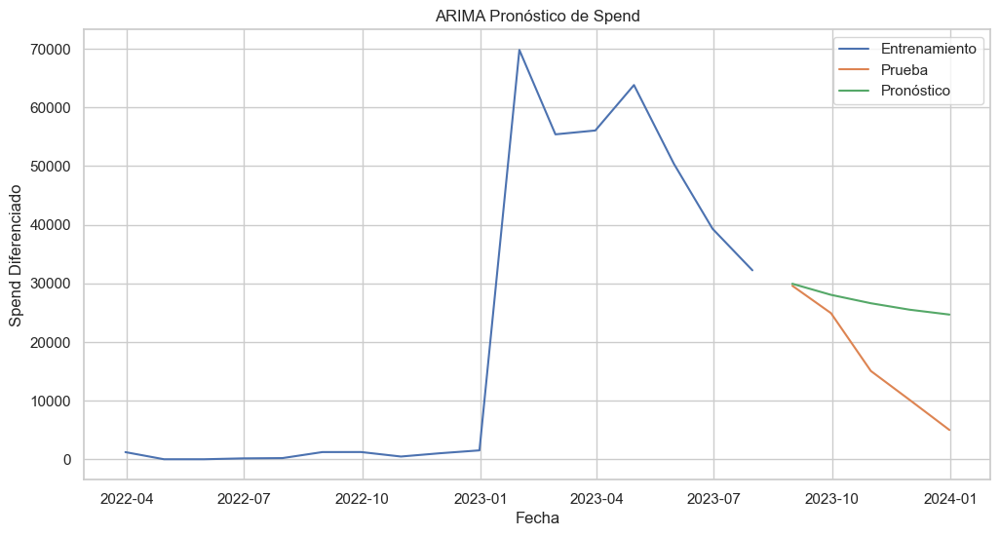

RMSE: 111.27966302183447


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Penang
df_penang = df[df['Region'] == 'Penang'].copy()

# 2. Preparar la serie temporal
df_penang['Start_Date_Corrected'] = pd.to_datetime(df_penang['Start_Date_Corrected'])
df_penang.set_index('Start_Date_Corrected', inplace=True)
df_penang.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_penang['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Penang')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


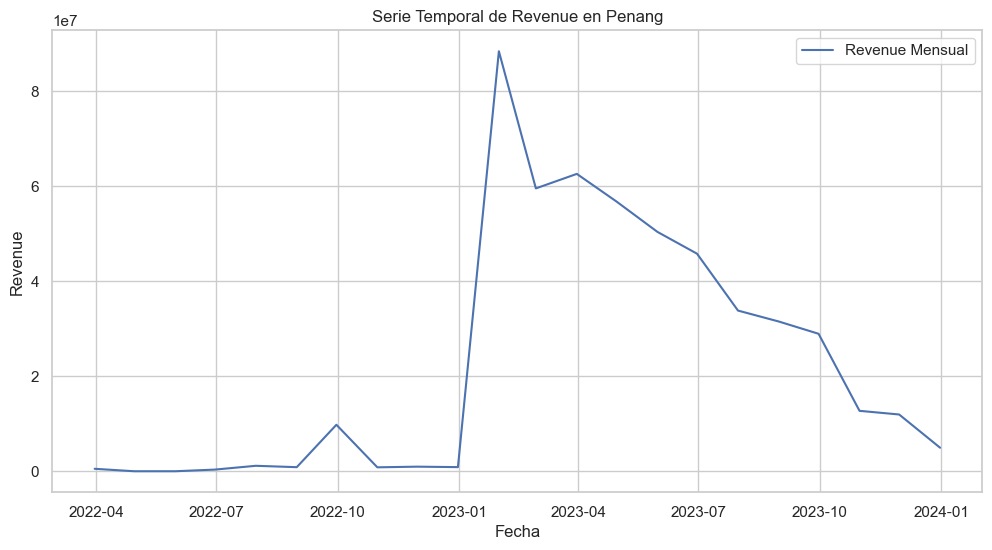

Estadístico ADF: -6.181202086121585
p-value: 6.448808397425103e-08
Estadístico ADF después de diferenciar: -6.181202086121585
p-value: 6.448808397425103e-08


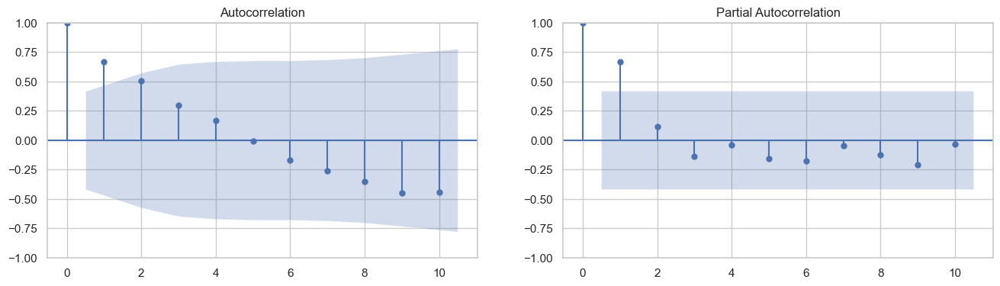

                               SARIMAX Results                                
Dep. Variable:                Revenue   No. Observations:                   17
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -311.257
Date:               do., 03 nov. 2024   AIC                            630.515
Time:                        21:34:07   BIC                            633.848
Sample:                    03-31-2022   HQIC                           630.846
                         - 07-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.426e+07   1.44e-07   1.69e+14      0.000    2.43e+07    2.43e+07
ar.L1          0.7415      1.209      0.613      0.540      -1.629       3.112
ma.L1         -0.1579      3.667     -0.043      0.9

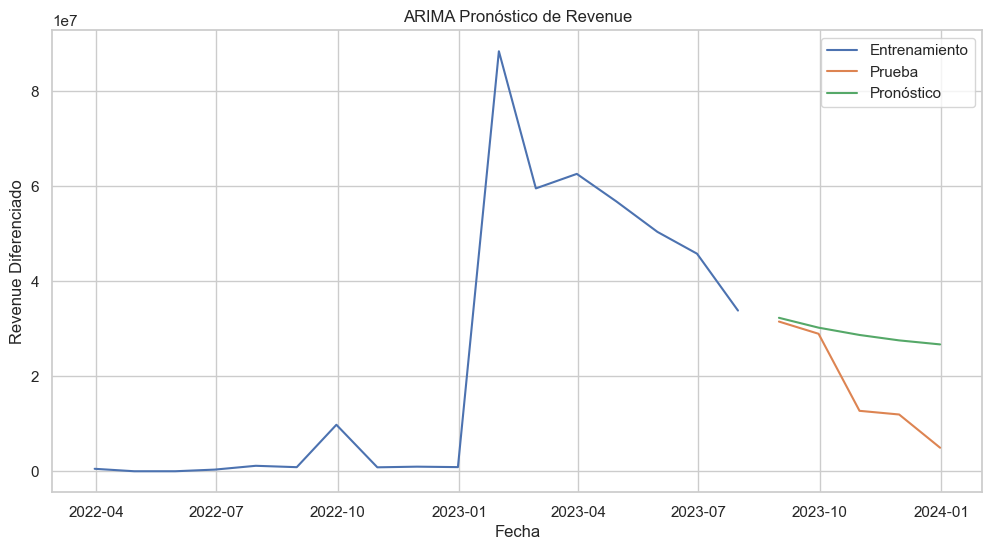

RMSE: 3734.506515427573


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Penang
df_penang = df[df['Region'] == 'Penang'].copy()

# 2. Preparar la serie temporal
df_penang['Start_Date_Corrected'] = pd.to_datetime(df_penang['Start_Date_Corrected'])
df_penang.set_index('Start_Date_Corrected', inplace=True)
df_penang.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_penang['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Penang')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


# SARIMA

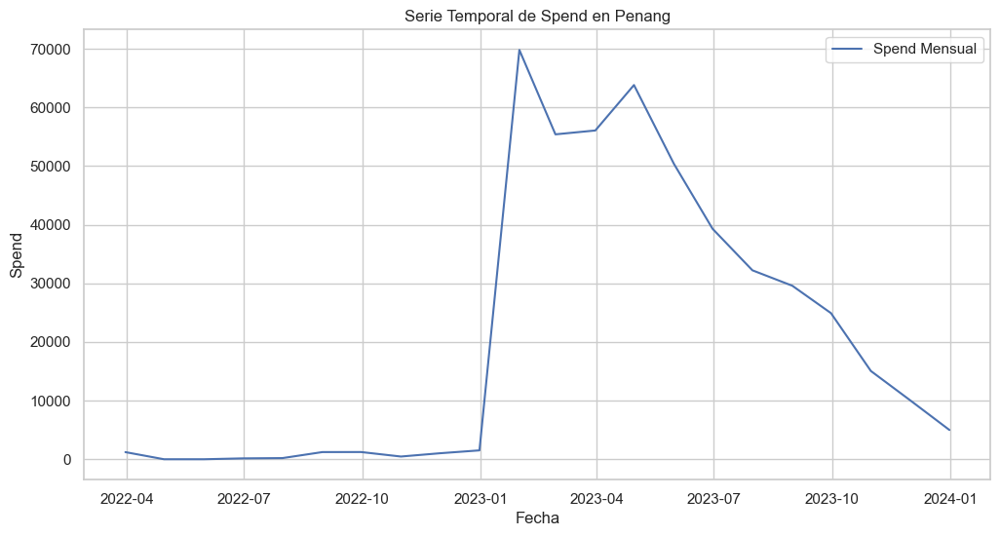

Estadístico ADF: -6.731706225337821
p-value: 3.2834318820379875e-09
Estadístico ADF después de diferenciar: -6.731706225337821
p-value: 3.2834318820379875e-09


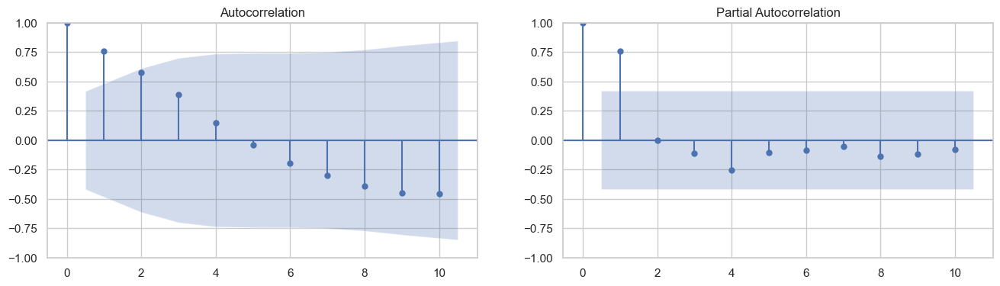

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -41.193
Date:                           do., 03 nov. 2024   AIC                             92.386
Time:                                    21:34:08   BIC                             89.318
Sample:                                03-31-2022   HQIC                            85.652
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0775      1.479     -0.052      0.958      -2.977       2.822
ma.L1          0.5764      2.513   

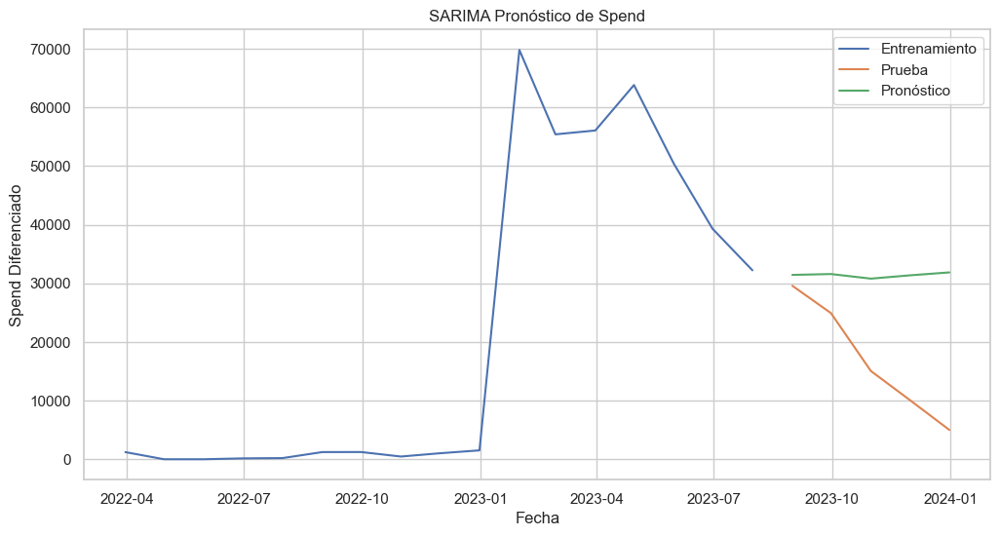

RMSE: 130.908865176051


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Penang
df_penang = df[df['Region'] == 'Penang'].copy()

# 2. Preparar la serie temporal
df_penang['Start_Date_Corrected'] = pd.to_datetime(df_penang['Start_Date_Corrected'])
df_penang.set_index('Start_Date_Corrected', inplace=True)
df_penang.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_penang['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Penang')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'Start_Date_Corrected' does not exist in the dataframe.


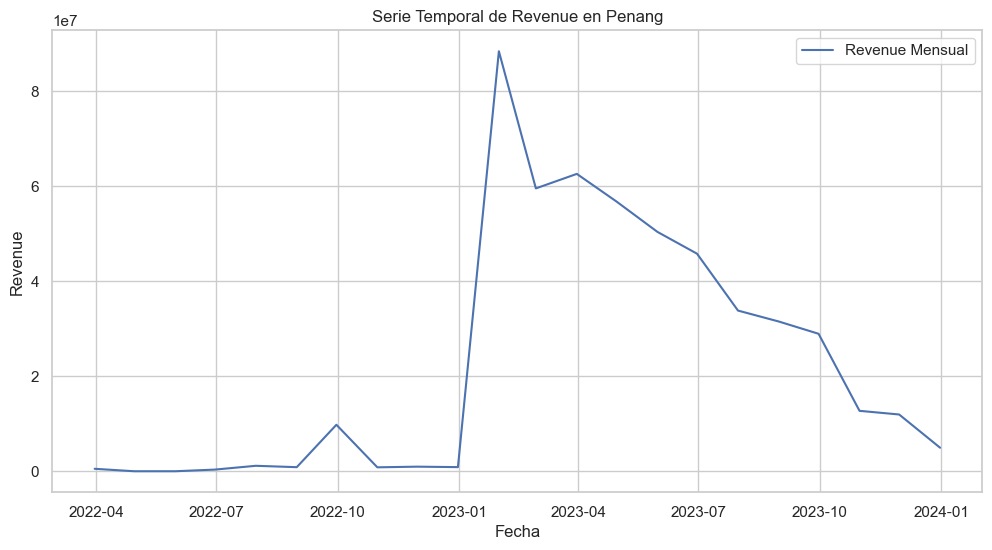

Estadístico ADF: -6.181202086121585
p-value: 6.448808397425103e-08
Estadístico ADF después de diferenciar: -6.181202086121585
p-value: 6.448808397425103e-08


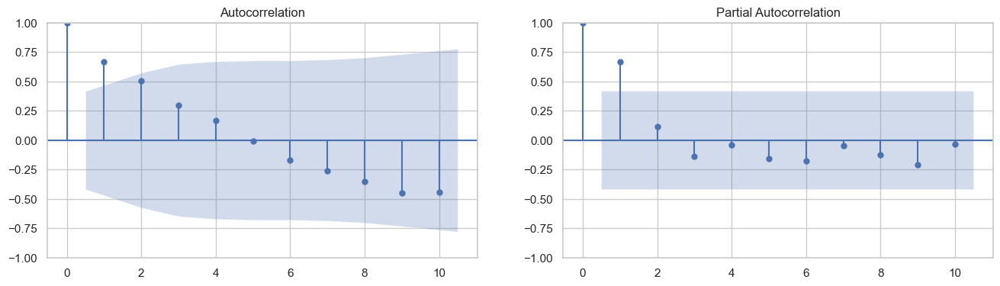

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -67.716
Date:                           do., 03 nov. 2024   AIC                            145.432
Time:                                    21:34:10   BIC                            142.364
Sample:                                03-31-2022   HQIC                           138.699
                                     - 07-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000      0.113      8.835      0.000       0.778       1.222
ma.L1         -0.1519      0.617   

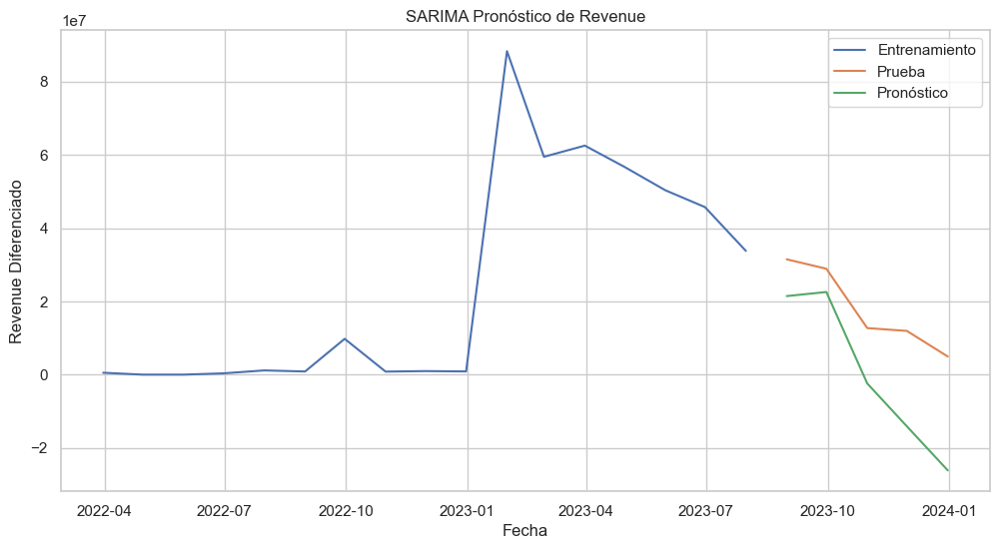

RMSE: 4481.549722987293


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'Start_Date_Corrected' column exists
if 'Start_Date_Corrected' in df_penang.columns:
    df_penang['Start_Date_Corrected'] = pd.to_datetime(df_penang['Start_Date_Corrected'])
else:
    print("Column 'Start_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_penang['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Penang')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


# MALACCA

In [ ]:
df_malacca = df[df['Region'] == 'Malacca']

df_grouped = df_malacca.groupby(['Channel', 'Product_Category', 'Market_Segment']).size().reset_index(name='Count')

fig = px.sunburst(
    df_grouped,
    path=['Channel', 'Product_Category', 'Market_Segment'],
    values='Count',
    title='Distribución de Canal, Producto y Segmento de Mercado en Malacca',
    width=900,   
    height=900   
)

fig.show()


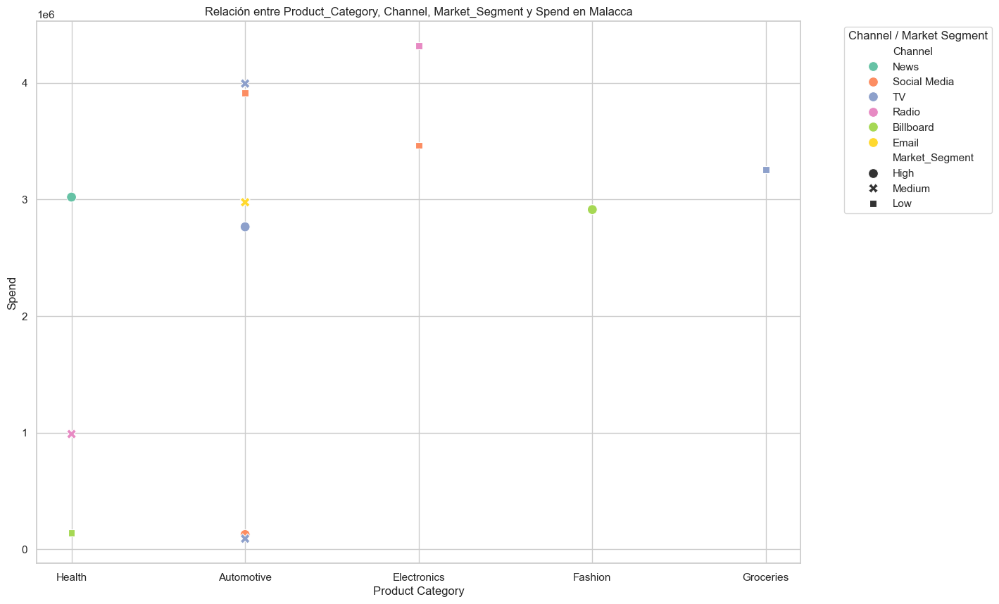

In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_malacca, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Malacca')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [ ]:
# Filtrar los datos donde la región es Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Seleccionar las columnas deseadas
tabla_malacca = df_malacca[['Product_Category', 'Channel', 'Market_Segment', 'Spend']]

# Mostrar la tabla
print(tabla_malacca)


     Product_Category       Channel Market_Segment      Spend
240            Health          News           High  3020470.0
248        Automotive  Social Media           High   126483.0
528        Automotive            TV         Medium    91250.0
554       Electronics         Radio            Low  4317430.0
569           Fashion     Billboard           High  2913680.0
614        Automotive  Social Media            Low  3912060.0
686         Groceries            TV            Low  3253940.0
742        Automotive            TV         Medium  3994350.0
3096           Health         Radio         Medium   988510.0
3151      Electronics  Social Media            Low  3464710.0
4571       Automotive            TV           High  2765790.0
4598           Health     Billboard            Low   140290.0
4635       Automotive         Email         Medium  2976450.0


In [ ]:
tabla_malacca.isnull().sum()


Product_Category    0
Channel             0
Market_Segment      0
Spend               0
dtype: int64

In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestRegressor  # Import the missing module

# Encode categorical variables
label_encoders = {}
df_malacca_copy = df_malacca.copy()  # Define df_malacca_copy
for col in columnas_relevantes:
    le = LabelEncoder()
    df_malacca_copy[col] = le.fit_transform(df_malacca_copy[col].astype(str))
    label_encoders[col] = le

# Dividir los datos en entrenamiento y prueba
df_train = df_malacca_copy[df_malacca_copy['Spend'].notna()]
df_test = df_malacca_copy[df_malacca_copy['Spend'].isna()]

# Definir las características (X) y la variable objetivo (y)
X_train = df_train[columnas_relevantes]
y_train = df_train['Spend']
X_test = df_test[columnas_relevantes]

# Crear y entrenar el modelo de regresión
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Verificar si df_test está vacío antes de predecir
if not df_test.empty:
    # Predecir los valores faltantes en 'Spend'
    y_pred = model.predict(X_test)

    # Rellenar los valores nulos en 'Spend' con las predicciones
    df_malacca_copy.loc[df_malacca_copy['Spend'].isna(), 'Spend'] = y_pred

# Verificar que no haya valores nulos en 'Spend'
print(df_malacca_copy['Spend'].isnull().sum())


0


In [ ]:
# Reset the index of df_malacca_copy to align with df
df_malacca_copy_reset = df_malacca_copy.reset_index()

# Update the 'Spend' values in the original dataframe 'df' with the corrected values from 'df_malacca_copy_reset'
df.update(df_malacca_copy_reset[['Spend']])

# Update the 'tabla_malacca' table with the corrected 'Spend' values
tabla_malacca['Spend'] = df.loc[tabla_malacca.index, 'Spend']

# Display the updated table
print(tabla_malacca)


     Product_Category       Channel Market_Segment      Spend
240            Health          News           High  3020470.0
248        Automotive  Social Media           High   126483.0
528        Automotive            TV         Medium    91250.0
554       Electronics         Radio            Low  4317430.0
569           Fashion     Billboard           High  2913680.0
614        Automotive  Social Media            Low  3912060.0
686         Groceries            TV            Low  3253940.0
742        Automotive            TV         Medium  3994350.0
3096           Health         Radio         Medium   988510.0
3151      Electronics  Social Media            Low  3464710.0
4571       Automotive            TV           High  2765790.0
4598           Health     Billboard            Low   140290.0
4635       Automotive         Email         Medium  2976450.0


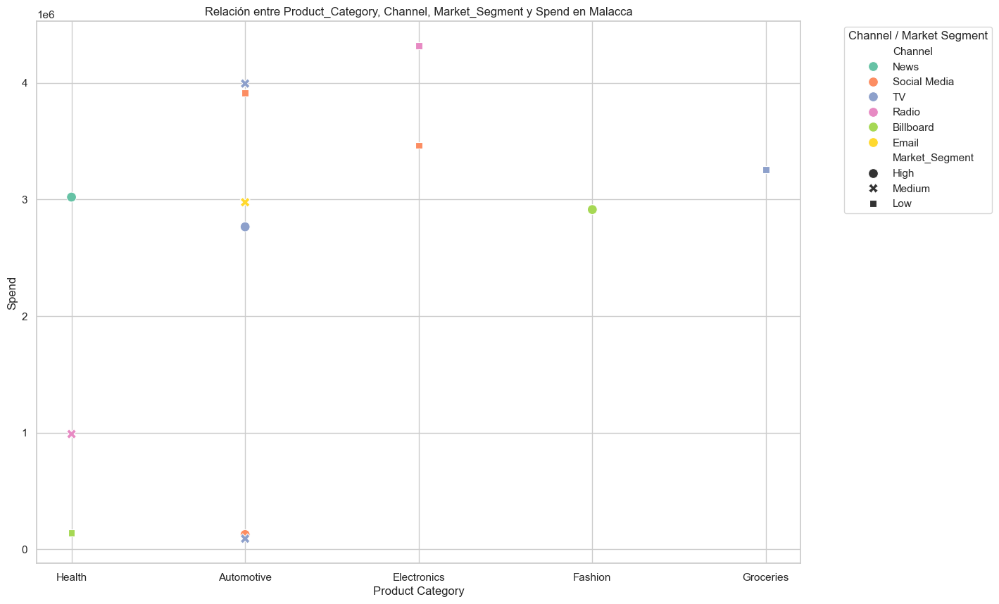

In [ ]:
#Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión
plt.figure(figsize=(14, 10))
sns.scatterplot(data=df_malacca, x='Product_Category', y='Spend', hue='Channel', style='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Product_Category, Channel, Market_Segment y Spend en Malacca')
plt.xlabel('Product Category')
plt.ylabel('Spend')
plt.legend(title='Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [ ]:
from sklearn.ensemble import IsolationForest

# Seleccionar la columna 'Spend' de la tabla_malacca
X = tabla_malacca[['Spend']]

# Crear el modelo Isolation Forest
iso_forest = IsolationForest(contamination=0.015, random_state=42)
iso_forest.fit(X)

# Predecir anomalías (-1 es outlier, 1 es normal)
tabla_malacca['anomaly'] = iso_forest.predict(X)

# Filtrar los outliers
outliers = tabla_malacca[tabla_malacca['anomaly'] == -1]
tabla_malacca_clean = tabla_malacca[tabla_malacca['anomaly'] == 1]

# Mostrar los resultados
print("Outliers detectados:")
print(outliers)
print("\nTabla sin outliers:")
print(tabla_malacca_clean)
tabla_malacca.shape


Outliers detectados:
     Product_Category Channel Market_Segment     Spend  anomaly
3096           Health   Radio         Medium  988510.0       -1

Tabla sin outliers:
     Product_Category       Channel Market_Segment      Spend  anomaly
240            Health          News           High  3020470.0        1
248        Automotive  Social Media           High   126483.0        1
528        Automotive            TV         Medium    91250.0        1
554       Electronics         Radio            Low  4317430.0        1
569           Fashion     Billboard           High  2913680.0        1
614        Automotive  Social Media            Low  3912060.0        1
686         Groceries            TV            Low  3253940.0        1
742        Automotive            TV         Medium  3994350.0        1
3151      Electronics  Social Media            Low  3464710.0        1
4571       Automotive            TV           High  2765790.0        1
4598           Health     Billboard            Lo

(13, 5)

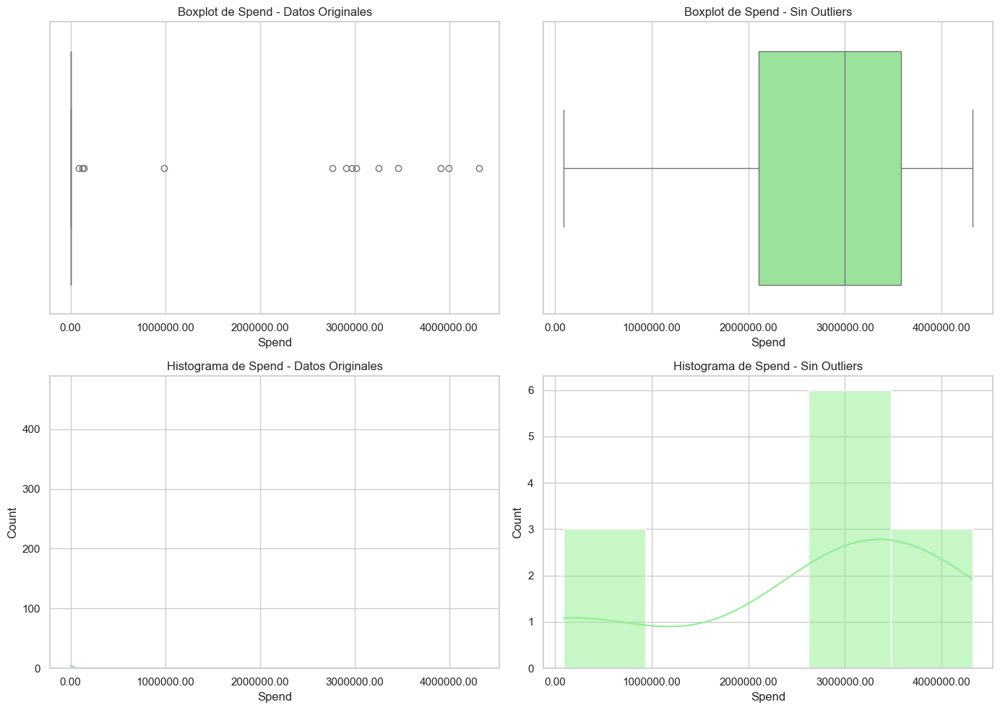

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar el estilo de Seaborn
sns.set(style='whitegrid')

# Crear una figura con 2 filas y 2 columnas de subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Gráfico de caja para 'Spend' en el dataframe original
sns.boxplot(data=df, x='Spend', ax=axes[0, 0], color='skyblue')
axes[0, 0].set_title('Boxplot de Spend - Datos Originales')

# Redondear los valores en los ejes a 2 decimales
axes[0, 0].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[1, 0].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[0, 1].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
axes[1, 1].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))

# Histograma para 'Spend' en el dataframe original
sns.histplot(data=df, x='Spend', kde=True, ax=axes[1, 0], color='skyblue')
axes[1, 0].set_title('Histograma de Spend - Datos Originales')

# Gráfico de caja para 'Spend' en el dataframe sin outliers
sns.boxplot(data=tabla_malacca_clean, x='Spend', ax=axes[0, 1], color='lightgreen')
axes[0, 1].set_title('Boxplot de Spend - Sin Outliers')

# Histograma para 'Spend' en el dataframe sin outliers
sns.histplot(data=tabla_malacca_clean, x='Spend', kde=True, ax=axes[1, 1], color='lightgreen')
axes[1, 1].set_title('Histograma de Spend - Sin Outliers')

# Ajustar el espacio entre subplots
plt.tight_layout()

# Mostrar las gráficas
plt.show()


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Agrupar por Channel, Market_Segment y Product_Category y calcular las estadísticas
estadisticas_spend = df_malacca.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var'])

# Mostrar todas las filas
pd.set_option('display.max_rows', None)

# Mostrar las estadísticas
print(estadisticas_spend)


                                                   mean     median  \
Channel      Market_Segment Product_Category                         
Billboard    High           Fashion           2913680.0  2913680.0   
             Low            Health             140290.0   140290.0   
Email        Medium         Automotive        2976450.0  2976450.0   
News         High           Health            3020470.0  3020470.0   
Radio        Low            Electronics       4317430.0  4317430.0   
             Medium         Health             988510.0   988510.0   
Social Media High           Automotive         126483.0   126483.0   
             Low            Automotive        3912060.0  3912060.0   
                            Electronics       3464710.0  3464710.0   
TV           High           Automotive        2765790.0  2765790.0   
             Low            Groceries         3253940.0  3253940.0   
             Medium         Automotive        2042800.0  2042800.0   

                   

Cantidad de valores nulos en 'Start_Date_Corrected' para Malacca: 0


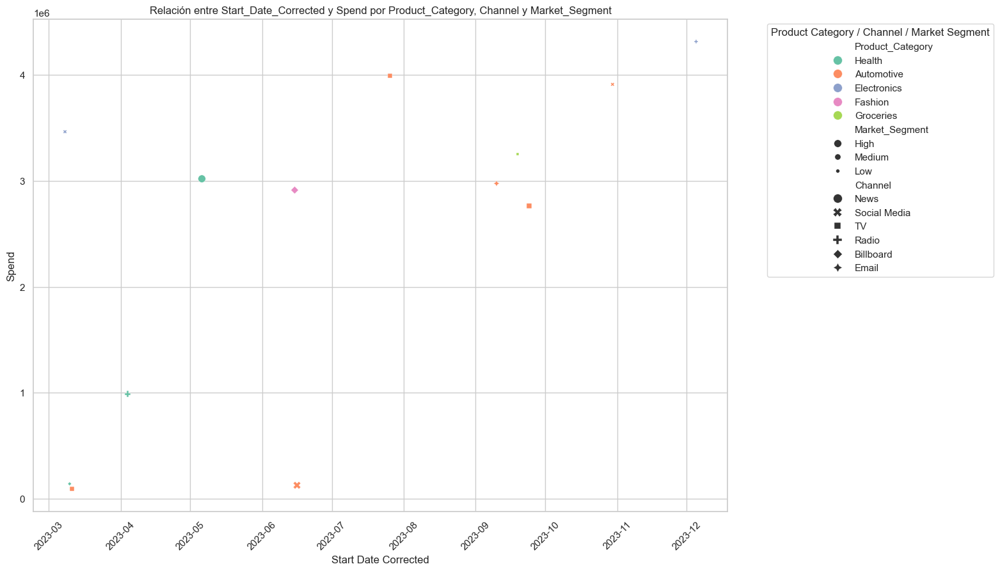

In [ ]:
# Asegurarse de que la columna 'Start_Date_Corrected' esté en tabla_malacca
tabla_malacca['Start_Date_Corrected'] = df_malacca['Start_Date_Corrected']

# Localizar los datos de la columna 'Start_Date_Corrected' en la tabla_malacca
start_date_corrected_malacca = tabla_malacca['Start_Date_Corrected']

# Contar los valores nulos en la columna 'Start_Date_Corrected'
nulos_start_date_corrected = start_date_corrected_malacca.isnull().sum()

print(f"Cantidad de valores nulos en 'Start_Date_Corrected' para Malacca: {nulos_start_date_corrected}")

# Crear una gráfica de relación entre las variables con el momento de inicio de campaña
plt.figure(figsize=(14, 10))
sns.scatterplot(data=tabla_malacca, x='Start_Date_Corrected', y='Spend', hue='Product_Category', style='Channel', size='Market_Segment', palette='Set2', s=100)
plt.title('Relación entre Start_Date_Corrected y Spend por Product_Category, Channel y Market_Segment')
plt.xlabel('Start Date Corrected')
plt.ylabel('Spend')
plt.legend(title='Product Category / Channel / Market Segment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()


## ARIMA

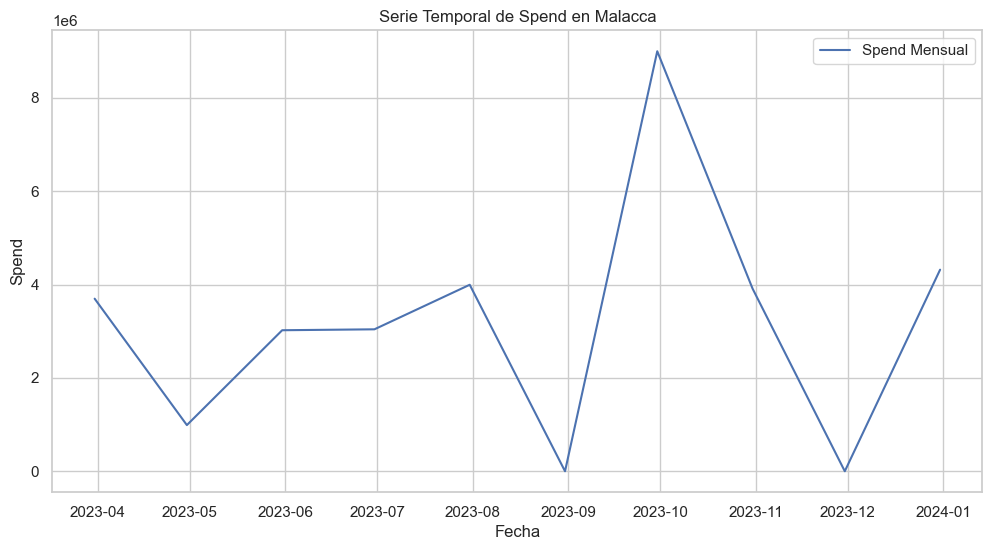

Estadístico ADF: 0.301561280565554
p-value: 0.9774160037119584
Estadístico ADF después de diferenciar: -6.434191490031183
p-value: 1.6685265789471763e-08


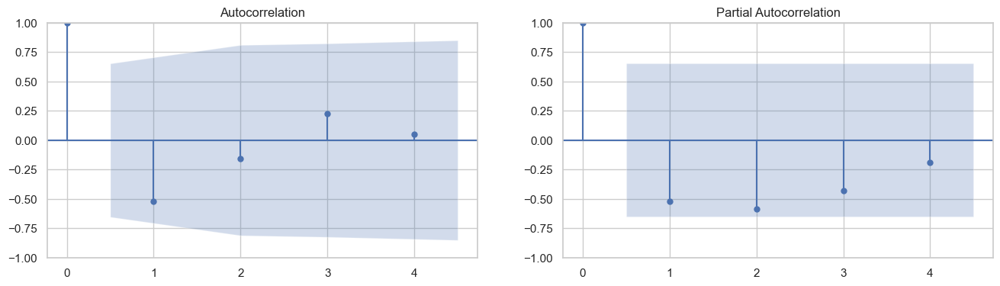

                               SARIMAX Results                                
Dep. Variable:                  Spend   No. Observations:                    7
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -114.009
Date:               do., 03 nov. 2024   AIC                            236.018
Time:                        21:35:28   BIC                            235.802
Sample:                    04-30-2023   HQIC                           233.344
                         - 10-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       3.083e+04    5.3e+05      0.058      0.954   -1.01e+06    1.07e+06
ar.L1         -0.5078      1.741     -0.292      0.770      -3.919       2.904
ma.L1         -0.4787      2.617     -0.183      0.8

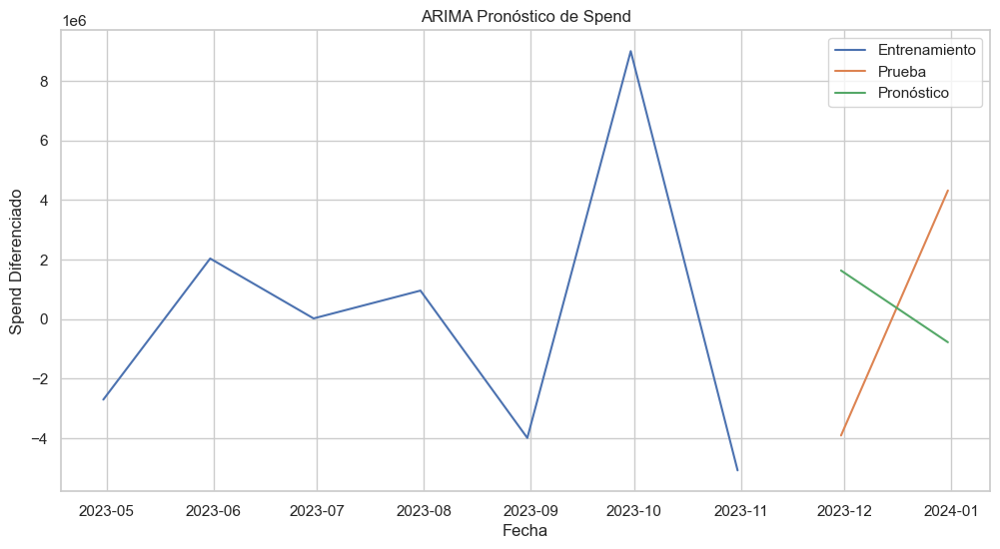

RMSE: 2307.3935111906635


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Malacca
df_malacca = df[df['Region'] == 'Malacca'].copy()

# 2. Preparar la serie temporal
df_malacca['Start_Date_Corrected'] = pd.to_datetime(df_malacca['Start_Date_Corrected'])
df_malacca.set_index('Start_Date_Corrected', inplace=True)
df_malacca.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_malacca['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Malacca')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


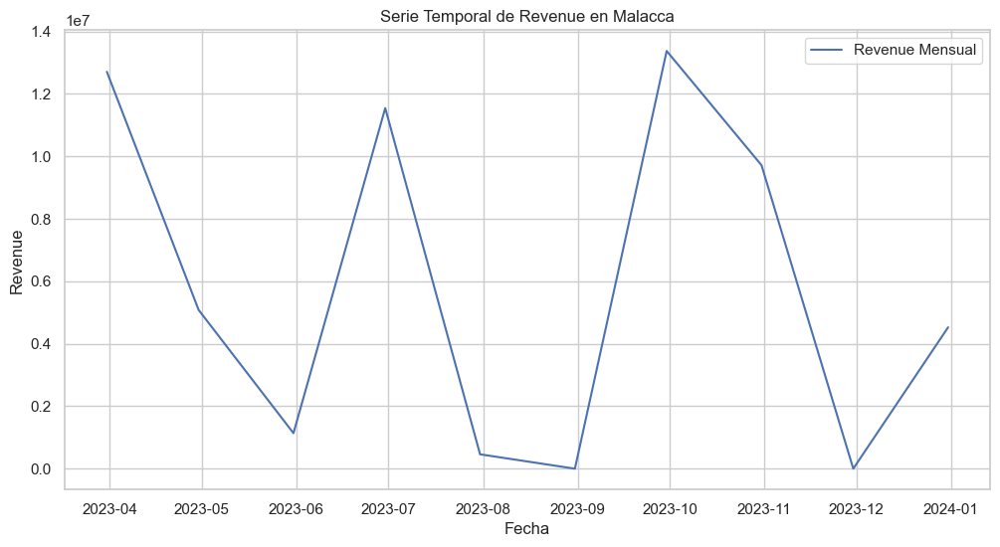

Estadístico ADF: -2.2737020045033867
p-value: 0.18058990476633657
Estadístico ADF después de diferenciar: -6.14566476774863
p-value: 7.77847868094735e-08


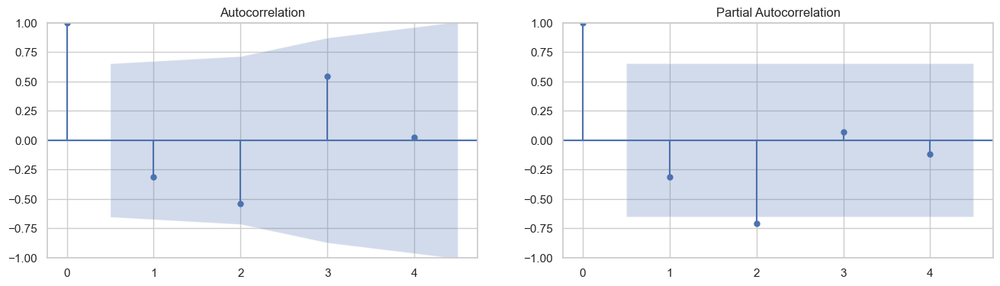

                               SARIMAX Results                                
Dep. Variable:                Revenue   No. Observations:                    7
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -120.287
Date:               do., 03 nov. 2024   AIC                            248.573
Time:                        21:35:29   BIC                            248.357
Sample:                    04-30-2023   HQIC                           245.899
                         - 10-31-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const      -4.274e+05   8.83e+05     -0.484      0.629   -2.16e+06     1.3e+06
ar.L1         -0.0287      0.396     -0.072      0.942      -0.805       0.748
ma.L1         -1.0000      1.438     -0.695      0.4

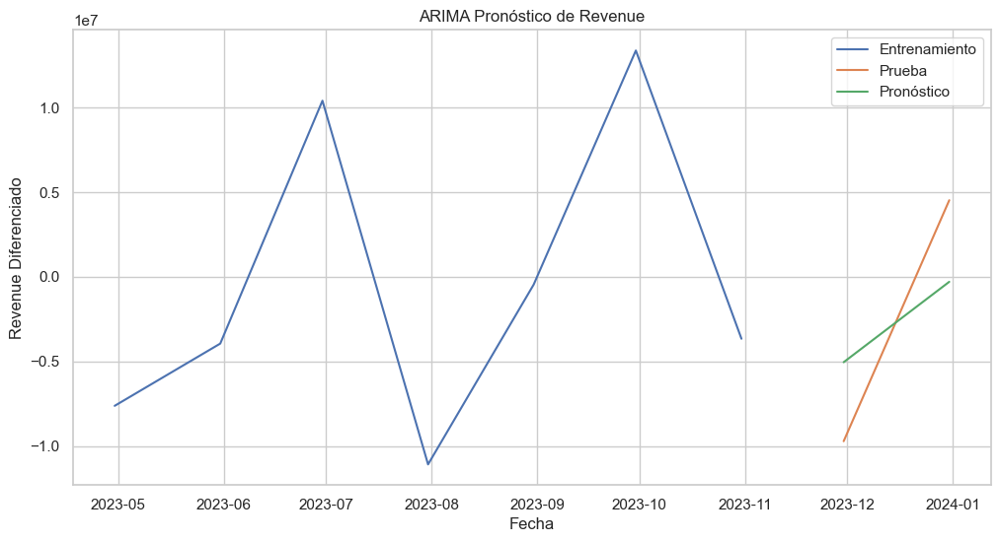

RMSE: 2178.606837166627


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Importar la librería para el modelo ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Malacca
df_malacca = df[df['Region'] == 'Malacca'].copy()

# 2. Preparar la serie temporal
df_malacca['Start_Date_Corrected'] = pd.to_datetime(df_malacca['Start_Date_Corrected'])
df_malacca.set_index('Start_Date_Corrected', inplace=True)
df_malacca.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_malacca['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Malacca')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p y q
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo ARIMA
# Suponiendo que p=1, d=1, q=1 basado en las gráficas ACF y PACF
model = ARIMA(train, order=(1, 0, 1))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('ARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


## SARIMA

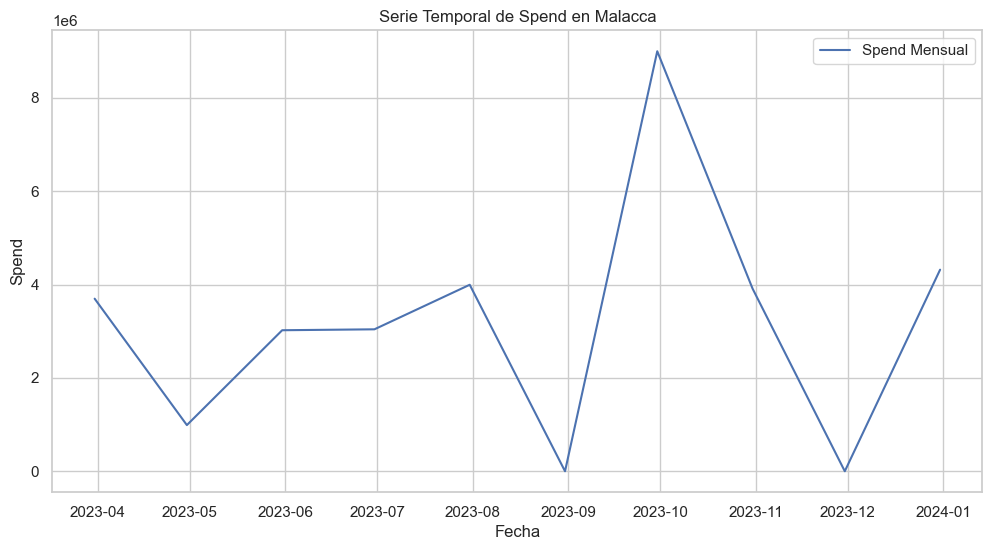

Estadístico ADF: 0.301561280565554
p-value: 0.9774160037119584
Estadístico ADF después de diferenciar: -6.434191490031183
p-value: 1.6685265789471763e-08


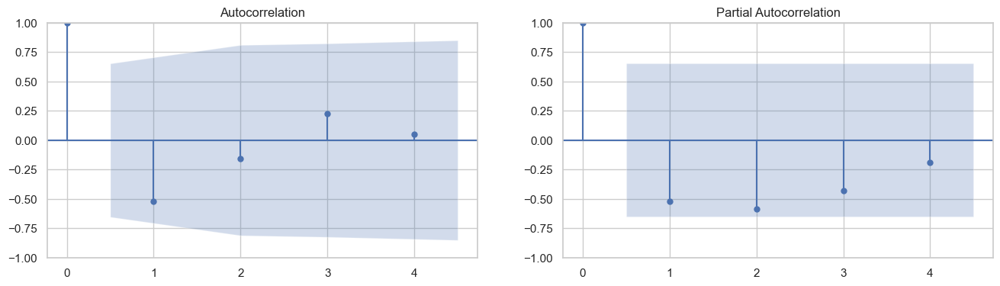

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                    7
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                   0.000
Date:                           do., 03 nov. 2024   AIC                             10.000
Time:                                    21:35:30   BIC                                nan
Sample:                                04-30-2023   HQIC                               nan
                                     - 10-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1               0         -0        nan        nan           0           0
ma.L1               0         -0   

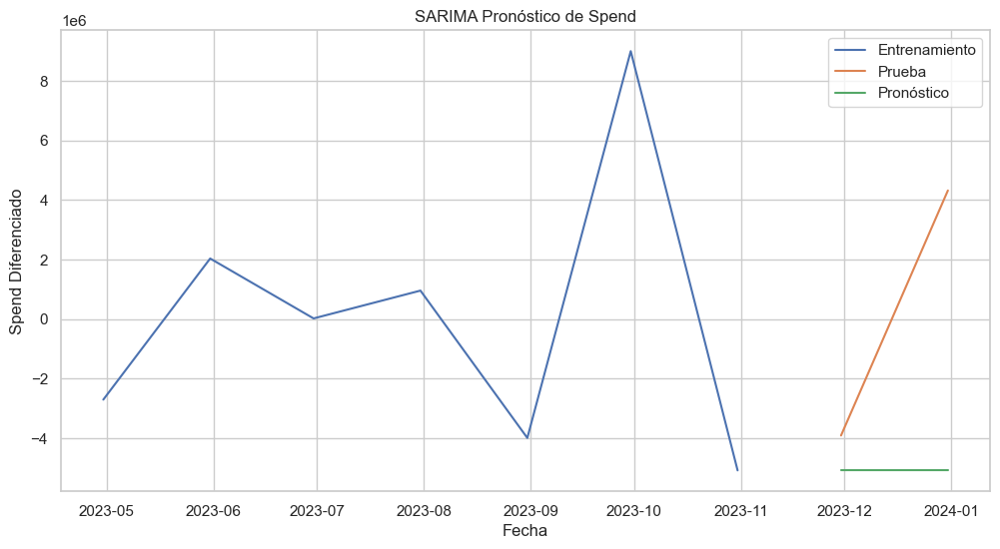

RMSE: 2588.312322764227


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

# 1. Filtrar datos para Malacca
df_malacca = df[df['Region'] == 'Malacca'].copy()

# 2. Preparar la serie temporal
df_malacca['Start_Date_Corrected'] = pd.to_datetime(df_malacca['Start_Date_Corrected'])
df_malacca.set_index('Start_Date_Corrected', inplace=True)
df_malacca.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_malacca['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Malacca')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'Start_Date_Corrected' does not exist in the dataframe.


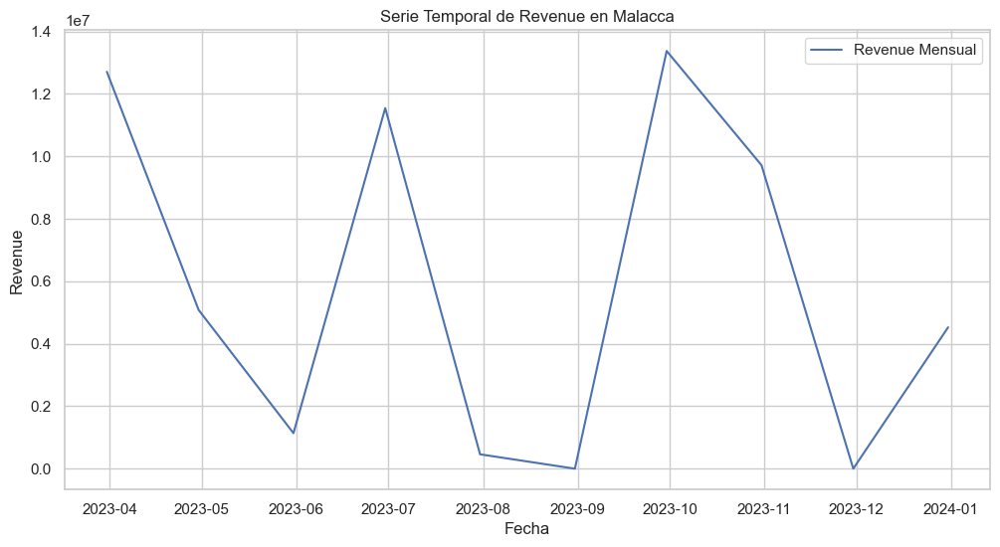

Estadístico ADF: -2.2737020045033867
p-value: 0.18058990476633657
Estadístico ADF después de diferenciar: -6.14566476774863
p-value: 7.77847868094735e-08


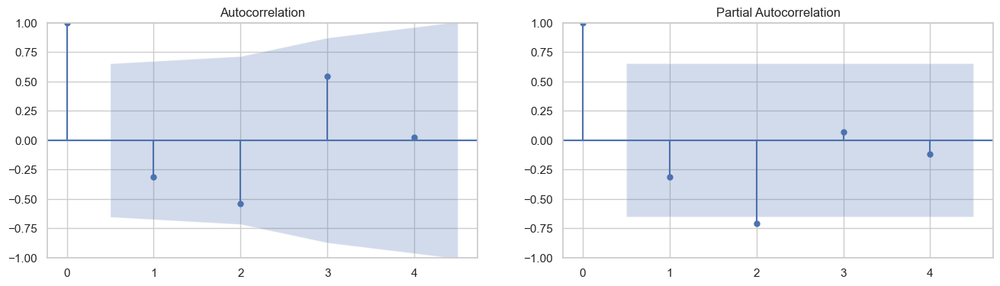

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                    7
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                   0.000
Date:                           do., 03 nov. 2024   AIC                             10.000
Time:                                    21:35:31   BIC                                nan
Sample:                                04-30-2023   HQIC                               nan
                                     - 10-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1               0         -0        nan        nan           0           0
ma.L1               0         -0   

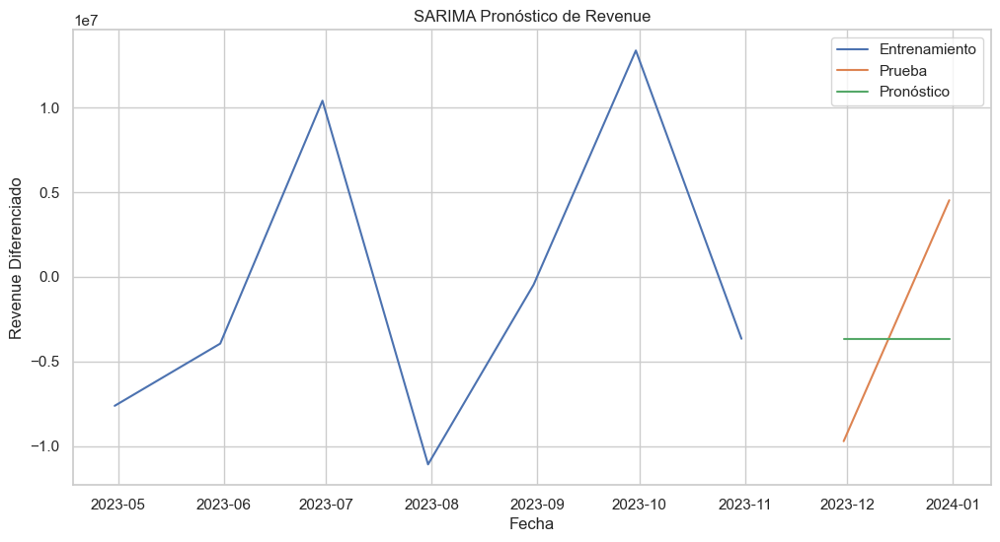

RMSE: 2683.4144620950033


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import root_mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'Start_Date_Corrected' column exists
if 'Start_Date_Corrected' in df_malacca.columns:
    df_malacca['Start_Date_Corrected'] = pd.to_datetime(df_malacca['Start_Date_Corrected'])
else:
    print("Column 'Start_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_malacca['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Malacca')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


# FIN  al análisis temporal de Spend y Revenue para las diferentes regiones

Análisis de comparación entre las medias y varianzas calculadas para Spend y las calculadas para Revenue

In [ ]:


import pandas as pd
import plotly.express as px

# Ensure required packages are installed
%pip install nbformat plotly

# Filtrar los datos para cada región
regiones = ['Kuala Lumpur', 'Johor', 'Sabah', 'Sarawak', 'Penang', 'Malacca']
estadisticas = {}

for region in regiones:
    df_region = df[df['Region'] == region]
    
    # Calcular estadísticas para Spend
    estadisticas_spend = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_spend.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Spend_mean', 'Spend_median', 'Spend_var']
    
    # Calcular estadísticas para Revenue
    estadisticas_revenue = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Revenue'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_revenue.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Revenue_mean', 'Revenue_median', 'Revenue_var']
    
    # Combinar estadísticas de Spend y Revenue
    estadisticas_region = pd.merge(estadisticas_spend, estadisticas_revenue, on=['Channel', 'Market_Segment', 'Product_Category'])
    estadisticas[region] = estadisticas_region

# Concatenar todas las estadísticas en un solo DataFrame
df_estadisticas = pd.concat(estadisticas, keys=estadisticas.keys()).reset_index(level=0).rename(columns={'level_0': 'Region'})

# Crear una gráfica interactiva
fig = px.scatter(df_estadisticas, x='Spend_mean', y='Revenue_mean', color='Region', 
                 hover_data=['Channel', 'Market_Segment', 'Product_Category', 'Spend_median', 'Spend_var', 'Revenue_median', 'Revenue_var'],
                 title='Spend vs Revenue por Región, Canal, Segmento de Mercado y Categoría de Producto')

fig.show()


Note: you may need to restart the kernel to use updated packages.


In [ ]:
import pandas as pd
import plotly.express as px

# Ensure required packages are installed
%pip install nbformat plotly

# Filtrar los datos para cada región
regiones = ['Kuala Lumpur', 'Johor', 'Sabah', 'Sarawak', 'Penang']
estadisticas = {}

for region in regiones:
    df_region = df[df['Region'] == region]
    
    # Calcular estadísticas para Spend
    estadisticas_spend = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_spend.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Spend_mean', 'Spend_median', 'Spend_var']
    
    # Calcular estadísticas para Revenue
    estadisticas_revenue = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Revenue'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_revenue.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Revenue_mean', 'Revenue_median', 'Revenue_var']
    
    # Combinar estadísticas de Spend y Revenue
    estadisticas_region = pd.merge(estadisticas_spend, estadisticas_revenue, on=['Channel', 'Market_Segment', 'Product_Category'])
    estadisticas[region] = estadisticas_region

# Concatenar todas las estadísticas en un solo DataFrame
df_estadisticas = pd.concat(estadisticas, keys=estadisticas.keys()).reset_index(level=0).rename(columns={'level_0': 'Region'})

# Crear una gráfica interactiva
fig = px.scatter(df_estadisticas, x='Spend_mean', y='Revenue_mean', color='Region', 
                 hover_data=['Channel', 'Market_Segment', 'Product_Category', 'Spend_median', 'Spend_var', 'Revenue_median', 'Revenue_var'],
                 title='Spend vs Revenue por Región, Canal, Segmento de Mercado y Categoría de Producto')

fig.show()


Note: you may need to restart the kernel to use updated packages.


In [ ]:
import pandas as pd
import plotly.express as px

# Ensure required packages are installed
%pip install nbformat plotly

# Filtrar los datos para cada región
regiones = ['Kuala Lumpur']
estadisticas = {}

for region in regiones:
    df_region = df[df['Region'] == region]
    
    # Calcular estadísticas para Spend
    estadisticas_spend = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_spend.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Spend_mean', 'Spend_median', 'Spend_var']
    
    # Calcular estadísticas para Revenue
    estadisticas_revenue = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Revenue'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_revenue.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Revenue_mean', 'Revenue_median', 'Revenue_var']
    
    # Combinar estadísticas de Spend y Revenue
    estadisticas_region = pd.merge(estadisticas_spend, estadisticas_revenue, on=['Channel', 'Market_Segment', 'Product_Category'])
    estadisticas[region] = estadisticas_region

# Concatenar todas las estadísticas en un solo DataFrame
df_estadisticas = pd.concat(estadisticas, keys=estadisticas.keys()).reset_index(level=0).rename(columns={'level_0': 'Region'})

# Crear una gráfica interactiva
fig = px.scatter(df_estadisticas, x='Spend_mean', y='Revenue_mean', color='Region', 
                 hover_data=['Channel', 'Market_Segment', 'Product_Category', 'Spend_median', 'Spend_var', 'Revenue_median', 'Revenue_var'],
                 title='Spend vs Revenue por Región, Canal, Segmento de Mercado y Categoría de Producto')

fig.show()


Note: you may need to restart the kernel to use updated packages.


In [ ]:
import pandas as pd
import plotly.express as px

# Ensure required packages are installed
%pip install nbformat plotly

# Filtrar los datos para cada región
regiones = ['Johor']
estadisticas = {}

for region in regiones:
    df_region = df[df['Region'] == region]
    
    # Calcular estadísticas para Spend
    estadisticas_spend = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_spend.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Spend_mean', 'Spend_median', 'Spend_var']
    
    # Calcular estadísticas para Revenue
    estadisticas_revenue = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Revenue'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_revenue.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Revenue_mean', 'Revenue_median', 'Revenue_var']
    
    # Combinar estadísticas de Spend y Revenue
    estadisticas_region = pd.merge(estadisticas_spend, estadisticas_revenue, on=['Channel', 'Market_Segment', 'Product_Category'])
    estadisticas[region] = estadisticas_region

# Concatenar todas las estadísticas en un solo DataFrame
df_estadisticas = pd.concat(estadisticas, keys=estadisticas.keys()).reset_index(level=0).rename(columns={'level_0': 'Region'})

# Crear una gráfica interactiva
fig = px.scatter(df_estadisticas, x='Spend_mean', y='Revenue_mean', color='Region', 
                 hover_data=['Channel', 'Market_Segment', 'Product_Category', 'Spend_median', 'Spend_var', 'Revenue_median', 'Revenue_var'],
                 title='Spend vs Revenue por Región, Canal, Segmento de Mercado y Categoría de Producto')

fig.show()


Note: you may need to restart the kernel to use updated packages.


In [ ]:
import pandas as pd
import plotly.express as px

# Ensure required packages are installed
%pip install nbformat plotly

# Filtrar los datos para cada región
regiones = ['Sabah']
estadisticas = {}

for region in regiones:
    df_region = df[df['Region'] == region]
    
    # Calcular estadísticas para Spend
    estadisticas_spend = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_spend.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Spend_mean', 'Spend_median', 'Spend_var']
    
    # Calcular estadísticas para Revenue
    estadisticas_revenue = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Revenue'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_revenue.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Revenue_mean', 'Revenue_median', 'Revenue_var']
    
    # Combinar estadísticas de Spend y Revenue
    estadisticas_region = pd.merge(estadisticas_spend, estadisticas_revenue, on=['Channel', 'Market_Segment', 'Product_Category'])
    estadisticas[region] = estadisticas_region

# Concatenar todas las estadísticas en un solo DataFrame
df_estadisticas = pd.concat(estadisticas, keys=estadisticas.keys()).reset_index(level=0).rename(columns={'level_0': 'Region'})

# Crear una gráfica interactiva
fig = px.scatter(df_estadisticas, x='Spend_mean', y='Revenue_mean', color='Region', 
                 hover_data=['Channel', 'Market_Segment', 'Product_Category', 'Spend_median', 'Spend_var', 'Revenue_median', 'Revenue_var'],
                 title='Spend vs Revenue por Región, Canal, Segmento de Mercado y Categoría de Producto')

fig.show()


Note: you may need to restart the kernel to use updated packages.


In [ ]:
import pandas as pd
import plotly.express as px

# Ensure required packages are installed
%pip install nbformat plotly

# Filtrar los datos para cada región
regiones = ['Sarawak']
estadisticas = {}

for region in regiones:
    df_region = df[df['Region'] == region]
    
    # Calcular estadísticas para Spend
    estadisticas_spend = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_spend.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Spend_mean', 'Spend_median', 'Spend_var']
    
    # Calcular estadísticas para Revenue
    estadisticas_revenue = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Revenue'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_revenue.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Revenue_mean', 'Revenue_median', 'Revenue_var']
    
    # Combinar estadísticas de Spend y Revenue
    estadisticas_region = pd.merge(estadisticas_spend, estadisticas_revenue, on=['Channel', 'Market_Segment', 'Product_Category'])
    estadisticas[region] = estadisticas_region

# Concatenar todas las estadísticas en un solo DataFrame
df_estadisticas = pd.concat(estadisticas, keys=estadisticas.keys()).reset_index(level=0).rename(columns={'level_0': 'Region'})

# Crear una gráfica interactiva
fig = px.scatter(df_estadisticas, x='Spend_mean', y='Revenue_mean', color='Region', 
                 hover_data=['Channel', 'Market_Segment', 'Product_Category', 'Spend_median', 'Spend_var', 'Revenue_median', 'Revenue_var'],
                 title='Spend vs Revenue por Región, Canal, Segmento de Mercado y Categoría de Producto')

fig.show()


Note: you may need to restart the kernel to use updated packages.


In [ ]:
import pandas as pd
import plotly.express as px

# Ensure required packages are installed
%pip install nbformat plotly

# Filtrar los datos para cada región
regiones = ['Penang']
estadisticas = {}

for region in regiones:
    df_region = df[df['Region'] == region]
    
    # Calcular estadísticas para Spend
    estadisticas_spend = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Spend'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_spend.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Spend_mean', 'Spend_median', 'Spend_var']
    
    # Calcular estadísticas para Revenue
    estadisticas_revenue = df_region.groupby(['Channel', 'Market_Segment', 'Product_Category'])['Revenue'].agg(['mean', 'median', 'var']).reset_index()
    estadisticas_revenue.columns = ['Channel', 'Market_Segment', 'Product_Category', 'Revenue_mean', 'Revenue_median', 'Revenue_var']
    
    # Combinar estadísticas de Spend y Revenue
    estadisticas_region = pd.merge(estadisticas_spend, estadisticas_revenue, on=['Channel', 'Market_Segment', 'Product_Category'])
    estadisticas[region] = estadisticas_region

# Concatenar todas las estadísticas en un solo DataFrame
df_estadisticas = pd.concat(estadisticas, keys=estadisticas.keys()).reset_index(level=0).rename(columns={'level_0': 'Region'})

# Crear una gráfica interactiva
fig = px.scatter(df_estadisticas, x='Spend_mean', y='Revenue_mean', color='Region', 
                 hover_data=['Channel', 'Market_Segment', 'Product_Category', 'Spend_median', 'Spend_var', 'Revenue_median', 'Revenue_var'],
                 title='Spend vs Revenue por Región, Canal, Segmento de Mercado y Categoría de Producto')

fig.show()


Note: you may need to restart the kernel to use updated packages.


# IMPRESSIONS

In [ ]:
df.columns


Index(['Campaign_ID', 'Channel', 'Product_Category', 'Region', 'Budget',
       'Spend', 'Impressions', 'Clicks', 'CTR', 'Conversions', 'CR', 'Revenue',
       'ROI', 'Duration', 'Start_Date', 'End_Date', 'Customer_Satisfaction',
       'Campaign_Effectiveness', 'Market_Segment', 'Days_Duration',
       'Start_Date_Corrected', 'End_Date_Corrected', 'Days_Duration_Corrected',
       'Duración', 'Duración_corregida', 'ROI_Teorico', 'ROI_Coincide'],
      dtype='object')

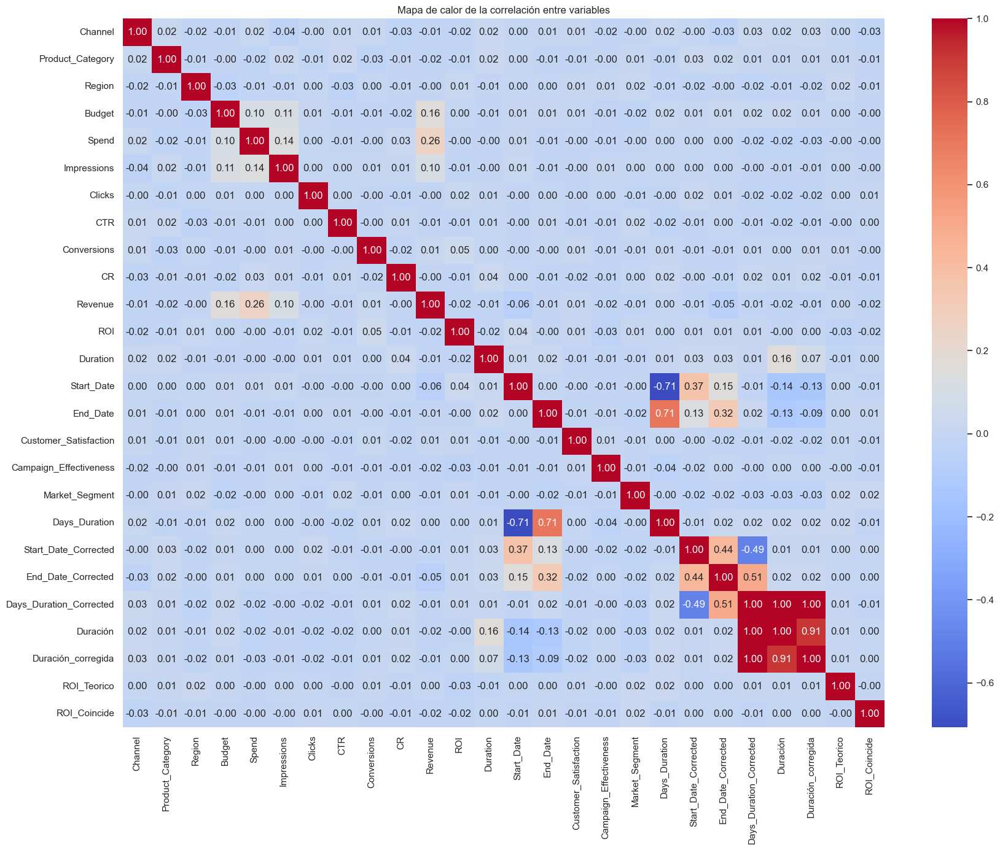

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Crear una copia del dataframe para trabajar
df_copy_correlacion = df.copy()

# Columnas a convertir
columnas_a_convertir = ['Channel', 'Product_Category', 'Region', 'Market_Segment']

# Convertir las columnas categóricas a valores numéricos
for col in columnas_a_convertir:
    if df_copy_correlacion[col].dtype == 'object':
        le = LabelEncoder()
        df_copy_correlacion[col] = le.fit_transform(df_copy_correlacion[col].astype(str))

# Seleccionar las columnas relevantes para el análisis de correlación
columnas_relevantes_correlacion = [
    'Channel', 'Product_Category', 'Region', 'Budget',
    'Spend', 'Impressions', 'Clicks', 'CTR', 'Conversions', 'CR', 'Revenue',
    'ROI', 'Duration', 'Start_Date', 'End_Date', 'Customer_Satisfaction',
    'Campaign_Effectiveness', 'Market_Segment', 'Days_Duration',
    'Start_Date_Corrected', 'End_Date_Corrected', 'Days_Duration_Corrected',
    'Duración', 'Duración_corregida', 'ROI_Teorico', 'ROI_Coincide'
]

# Verificar si las columnas adicionales existen en el dataframe antes de agregarlas
columnas_adicionales = ['Spend_per_Duration', 'Revenue_per_Duration', 'Revenue_minus_Spend_per_Duration']
for col in columnas_adicionales:
    if col in df_copy_correlacion.columns:
        columnas_relevantes_correlacion.append(col)

# Calcular la matriz de correlación
matriz_correlacion = df_copy_correlacion[columnas_relevantes_correlacion].corr()

# Generar el mapa de calor
plt.figure(figsize=(20, 15))  # Aumentar el tamaño del gráfico
sns.heatmap(matriz_correlacion, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Mapa de calor de la correlación entre variables')
plt.show()


Vamos a valorar la afectación de el gasto y el ingreso con el número de veces que se ha visto el anuncio.

In [ ]:
df.isnull().sum()


Campaign_ID                  0
Channel                      0
Product_Category             0
Region                       0
Budget                     500
Spend                        0
Impressions                504
Clicks                     486
CTR                        498
Conversions                494
CR                         496
Revenue                    509
ROI                        495
Duration                   479
Start_Date                 259
End_Date                   257
Customer_Satisfaction        0
Campaign_Effectiveness       0
Market_Segment               0
Days_Duration              502
Start_Date_Corrected        36
End_Date_Corrected          28
Days_Duration_Corrected    502
Duración                    38
Duración_corregida          38
ROI_Teorico                954
ROI_Coincide                 0
dtype: int64

In [ ]:
#Tomamos 'Impressions' 
columna = 'Impressions'

# Calcular la media
media = df[columna].mean()
print(f'Media de {columna}: {media}')

# Calcular la mediana
mediana = df[columna].median()
print(f'Mediana de {columna}: {mediana}')

# Calcular la moda
moda = df[columna].mode()[0]  # mode() devuelve una Serie, tomamos el primer valor
print(f'Moda de {columna}: {moda}')

# Calcular la varianza
varianza = df[columna].var()
print(f'Varianza de {columna}: {varianza}')


Media de Impressions: 605086.5013240213
Mediana de Impressions: 508967.5
Moda de Impressions: 198657.0
Varianza de Impressions: 2700135808829.787


### KUALA LUMPUR

Relación entre Impressions, número de veces que se vió el anuncio y Spend, gasto, en Kuala Lumpur con respecto a el canal publicitario y el producto presentado.

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_kuala_lumpur,
    x='Impressions',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Spend en Kuala Lumpur',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio.',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


Relación entre Impressions y Revenue en Kuala Lumpur con respecto a el canal publicitario y el producto presentado.

In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_kuala_lumpur,
    x='Impressions',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Revenue en Kuala Lumpur',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:

# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_kuala_lumpur,
    x='Impressions',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Impressions, Spend y Revenue en Kuala Lumpur',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    
# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Calcular la media de 'Spend', 'Revenue' e 'Impressions' por 'Channel' y 'Product_Category'
media_values = df_kuala_lumpur.groupby(['Channel', 'Product_Category'])[['Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category       Spend       Revenue   Impressions
0      Billboard       Automotive  569.958333  6.691591e+05  5.001614e+05
1      Billboard      Electronics  581.857143  5.245516e+05  5.143951e+05
2      Billboard          Fashion  479.884615  5.147690e+05  6.110745e+05
3      Billboard        Groceries  570.981481  5.423114e+05  9.386294e+05
4      Billboard           Health  603.605263  4.256937e+05  6.238166e+05
5          Email       Automotive  470.313725  4.625828e+05  5.942182e+05
6          Email      Electronics  580.697674  7.076549e+05  5.500007e+05
7          Email          Fashion  473.342857  4.862238e+05  5.607987e+05
8          Email        Groceries  486.204082  4.784211e+05  4.825560e+05
9          Email           Health  413.033333  5.189823e+05  5.663729e+05
10          News       Automotive  942.000000  7.043670e+06  8.446590e+06
11          News          Fashion  441.500000  7.616400e+06  6.590660e+06
12         Radio       Automotive  504

### JOHOR

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_johor,
    x='Impressions',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Spend en Johor',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio.',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_johor,
    x='Impressions',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Revenue en Johor',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_johor,
    x='Impressions',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Impressions, Spend y Revenue en Johor',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    
# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Calcular la media de 'Spend', 'Revenue' e 'Impressions' por 'Channel' y 'Product_Category'
media_values = df_johor.groupby(['Channel', 'Product_Category'])[['Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category       Spend        Revenue   Impressions
0      Billboard       Automotive  480.708333  643789.909000  8.274017e+05
1      Billboard      Electronics  506.241379  586449.867008  5.605557e+05
2      Billboard          Fashion  412.600000  778817.940864  4.898120e+05
3      Billboard        Groceries  460.595238  561336.000000  5.710340e+05
4      Billboard           Health  444.216216  681185.705818  5.496131e+05
5          Email       Automotive  555.500000  445320.555556  5.287966e+05
6          Email      Electronics  477.200000  528727.114286  4.462609e+05
7          Email          Fashion  573.333333  536825.508533  7.747582e+05
8          Email        Groceries  435.944444  476322.218750  4.977170e+05
9          Email           Health  508.820513  788798.062432  5.002595e+05
10          News      Electronics  622.000000            NaN  1.588730e+06
11         Radio       Automotive  407.478261  499174.116279  6.341683e+05
12         Radio      Ele

### SABAH

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sabah,
    x='Impressions',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Spend en Sabah',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio.',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
#Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sabah,
    x='Impressions',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Revenue en Sabah',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_sabah,
    x='Impressions',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Impressions, Spend y Revenue en Sabah',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    
# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Calcular la media de 'Spend', 'Revenue' e 'Impressions' por 'Channel' y 'Product_Category'
media_values = df_sabah.groupby(['Channel', 'Product_Category'])[['Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category       Spend        Revenue   Impressions
0      Billboard       Automotive  480.435897  496182.257905  5.752284e+05
1      Billboard      Electronics  508.844444  609505.278209  5.571365e+05
2      Billboard          Fashion  449.595238  378700.815789  7.755495e+05
3      Billboard        Groceries  475.380000  533122.835707  1.026503e+06
4      Billboard           Health  506.842105  569524.096016  8.273101e+05
5          Email       Automotive  453.608696  540439.193712  5.077887e+05
6          Email      Electronics  537.352941  744452.110851  6.337158e+05
7          Email          Fashion  492.891892  674560.337667  5.392300e+05
8          Email        Groceries  545.300000  582579.173800  5.735998e+05
9          Email           Health  467.589744  482654.466164  4.694755e+05
10         Radio       Automotive  464.818182  493767.743590  5.196065e+05
11         Radio      Electronics  404.705882  546700.973600  4.834405e+05
12         Radio         

### SARAWAK

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sarawak,
    x='Impressions',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Spend en Sarawak',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio.',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
#Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sarawak,
    x='Impressions',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Revenue en Sarawak',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_sarawak,
    x='Impressions',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Impressions, Spend y Revenue en Sarawak',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    
# Mostrar el gráfico


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Calcular la media de 'Spend', 'Revenue' e 'Impressions' por 'Channel' y 'Product_Category'
media_values = df_sarawak.groupby(['Channel', 'Product_Category'])[['Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category       Spend        Revenue    Impressions
0      Billboard       Automotive  420.212766  623711.049047  595679.862732
1      Billboard      Electronics  426.050000  643801.025947  528494.102564
2      Billboard          Fashion  539.041667  629687.693705  641316.841610
3      Billboard        Groceries  468.730769  582523.498939  648332.498170
4      Billboard           Health  437.974359  542475.638889  513461.312500
5          Email       Automotive  479.827586  941862.004407  802165.985840
6          Email      Electronics  523.391304  737144.796500  572605.736640
7          Email          Fashion  487.382353  784508.758241  538705.612903
8          Email        Groceries  555.309524  592185.611111  506079.589744
9          Email           Health  500.948718  520978.915833  760095.396514
10         Radio       Automotive  445.189189  481987.333333  510725.060606
11         Radio      Electronics  501.061224  662276.475644  641836.991532
12         R

### PENANG

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_penang,
    x='Impressions',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Spend en Penang',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio.',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
#Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_penang,
    x='Impressions',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Revenue en Penang',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_penang,
    x='Impressions',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Impressions, Spend y Revenue en Penang',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    
# Mostrar el gráfico


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Calcular la media de 'Spend', 'Revenue' e 'Impressions' por 'Channel' y 'Product_Category'
media_values = df_penang.groupby(['Channel', 'Product_Category'])[['Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category       Spend        Revenue   Impressions
0      Billboard       Automotive  368.906250  912369.753967  4.293864e+05
1      Billboard      Electronics  505.511628  517434.233703  5.746068e+05
2      Billboard          Fashion  455.340909  539959.333333  7.956681e+05
3      Billboard        Groceries  456.266667  836521.770868  5.401844e+05
4      Billboard           Health  416.909091  630164.842367  5.220260e+05
5          Email       Automotive  465.461538  538001.062500  5.149399e+05
6          Email      Electronics  516.200000  465375.370370  3.688070e+05
7          Email          Fashion  473.977273  826700.899756  6.782979e+05
8          Email        Groceries  339.882353  415337.937500  5.086209e+05
9          Email           Health  483.452381  608796.050568  4.927225e+05
10          News           Health  192.000000            NaN  4.062700e+06
11         Radio       Automotive  463.636364  492610.862069  5.449702e+05
12         Radio      Ele

### MALACCA

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_malacca,
    x='Impressions',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Spend en Malacca',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio.',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
#Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_malacca,
    x='Impressions',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Impressions y Revenue en Malacca',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_malacca,
    x='Impressions',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Impressions, Spend y Revenue en Malacca',
    labels={
        'Impressions': 'Número de veces que se vio el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    
# Mostrar el gráfico


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Calcular la media de 'Spend', 'Revenue' e 'Impressions' por 'Channel' y 'Product_Category'
media_values = df_malacca.groupby(['Channel', 'Product_Category'])[['Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


        Channel Product_Category         Spend       Revenue   Impressions
0     Billboard          Fashion  2.913680e+06  7.175800e+06  9.710710e+06
1     Billboard           Health  1.402900e+05  3.136350e+06  9.991660e+07
2         Email       Automotive  2.976450e+06           NaN  6.767920e+06
3          News           Health  3.020470e+06  1.137350e+06  9.537700e+06
4         Radio      Electronics  4.317430e+06  4.526300e+06  4.418600e+05
5         Radio           Health  9.885100e+05  5.083200e+06  6.366230e+06
6  Social Media       Automotive  2.019272e+06  7.044109e+06  1.811420e+05
7  Social Media      Electronics  3.464710e+06  5.681380e+06  2.541570e+06
8            TV       Automotive  2.283797e+06  3.056143e+06  5.260763e+06
9            TV        Groceries  3.253940e+06  8.558670e+06           NaN


# CLICKS

Vamos a comprobar como el gasto, el ingreso y el número de veces que se vió el anuncio tiene relación con el número de clicks recibidos.

In [ ]:
# Calcular la media
media_clicks = df['Clicks'].mean()
print(f"Media de clicks: {media_clicks}")

# Calcular la moda
moda_clicks = df['Clicks'].mode()[0]  # mode() devuelve una Serie, tomamos el primer valor
print(f"Moda de clicks: {moda_clicks}")

# Calcular la mediana
mediana_clicks = df['Clicks'].median()
print(f"Mediana de clicks: {mediana_clicks}")

# Calcular la varianza
varianza_clicks = df['Clicks'].var()
print(f"Varianza de clicks: {varianza_clicks}")


Media de clicks: 27467.0009850432
Moda de clicks: 10075.0
Mediana de clicks: 26232.0
Varianza de clicks: 538404187.0578724


### KUALA LUMPUR

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_kuala_lumpur,
    x='Clicks',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Spend en Kuala Lumpur',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_kuala_lumpur,
    x='Clicks',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Revenue en Kuala Lumpur',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_kuala_lumpur,
    x='Clicks',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks e Impressions en Kuala Lumpur',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_kuala_lumpur,
    x='Clicks',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Clicks, Spend y Revenue en Kuala Lumpur',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    
# Mostrar el gráfico


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_kuala_lumpur.groupby(['Channel', 'Product_Category'])[['Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category        Clicks       Spend       Revenue  \
0      Billboard       Automotive  23798.869565  569.958333  6.691591e+05   
1      Billboard      Electronics  24492.212121  581.857143  5.245516e+05   
2      Billboard          Fashion  24718.229167  479.884615  5.147690e+05   
3      Billboard        Groceries  24673.021739  570.981481  5.423114e+05   
4      Billboard           Health  33521.114195  603.605263  4.256937e+05   
5          Email       Automotive  29261.019347  470.313725  4.625828e+05   
6          Email      Electronics  26245.925000  580.697674  7.076549e+05   
7          Email          Fashion  27559.516129  473.342857  4.862238e+05   
8          Email        Groceries  26213.581395  486.204082  4.784211e+05   
9          Email           Health  24775.730769  413.033333  5.189823e+05   
10          News       Automotive  49045.000000  942.000000  7.043670e+06   
11          News          Fashion  25385.500000  441.500000  7.616400e+06   

### JOHOR

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_johor,
    x='Clicks',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Spend en Johor',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_johor,
    x='Clicks',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Revenue en Johor',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_johor,
    x='Clicks',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks e Impressions en Johor',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_johor,
    x='Clicks',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Clicks, Spend y Revenue en Johor',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    
# Mostrar el gráfico


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_johor.groupby(['Channel', 'Product_Category'])[['Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category        Clicks       Spend        Revenue  \
0      Billboard       Automotive  24516.777778  480.708333  643789.909000   
1      Billboard      Electronics  25178.673026  506.241379  586449.867008   
2      Billboard          Fashion  29195.396417  412.600000  778817.940864   
3      Billboard        Groceries  33924.770870  460.595238  561336.000000   
4      Billboard           Health  26373.060606  444.216216  681185.705818   
5          Email       Automotive  24344.000000  555.500000  445320.555556   
6          Email      Electronics  26311.918919  477.200000  528727.114286   
7          Email          Fashion  28142.729667  573.333333  536825.508533   
8          Email        Groceries  37355.842745  435.944444  476322.218750   
9          Email           Health  25363.676471  508.820513  788798.062432   
10          News      Electronics  14937.000000  622.000000            NaN   
11         Radio       Automotive  26085.904762  407.478261  499

### SABAH

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sabah,
    x='Clicks',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Spend en Sabah',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sabah,
    x='Clicks',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Revenue en Sabah',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sabah,
    x='Clicks',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks e Impressions en Sabah',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_sabah,
    x='Clicks',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Clicks, Spend y Revenue en Sabah',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    
# Mostrar el gráfico


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_sabah.groupby(['Channel', 'Product_Category'])[['Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category        Clicks       Spend        Revenue  \
0      Billboard       Automotive  28377.284740  480.435897  496182.257905   
1      Billboard      Electronics  29508.286033  508.844444  609505.278209   
2      Billboard          Fashion  30245.935890  449.595238  378700.815789   
3      Billboard        Groceries  24647.457206  475.380000  533122.835707   
4      Billboard           Health  25859.218932  506.842105  569524.096016   
5          Email       Automotive  37326.120083  453.608696  540439.193712   
6          Email      Electronics  27452.760870  537.352941  744452.110851   
7          Email          Fashion  32967.674415  492.891892  674560.337667   
8          Email        Groceries  28510.039445  545.300000  582579.173800   
9          Email           Health  24020.031250  467.589744  482654.466164   
10         Radio       Automotive  24113.042568  464.818182  493767.743590   
11         Radio      Electronics  22299.034483  404.705882  546

### SARAWAK

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sarawak,
    x='Clicks',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Spend en Sarawak',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sarawak,
    x='Clicks',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Revenue en Sarawak',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sarawak,
    x='Clicks',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks e Impressions en Sarawak',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_sarawak,
    x='Clicks',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Clicks, Spend y Revenue en Sarawak',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_sarawak.groupby(['Channel', 'Product_Category'])[['Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category        Clicks       Spend        Revenue  \
0      Billboard       Automotive  27879.986584  420.212766  623711.049047   
1      Billboard      Electronics  22160.735294  426.050000  643801.025947   
2      Billboard          Fashion  32161.227833  539.041667  629687.693705   
3      Billboard        Groceries  24150.644444  468.730769  582523.498939   
4      Billboard           Health  35953.893486  437.974359  542475.638889   
5          Email       Automotive  21197.320000  479.827586  941862.004407   
6          Email      Electronics  30561.790527  523.391304  737144.796500   
7          Email          Fashion  29485.121212  487.382353  784508.758241   
8          Email        Groceries  24367.861111  555.309524  592185.611111   
9          Email           Health  28534.378850  500.948718  520978.915833   
10         Radio       Automotive  35110.437720  445.189189  481987.333333   
11         Radio      Electronics  32110.249119  501.061224  662

### PENANG

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_penang,
    x='Clicks',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Spend en Penang',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_penang,
    x='Clicks',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Revenue en Penang',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_penang,
    x='Clicks',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks e Impressions en Penang',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_penang,
    x='Clicks',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Clicks, Spend y Revenue en Penang',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_penang.groupby(['Channel', 'Product_Category'])[['Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category        Clicks       Spend        Revenue  \
0      Billboard       Automotive  22848.687500  368.906250  912369.753967   
1      Billboard      Electronics  24025.743590  505.511628  517434.233703   
2      Billboard          Fashion  31239.607687  455.340909  539959.333333   
3      Billboard        Groceries  27704.399100  456.266667  836521.770868   
4      Billboard           Health  23315.861996  416.909091  630164.842367   
5          Email       Automotive  27867.947383  465.461538  538001.062500   
6          Email      Electronics  28124.000000  516.200000  465375.370370   
7          Email          Fashion  24684.526189  473.977273  826700.899756   
8          Email        Groceries  32664.565983  339.882353  415337.937500   
9          Email           Health  26652.380296  483.452381  608796.050568   
10          News           Health  44095.000000  192.000000            NaN   
11         Radio       Automotive  26683.492680  463.636364  492

### MALACCA

In [ ]:
import pandas as pd
import plotly.express as px

# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_malacca,
    x='Clicks',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Spend en Malacca',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_malacca,
    x='Clicks',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks y Revenue en Malacca',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Malacca
df_malacca= df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_malacca,
    x='Clicks',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre Clicks e Impressions en Malacca',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_malacca,
    x='Clicks',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre Clicks, Spend y Revenue en Malacca',
    labels={
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_malacca.groupby(['Channel', 'Product_Category'])[['Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


        Channel Product_Category   Clicks         Spend       Revenue  \
0     Billboard          Fashion      NaN  2.913680e+06  7.175800e+06   
1     Billboard           Health  34661.0  1.402900e+05  3.136350e+06   
2         Email       Automotive  11740.0  2.976450e+06           NaN   
3          News           Health  26384.0  3.020470e+06  1.137350e+06   
4         Radio      Electronics  36738.0  4.317430e+06  4.526300e+06   
5         Radio           Health   5471.0  9.885100e+05  5.083200e+06   
6  Social Media       Automotive  35508.0  2.019272e+06  7.044109e+06   
7  Social Media      Electronics  16413.0  3.464710e+06  5.681380e+06   
8            TV       Automotive  24420.0  2.283797e+06  3.056143e+06   
9            TV        Groceries      NaN  3.253940e+06  8.558670e+06   

    Impressions  
0  9.710710e+06  
1  9.991660e+07  
2  6.767920e+06  
3  9.537700e+06  
4  4.418600e+05  
5  6.366230e+06  
6  1.811420e+05  
7  2.541570e+06  
8  5.260763e+06  
9           NaN 

# CR
Tasa de conversión, el porcentaje de personas que completan la acción deseada en la web de producto por efecto de nuestra campaña.

### KUALA LUMPUR

In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_kuala_lumpur,
    x='CR',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Spend en Kuala Lumpur',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_kuala_lumpur,
    x='CR',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Revenue en Kuala Lumpur',
    labels={
        'CR': 'Tasa de Conversión',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur= df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_kuala_lumpur,
    x='CR',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR e Impressions en Kuala Lumpur',
    labels={
        'CR': 'Tasa de Conversión',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur= df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_kuala_lumpur,
    x='CR',
    y='Clicks',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR e Clicks en Kuala Lumpur',
    labels={
        'CR': 'Tasa de Conversión',
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_kuala_lumpur,
    x='CR',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre CR, Spend y Revenue en Kuala Lumpur',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)    


In [ ]:
# Filtrar los datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_kuala_lumpur.groupby(['Channel', 'Product_Category'])[['CR','Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category        CR        Clicks       Spend  \
0      Billboard       Automotive  0.739877  23798.869565  569.958333   
1      Billboard      Electronics  0.559748  24492.212121  581.857143   
2      Billboard          Fashion  0.620560  24718.229167  479.884615   
3      Billboard        Groceries  0.664464  24673.021739  570.981481   
4      Billboard           Health  0.696999  33521.114195  603.605263   
5          Email       Automotive  0.479210  29261.019347  470.313725   
6          Email      Electronics  0.418739  26245.925000  580.697674   
7          Email          Fashion  0.482859  27559.516129  473.342857   
8          Email        Groceries  0.498993  26213.581395  486.204082   
9          Email           Health  0.364541  24775.730769  413.033333   
10          News       Automotive  0.053000  49045.000000  942.000000   
11          News          Fashion  0.705400  25385.500000  441.500000   
12         Radio       Automotive  0.542416  26596.

### JOHOR

In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_johor,
    x='CR',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Spend en Johor',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_johor,
    x='CR',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Revenue en Johor',
    labels={
        'CR': 'Tasa de Conversión',
        'Revenue': 'Ingreso',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_johor,
    x='CR',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Impressions en Johor',
    labels={
        'CR': 'Tasa de Conversión',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor= df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_johor,
    x='CR',
    y='Clicks',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR e Clicks en Johor',
    labels={
        'CR': 'Tasa de Conversión',
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_johor,
    x='CR',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre CR, Spend y Revenue en Johor',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)


In [ ]:
# Filtrar los datos para Johor
df_johor = df[df['Region'] == 'Johor']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_johor.groupby(['Channel', 'Product_Category'])[['CR','Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category        CR        Clicks       Spend  \
0      Billboard       Automotive  0.436920  24516.777778  480.708333   
1      Billboard      Electronics  0.627479  25178.673026  506.241379   
2      Billboard          Fashion  0.531883  29195.396417  412.600000   
3      Billboard        Groceries  0.675219  33924.770870  460.595238   
4      Billboard           Health  0.631619  26373.060606  444.216216   
5          Email       Automotive  0.667986  24344.000000  555.500000   
6          Email      Electronics  0.546004  26311.918919  477.200000   
7          Email          Fashion  0.714743  28142.729667  573.333333   
8          Email        Groceries  0.600294  37355.842745  435.944444   
9          Email           Health  0.572341  25363.676471  508.820513   
10          News      Electronics  0.602100  14937.000000  622.000000   
11         Radio       Automotive  0.568866  26085.904762  407.478261   
12         Radio      Electronics  0.571867  29865.

### SABAH

In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sabah,
    x='CR',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Spend en Sabah',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sabah,
    x='CR',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Revenue en Sabah',
    labels={
        'CR': 'Tasa de Conversión',
        'Revenue': 'Ingreso',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sabah,
    x='CR',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Impressions en Sabah',
    labels={
        'CR': 'Tasa de Conversión',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah= df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sabah,
    x='CR',
    y='Clicks',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR e Clicks en Sabah',
    labels={
        'CR': 'Tasa de Conversión',
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_sabah,
    x='CR',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre CR, Spend y Revenue en Sabah',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)


In [ ]:
# Filtrar los datos para Sabah
df_sabah = df[df['Region'] == 'Sabah']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_sabah.groupby(['Channel', 'Product_Category'])[['CR','Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
print(media_values)


         Channel Product_Category        CR        Clicks       Spend  \
0      Billboard       Automotive  0.636081  28377.284740  480.435897   
1      Billboard      Electronics  0.571488  29508.286033  508.844444   
2      Billboard          Fashion  0.536754  30245.935890  449.595238   
3      Billboard        Groceries  0.551703  24647.457206  475.380000   
4      Billboard           Health  0.525600  25859.218932  506.842105   
5          Email       Automotive  0.717431  37326.120083  453.608696   
6          Email      Electronics  0.730969  27452.760870  537.352941   
7          Email          Fashion  0.599608  32967.674415  492.891892   
8          Email        Groceries  0.482853  28510.039445  545.300000   
9          Email           Health  0.477533  24020.031250  467.589744   
10         Radio       Automotive  0.521123  24113.042568  464.818182   
11         Radio      Electronics  0.467807  22299.034483  404.705882   
12         Radio          Fashion  0.576290  36971.

### SARAWAK

In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sarawak,
    x='CR',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Spend en Sarawak',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sarawak,
    x='CR',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Revenue en Sarawak',
    labels={
        'CR': 'Tasa de Conversión',
        'Revenue': 'Ingreso',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sarawak,
    x='CR',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Impressions en Sarwak',
    labels={
        'CR': 'Tasa de Conversión',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak= df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_sarawak,
    x='CR',
    y='Clicks',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR e Clicks en Sarawak',
    labels={
        'CR': 'Tasa de Conversión',
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Saraawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_sarawak,
    x='CR',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre CR, Spend y Revenue en Sarawak',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)


In [ ]:
# Filtrar los datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_sarawak.groupby(['Channel', 'Product_Category'])[['CR','Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
media_values


,Channel,Product_Category,CR,Clicks,Spend,Revenue,Impressions
0,Billboard,Automotive,0.548368,27879.986584,420.212766,623711.049047,595679.862732
1,Billboard,Electronics,0.402341,22160.735294,426.050000,643801.025947,528494.102564
2,Billboard,Fashion,0.470274,32161.227833,539.041667,629687.693705,641316.841610
3,Billboard,Groceries,0.724027,24150.644444,468.730769,582523.498939,648332.498170
4,Billboard,Health,0.660233,35953.893486,437.974359,542475.638889,513461.312500
5,Email,Automotive,0.547113,21197.320000,479.827586,941862.004407,802165.985840
6,Email,Electronics,0.608181,30561.790527,523.391304,737144.796500,572605.736640
7,Email,Fashion,0.498247,29485.121212,487.382353,784508.758241,538705.612903
8,Email,Groceries,0.558953,24367.861111,555.309524,592185.611111,506079.589744
9,Email,Health,0.568715,28534.378850,500.948718,520978.915833,760095.396514


### PENANG

In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_penang,
    x='CR',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Spend en Penang',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_penang,
    x='CR',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Revenue en Penang',
    labels={
        'CR': 'Tasa de Conversión',
        'Revenue': 'Ingreso',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_penang,
    x='CR',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Impressions en Penang',
    labels={
        'CR': 'Tasa de Conversión',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Penang
df_penang= df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_penang,
    x='CR',
    y='Clicks',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR e Clicks en Penang',
    labels={
        'CR': 'Tasa de Conversión',
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_penang,
    x='CR',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre CR, Spend y Revenue en Penang',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)


In [ ]:
# Filtrar los datos para Penang
df_penang = df[df['Region'] == 'Penang']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_penang.groupby(['Channel', 'Product_Category'])[['CR','Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
media_values


,Channel,Product_Category,CR,Clicks,Spend,Revenue,Impressions
0,Billboard,Automotive,0.601793,22848.687500,368.906250,912369.753967,4.293864e+05
1,Billboard,Electronics,0.780663,24025.743590,505.511628,517434.233703,5.746068e+05
2,Billboard,Fashion,0.519359,31239.607687,455.340909,539959.333333,7.956681e+05
3,Billboard,Groceries,0.476637,27704.399100,456.266667,836521.770868,5.401844e+05
4,Billboard,Health,0.444420,23315.861996,416.909091,630164.842367,5.220260e+05
5,Email,Automotive,0.610146,27867.947383,465.461538,538001.062500,5.149399e+05
6,Email,Electronics,0.510154,28124.000000,516.200000,465375.370370,3.688070e+05
7,Email,Fashion,0.442674,24684.526189,473.977273,826700.899756,6.782979e+05
8,Email,Groceries,0.552561,32664.565983,339.882353,415337.937500,5.086209e+05
9,Email,Health,0.630962,26652.380296,483.452381,608796.050568,4.927225e+05


### MALACCA

In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_malacca,
    x='CR',
    y='Spend',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Spend en Malacca',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_malacca,
    x='CR',
    y='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Revenue en Malacca',
    labels={
        'CR': 'Tasa de Conversión',
        'Revenue': 'Ingreso',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_malacca,
    x='CR',
    y='Impressions',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR y Impressions en Malacca',
    labels={
        'CR': 'Tasa de Conversión',
        'Impressions': 'Número de veces que se vio el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Malacca
df_malacca= df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión interactivo
fig = px.scatter(
    df_malacca,
    x='CR',
    y='Clicks',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category'],
    title='Relación entre CR e Clicks en Malacca',
    labels={
        'CR': 'Tasa de Conversión',
        'Clicks': 'Número de clicks que recibió el anuncio',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

# Mostrar el gráfico
fig.show()


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Crear el gráfico de dispersión 3D interactivo
fig = px.scatter_3d(
    df_malacca,
    x='CR',
    y='Spend',
    z='Revenue',
    color='Channel',
    symbol='Product_Category',
    hover_data=['Product_Category', 'Channel'],
    title='Relación entre CR, Spend y Revenue en Malacca',
    labels={
        'CR': 'Tasa de Conversión',
        'Spend': 'Gasto',
        'Revenue': 'Ingresos',
        'Channel': 'Canal',
        'Product_Category': 'Categoría de Producto'
    }
)

fig.update_layout(
    width=1000,   # Ajusta el ancho según tus necesidades
    height=800    # Ajusta el alto según tus necesidades
)


In [ ]:
# Filtrar los datos para Malacca
df_malacca = df[df['Region'] == 'Malacca']

# Calcular la media de 'Spend', 'Revenue','Impressions' y 'Clicks' por 'Channel' y 'Product_Category'
media_values = df_malacca.groupby(['Channel', 'Product_Category'])[['CR','Clicks','Spend', 'Revenue', 'Impressions']].mean().reset_index()

# Mostrar los resultados
media_values


,Channel,Product_Category,CR,Clicks,Spend,Revenue,Impressions
0,Billboard,Fashion,0.029500,NaN,2.913680e+06,7.175800e+06,9.710710e+06
1,Billboard,Health,0.989100,34661.0,1.402900e+05,3.136350e+06,9.991660e+07
2,Email,Automotive,0.134900,11740.0,2.976450e+06,NaN,6.767920e+06
3,News,Health,4.174334,26384.0,3.020470e+06,1.137350e+06,9.537700e+06
4,Radio,Electronics,0.654100,36738.0,4.317430e+06,4.526300e+06,4.418600e+05
5,Radio,Health,0.622500,5471.0,9.885100e+05,5.083200e+06,6.366230e+06
6,Social Media,Automotive,0.552800,35508.0,2.019272e+06,7.044109e+06,1.811420e+05
7,Social Media,Electronics,NaN,16413.0,3.464710e+06,5.681380e+06,2.541570e+06
8,TV,Automotive,0.545100,24420.0,2.283797e+06,3.056143e+06,5.260763e+06
9,TV,Groceries,0.714600,NaN,3.253940e+06,8.558670e+06,NaN


# CONVERSIONS
En marketing, el término «conversiones» se refiere a las acciones que los visitantes realizan en respuesta a una campaña publicitaria, que representan el cumplimiento de un objetivo específico para la empresa.

### KUALA LUMPUR

#### SARIMA con fecha fin

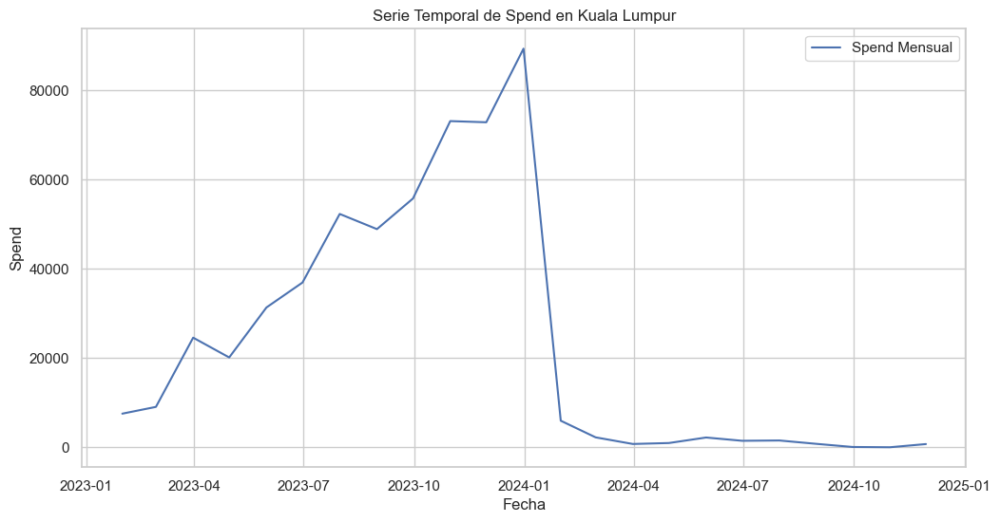

Estadístico ADF: -1.5860936975753215
p-value: 0.49057525470793656
Estadístico ADF después de diferenciar: -4.908532899576636
p-value: 3.3564872733709335e-05


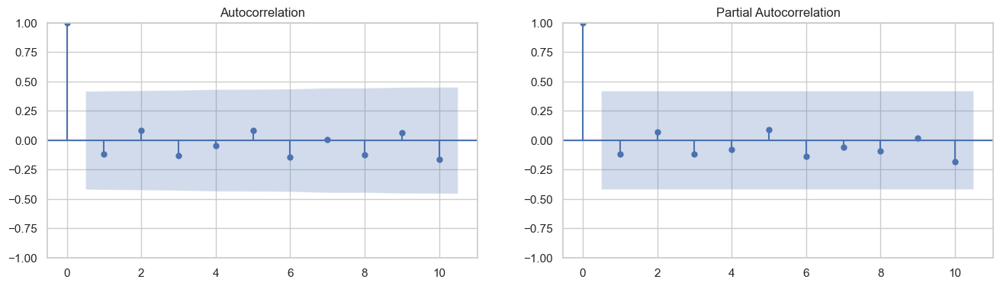

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -36.524
Date:                           do., 03 nov. 2024   AIC                             83.049
Time:                                    21:36:03   BIC                             79.980
Sample:                                02-28-2023   HQIC                            76.315
                                     - 06-30-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9977      0.747     -1.336      0.181      -2.461       0.466
ma.L1          0.9975      1.759   

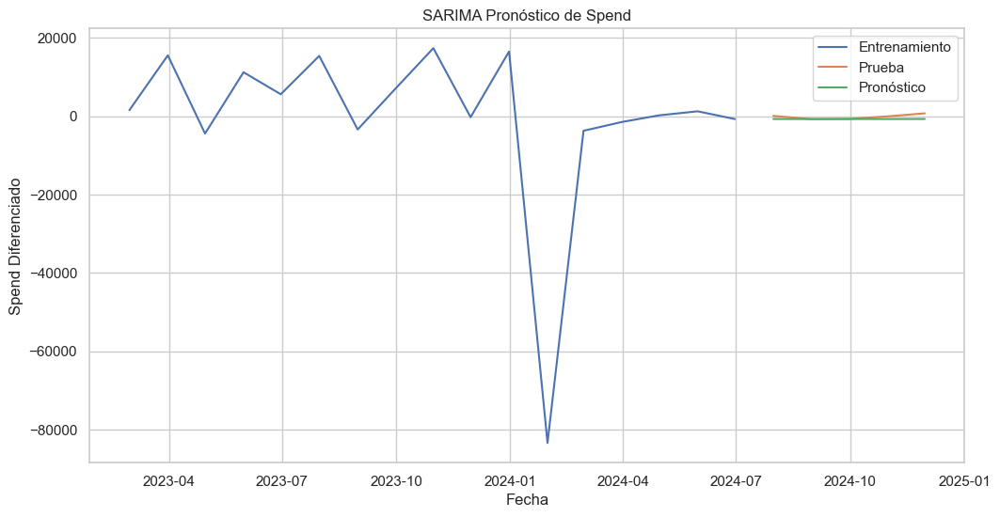

RMSE: 28.173918624121388


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

# 1. Filtrar datos para Kuala Lumpur
df_kuala_lumpur = df[df['Region'] == 'Kuala Lumpur'].copy()

# 2. Preparar la serie temporal
df_kuala_lumpur['End_Date_Corrected'] = pd.to_datetime(df_kuala_lumpur['End_Date_Corrected'])
df_kuala_lumpur.set_index('End_Date_Corrected', inplace=True)
df_kuala_lumpur.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_kuala_lumpur['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Kuala Lumpur')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'End_Date_Corrected' does not exist in the dataframe.


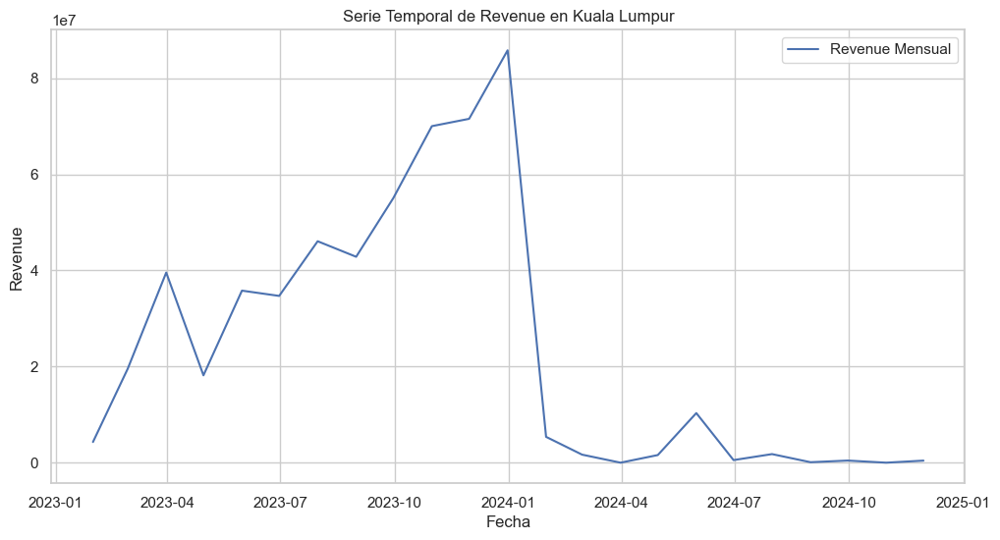

Estadístico ADF: -1.7566780981886339
p-value: 0.4021718599174847
Estadístico ADF después de diferenciar: -5.1442941612928355
p-value: 1.1411575871588076e-05


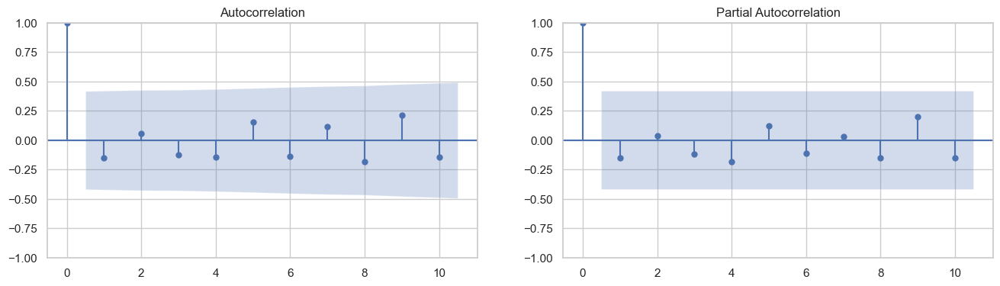

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -72.393
Date:                           do., 03 nov. 2024   AIC                            154.787
Time:                                    21:36:04   BIC                            151.718
Sample:                                02-28-2023   HQIC                           148.053
                                     - 06-30-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3892    479.642      0.001      0.999    -939.692     940.470
ma.L1         -0.3490    486.695   

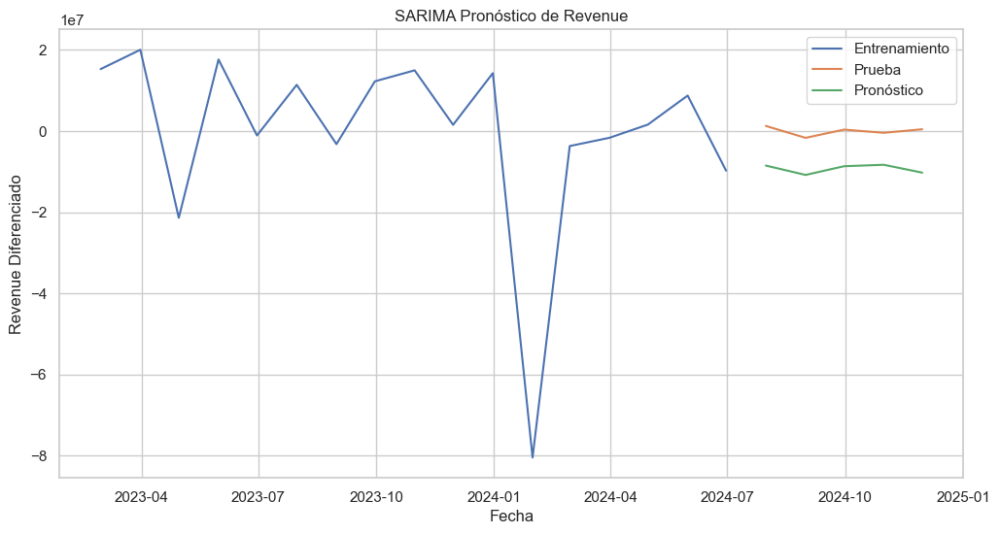

RMSE: 3056.54211415877


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'Start_Date_Corrected' column exists
if 'End_Date_Corrected' in df_kuala_lumpur.columns:
    df_kuala_lumpur['End_Date_Corrected'] = pd.to_datetime(df_kuala_lumpur['End_Date_Corrected'])
else:
    print("Column 'End_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_kuala_lumpur['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Kuala Lumpur')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


### JOHOR

##### SARIMA de fechas fin

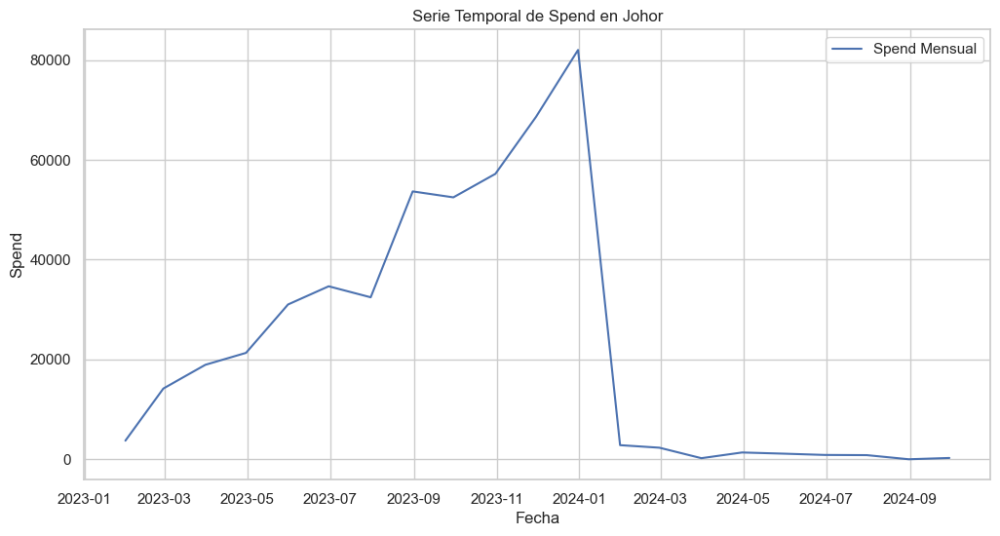

Estadístico ADF: -1.6678725307716984
p-value: 0.44773686658671896
Estadístico ADF después de diferenciar: 7.945685703113514
p-value: 1.0


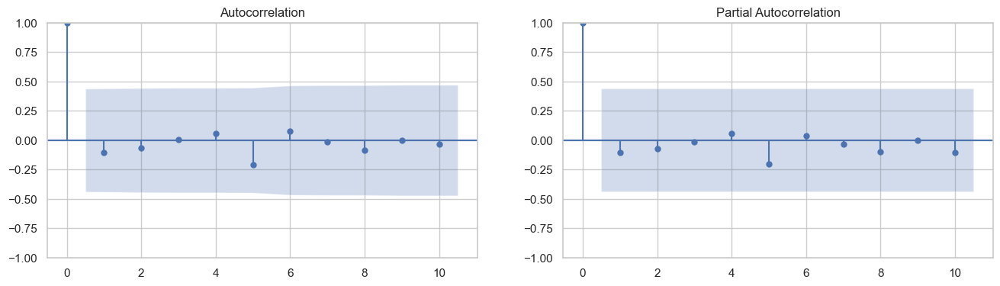

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   16
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -28.672
Date:                           do., 03 nov. 2024   AIC                             67.345
Time:                                    21:36:05   BIC                             62.838
Sample:                                02-28-2023   HQIC                            58.285
                                     - 05-31-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9248      1.631     -0.567      0.571      -4.122       2.272
ma.L1          0.9004      1.075   

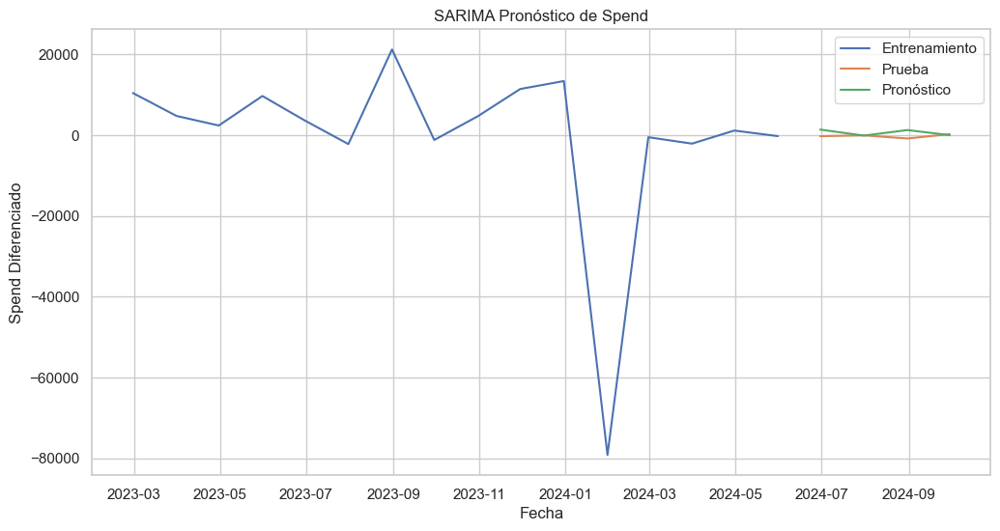

RMSE: 36.510451737425164


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

# 1. Filtrar datos para Johor
df_johor = df[df['Region'] == 'Johor'].copy()

# 2. Preparar la serie temporal
df_johor['End_Date_Corrected'] = pd.to_datetime(df_johor['End_Date_Corrected'])
df_johor.set_index('End_Date_Corrected', inplace=True)
df_johor.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_johor['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Johor')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'End_Date_Corrected' does not exist in the dataframe.


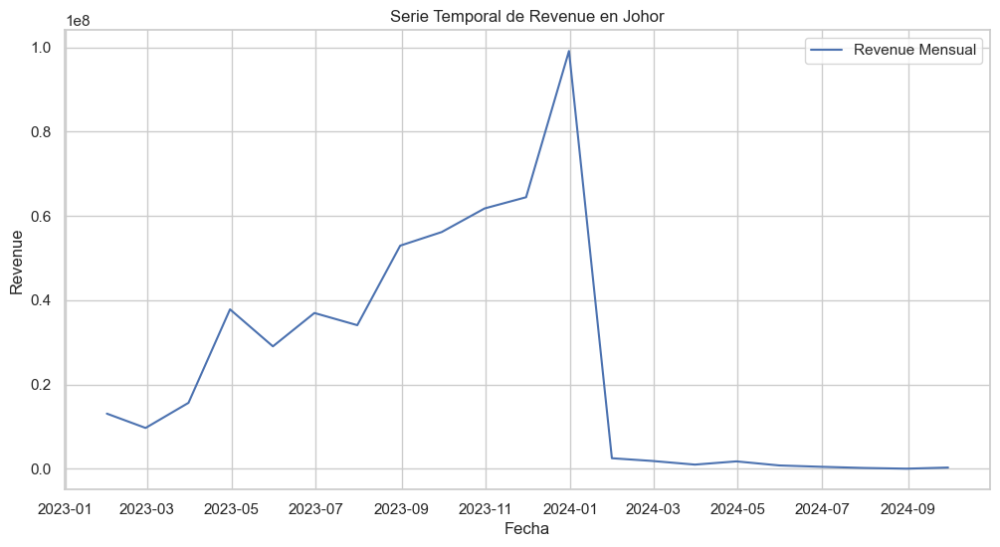

Estadístico ADF: -1.928396147282939
p-value: 0.31882281351793457
Estadístico ADF después de diferenciar: -5.543630637225856
p-value: 1.6798806332957036e-06


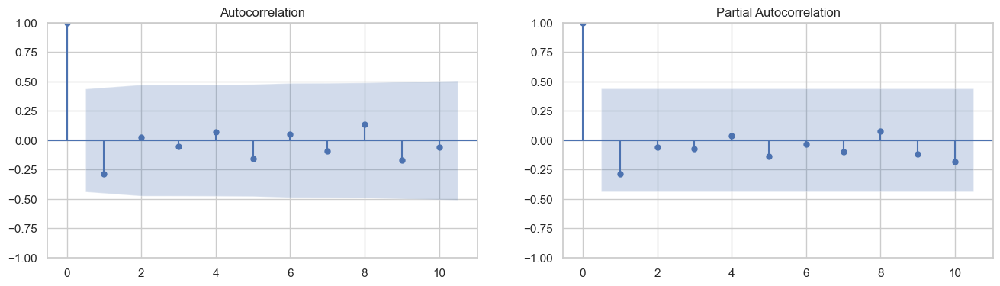

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   16
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -52.696
Date:                           do., 03 nov. 2024   AIC                            115.392
Time:                                    21:36:06   BIC                            110.885
Sample:                                02-28-2023   HQIC                           106.332
                                     - 05-31-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5734   2479.111     -0.000      1.000   -4859.542    4858.395
ma.L1          0.5656   2493.781   

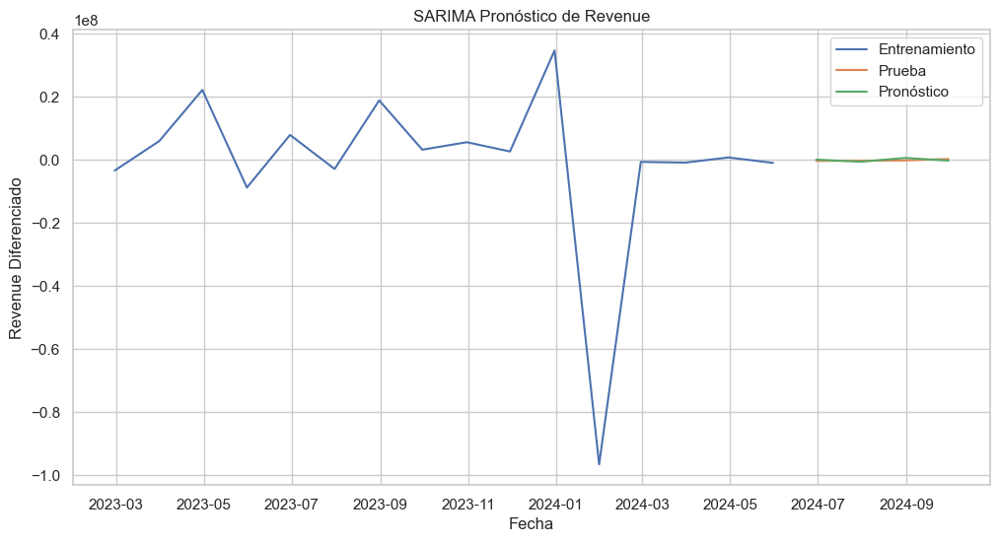

RMSE: 728.53997378698


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'End_Date_Corrected' column exists
if 'End_Date_Corrected' in df_johor.columns:
    df_johor['End_Date_Corrected'] = pd.to_datetime(df_johor['End_Date_Corrected'])
else:
    print("Column 'End_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_johor['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Johor')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


### SABAH

#### SARIMA de fecha fin

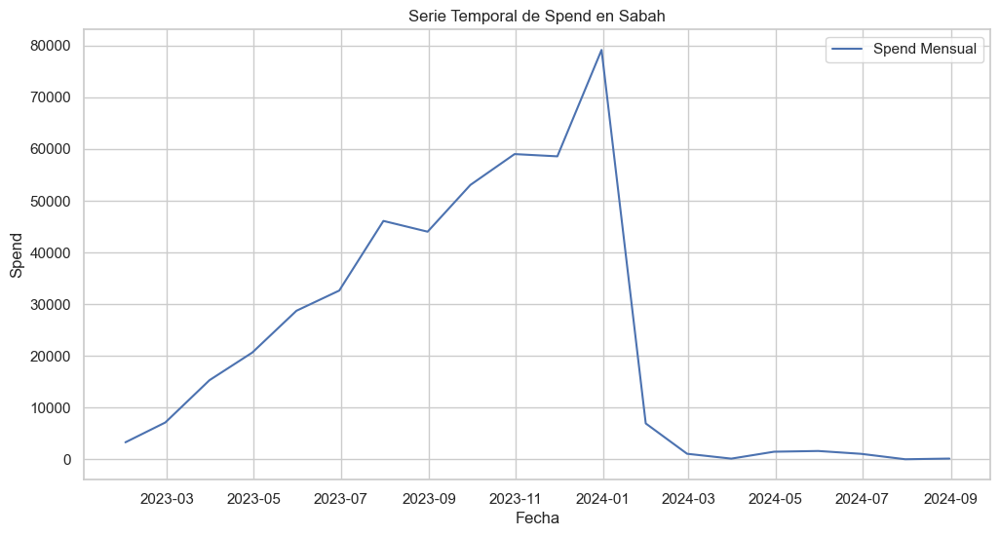

Estadístico ADF: -1.573189101872529
p-value: 0.4970459736194332
Estadístico ADF después de diferenciar: -4.609420458697414
p-value: 0.0001241026608754787


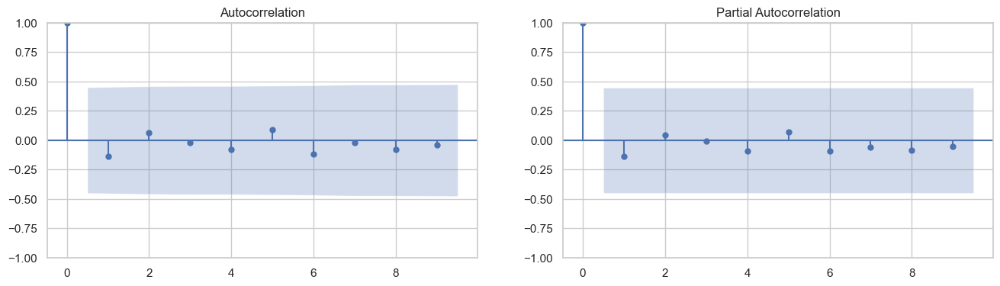

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   15
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -17.030
Date:                           do., 03 nov. 2024   AIC                             44.059
Time:                                    21:36:07   BIC                             37.525
Sample:                                02-28-2023   HQIC                            30.394
                                     - 04-30-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9384      1.040      0.903      0.367      -1.100       2.976
ma.L1         -0.8540      4.262   

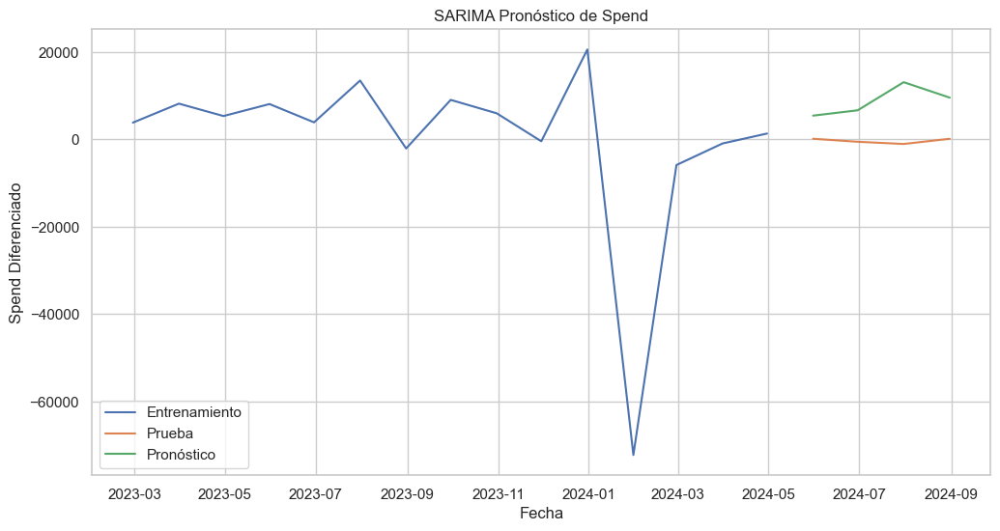

RMSE: 97.97070140910765


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

# 1. Filtrar datos para Sabah
df_sabah = df[df['Region'] == 'Sabah'].copy()

# 2. Preparar la serie temporal
df_sabah['End_Date_Corrected'] = pd.to_datetime(df_sabah['End_Date_Corrected'])
df_sabah.set_index('End_Date_Corrected', inplace=True)
df_sabah.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_sabah['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Sabah')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'End_Date_Corrected' does not exist in the dataframe.


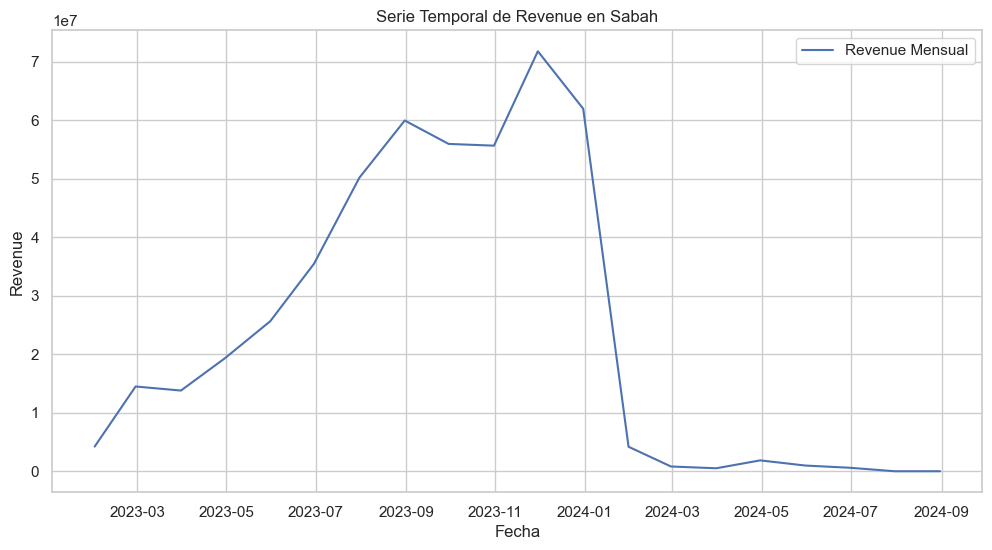

Estadístico ADF: -2.5010719375138044
p-value: 0.11521372859510648
Estadístico ADF después de diferenciar: -3.256878815311795
p-value: 0.016919518567277584


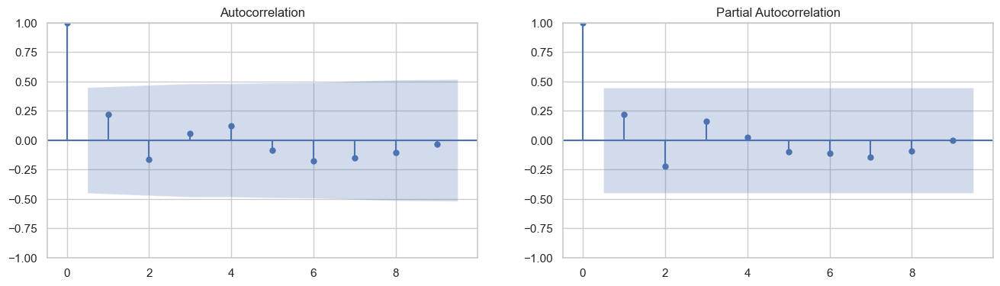

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   15
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -33.523
Date:                           do., 03 nov. 2024   AIC                             77.045
Time:                                    21:36:08   BIC                             70.511
Sample:                                02-28-2023   HQIC                            63.380
                                     - 04-30-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2380   2029.116     -0.000      1.000   -3977.232    3976.756
ma.L1          0.4119   1582.210   

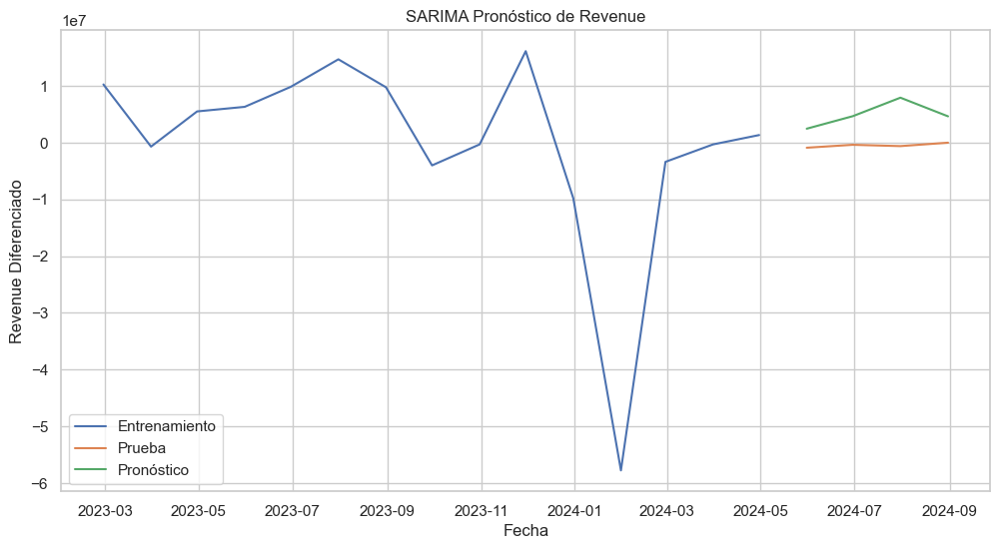

RMSE: 2392.736072628636


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'End_Date_Corrected' column exists
if 'End_Date_Corrected' in df_sabah.columns:
    df_sabah['End_Date_Corrected'] = pd.to_datetime(df_sabah['End_Date_Corrected'])
else:
    print("Column 'End_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_sabah['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Sabah')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


### SARAWAK

#### SARIMA de fechas fin

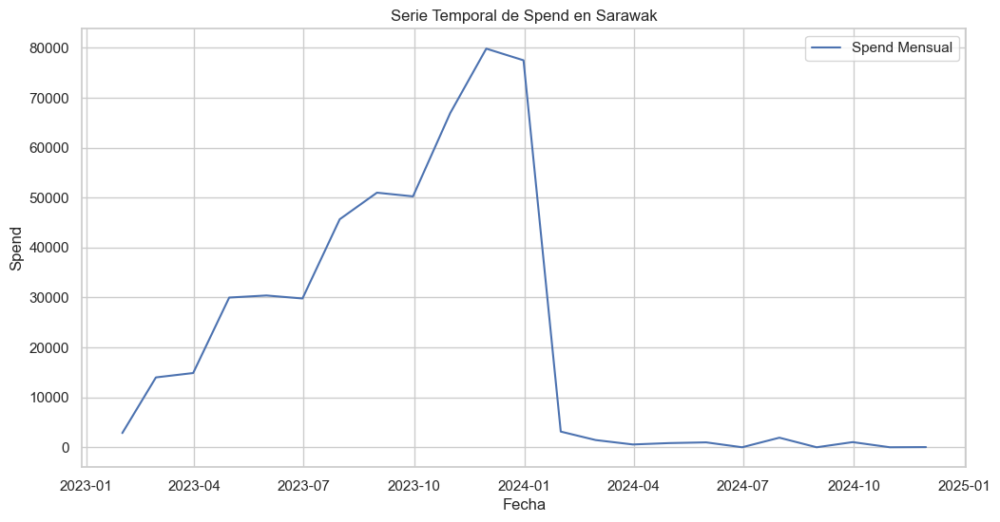

Estadístico ADF: -1.5039244048990354
p-value: 0.531569106321287
Estadístico ADF después de diferenciar: -4.044311865902307
p-value: 0.0011954529947429302


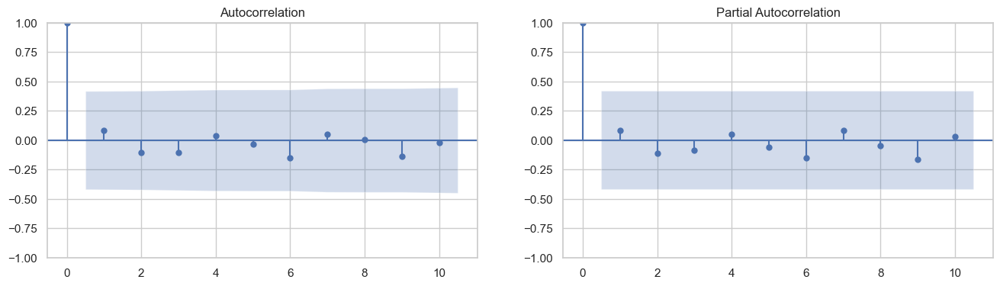

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -40.847
Date:                           do., 03 nov. 2024   AIC                             91.694
Time:                                    21:36:09   BIC                             88.626
Sample:                                02-28-2023   HQIC                            84.961
                                     - 06-30-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7734   3.19e+05  -2.43e-06      1.000   -6.25e+05    6.25e+05
ma.L1          0.8001   3.36e+05   

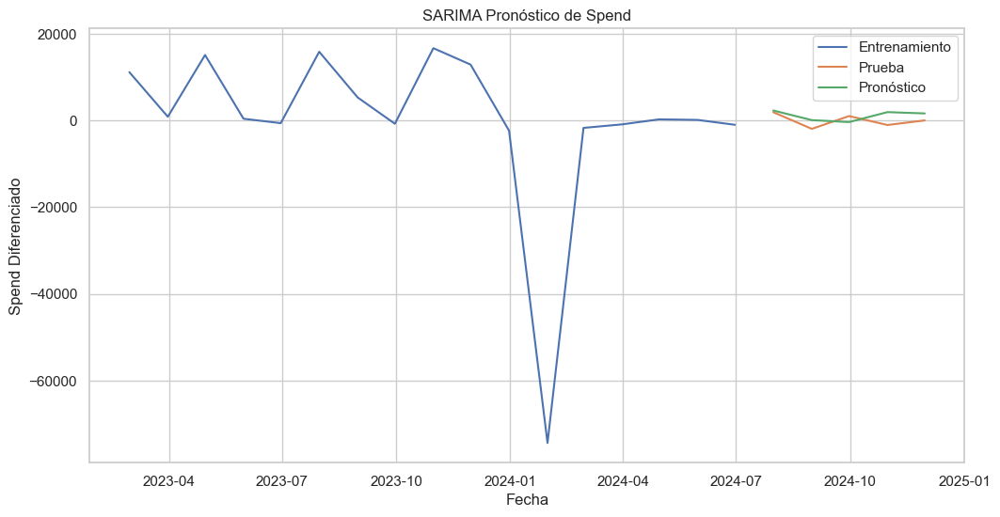

RMSE: 43.29966502761488


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

# 1. Filtrar datos para Sarawak
df_sarawak = df[df['Region'] == 'Sarawak'].copy()

# 2. Preparar la serie temporal
df_sarawak['End_Date_Corrected'] = pd.to_datetime(df_sarawak['End_Date_Corrected'])
df_sarawak.set_index('End_Date_Corrected', inplace=True)
df_sarawak.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_sarawak['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Sarawak')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'End_Date_Corrected' does not exist in the dataframe.


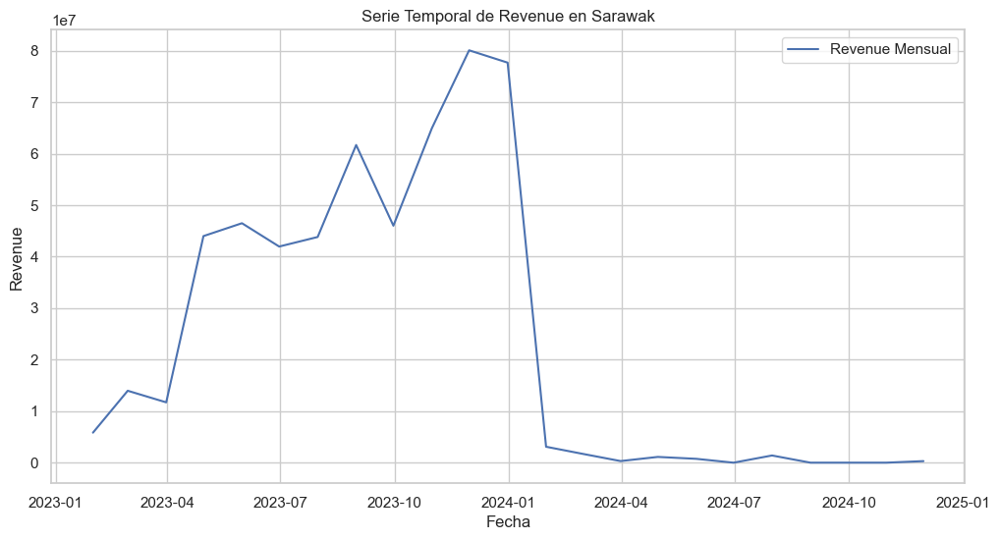

Estadístico ADF: -1.5543013728912305
p-value: 0.5064989049670523
Estadístico ADF después de diferenciar: -4.407121552417507
p-value: 0.00028833593586726603


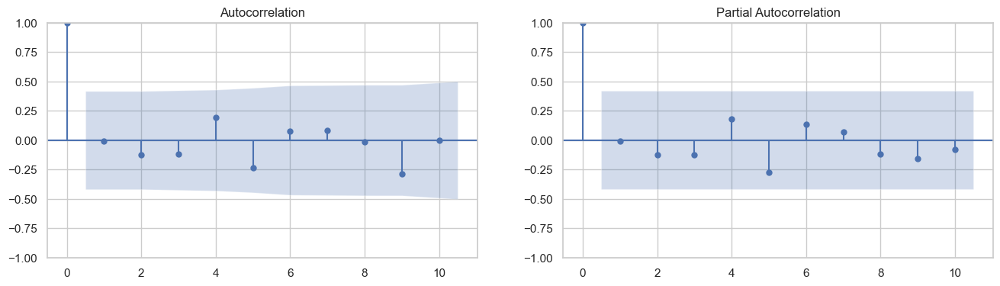

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   17
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -71.337
Date:                           do., 03 nov. 2024   AIC                            152.674
Time:                                    21:36:10   BIC                            149.605
Sample:                                02-28-2023   HQIC                           145.940
                                     - 06-30-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1613   7205.994   2.24e-05      1.000   -1.41e+04    1.41e+04
ma.L1         -0.1537   7339.860  -

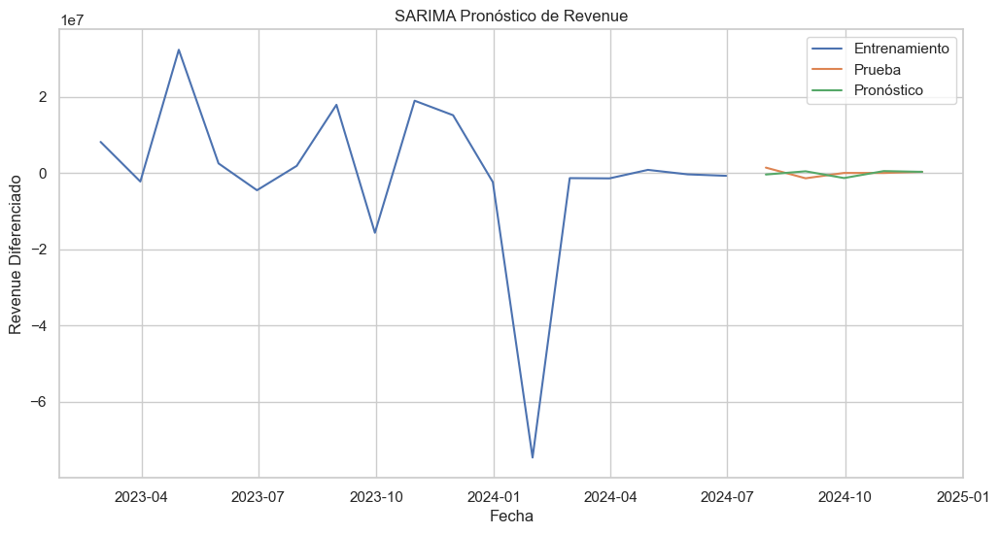

RMSE: 1147.642063617829


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'End_Date_Corrected' column exists
if 'End_Date_Corrected' in df_sarawak.columns:
    df_sarawak['End_Date_Corrected'] = pd.to_datetime(df_sarawak['End_Date_Corrected'])
else:
    print("Column 'End_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_sarawak['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Sarawak')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


### PENANG

#### SARIMA de fecha fin

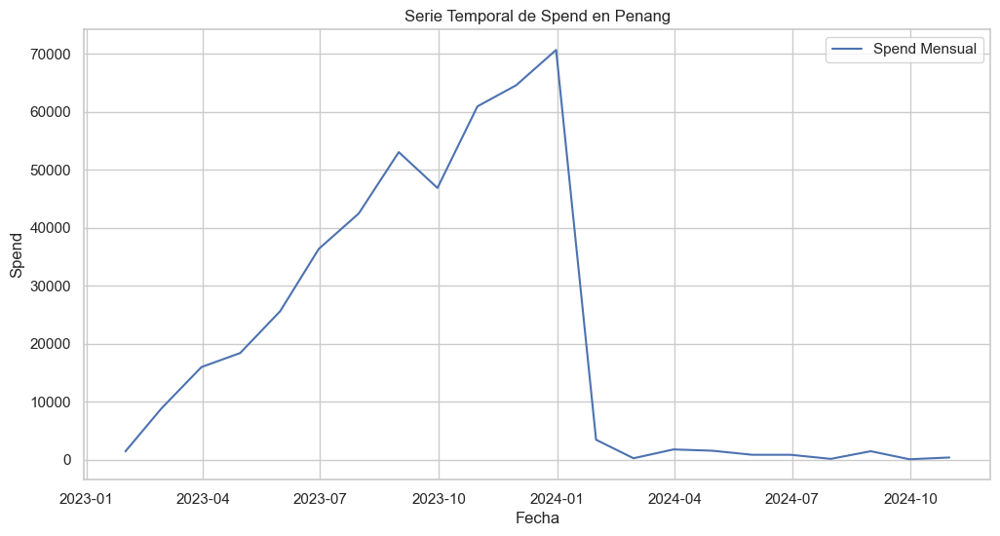

Estadístico ADF: -1.4807208067369981
p-value: 0.5430260121587046
Estadístico ADF después de diferenciar: -4.256341773568088
p-value: 0.0005282322275136647


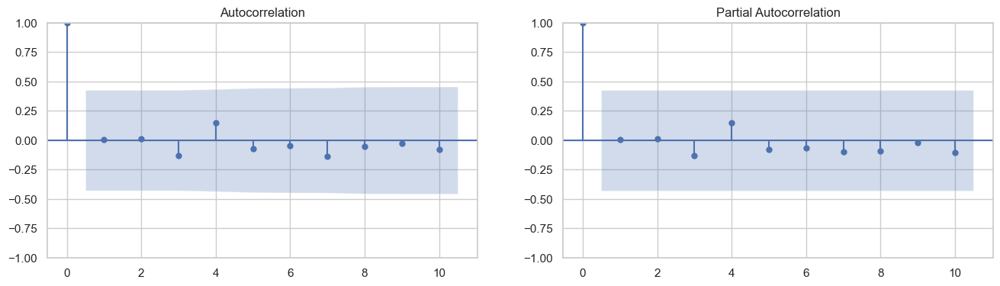

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                   16
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -27.649
Date:                           do., 03 nov. 2024   AIC                             65.299
Time:                                    21:36:11   BIC                             60.792
Sample:                                02-28-2023   HQIC                            56.239
                                     - 05-31-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2026    862.733     -0.000      1.000   -1691.128    1690.723
ma.L1          0.2809    776.286   

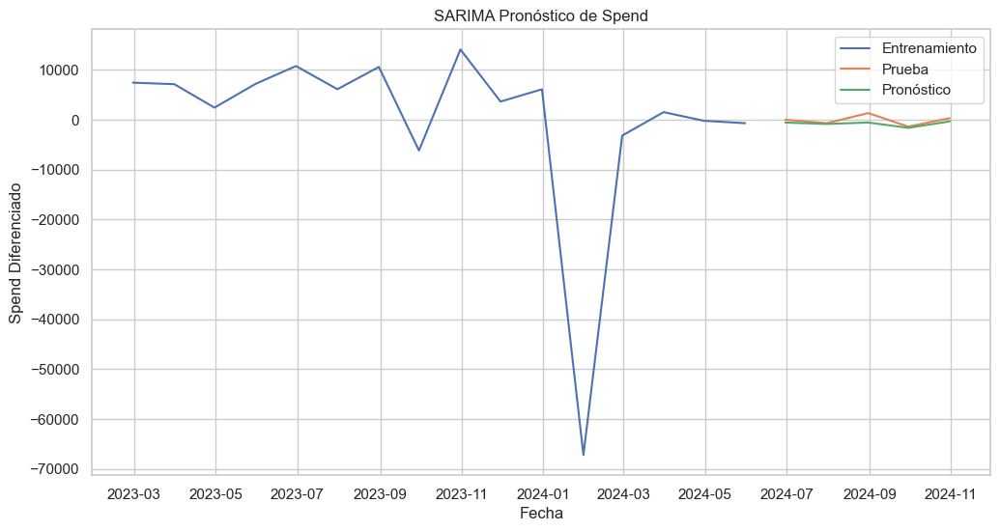

RMSE: 30.644084114893552


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

# 1. Filtrar datos para Penang
df_penang = df[df['Region'] == 'Penang'].copy()

# 2. Preparar la serie temporal
df_penang['End_Date_Corrected'] = pd.to_datetime(df_penang['End_Date_Corrected'])
df_penang.set_index('End_Date_Corrected', inplace=True)
df_penang.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_penang['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Penang')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'End_Date_Corrected' does not exist in the dataframe.


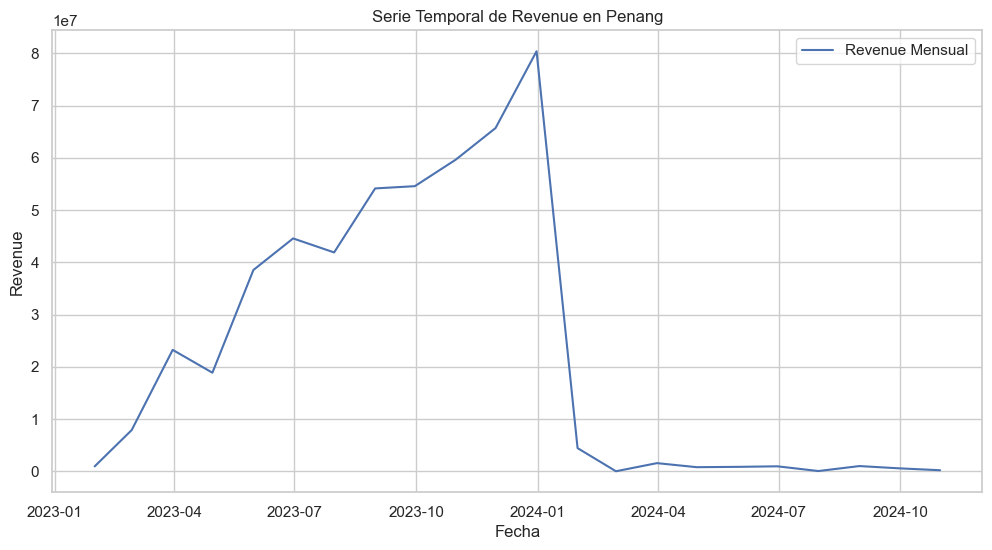

Estadístico ADF: -2.1109393665738616
p-value: 0.24013864005123714
Estadístico ADF después de diferenciar: -4.669823032835635
p-value: 9.585112337826275e-05


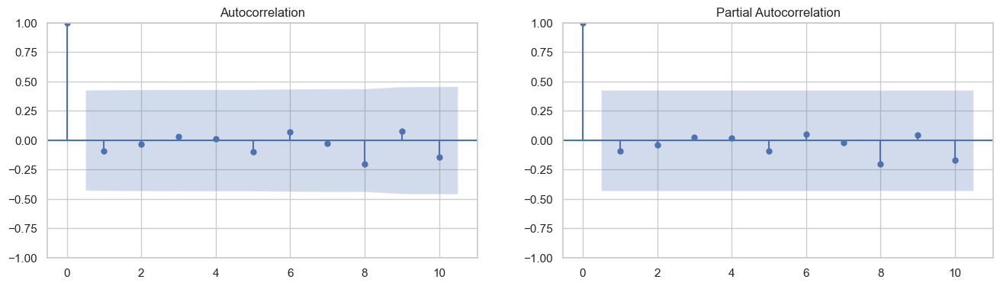

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                   16
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                 -52.196
Date:                           do., 03 nov. 2024   AIC                            114.392
Time:                                    21:36:13   BIC                            109.885
Sample:                                02-28-2023   HQIC                           105.332
                                     - 05-31-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2646   5546.075  -4.77e-05      1.000   -1.09e+04    1.09e+04
ma.L1          0.3457   4809.475   

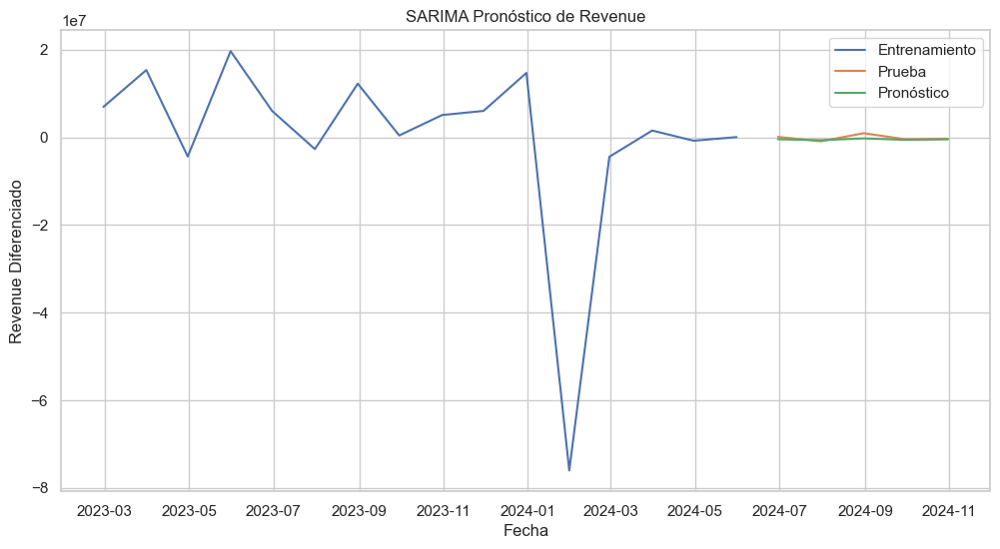

RMSE: 774.3098747244554


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'End_Date_Corrected' column exists
if 'End_Date_Corrected' in df_penang.columns:
    df_penang['End_Date_Corrected'] = pd.to_datetime(df_penang['End_Date_Corrected'])
else:
    print("Column 'End_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_penang['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Penang')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


### MALACCA

#### SARIMA de fecha fin

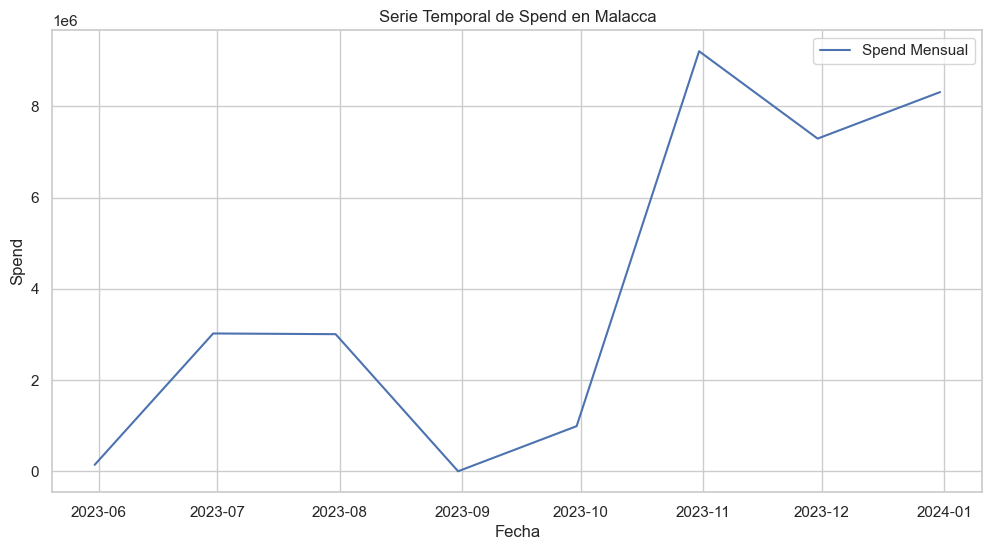

Estadístico ADF: 1.0653643844217286
p-value: 0.9949099069370803
Estadístico ADF después de diferenciar: -2.1368015218695766
p-value: 0.2299762301479204


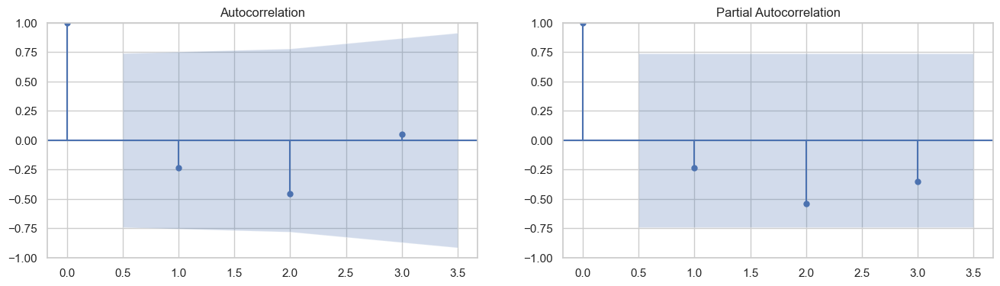

                                     SARIMAX Results                                      
Dep. Variable:                              Spend   No. Observations:                    5
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                   0.000
Date:                           do., 03 nov. 2024   AIC                             10.000
Time:                                    21:36:14   BIC                                nan
Sample:                                06-30-2023   HQIC                               nan
                                     - 10-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1               0         -0        nan        nan           0           0
ma.L1               0         -0   

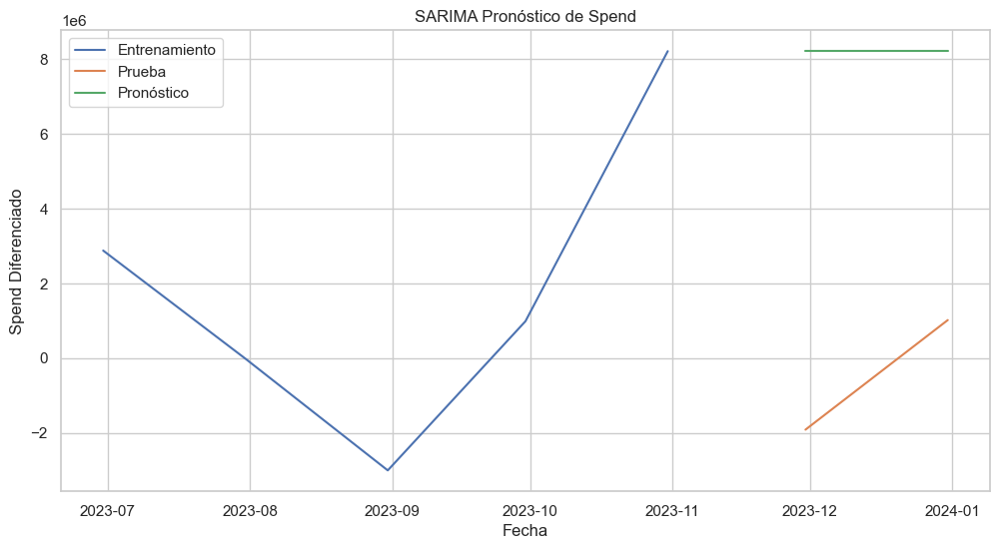

RMSE: 2964.6747630966906


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

# 1. Filtrar datos para Malacca
df_malacca = df[df['Region'] == 'Malacca'].copy()

# 2. Preparar la serie temporal
df_malacca['End_Date_Corrected'] = pd.to_datetime(df_malacca['End_Date_Corrected'])
df_malacca.set_index('End_Date_Corrected', inplace=True)
df_malacca.sort_index(inplace=True)

# Opcional: Resamplear los datos mensualmente
df_monthly = df_malacca['Spend'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly, label='Spend Mensual')
plt.title('Serie Temporal de Spend en Malacca')
plt.xlabel('Fecha')
plt.ylabel('Spend')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly)
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_diff = df_monthly.diff().dropna()
else:
    df_monthly_diff = df_monthly

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_diff)
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_diff.dropna()) // 2)
plot_acf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_diff) * 0.8)
train, test = df_monthly_diff[:train_size], df_monthly_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Spend')
plt.xlabel('Fecha')
plt.ylabel('Spend Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


Column 'End_Date_Corrected' does not exist in the dataframe.


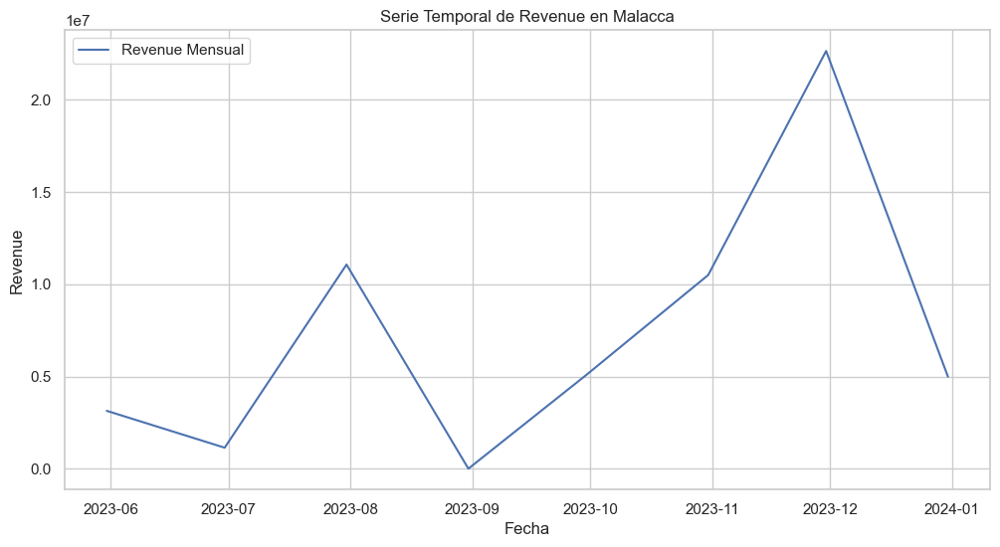

Estadístico ADF: -2.302581824810279
p-value: 0.1711366337077097
Estadístico ADF después de diferenciar: -3.368883896351596
p-value: 0.012066473021683377


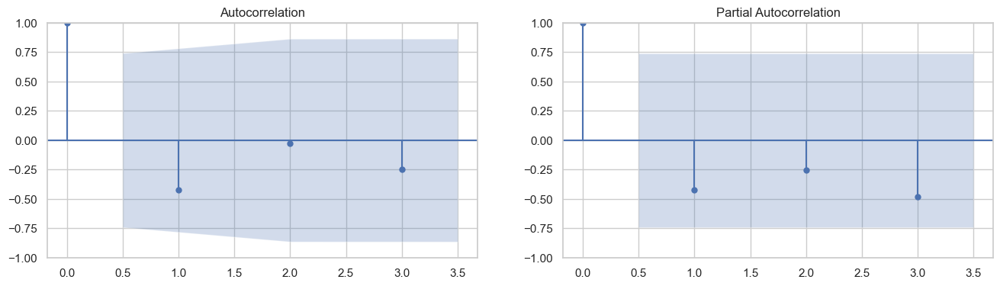

                                     SARIMAX Results                                      
Dep. Variable:                            Revenue   No. Observations:                    5
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                   0.000
Date:                           do., 03 nov. 2024   AIC                             10.000
Time:                                    21:36:14   BIC                                nan
Sample:                                06-30-2023   HQIC                               nan
                                     - 10-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1               0         -0        nan        nan           0           0
ma.L1               0         -0   

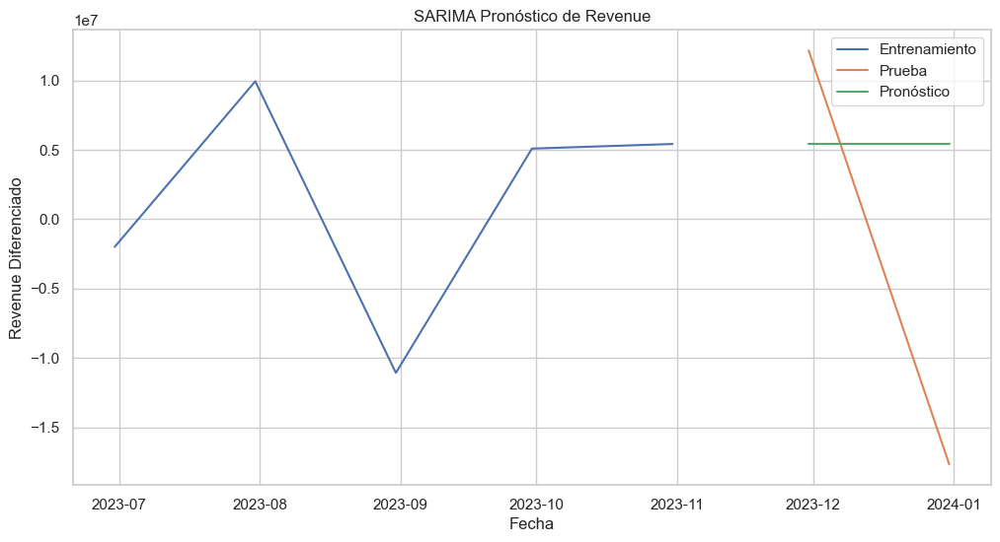

RMSE: 4122.81941384366


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt
# Ensure 'End_Date_Corrected' column exists
if 'End_Date_Corrected' in df_malacca.columns:
    df_malacca['End_Date_Corrected'] = pd.to_datetime(df_malacca['End_Date_Corrected'])
else:
    print("Column 'End_Date_Corrected' does not exist in the dataframe.")

# Define df_monthly_revenue by resampling the 'Revenue' column
df_monthly_revenue = df_malacca['Revenue'].resample('M').sum()

# 3. Visualizar la serie temporal
plt.figure(figsize=(12, 6))
plt.plot(df_monthly_revenue, label='Revenue Mensual')
plt.title('Serie Temporal de Revenue en Malacca')
plt.xlabel('Fecha')
plt.ylabel('Revenue')
plt.legend()
plt.show()

# 4. Prueba de estacionariedad (ADF)
result = adfuller(df_monthly_revenue.dropna())
print('Estadístico ADF:', result[0])
print('p-value:', result[1])

# 5. Si la serie no es estacionaria, diferenciarla
if result[1] > 0.05:
    df_monthly_revenue_diff = df_monthly_revenue.diff().dropna()
else:
    df_monthly_revenue_diff = df_monthly_revenue

# Repetir la prueba ADF después de diferenciar
result = adfuller(df_monthly_revenue_diff.dropna())
print('Estadístico ADF después de diferenciar:', result[0])
print('p-value:', result[1])

# 6. Graficar ACF y PACF para determinar p, d, q, P, D, Q, s
fig, ax = plt.subplots(1, 2, figsize=(16, 4))
max_lags = min(10, len(df_monthly_revenue_diff.dropna()) // 2)
plot_acf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[0])
plot_pacf(df_monthly_revenue_diff.dropna(), lags=max_lags, ax=ax[1])
plt.show()

# Determinar la estacionalidad (s)
s = 12  # Suponiendo estacionalidad anual

# 7. Dividir los datos en entrenamiento y prueba
train_size = int(len(df_monthly_revenue_diff) * 0.8)
train, test = df_monthly_revenue_diff[:train_size], df_monthly_revenue_diff[train_size:]

# 8. Ajustar el modelo SARIMA
# Suponiendo que p=1, d=1, q=1, P=1, D=1, Q=1 basado en las gráficas ACF y PACF
model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, s))
model_fit = model.fit()

# 9. Evaluar el modelo
print(model_fit.summary())

# 10. Pronosticar
forecast = model_fit.forecast(steps=len(test))
forecast_series = pd.Series(forecast, index=test.index)

# 11. Visualizar los resultados
plt.figure(figsize=(12, 6))
plt.plot(train, label='Entrenamiento')
plt.plot(test, label='Prueba')
plt.plot(forecast_series, label='Pronóstico')
plt.title('SARIMA Pronóstico de Revenue')
plt.xlabel('Fecha')
plt.ylabel('Revenue Diferenciado')
plt.legend()
plt.show()

# 12. Calcular el RMSE
rmse = np.sqrt(root_mean_squared_error(test, forecast))
print('RMSE:', rmse)


### Valores de registros que tenemos de cada canal por tipo de producto y segmento para cada región, con su gasto e ingreso diario.

In [ ]:
# Supongamos que tu DataFrame se llama df y tiene las columnas necesarias
# df = pd.read_csv('tu_archivo.csv')  # Cargar el DataFrame desde un archivo CSV, si es necesario

# Calcular la cuantía de registros por 'Product_Category' para cada 'Region' tomando 'Channel' y 'Market_Segment' como base
cuantia_product_category = df.groupby(['Region', 'Channel', 'Market_Segment', 'Product_Category']).size().reset_index(name='Count_Product_Category')

# Calcular 'Spend' entre 'Duración_corregida' y 'Revenue' entre 'Duración_corregida'
df['Spend_per_Duration'] = df['Spend'] / df['Duración_corregida']
df['Revenue_per_Duration'] = df['Revenue'] / df['Duración_corregida']

# Crear una tabla combinada con los resultados
tabla_resultados = df[['Region', 'Channel', 'Market_Segment', 'Product_Category', 'Spend_per_Duration', 'Revenue_per_Duration']].copy()
tabla_resultados = tabla_resultados.merge(cuantia_product_category, on=['Region', 'Channel', 'Market_Segment', 'Product_Category'], how='left')

# Mostrar la tabla

tabla_resultados.head()



,Region,Channel,Market_Segment,Product_Category,Spend_per_Duration,Revenue_per_Duration,Count_Product_Category
0,Kuala Lumpur,Billboard,Medium,Fashion,0.016892,2868.260135,16
1,Sarawak,Email,Medium,Health,0.000000,31761.310345,13
2,Penang,Radio,Medium,Electronics,0.057592,267.759162,18
3,Penang,Email,High,Electronics,0.113636,2180.534091,12
4,Kuala Lumpur,Radio,Low,Fashion,0.333333,18582.333333,9


In [ ]:
# Si deseas una visualización interactiva, puedes usar plotly
import plotly.express as px

# Crear una tabla interactiva con plotly
fig = px.scatter(tabla_resultados, x='Spend_per_Duration', y='Revenue_per_Duration', color='Channel', symbol='Product_Category',
                 title='Spend per Duration vs Revenue per Duration',
                 labels={'Spend_per_Duration': 'Spend per Duration', 'Revenue_per_Duration': 'Revenue per Duration'},
                 hover_data=['Region', 'Market_Segment', 'Count_Product_Category'])

# Mostrar la tabla interactiva
fig.show()

# Calcular (Revenue - Spend) / Duración_corregida
df['Revenue_minus_Spend_per_Duration'] = (df['Revenue'] - df['Spend']) / df['Duración_corregida']

# Crear una tabla interactiva con plotly
fig = px.scatter(df, x='Revenue_minus_Spend_per_Duration', color='Channel', symbol='Product_Category',
                 title='Revenue_minus_Spend_per_Duration',
                 labels={ 'Revenue_minus_Spend_per_Duration'},
                 hover_data=['Region', 'Market_Segment'])

# Mostrar la tabla interactiva
fig.show()


In [ ]:
# Calcular la cuantía de registros por 'Product_Category' para cada 'Region' tomando 'Channel' y 'Market_Segment' como base
cuantia_product_category = df.groupby(['Region', 'Channel', 'Market_Segment', 'Product_Category']).size().reset_index(name='Count_Product_Category')

# Merge cuantia_product_category with the original dataframe
df = df.merge(cuantia_product_category, on=['Region', 'Channel', 'Market_Segment', 'Product_Category'], how='left')

# Vamos al siguiente paso es que es calcular el valor de ingreso menos gasto por duración por cada observación.
df['Valor_retorno_pordía_muestra'] = df['Revenue_minus_Spend_per_Duration'] / df['Count_Product_Category']

# Crear una tabla interactiva con plotly
fig = px.scatter(df, x='Valor_retorno_pordía_muestra', color='Channel', symbol='Product_Category',
                 title='Valor_retorno_por día muestra',
                 labels={'Valor_retorno_pordía_muestra': 'Valor retorno por día muestra'},
                 hover_data=['Region', 'Market_Segment'])

# Mostrar la tabla interactiva
fig.show()


In [ ]:
# Calcular el número de observaciones por cada 'Channel'
observaciones_por_channel = df.groupby('Channel').size().reset_index(name='Count_Channel')

# Calcular el número de observaciones por cada 'Product_Category'
observaciones_por_product_category = df.groupby('Product_Category').size().reset_index(name='Count_Product_Category')

# Mostrar los resultados
print("Número de observaciones por 'Channel':")
print(observaciones_por_channel)

print("\nNúmero de observaciones por 'Product_Category':")
print(observaciones_por_product_category)


Número de observaciones por 'Channel':
        Channel  Count_Channel
0     Billboard           1076
1         Email            987
2          News              6
3         Radio           1010
4  Social Media           1006
5            TV            915

Número de observaciones por 'Product_Category':
  Product_Category  Count_Product_Category
0       Automotive                    1012
1      Electronics                    1034
2          Fashion                     943
3        Groceries                    1031
4           Health                     980


In [ ]:
# Columnas necesarias para el análisis
columnas_necesarias = ['Region', 'Channel', 'Product_Category', 'Valor_retorno_pordía_muestra']

# Verificar si las columnas existen
if not all(col in df.columns for col in columnas_necesarias):
    raise ValueError("Algunas columnas necesarias no están presentes en el DataFrame.")

# Filtrar el DataFrame para excluir 'Malacca'
df_sin_malacca = df[df['Region'] != 'Malacca']

# Eliminar valores nulos o infinitos en 'Valor_retorno_pordía_muestra'
df_sin_malacca = df_sin_malacca.replace([np.inf, -np.inf], np.nan).dropna(subset=['Valor_retorno_pordía_muestra'])

# Calcular promedio por Región y Canal sin 'Malacca'
promedio_canal_region = df_sin_malacca.groupby(['Region', 'Channel'])['Valor_retorno_pordía_muestra'].mean().reset_index()

# Identificar el mejor canal por región (mayor valor promedio)
mejor_canal_por_region = promedio_canal_region.loc[promedio_canal_region.groupby('Region')['Valor_retorno_pordía_muestra'].idxmax()]

# Calcular promedio por Región y Producto sin 'Malacca'
promedio_producto_region = df_sin_malacca.groupby(['Region', 'Product_Category'])['Valor_retorno_pordía_muestra'].mean().reset_index()

# Identificar el producto más rentable por región
mejor_producto_por_region = promedio_producto_region.loc[promedio_producto_region.groupby('Region')['Valor_retorno_pordía_muestra'].idxmax()]

# Mostrar los resultados
print("Mejor Canal por Región (sin Malacca):")
print(mejor_canal_por_region)

print("\nProducto Más Rentable por Región (sin Malacca):")
print(mejor_producto_por_region)


Mejor Canal por Región (sin Malacca):
          Region    Channel  Valor_retorno_pordía_muestra
4          Johor         TV                   1397.701606
7   Kuala Lumpur       News                  28791.977295
11        Penang  Billboard                   1810.369621
20         Sabah         TV                   1518.287379
23       Sarawak      Radio                   1748.159835

Producto Más Rentable por Región (sin Malacca):
          Region Product_Category  Valor_retorno_pordía_muestra
1          Johor      Electronics                   1598.729606
9   Kuala Lumpur           Health                   2009.634537
10        Penang       Automotive                   1676.456871
18         Sabah        Groceries                   1361.124066
24       Sarawak           Health                   1862.109036


In [ ]:
import pandas as pd
import numpy as np

# Columnas necesarias para el análisis
columnas_necesarias = ['Region', 'Channel', 'Product_Category', 'Valor_retorno_pordía_muestra']

# Verificar si las columnas existen
if not all(col in df.columns for col in columnas_necesarias):
    raise ValueError("Algunas columnas necesarias no están presentes en el DataFrame.")

# Filtrar el DataFrame para excluir 'Malacca'
df_sin_malacca = df[df['Region'] != 'Malacca']

# Eliminar valores nulos o infinitos en 'Valor_retorno_pordía_muestra'
df_sin_malacca = df_sin_malacca.replace([np.inf, -np.inf], np.nan).dropna(subset=['Valor_retorno_pordía_muestra'])

# Calcular promedio por Región, Canal y Producto sin 'Malacca'
promedio_canal_producto_region = df_sin_malacca.groupby(['Region', 'Channel', 'Product_Category'])['Valor_retorno_pordía_muestra'].mean().reset_index()

# Mostrar los resultados
print("Valores de todos los canales y productos por región (sin Malacca):")
print(promedio_canal_producto_region)


Valores de todos los canales y productos por región (sin Malacca):
           Region       Channel Product_Category  Valor_retorno_pordía_muestra
0           Johor     Billboard       Automotive                   1866.298021
1           Johor     Billboard      Electronics                    969.403903
2           Johor     Billboard          Fashion                   1951.360703
3           Johor     Billboard        Groceries                    911.267236
4           Johor     Billboard           Health                    907.854762
5           Johor         Email       Automotive                   1109.679085
6           Johor         Email      Electronics                   1936.195333
7           Johor         Email          Fashion                    778.312079
8           Johor         Email        Groceries                    772.969771
9           Johor         Email           Health                    782.006833
10          Johor         Radio       Automotive                

Valores de todos los canales y productos por región (sin Malacca):
           Region       Channel Product_Category  Valor_retorno_pordía_muestra
0           Johor     Billboard       Automotive                   1866.298021
1           Johor     Billboard      Electronics                    969.403903
2           Johor     Billboard          Fashion                   1951.360703
3           Johor     Billboard        Groceries                    911.267236
4           Johor     Billboard           Health                    907.854762
5           Johor         Email       Automotive                   1109.679085
6           Johor         Email      Electronics                   1936.195333
7           Johor         Email          Fashion                    778.312079
8           Johor         Email        Groceries                    772.969771
9           Johor         Email           Health                    782.006833
10          Johor         Radio       Automotive                

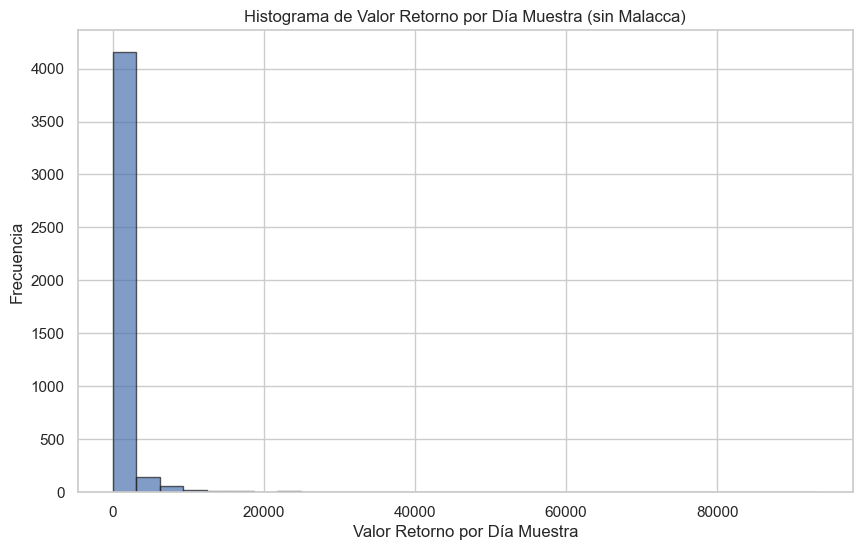

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Supongamos que tu DataFrame se llama df y tiene las columnas necesarias
# df = pd.read_csv('tu_archivo.csv')  # Cargar el DataFrame desde un archivo CSV, si es necesario

# Columnas necesarias para el análisis
columnas_necesarias = ['Region', 'Channel', 'Product_Category', 'Valor_retorno_pordía_muestra']

# Verificar si las columnas existen
if not all(col in df.columns for col in columnas_necesarias):
    raise ValueError("Algunas columnas necesarias no están presentes en el DataFrame.")

# Filtrar el DataFrame para excluir 'Malacca'
df_sin_malacca = df[df['Region'] != 'Malacca']

# Eliminar valores nulos o infinitos en 'Valor_retorno_pordía_muestra'
df_sin_malacca = df_sin_malacca.replace([np.inf, -np.inf], np.nan).dropna(subset=['Valor_retorno_pordía_muestra'])

# Calcular promedio por Región, Canal y Producto sin 'Malacca'
promedio_canal_producto_region = df_sin_malacca.groupby(['Region', 'Channel', 'Product_Category'])['Valor_retorno_pordía_muestra'].mean().reset_index()

# Mostrar los resultados
print("Valores de todos los canales y productos por región (sin Malacca):")
print(promedio_canal_producto_region)

# Crear un histograma del 'Valor_retorno_pordía_muestra'
plt.figure(figsize=(10, 6))
plt.hist(df_sin_malacca['Valor_retorno_pordía_muestra'], bins=30, edgecolor='k', alpha=0.7)
plt.title('Histograma de Valor Retorno por Día Muestra (sin Malacca)')
plt.xlabel('Valor Retorno por Día Muestra')
plt.ylabel('Frecuencia')
plt.grid(True)
plt.show()
